In [1]:
import os
import csv
import optuna
import numpy as np
import pandas as pd
from tensorflow import keras
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, LSTM, Dense, Activation, Dropout
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from math import sqrt
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from numpy import array
import keras.backend as K
import itertools
#!pip install pydot

# date-time parsing function for loading the dataset
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')
    
def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))
    
def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
    
# convert time series into a supervised learning problem
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
# convert time series into a supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):

    n_vars = 1 if type(data) is list else data.shape[1]
    cols, names = list(), list()
    df = DataFrame(data)
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
    	cols.append(df.shift(i))
    	names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df[0].shift(-i)) # df[0] for specific humidity
        if i == 0:
            names += [('var%d(t)' % (1))] # % (1) for specific humidity
        else:            
            names += [('var%d(t+%d)' % (1, i))] # % (1) for specific humidity
    
    # put it all together
    agg = concat(cols, axis=1)

    if dropnan:
        #Drop rows containing NaN
        agg.dropna(inplace=True)

    agg.columns = names

    return agg
     
# create a differenced series
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
     
# transform series into training sets for supervised learning
def prepare_training_data(data, n_lag, n_seq, n_time_steps):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(84):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)
    
    # rescale values to 0, 1
    scaler_all_features =  MinMaxScaler(feature_range=(0, 1))
    scaler =  MinMaxScaler(feature_range=(0, 1))
    train_scaled_values = scaler_all_features.fit_transform(diff_values)
    response_train_values = []
    for i in range(len(diff_values)):
        response_train_values.append(diff_values[i][0]) # Uses first column (specific_humidity) as response variable
    response_train_values = np.array(response_train_values)
    response_train_values = response_train_values.reshape(len(response_train_values), 1)

    # Fit the scaler for just the response variable for use later when forecasting
    response_scaled_values = scaler.fit_transform(response_train_values) 
    scaled_values = scaler_all_features.transform(diff_values)

    train = []

    # Transform each weather station as a separate "batch"
    for ws in range(84):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        train.append([supervised_values])
    
    return scaler, scaler_all_features, train

# transform series into testing and validation sets for supervised learning
def prepare_testing_and_validation_data(data, n_lag, n_seq, n_time_steps, scaler_all_features):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(21):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaled_values = scaler_all_features.transform(diff_values)

    validation = []
    test = []

    # Transform each weather station as a separate "batch"
    for ws in range(21):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        # training/test/validation split is 80%/10%/10%
        if ws < 11:
            test.append([supervised_values])
        else:
            validation.append([supervised_values])
    
    return validation, test
    
def plot_kfold(cv, X, y, ax, n_splits, xlim_max=105):
    
    #Plots the indices for a cross-validation object.
    #Taken from https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
    #Parameters:
    #cv: Cross-validation object
    #X: Feature set
    #y: Target variable
    #ax: Matplotlib axis object
    #n_splits: Number of folds in the cross-validation
    #xlim_max: Maximum limit for the x-axis
        
    # Set color map for the plot
    cmap_cv = plt.cm.coolwarm
    cv_split = cv.split(X=X, y=y)
        
    for i_split, (train_idx, test_idx) in enumerate(cv_split):
        # Create an array of NaNs and fill in training/testing indices
        indices = np.full(len(X), np.nan)
        indices[test_idx], indices[train_idx] = 1, 0
            
        # Plot the training and testing indices
        ax_x = range(len(indices))
        ax_y = [i_split + 0.5] * len(indices)
        ax.scatter(ax_x, ax_y, c=indices, marker="_", 
                   lw=10, cmap=cmap_cv, vmin=-0.2, vmax=1.2)
    
        # Set y-ticks and labels
        y_ticks = np.arange(n_splits) + 0.5
        ax.set(yticks=y_ticks, yticklabels=range(n_splits),
               xlabel="Weather Station index (file_id)", ylabel="Fold",
               ylim=[n_splits, -0.2], xlim=[0, xlim_max])
    
        # Set plot title and create legend
        ax.set_title("KFold", fontsize=14)
        legend_patches = [Patch(color=cmap_cv(0.8), label="Testing set"), 
                          Patch(color=cmap_cv(0.02), label="Training set")]
        ax.legend(handles=legend_patches, loc=(1.03, 0.8))
    
#Main

#Configure
n_seq = 60
if n_seq > 46:
    n_lag = 179 - n_seq + 46
else:
    n_lag = 179
n_time_steps = 227
n_test = 1

print("Model Parameters:")
print("n_lag (number of input time steps): "+str(n_lag))
print("n_seq (number of output/future prediction time steps): "+str(n_seq))

# Create 2D array with file_ids to use for sample creation
array = np.array([
    6501, 6541, 6640, 6668, 6678, 
    6687, 6697, 6714, 6744, 6772, 
    6783, 6840, 6844, 6854, 6870, 
    6891, 6895, 6899, 6901, 6909, 
    6929, 6950, 6963, 6969, 6994, 
    7032, 7057, 7094, 7095, 7100, 
    7108, 7116, 7119, 7131, 7139, 
    7152, 7155, 7156, 7182, 7193, 
    7202, 7239, 7280, 7286, 7287, 
    7311, 7321, 7329, 7347, 7350, 
    7354, 7357, 7361, 7414, 7423, 
    7424, 7432, 7463, 7482, 7489, 
    7528, 7531, 7534, 7538, 7549, 
    7553, 7555, 7562, 7571, 7573, 
    7574, 7575, 7585, 7599, 7603, 
    7606, 7622, 7652, 7671, 7704, 
    7786, 7805, 7816, 7838, 7861, 
    7862, 7863, 7870, 7892, 7907, 
    7938, 7962, 7979, 7987, 7999, 
    8000, 8034, 8083, 8120, 8133, 
    8184, 8186, 8247, 8248, 9858])
    
#Create arrays holding the 5-fold cross-validation indices gathered for consistency across models
train_array = []
test_array = []
    
train_array.append([1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 
                        23, 24, 25, 27, 28, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 
                        43, 44, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 
                        62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 81, 
                        82, 83, 84, 85, 86, 87, 88, 90, 91, 92, 93, 95, 97, 98, 100, 101, 102, 103])
test_array.append([0, 4, 10, 12, 18, 26, 30, 31, 33, 45, 47, 53, 64, 65, 77, 80, 89, 94, 96, 99, 104])
    
train_array.append([0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 
                        24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 41, 43, 45, 
                        46, 47, 48, 49, 50, 51, 52, 53, 54, 57, 58, 59, 60, 61, 63, 64, 
                        65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 77, 80, 81, 82, 83, 84, 
                        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104])
test_array.append([5, 9, 11, 15, 16, 22, 28, 35, 39, 40, 42, 44, 55, 56, 62, 72, 76, 78, 79, 85, 103])
    
train_array.append([0, 1, 2, 4, 5, 9, 10, 11, 12, 14, 15, 16, 18, 20, 21, 22, 23, 26, 
                    28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 42, 44, 45, 46, 47, 
                    48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 
                    70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 
                    90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104])
test_array.append([3, 6, 7, 8, 13, 17, 19, 24, 25, 27, 34, 38, 43, 49, 66, 67, 68, 69, 73, 81, 84])
    
train_array.append([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 
                        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 
                        35, 37, 38, 39, 40, 42, 43, 44, 45, 47, 49, 51, 52, 53, 55, 56, 
                        60, 62, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 
                        80, 81, 82, 84, 85, 86, 87, 88, 89, 92, 93, 94, 95, 96, 99, 102, 103, 104])
test_array.append([32, 36, 41, 46, 48, 50, 54, 57, 58, 59, 61, 63, 70, 75, 83, 90, 91, 97, 98, 100, 101])
    
train_array.append([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 22,
                        24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 
                        42, 43, 44, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 
                        61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 
                        79, 80, 81, 83, 84, 85, 89, 90, 91, 94, 96, 97, 98, 99, 100, 101, 103, 104])
test_array.append([1, 2, 14, 20, 21, 23, 29, 37, 51, 52, 60, 71, 74, 82, 86, 87, 88, 92, 93, 95, 102])
    
# Equations for three Principal Components from PCA using response variables combined with other predictors
#PC1=-0.0002714X1+0.02612X2+0.03858X3-0.007658X4+0.001592X5-0.02087X6+0.8564X7-0.1468X8+0.01192X9-0.0001049X10+0.01913X11+0.02076X12
#PC2=0.0003944X1+0.002204X2+0.01052X3+0.3248X4-0.0009976X5-0.04421X6+2.3406X7+0.06103X8+0.08841X9+0.00009018X10+0.05678X11-0.002022X12
#PC3=-0.00007998X1-0.0006124X2-0.001063X3-0.01855X4+0.00001956X5+0.01170X6+0.6076X7+0.4664X8-0.002995X9+0.008185X10+0.8815X11-0.0004730X12
    
# Equations for three Principal Components from PCA omitting both response variables,
#PC-1=-0.0004514X1+0.03194X2-0.04343X3+0.002243X4-0.02252X5+0.9877X6-0.2265X7+0.006144X8-0.0001488X9+0.02943X10
#PC-2=0.0001702X1+0.005484X2+0.2057X3-0.0003188X4-0.02584X5+1.6963X6-0.05890X7+0.05809X8+1.9748X9+0.03686X10
#PC-3=-0.00006323X1-0.001180X2-0.02384X3-0.00002833X4+0.01170X5+0.5204X6+0.4791X7-0.004318X8+0.008271X9+0.8765X10
    
# Get the current working directory 
current_directory = os.getcwd() 
    
# Print the current working directory 
print(current_directory)
    
# Define the directory containing the files 
path = current_directory+"\\Modeling\\"
print(path)
    
filename = path + 'Final_Monthly_Dataset.csv'
    
# load dataset
df = read_csv(filename, header=0, parse_dates=[0], index_col=0, date_format='%Y-%m')

# Swap columns 'temperatures' and 'specific_humidity' directly
df['A'] = df['temperatures']
df['temperatures'] = df['specific_humidity']
df['specific_humidity'] = df['A']
df = df.drop(columns=['A'])
# Rename columns
df = df.rename(columns={'temperatures': 'specific_humidity', 'specific_humidity': 'temperatures'})

print(df)
    
df = df.rename(columns={'Unnamed: 0' : 'indices'})
    
#Remove unused columns
df = df.drop(['Day', 'vapor_pressure'], axis=1)
    
# Round numbers in columns to reasonable precision,
df['temperatures'] = np.round(df['temperatures'], 2)
df['slp'] = np.round(df['slp'], 2)
df['wet_bulb_temperature'] = np.round(df['wet_bulb_temperature'], 2)
df['specific_humidity'] = np.round(df['specific_humidity'], 2)
df['GHI'] = np.round(df['GHI'], 2)
df['PRCP'] = np.round(df['PRCP'], 2)
df['SNDP'] = np.round(df['SNDP'], 2)
df['solar_activity'] = np.round(df['solar_activity'], 2)
df['ONI'] = np.round(df['ONI'], 2)
df['water'] = np.round(df['water'], 0)
df['region'] = np.round(df['region'], 0)
    
df_trimmed = df[df['file_id'] != 7533] # Remove file_id 7533 so there are 105 weather stations for 5-fold CV
df_trimmed = df_trimmed.drop(['Year', 'Month', 'date', 'latitude', 'longitude', 'elevation'], axis=1)

#Test model and accuracy when solar activity is removed as a predictor
df_trimmed = df_trimmed.drop(['ONI'], axis=1)

n_vars = df_trimmed.shape[1]-1
    
X = []
y = []
    
for i in array:
    add_to_X = [] # create list to store each column to add to X
    new_df = df_trimmed[df_trimmed['file_id'] == i].drop(['file_id'], axis=1)
    #new_df = new_df.iloc[:180, :]
    add_to_y = []
    for j in range(new_df.shape[0]):
        add_to_y.append(new_df['specific_humidity'].iloc[j])
    y.append(add_to_y)
    #new_df = new_df.drop(['specific_humidity'], axis=1)
    columns_list = new_df.columns.tolist()
    for j in range(new_df.shape[0]):
        l=0
        new_row = []
        for m in columns_list:
            new_row.append(new_df.iloc[j, l])
            l += 1
        add_to_X.append(new_row)
    X.append(add_to_X)
    
#Perform k-fold cross-validation
#Taken from: https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
#k = 5  # Number of folds
#kf = KFold(n_splits=k, shuffle=True, random_state=42)
    
#for i, (train_index, test_index) in enumerate(kf.split(X)):
#    print(f"Fold {i}:")
#    print(f"  Training dataset index: {train_index}")
#    print(f"  Test dataset index: {test_index}")
    
#for train_indices, test_indices in kf.split(X):
#    print('Train: %s | test: %s' % (train_indices, test_indices))
    
# Create figure and axis
#fig, ax = plt.subplots(figsize=(6, 3))
#plot_kfold(kf, X, y, ax, k)
#plt.tight_layout()
#fig.subplots_adjust(right=0.6)
    
#Create train and test sets for each cross-validation split
train_X = []
train_y = []
val_X = []
val_y = []
for i in range(5):
    print(f"Fold {i+1}")
    #Add each corresponding sample for each entry of train index 
    train_X_rows = [] # Stores all the samples for one fold of train_X
    train_y_rows = [] # Stores all the samples for one fold of train_y
    for j in train_array[i]:
        train_X_rows.append(X[j])
        train_y_rows.append(y[j])
    # Stores one fold of train dataset
    train_X.append(train_X_rows)
    train_y.append(train_y_rows)
    #Add each corresponding sample for each entry of the validation index 
    val_X_rows = [] # Stores all the samples for one fold of val_X
    val_y_rows = [] # Stores all the samples for one fold of val_y
    for j in test_array[i]: 
            val_X_rows.append(X[j])
            val_y_rows.append(y[j])
    # Stores one fold of validation dataset
    val_X.append(val_X_rows)
    val_y.append(val_y_rows) 
    
#Convert 3D arrays to DataFrames
df_X = []
df_y = []
val_df_X = []
val_df_y = []
dataset = []
dataset_test = []
scaler = []
scaler_all_features = []
train = []
test = []
validation = []

for i in range(5):
    dataset_scaling = [] # Holds all 84 weather station rows to train the scaling function
    dataset_testing = [] # Holds remaining 21 weather station rows for testing and validation
    print("Fold "+str(i+1)+":")
    #Transform train_X to the correct format
    df1 = []
    dataset_df = [] # captures each weather station's dataset as values for training scaler mapping
    df_X.append(pd.DataFrame(train_X[i]))
    X_t = df_X[i].transpose()
    for k in range(84):
        X = np.array(X_t.iloc[:, k])
        df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            df = pd.concat([df, new_row], ignore_index=True)
        df.columns = new_df.columns
        df1.append(df)
        dataset_df.append(df.values)
        dataset_scaling.append(df.values)
    df_X[i] = df1
    dataset.append(dataset_df)

    #print(len(dataset))
    #print(len(dataset[0]))
    #print(len(dataset_scaling))
    #print(len(dataset_scaling[:][0]))
    #print("Stop")
    
    #Transform train_y to the correct format
    df2 = []
    df_y.append(pd.DataFrame(train_y[i]))
    y_t = df_y[i].transpose()
    
    for j in range(84):
        y = np.array(y_t.iloc[:, j])
        y = pd.DataFrame(y)
        y.columns = ['specific_humidity']
        df2.append(y)
    df_y[i] = df2

    #Transform val_X to the correct format
    df3 = []
    dataset_vl_df = [] # captures each weather station's dataset as values for training scaler mapping
    val_df_X.append(pd.DataFrame(val_X[i]))
    val_X_t = val_df_X[i].transpose()
    for k in range(21):
        vl_X = np.array(val_X_t.iloc[:, k])
        vl_df = pd.DataFrame()
        for j in range(n_time_steps):
            new1_row = pd.DataFrame(vl_X[j]).transpose()
            new1_row.columns = new_df.columns
            # Add the new row
            vl_df = pd.concat([vl_df, new1_row], ignore_index=True)
        vl_df.columns = new_df.columns
        df3.append(vl_df)
        dataset_vl_df.append(vl_df.values)
        dataset_testing.append(vl_df.values)
    val_df_X[i] = df3
    dataset_test.append(dataset_vl_df)

    #Transform val_y to the correct format
    df4 = []
    val_df_y.append(pd.DataFrame(train_y[i]))
    val_y_t = val_df_y[i].transpose()
    
    for j in range(21):
        v_y = np.array(val_y_t.iloc[:, j])
        v_y = pd.DataFrame(v_y)
        v_y.columns = ['specific_humidity']
        df4.append(v_y)
    val_df_y[i] = df4
    
    scaler.append(MinMaxScaler(feature_range=(0, 1)))
    scaler_all_features.append(MinMaxScaler(feature_range=(0, 1)))
    train.append([1])
    test.append([1])
    validation.append([1])
    
    # prepare data
    scaler[i], scaler_all_features[i], train[i] = prepare_training_data(dataset_scaling, n_lag, n_seq, n_time_steps)

    validation[i], test[i] = prepare_testing_and_validation_data(dataset_testing, n_lag, n_seq, n_time_steps, scaler_all_features[i])

    #Reshape dimensionality
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]
    print(np.array(train1).shape)
    print(np.array(test1).shape)
    print(np.array(validation1).shape)
    train2 = []
    test2 = []
    validation2 = []

    for k in range(84):
        train2.append(train1[k][0])
        
    for k in range(11):
        test2.append(test1[k][0])

    for k in range(10):
        validation2.append(validation1[k][0])

    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2

    #Reshape dimensionality (again)
    dim_size = n_seq + n_vars*n_lag
    train1 = np.array(train[i]).reshape(84, dim_size)
    test1 = np.array(test[i]).reshape(11, dim_size)
    validation1 = np.array(validation[i]).reshape(10, dim_size)
    train2 = pd.DataFrame(train1).values
    test2 = pd.DataFrame(test1).values
    validation2 = pd.DataFrame(validation1).values
    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    print(train2)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2
    
    #X_train = train1[:][:-n_seq]
    #y_train = train1[:][-n_seq:]
    #X_test = test1[:][:-n_seq]
    #y_test = test1[:][-n_seq:]

print("Finished")

Model Parameters:
n_lag (number of input time steps): 165
n_seq (number of output/future prediction time steps): 60
C:\Users\User
C:\Users\User\Modeling\
             date  file_id  specific_humidity          slp  vapor_pressure  \
0      2006-01-31     6501           5.386935  1018.534543        8.674922   
1      2006-02-28     6501           4.299929  1021.230347        6.942276   
2      2006-03-31     6501           6.505135  1018.968548       10.468176   
3      2006-04-30     6501          10.211263  1014.686944       16.358802   
4      2006-05-31     6501          11.737971  1014.236828       18.798749   
...           ...      ...                ...          ...             ...   
24057  2024-07-31     9858          15.211417  1013.969355       23.769169   
24058  2024-08-31     9858          15.149811  1015.112097       23.699154   
24059  2024-09-30     9858          10.720199  1014.393750       16.790240   
24060  2024-10-31     9858           6.989922  1018.230376       1

In [2]:
print(n_seq)
print(n_lag)
print(np.array(train[1]).shape)
print(np.array(test[1]).shape)

60
165
(84, 1875)
(11, 1875)


[I 2025-05-18 22:52:19,220] A new study created in memory with name: no-name-210ad2fd-4865-423e-8776-a4ad9fc214c6
[I 2025-05-18 22:53:27,907] Trial 0 finished with value: 0.08850545585155487 and parameters: {'lr': 0.0019797728931041053, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.4337255130044828}. Best is trial 0 with value: 0.08850545585155487.


Cross Validation Accuracies:
[0.07784299552440643, 0.06895681470632553, 0.08681223541498184, 0.12237873673439026, 0.08653649687767029]
Mean Cross Validation Accuracy:
0.08850545585155487
Standard Deviation of Cross Validation Accuracy:
0.01816579413903008


[I 2025-05-18 22:57:32,188] Trial 1 finished with value: 83.77085571289062 and parameters: {'lr': 0.8448898786514286, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.4004353109068377}. Best is trial 0 with value: 0.08850545585155487.


Cross Validation Accuracies:
[74.42605590820312, 99.86941528320312, 74.81466674804688, 78.44951629638672, 91.29462432861328]
Mean Cross Validation Accuracy:
83.77085571289062
Standard Deviation of Cross Validation Accuracy:
10.115591646277029


[I 2025-05-18 23:00:33,870] Trial 2 finished with value: 0.06799892708659172 and parameters: {'lr': 0.013627539374885752, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 1024, 'dropout_rate': 0.2961598750896137}. Best is trial 2 with value: 0.06799892708659172.


Cross Validation Accuracies:
[0.06093469634652138, 0.0670737475156784, 0.07413828372955322, 0.07561131566762924, 0.062236592173576355]
Mean Cross Validation Accuracy:
0.06799892708659172
Standard Deviation of Cross Validation Accuracy:
0.005993395977829797


[I 2025-05-18 23:03:06,854] Trial 3 finished with value: 0.07130037397146224 and parameters: {'lr': 0.1554424463815832, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.10468877771702632}. Best is trial 2 with value: 0.06799892708659172.


Cross Validation Accuracies:
[0.07017072290182114, 0.06643190234899521, 0.080623097717762, 0.07265756279230118, 0.06661858409643173]
Mean Cross Validation Accuracy:
0.07130037397146224
Standard Deviation of Cross Validation Accuracy:
0.005208693184611236


[I 2025-05-18 23:08:12,145] Trial 4 finished with value: 0.07368918359279633 and parameters: {'lr': 0.27843019274024156, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.42833816318866214}. Best is trial 2 with value: 0.06799892708659172.


Cross Validation Accuracies:
[0.063840851187706, 0.09886367619037628, 0.07228691875934601, 0.07321630418300629, 0.06023816764354706]
Mean Cross Validation Accuracy:
0.07368918359279633
Standard Deviation of Cross Validation Accuracy:
0.013519352945855458


[I 2025-05-18 23:12:50,729] Trial 5 finished with value: 0.2109609693288803 and parameters: {'lr': 0.11273970531717253, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.4060784472689275}. Best is trial 2 with value: 0.06799892708659172.


Cross Validation Accuracies:
[0.1952895075082779, 0.20957230031490326, 0.18482305109500885, 0.252559632062912, 0.21256035566329956]
Mean Cross Validation Accuracy:
0.2109609693288803
Standard Deviation of Cross Validation Accuracy:
0.023081250679856898


[I 2025-05-18 23:18:40,103] Trial 6 finished with value: 0.06441056430339813 and parameters: {'lr': 0.02375841095369353, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.15848608978948345}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.05777902528643608, 0.06045781075954437, 0.07208502292633057, 0.07354380190372467, 0.05818716064095497]
Mean Cross Validation Accuracy:
0.06441056430339813
Standard Deviation of Cross Validation Accuracy:
0.006937516380907074


[I 2025-05-18 23:23:57,901] Trial 7 finished with value: 0.06642598733305931 and parameters: {'lr': 0.998629179646183, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.11279815445498068}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.057266321033239365, 0.06160710006952286, 0.07323745638132095, 0.07592891156673431, 0.06409014761447906]
Mean Cross Validation Accuracy:
0.06642598733305931
Standard Deviation of Cross Validation Accuracy:
0.007060863799281532


[I 2025-05-18 23:29:06,560] Trial 8 finished with value: 0.06564545035362243 and parameters: {'lr': 0.20232944749134935, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.25618240993259006}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.05603090673685074, 0.06222930923104286, 0.07229801267385483, 0.07570313662290573, 0.06196588650345802]
Mean Cross Validation Accuracy:
0.06564545035362243
Standard Deviation of Cross Validation Accuracy:
0.007253444668177002


[I 2025-05-18 23:34:25,673] Trial 9 finished with value: 0.4281385004520416 and parameters: {'lr': 0.006242762821409688, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.4676247415729281}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.4179121255874634, 0.4471282660961151, 0.47600317001342773, 0.39342641830444336, 0.40622252225875854]
Mean Cross Validation Accuracy:
0.4281385004520416
Standard Deviation of Cross Validation Accuracy:
0.02980421205634688


[I 2025-05-18 23:38:38,525] Trial 10 finished with value: 0.06521697342395782 and parameters: {'lr': 0.042215888371494995, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.1986023134272739}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.05994383990764618, 0.061454594135284424, 0.07221393287181854, 0.07313510030508041, 0.059337399899959564]
Mean Cross Validation Accuracy:
0.06521697342395782
Standard Deviation of Cross Validation Accuracy:
0.006134900074774692


[I 2025-05-18 23:42:51,629] Trial 11 finished with value: 0.06529370695352554 and parameters: {'lr': 0.03574589636988901, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.20186283757680182}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.060994211584329605, 0.06141318380832672, 0.07305340468883514, 0.07310405373573303, 0.057903680950403214]
Mean Cross Validation Accuracy:
0.06529370695352554
Standard Deviation of Cross Validation Accuracy:
0.006471028209468617


[I 2025-05-18 23:48:16,634] Trial 12 finished with value: 0.06501268744468688 and parameters: {'lr': 0.037578885880626176, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.1833200970060171}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.05818478763103485, 0.06156729534268379, 0.07356426864862442, 0.07374529540538788, 0.058001790195703506]
Mean Cross Validation Accuracy:
0.06501268744468688
Standard Deviation of Cross Validation Accuracy:
0.007169820161209813


[I 2025-05-18 23:53:45,007] Trial 13 finished with value: 0.06707095578312874 and parameters: {'lr': 0.009579752204991056, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.17784225137266807}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.05641699209809303, 0.06265166401863098, 0.07893504947423935, 0.0731077492237091, 0.06424332410097122]
Mean Cross Validation Accuracy:
0.06707095578312874
Standard Deviation of Cross Validation Accuracy:
0.007977871608235406


[I 2025-05-19 00:00:36,964] Trial 14 finished with value: 0.0677410751581192 and parameters: {'lr': 0.0024493554735312917, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.16065316602400437}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.06793472915887833, 0.06187426671385765, 0.07404903322458267, 0.07407615333795547, 0.060771193355321884]
Mean Cross Validation Accuracy:
0.0677410751581192
Standard Deviation of Cross Validation Accuracy:
0.005708935908758007


[I 2025-05-19 00:06:41,834] Trial 15 finished with value: 0.13194771856069565 and parameters: {'lr': 0.06312978020669528, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.26037098328288344}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.11422262340784073, 0.1503588855266571, 0.11062312871217728, 0.16105782985687256, 0.12347612529993057]
Mean Cross Validation Accuracy:
0.13194771856069565
Standard Deviation of Cross Validation Accuracy:
0.020134818953670534


[I 2025-05-19 00:12:29,233] Trial 16 finished with value: 0.06536540314555168 and parameters: {'lr': 0.017775306878485907, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.34781376200680136}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.060289278626441956, 0.061433568596839905, 0.07251331210136414, 0.07227366417646408, 0.06031719222664833]
Mean Cross Validation Accuracy:
0.06536540314555168
Standard Deviation of Cross Validation Accuracy:
0.005753737384439652


[I 2025-05-19 00:17:05,600] Trial 17 finished with value: 0.06733646392822265 and parameters: {'lr': 0.005774025281830985, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.2382875961371297}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.06528934091329575, 0.06457198411226273, 0.07431101053953171, 0.07310865074396133, 0.05940133333206177]
Mean Cross Validation Accuracy:
0.06733646392822265
Standard Deviation of Cross Validation Accuracy:
0.005599317814490117


[I 2025-05-19 00:23:14,471] Trial 18 finished with value: 1.5803259134292602 and parameters: {'lr': 0.02204374450660398, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.143164442429536}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[1.5553393363952637, 1.6639846563339233, 1.6682921648025513, 1.3816413879394531, 1.6323720216751099]
Mean Cross Validation Accuracy:
1.5803259134292602
Standard Deviation of Cross Validation Accuracy:
0.10728048632401131


[I 2025-05-19 00:29:24,676] Trial 19 finished with value: 0.6158635377883911 and parameters: {'lr': 0.0010510720508121703, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.3000327948717044}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.6266083717346191, 0.6500259637832642, 0.6346497535705566, 0.6124241948127747, 0.555609405040741]
Mean Cross Validation Accuracy:
0.6158635377883911
Standard Deviation of Cross Validation Accuracy:
0.03248948846342966


[I 2025-05-19 00:34:58,757] Trial 20 finished with value: 0.06495470851659775 and parameters: {'lr': 0.08753807277618567, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.21889666940047903}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.05957579240202904, 0.060244593769311905, 0.07261180132627487, 0.07368901371955872, 0.05865234136581421]
Mean Cross Validation Accuracy:
0.06495470851659775
Standard Deviation of Cross Validation Accuracy:
0.006719477790392972


[I 2025-05-19 00:40:34,067] Trial 21 finished with value: 0.06491391435265541 and parameters: {'lr': 0.06819371829065236, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.21982639324790693}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.055660877376794815, 0.062161121517419815, 0.07356707751750946, 0.07410436868667603, 0.05907612666487694]
Mean Cross Validation Accuracy:
0.06491391435265541
Standard Deviation of Cross Validation Accuracy:
0.007571235175072176


[I 2025-05-19 00:44:17,961] Trial 22 finished with value: 0.06519856899976731 and parameters: {'lr': 0.0753857227912344, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.2288527210808421}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.05624981224536896, 0.062404338270425797, 0.07217045873403549, 0.07443379610776901, 0.06073443964123726]
Mean Cross Validation Accuracy:
0.06519856899976731
Standard Deviation of Cross Validation Accuracy:
0.006952885587308913


[I 2025-05-19 00:48:30,633] Trial 23 finished with value: 0.07290330529212952 and parameters: {'lr': 0.4251537933343611, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.14450583312209636}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.06197310984134674, 0.06793758273124695, 0.07358517497777939, 0.07120620459318161, 0.0898144543170929]
Mean Cross Validation Accuracy:
0.07290330529212952
Standard Deviation of Cross Validation Accuracy:
0.009310849924030225


[I 2025-05-19 00:53:20,664] Trial 24 finished with value: 0.06485862135887147 and parameters: {'lr': 0.08789991635650451, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.2937436530315551}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.05810227245092392, 0.05970114842057228, 0.0736873522400856, 0.07552748918533325, 0.057274844497442245]
Mean Cross Validation Accuracy:
0.06485862135887147
Standard Deviation of Cross Validation Accuracy:
0.008019135599683761


[I 2025-05-19 00:58:44,225] Trial 25 finished with value: 0.0647823080420494 and parameters: {'lr': 0.05276141583277225, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.30633644956307055}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.06009778007864952, 0.06091459095478058, 0.07178504765033722, 0.07333492487668991, 0.05777919664978981]
Mean Cross Validation Accuracy:
0.0647823080420494
Standard Deviation of Cross Validation Accuracy:
0.006451871412560576


[I 2025-05-19 01:01:57,290] Trial 26 finished with value: 0.06461329385638237 and parameters: {'lr': 0.021678420555258933, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.34501811281911327}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.05831043794751167, 0.060873642563819885, 0.07263284921646118, 0.07268688082695007, 0.05856265872716904]
Mean Cross Validation Accuracy:
0.06461329385638237
Standard Deviation of Cross Validation Accuracy:
0.006630493867118955


[I 2025-05-19 01:06:06,231] Trial 27 finished with value: 0.06735793948173523 and parameters: {'lr': 0.00857636007942587, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3561385791483366}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.060751233249902725, 0.06911015510559082, 0.07400385290384293, 0.07370807975530624, 0.05921637639403343]
Mean Cross Validation Accuracy:
0.06735793948173523
Standard Deviation of Cross Validation Accuracy:
0.006284844040156069


[I 2025-05-19 01:09:55,305] Trial 28 finished with value: 0.06788042411208153 and parameters: {'lr': 0.023800888827707877, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.34093634451200333}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.061763469129800797, 0.06639692932367325, 0.0757458508014679, 0.0737728625535965, 0.0617230087518692]
Mean Cross Validation Accuracy:
0.06788042411208153
Standard Deviation of Cross Validation Accuracy:
0.00590114271567494


[I 2025-05-19 01:14:11,232] Trial 29 finished with value: 0.08155812919139863 and parameters: {'lr': 0.013374905357768665, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.3694070996947302}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.07629148662090302, 0.07212936878204346, 0.10010693222284317, 0.08685196191072464, 0.07241089642047882]
Mean Cross Validation Accuracy:
0.08155812919139863
Standard Deviation of Cross Validation Accuracy:
0.010699473565996622


[I 2025-05-19 01:18:30,231] Trial 30 finished with value: 0.08139348700642586 and parameters: {'lr': 0.004638981932381097, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.31882689844534073}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.07080414891242981, 0.07307959347963333, 0.07935087382793427, 0.12354862689971924, 0.06018419191241264]
Mean Cross Validation Accuracy:
0.08139348700642586
Standard Deviation of Cross Validation Accuracy:
0.021965050390330608


[I 2025-05-19 01:22:18,648] Trial 31 finished with value: 0.06555078476667404 and parameters: {'lr': 0.05260764251408103, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.2704367235044101}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.0621175616979599, 0.06128588691353798, 0.0727299228310585, 0.07243654876947403, 0.0591840036213398]
Mean Cross Validation Accuracy:
0.06555078476667404
Standard Deviation of Cross Validation Accuracy:
0.005821787453000481


[I 2025-05-19 01:26:13,742] Trial 32 finished with value: 0.06522930487990379 and parameters: {'lr': 0.13256808979061144, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3813576624801033}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.057969894260168076, 0.06009634584188461, 0.07392425090074539, 0.07617661356925964, 0.05797941982746124]
Mean Cross Validation Accuracy:
0.06522930487990379
Standard Deviation of Cross Validation Accuracy:
0.008087679496010455


[I 2025-05-19 01:32:31,258] Trial 33 finished with value: 0.06503057852387428 and parameters: {'lr': 0.024602707560853927, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.3136207311485879}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.05764378234744072, 0.06166456639766693, 0.07243691384792328, 0.0738944336771965, 0.05951319634914398]
Mean Cross Validation Accuracy:
0.06503057852387428
Standard Deviation of Cross Validation Accuracy:
0.006778761429041635


[I 2025-05-19 01:36:44,238] Trial 34 finished with value: 0.11018554419279099 and parameters: {'lr': 0.015068514887592708, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.2830048615144854}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.10779903084039688, 0.12211553752422333, 0.09773721545934677, 0.12254738062620163, 0.10072855651378632]
Mean Cross Validation Accuracy:
0.11018554419279099
Standard Deviation of Cross Validation Accuracy:
0.010442515895054344


[I 2025-05-19 01:40:27,751] Trial 35 finished with value: 0.06785811930894851 and parameters: {'lr': 0.3456064092387638, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3284171416525914}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.0641975849866867, 0.06215788424015045, 0.07625509053468704, 0.07209900766611099, 0.06458102911710739]
Mean Cross Validation Accuracy:
0.06785811930894851
Standard Deviation of Cross Validation Accuracy:
0.005387499815559539


[I 2025-05-19 01:44:22,417] Trial 36 finished with value: 0.06808181330561638 and parameters: {'lr': 0.20342068820473522, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.44627401612218753}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.06276556104421616, 0.06918209791183472, 0.07369399070739746, 0.07365800440311432, 0.06110941246151924]
Mean Cross Validation Accuracy:
0.06808181330561638
Standard Deviation of Cross Validation Accuracy:
0.0053042997690019


[I 2025-05-19 01:51:00,809] Trial 37 finished with value: 0.20484291017055511 and parameters: {'lr': 0.09950352298346725, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 1024, 'dropout_rate': 0.40464504381383753}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.24090123176574707, 0.19364209473133087, 0.19776321947574615, 0.22298561036586761, 0.16892239451408386]
Mean Cross Validation Accuracy:
0.20484291017055511
Standard Deviation of Cross Validation Accuracy:
0.02488061035627464


[I 2025-05-19 01:55:12,778] Trial 38 finished with value: 0.06994137018918992 and parameters: {'lr': 0.04584306172911192, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.28491827035674777}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.06418199837207794, 0.06841710954904556, 0.08011587709188461, 0.0778980478644371, 0.059093818068504333]
Mean Cross Validation Accuracy:
0.06994137018918992
Standard Deviation of Cross Validation Accuracy:
0.007999905394172937


[I 2025-05-19 01:59:22,498] Trial 39 finished with value: 0.06721499562263489 and parameters: {'lr': 0.030448271334953876, 'optimizer': 'SGD', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.3826639614514885}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.06024035066366196, 0.062136050313711166, 0.07477525621652603, 0.07804428040981293, 0.06087904050946236]
Mean Cross Validation Accuracy:
0.06721499562263489
Standard Deviation of Cross Validation Accuracy:
0.007602849915659929


[I 2025-05-19 02:03:29,813] Trial 40 finished with value: 0.06601099371910095 and parameters: {'lr': 0.010759306120971705, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.4234984009580787}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.05856895074248314, 0.061279889196157455, 0.07658226788043976, 0.07375117391347885, 0.05987268686294556]
Mean Cross Validation Accuracy:
0.06601099371910095
Standard Deviation of Cross Validation Accuracy:
0.0075777093051765535


[I 2025-05-19 02:07:43,641] Trial 41 finished with value: 0.0651339791715145 and parameters: {'lr': 0.06726983120016829, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.24711967661242595}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.059011414647102356, 0.06019799783825874, 0.07258103042840958, 0.07262535393238068, 0.061254099011421204]
Mean Cross Validation Accuracy:
0.0651339791715145
Standard Deviation of Cross Validation Accuracy:
0.0061397466782448


[I 2025-05-19 02:11:58,187] Trial 42 finished with value: 0.0668929599225521 and parameters: {'lr': 0.1722277967254484, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.12185001371228288}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.060707174241542816, 0.06483200937509537, 0.07417742908000946, 0.07451050728559494, 0.06023767963051796]
Mean Cross Validation Accuracy:
0.0668929599225521
Standard Deviation of Cross Validation Accuracy:
0.0062911801142572325


[I 2025-05-19 02:16:13,313] Trial 43 finished with value: 0.06535632982850074 and parameters: {'lr': 0.03066276048552094, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.30518596062300074}. Best is trial 6 with value: 0.06441056430339813.


Cross Validation Accuracies:
[0.06002049520611763, 0.06134256348013878, 0.07240089029073715, 0.07303006947040558, 0.0599876306951046]
Mean Cross Validation Accuracy:
0.06535632982850074
Standard Deviation of Cross Validation Accuracy:
0.006031856994316759


[I 2025-05-19 02:20:22,383] Trial 44 finished with value: 0.06439708396792412 and parameters: {'lr': 0.052705732844320695, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.21137011289649238}. Best is trial 44 with value: 0.06439708396792412.


Cross Validation Accuracies:
[0.057386115193367004, 0.06116658076643944, 0.07242511212825775, 0.07238777726888657, 0.05861983448266983]
Mean Cross Validation Accuracy:
0.06439708396792412
Standard Deviation of Cross Validation Accuracy:
0.0066523208172884225


[I 2025-05-19 02:24:39,739] Trial 45 finished with value: 0.06507403180003166 and parameters: {'lr': 0.04293509134574188, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.19713685165791775}. Best is trial 44 with value: 0.06439708396792412.


Cross Validation Accuracies:
[0.05994515120983124, 0.061958346515893936, 0.07232174277305603, 0.07332684099674225, 0.05781807750463486]
Mean Cross Validation Accuracy:
0.06507403180003166
Standard Deviation of Cross Validation Accuracy:
0.006469929792834278


[I 2025-05-19 02:28:26,303] Trial 46 finished with value: 0.06494389101862907 and parameters: {'lr': 0.019873152576186246, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.164565403728298}. Best is trial 44 with value: 0.06439708396792412.


Cross Validation Accuracies:
[0.059566497802734375, 0.060530439019203186, 0.07314912974834442, 0.0736120268702507, 0.057861361652612686]
Mean Cross Validation Accuracy:
0.06494389101862907
Standard Deviation of Cross Validation Accuracy:
0.0069429051602893175


[I 2025-05-19 02:34:49,431] Trial 47 finished with value: 0.0744969055056572 and parameters: {'lr': 0.5626344325973673, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.28135293812950707}. Best is trial 44 with value: 0.06439708396792412.


Cross Validation Accuracies:
[0.08444465696811676, 0.06040884554386139, 0.08164561539888382, 0.078032948076725, 0.067952461540699]
Mean Cross Validation Accuracy:
0.0744969055056572
Standard Deviation of Cross Validation Accuracy:
0.008987419981934952


[I 2025-05-19 02:39:01,565] Trial 48 finished with value: 0.24923871755599974 and parameters: {'lr': 0.14123582729395373, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.10024847359998088}. Best is trial 44 with value: 0.06439708396792412.


Cross Validation Accuracies:
[0.18927989900112152, 0.2621156573295593, 0.33447083830833435, 0.18477533757686615, 0.27555185556411743]
Mean Cross Validation Accuracy:
0.24923871755599974
Standard Deviation of Cross Validation Accuracy:
0.05634411859020894


[I 2025-05-19 02:43:52,845] Trial 49 finished with value: 0.06583662778139114 and parameters: {'lr': 0.10889638612220132, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.48529498342243993}. Best is trial 44 with value: 0.06439708396792412.


Cross Validation Accuracies:
[0.059418823570013046, 0.06260476261377335, 0.07166430354118347, 0.07319308817386627, 0.06230216100811958]
Mean Cross Validation Accuracy:
0.06583662778139114
Standard Deviation of Cross Validation Accuracy:
0.0055173350994104165


[I 2025-05-19 02:49:39,741] Trial 50 finished with value: 0.06784451976418496 and parameters: {'lr': 0.033335214677265274, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.12358619550350783}. Best is trial 44 with value: 0.06439708396792412.


Cross Validation Accuracies:
[0.06054280698299408, 0.06658659875392914, 0.07748834788799286, 0.07483705878257751, 0.05976778641343117]
Mean Cross Validation Accuracy:
0.06784451976418496
Standard Deviation of Cross Validation Accuracy:
0.007239199116359742


[I 2025-05-19 02:53:42,990] Trial 51 finished with value: 0.06438639014959335 and parameters: {'lr': 0.05715638154675971, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.20122798500129074}. Best is trial 51 with value: 0.06438639014959335.


Cross Validation Accuracies:
[0.05450945720076561, 0.06121572479605675, 0.07256989926099777, 0.07347422093153, 0.06016264855861664]
Mean Cross Validation Accuracy:
0.06438639014959335
Standard Deviation of Cross Validation Accuracy:
0.007416271381019675


[I 2025-05-19 02:57:49,844] Trial 52 finished with value: 0.06499075517058372 and parameters: {'lr': 0.053153241946398797, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.20883148710542637}. Best is trial 51 with value: 0.06438639014959335.


Cross Validation Accuracies:
[0.06095843017101288, 0.060249920934438705, 0.07244246453046799, 0.0729663297533989, 0.05833663046360016]
Mean Cross Validation Accuracy:
0.06499075517058372
Standard Deviation of Cross Validation Accuracy:
0.006358463526404661


[I 2025-05-19 03:01:43,326] Trial 53 finished with value: 0.06475016251206397 and parameters: {'lr': 0.08191243419530012, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.18353524264562282}. Best is trial 51 with value: 0.06438639014959335.


Cross Validation Accuracies:
[0.05739344656467438, 0.05996518209576607, 0.07731223851442337, 0.07126148790121078, 0.0578184574842453]
Mean Cross Validation Accuracy:
0.06475016251206397
Standard Deviation of Cross Validation Accuracy:
0.00806559301626383


[I 2025-05-19 03:06:13,114] Trial 54 finished with value: 0.06534881368279458 and parameters: {'lr': 0.05507382189910071, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.17729263668877862}. Best is trial 51 with value: 0.06438639014959335.


Cross Validation Accuracies:
[0.05929509550333023, 0.06301125884056091, 0.0731116384267807, 0.07365410774946213, 0.05767196789383888]
Mean Cross Validation Accuracy:
0.06534881368279458
Standard Deviation of Cross Validation Accuracy:
0.006786530560513235


[I 2025-05-19 03:10:42,972] Trial 55 finished with value: 0.06559562385082245 and parameters: {'lr': 0.01591164772201236, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.15132133256590752}. Best is trial 51 with value: 0.06438639014959335.


Cross Validation Accuracies:
[0.05985057353973389, 0.06172997131943703, 0.07223210483789444, 0.07342619448900223, 0.06073927506804466]
Mean Cross Validation Accuracy:
0.06559562385082245
Standard Deviation of Cross Validation Accuracy:
0.00594800323607215


[I 2025-05-19 03:15:24,934] Trial 56 finished with value: 0.149796062707901 and parameters: {'lr': 0.02815558555021302, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.18774042216389628}. Best is trial 51 with value: 0.06438639014959335.


Cross Validation Accuracies:
[0.18598617613315582, 0.15055903792381287, 0.12789474427700043, 0.16091415286064148, 0.12362620234489441]
Mean Cross Validation Accuracy:
0.149796062707901
Standard Deviation of Cross Validation Accuracy:
0.022796700243624464


[I 2025-05-19 03:21:23,697] Trial 57 finished with value: 0.06595162227749825 and parameters: {'lr': 0.038646789065547145, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.13634269766369672}. Best is trial 51 with value: 0.06438639014959335.


Cross Validation Accuracies:
[0.060871001332998276, 0.061901673674583435, 0.0726078525185585, 0.07361005246639252, 0.060767531394958496]
Mean Cross Validation Accuracy:
0.06595162227749825
Standard Deviation of Cross Validation Accuracy:
0.005865944853585778


[I 2025-05-19 03:26:21,479] Trial 58 finished with value: 0.06551028713583947 and parameters: {'lr': 0.011425773646098042, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.17065973313239655}. Best is trial 51 with value: 0.06438639014959335.


Cross Validation Accuracies:
[0.061330270022153854, 0.061164941638708115, 0.07263710349798203, 0.07256153970956802, 0.059857580810785294]
Mean Cross Validation Accuracy:
0.06551028713583947
Standard Deviation of Cross Validation Accuracy:
0.005810668355286993


[I 2025-05-19 03:32:11,673] Trial 59 finished with value: 0.0682367280125618 and parameters: {'lr': 0.2321052108810267, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.22926298251921007}. Best is trial 51 with value: 0.06438639014959335.


Cross Validation Accuracies:
[0.0657578781247139, 0.06245143711566925, 0.07631184905767441, 0.07345432043075562, 0.06320815533399582]
Mean Cross Validation Accuracy:
0.0682367280125618
Standard Deviation of Cross Validation Accuracy:
0.00560948627322299


[I 2025-05-19 03:37:28,157] Trial 60 finished with value: 0.12979267984628678 and parameters: {'lr': 0.07031455165575129, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2595752290164069}. Best is trial 51 with value: 0.06438639014959335.


Cross Validation Accuracies:
[0.1286434531211853, 0.13582688570022583, 0.10850619524717331, 0.14195190370082855, 0.13403496146202087]
Mean Cross Validation Accuracy:
0.12979267984628678
Standard Deviation of Cross Validation Accuracy:
0.011460283303598981


[I 2025-05-19 03:42:20,521] Trial 61 finished with value: 0.06618219465017319 and parameters: {'lr': 0.07845524552320718, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.1957898607251}. Best is trial 51 with value: 0.06438639014959335.


Cross Validation Accuracies:
[0.06159164011478424, 0.06275677680969238, 0.07225076109170914, 0.07338593900203705, 0.06092585623264313]
Mean Cross Validation Accuracy:
0.06618219465017319
Standard Deviation of Cross Validation Accuracy:
0.005461816606701719


[I 2025-05-19 03:46:33,434] Trial 62 finished with value: 0.06415709778666497 and parameters: {'lr': 0.09825191604018559, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3346525619313015}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.05739310756325722, 0.06071412190794945, 0.07280246168375015, 0.07271604984998703, 0.057159747928380966]
Mean Cross Validation Accuracy:
0.06415709778666497
Standard Deviation of Cross Validation Accuracy:
0.007135356039025223


[I 2025-05-19 03:50:51,300] Trial 63 finished with value: 0.06562887281179428 and parameters: {'lr': 0.1168898083297491, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.32808074186918545}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.06216864287853241, 0.059578608721494675, 0.07237648218870163, 0.07383912801742554, 0.060181502252817154]
Mean Cross Validation Accuracy:
0.06562887281179428
Standard Deviation of Cross Validation Accuracy:
0.006183708524908726


[I 2025-05-19 03:55:12,582] Trial 64 finished with value: 0.06448448672890664 and parameters: {'lr': 0.0459931089683652, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.34498399305923644}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.05791795253753662, 0.06090792641043663, 0.07220273464918137, 0.07197515666484833, 0.05941866338253021]
Mean Cross Validation Accuracy:
0.06448448672890664
Standard Deviation of Cross Validation Accuracy:
0.006281006419720077


[I 2025-05-19 03:59:58,633] Trial 65 finished with value: 0.06517916694283485 and parameters: {'lr': 0.021917193355900984, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3591271973456269}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.05838042125105858, 0.0612841360270977, 0.07256408035755157, 0.07365807145833969, 0.060009125620126724]
Mean Cross Validation Accuracy:
0.06517916694283485
Standard Deviation of Cross Validation Accuracy:
0.006550607666780474


[I 2025-05-19 04:05:02,896] Trial 66 finished with value: 0.06564360558986664 and parameters: {'lr': 0.09079581012895496, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3368077919292376}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.06076916679739952, 0.0611053965985775, 0.0729275569319725, 0.07535068690776825, 0.05806522071361542]
Mean Cross Validation Accuracy:
0.06564360558986664
Standard Deviation of Cross Validation Accuracy:
0.007057914516190167


[I 2025-05-19 04:09:46,486] Trial 67 finished with value: 0.06840621307492256 and parameters: {'lr': 0.04071280948072039, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.38765677032356494}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.06838151067495346, 0.06063242256641388, 0.0768810287117958, 0.0739087387919426, 0.062227364629507065]
Mean Cross Validation Accuracy:
0.06840621307492256
Standard Deviation of Cross Validation Accuracy:
0.006335785453053402


[I 2025-05-19 04:14:40,272] Trial 68 finished with value: 0.08522874116897583 and parameters: {'lr': 0.008115236360991766, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 512, 'dropout_rate': 0.15802141630961103}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.07342904061079025, 0.07794496417045593, 0.09070666134357452, 0.098387710750103, 0.08567532896995544]
Mean Cross Validation Accuracy:
0.08522874116897583
Standard Deviation of Cross Validation Accuracy:
0.008895525517554338


[I 2025-05-19 04:18:53,367] Trial 69 finished with value: 0.06784704327583313 and parameters: {'lr': 0.06167075595691882, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3534805725511638}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.06154358759522438, 0.06646932661533356, 0.0740148052573204, 0.07519872486591339, 0.06200877204537392]
Mean Cross Validation Accuracy:
0.06784704327583313
Standard Deviation of Cross Validation Accuracy:
0.005793195624810704


[I 2025-05-19 04:22:42,095] Trial 70 finished with value: 0.06480378136038781 and parameters: {'lr': 0.16246655333218057, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.21240158516173474}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.055887725204229355, 0.0620296448469162, 0.07370603829622269, 0.07245072722434998, 0.059944771230220795]
Mean Cross Validation Accuracy:
0.06480378136038781
Standard Deviation of Cross Validation Accuracy:
0.007050217440876578


[I 2025-05-19 04:26:46,754] Trial 71 finished with value: 0.06498918607831002 and parameters: {'lr': 0.045833820071487966, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.36898786231096287}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.06088121980428696, 0.06059969961643219, 0.07236063480377197, 0.07362529635429382, 0.05747907981276512]
Mean Cross Validation Accuracy:
0.06498918607831002
Standard Deviation of Cross Validation Accuracy:
0.00665530362099828


[I 2025-05-19 04:30:35,714] Trial 72 finished with value: 0.06517959162592887 and parameters: {'lr': 0.0530411949897141, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3161814061467309}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.059900593012571335, 0.06096829101443291, 0.07239589095115662, 0.07243433594703674, 0.06019884720444679]
Mean Cross Validation Accuracy:
0.06517959162592887
Standard Deviation of Cross Validation Accuracy:
0.005918056865361658


[I 2025-05-19 04:34:42,926] Trial 73 finished with value: 0.06469650492072106 and parameters: {'lr': 0.02682659797224809, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3364123092860013}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.058333441615104675, 0.060425642877817154, 0.0727737620472908, 0.07283031940460205, 0.05911935865879059]
Mean Cross Validation Accuracy:
0.06469650492072106
Standard Deviation of Cross Validation Accuracy:
0.00665183310666583


[I 2025-05-19 04:38:56,880] Trial 74 finished with value: 0.06472251564264297 and parameters: {'lr': 0.01915237700832972, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3425428392445951}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.05876121670007706, 0.06113407388329506, 0.07283610850572586, 0.07285072654485703, 0.05803045257925987]
Mean Cross Validation Accuracy:
0.06472251564264297
Standard Deviation of Cross Validation Accuracy:
0.006709633507217914


[I 2025-05-19 04:43:00,342] Trial 75 finished with value: 0.06473469138145446 and parameters: {'lr': 0.017719597982007614, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3426374205149498}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.058424387127161026, 0.06115984544157982, 0.07249559462070465, 0.0723571851849556, 0.059236444532871246]
Mean Cross Validation Accuracy:
0.06473469138145446
Standard Deviation of Cross Validation Accuracy:
0.006342936426560881


[I 2025-05-19 04:49:30,748] Trial 76 finished with value: 0.06512387543916702 and parameters: {'lr': 0.02732198933746147, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.36739089538852754}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.06077171862125397, 0.06002365052700043, 0.07255742698907852, 0.07289248704910278, 0.059374094009399414]
Mean Cross Validation Accuracy:
0.06512387543916702
Standard Deviation of Cross Validation Accuracy:
0.006222902290791856


[I 2025-05-19 04:54:05,466] Trial 77 finished with value: 0.07798087373375892 and parameters: {'lr': 0.03455283927604443, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.3331233480666448}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.09696178883314133, 0.07118218392133713, 0.07992317527532578, 0.08068091422319412, 0.06115630641579628]
Mean Cross Validation Accuracy:
0.07798087373375892
Standard Deviation of Cross Validation Accuracy:
0.011837450236728431


[I 2025-05-19 04:59:01,248] Trial 78 finished with value: 0.06524433866143227 and parameters: {'lr': 0.013923269412620802, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.39648235182630465}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.05972512811422348, 0.061302974820137024, 0.07235937565565109, 0.07328702509403229, 0.05954718962311745]
Mean Cross Validation Accuracy:
0.06524433866143227
Standard Deviation of Cross Validation Accuracy:
0.006225144137140805


[I 2025-05-19 05:03:29,220] Trial 79 finished with value: 0.06489155292510987 and parameters: {'lr': 0.019460603802648618, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3210367604985344}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.05303284153342247, 0.06195215880870819, 0.0734163150191307, 0.07582679390907288, 0.06022965535521507]
Mean Cross Validation Accuracy:
0.06489155292510987
Standard Deviation of Cross Validation Accuracy:
0.008523537138208094


[I 2025-05-19 05:08:30,914] Trial 80 finished with value: 0.06561558321118355 and parameters: {'lr': 0.02352048880186839, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3453222901734201}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.05895042046904564, 0.06242087110877037, 0.0728331208229065, 0.07394180446863174, 0.05993169918656349]
Mean Cross Validation Accuracy:
0.06561558321118355
Standard Deviation of Cross Validation Accuracy:
0.006455322253868311


[I 2025-05-19 05:12:56,780] Trial 81 finished with value: 0.06554496809840202 and parameters: {'lr': 0.01716961748006944, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.34489784127344986}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.0590268149971962, 0.062382448464632034, 0.07278259843587875, 0.07443445175886154, 0.05909852683544159]
Mean Cross Validation Accuracy:
0.06554496809840202
Standard Deviation of Cross Validation Accuracy:
0.006714918732093174


[I 2025-05-19 05:16:58,316] Trial 82 finished with value: 0.06564367413520814 and parameters: {'lr': 0.012893251709890063, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.291417747859764}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.06087181344628334, 0.06132034957408905, 0.07321377843618393, 0.07246943563222885, 0.06034299358725548]
Mean Cross Validation Accuracy:
0.06564367413520814
Standard Deviation of Cross Validation Accuracy:
0.005889932140671703


[I 2025-05-19 05:21:24,370] Trial 83 finished with value: 0.06993205696344376 and parameters: {'lr': 0.0064379748063935986, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3584699402301817}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.06361123919487, 0.06525567919015884, 0.07768189907073975, 0.07637546956539154, 0.06673599779605865]
Mean Cross Validation Accuracy:
0.06993205696344376
Standard Deviation of Cross Validation Accuracy:
0.005892599752068263


[I 2025-05-19 05:25:24,713] Trial 84 finished with value: 0.06543377041816711 and parameters: {'lr': 0.026287352996682806, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.30794814727668696}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.059646476060152054, 0.06296912580728531, 0.07258876413106918, 0.0727202370762825, 0.059244249016046524]
Mean Cross Validation Accuracy:
0.06543377041816711
Standard Deviation of Cross Validation Accuracy:
0.00603595817783831


[I 2025-05-19 05:30:04,332] Trial 85 finished with value: 0.06479885578155517 and parameters: {'lr': 0.019063271554230075, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.32202134154588363}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.058448825031518936, 0.06178469583392143, 0.07222341001033783, 0.07255162298679352, 0.05898572504520416]
Mean Cross Validation Accuracy:
0.06479885578155517
Standard Deviation of Cross Validation Accuracy:
0.006299681650829471


[I 2025-05-19 05:35:09,919] Trial 86 finished with value: 0.18507553935050963 and parameters: {'lr': 0.03371447302787671, 'optimizer': 'Adam', 'activation_function': 'tanh', 'lstm_units': 256, 'dropout_rate': 0.36872512859114226}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.181934654712677, 0.1584945172071457, 0.1588190495967865, 0.19083890318870544, 0.23529057204723358]
Mean Cross Validation Accuracy:
0.18507553935050963
Standard Deviation of Cross Validation Accuracy:
0.02814457326074078


[I 2025-05-19 05:39:58,152] Trial 87 finished with value: 0.32945281863212583 and parameters: {'lr': 0.010103953610488292, 'optimizer': 'SGD', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.41807362427894634}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.2984240651130676, 0.37422946095466614, 0.30199384689331055, 0.3359215557575226, 0.3366951644420624]
Mean Cross Validation Accuracy:
0.32945281863212583
Standard Deviation of Cross Validation Accuracy:
0.0276261561003641


[I 2025-05-19 05:45:25,090] Trial 88 finished with value: 0.07691801488399505 and parameters: {'lr': 0.0033085930672362446, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 512, 'dropout_rate': 0.3370017825545297}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.07216926664113998, 0.08662386238574982, 0.07652070373296738, 0.07842765003442764, 0.07084859162569046]
Mean Cross Validation Accuracy:
0.07691801488399505
Standard Deviation of Cross Validation Accuracy:
0.0055862122896993376


[I 2025-05-19 05:50:33,975] Trial 89 finished with value: 0.06534010544419289 and parameters: {'lr': 0.016217430416746365, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3777217986417947}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.058733727782964706, 0.06176701560616493, 0.0721898302435875, 0.07303029298782349, 0.06097966060042381]
Mean Cross Validation Accuracy:
0.06534010544419289
Standard Deviation of Cross Validation Accuracy:
0.006024655845981551


[I 2025-05-19 05:55:21,324] Trial 90 finished with value: 0.09193076640367508 and parameters: {'lr': 0.04634400917902604, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'lstm_units': 256, 'dropout_rate': 0.2742791029982887}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.09847032278776169, 0.08949964493513107, 0.09654474258422852, 0.09794282168149948, 0.07719630002975464]
Mean Cross Validation Accuracy:
0.09193076640367508
Standard Deviation of Cross Validation Accuracy:
0.00804007753044691


[I 2025-05-19 05:59:39,911] Trial 91 finished with value: 0.06424649208784103 and parameters: {'lr': 0.06338613075784658, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3515077300586162}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.056972622871398926, 0.062017980962991714, 0.07215557992458344, 0.07221075892448425, 0.05787551775574684]
Mean Cross Validation Accuracy:
0.06424649208784103
Standard Deviation of Cross Validation Accuracy:
0.006699969638830402


[I 2025-05-19 06:04:06,108] Trial 92 finished with value: 0.0650154784321785 and parameters: {'lr': 0.05964285560595035, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.32762388482834287}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.05980671942234039, 0.060658909380435944, 0.07249651104211807, 0.07360877841711044, 0.058506473898887634]
Mean Cross Validation Accuracy:
0.0650154784321785
Standard Deviation of Cross Validation Accuracy:
0.00660739975908197


[I 2025-05-19 06:08:57,706] Trial 93 finished with value: 0.06506886929273606 and parameters: {'lr': 0.022086395784242853, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.34410536084110094}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.05986712872982025, 0.061541732400655746, 0.07234479486942291, 0.07288030534982681, 0.058710385113954544]
Mean Cross Validation Accuracy:
0.06506886929273606
Standard Deviation of Cross Validation Accuracy:
0.006227146165984478


[I 2025-05-19 06:13:58,366] Trial 94 finished with value: 0.06501918658614159 and parameters: {'lr': 0.03090206676397675, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3558645530272704}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.05979921668767929, 0.06160741671919823, 0.07201869785785675, 0.07300411909818649, 0.05866648256778717]
Mean Cross Validation Accuracy:
0.06501918658614159
Standard Deviation of Cross Validation Accuracy:
0.00619673160586177


[I 2025-05-19 06:21:18,408] Trial 95 finished with value: 0.06566795557737351 and parameters: {'lr': 0.036637409615991955, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 1024, 'dropout_rate': 0.2983492856470428}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.06017481908202171, 0.06321784853935242, 0.07248495519161224, 0.07288994640111923, 0.05957220867276192]
Mean Cross Validation Accuracy:
0.06566795557737351
Standard Deviation of Cross Validation Accuracy:
0.005864543265731895


[I 2025-05-19 06:26:51,434] Trial 96 finished with value: 0.06632418259978294 and parameters: {'lr': 0.12206236110837708, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.38928829133195614}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.06227445974946022, 0.06246863305568695, 0.07254621386528015, 0.07276500016450882, 0.06156660616397858]
Mean Cross Validation Accuracy:
0.06632418259978294
Standard Deviation of Cross Validation Accuracy:
0.0051787615308069935


[I 2025-05-19 06:32:24,954] Trial 97 finished with value: 0.07416520416736602 and parameters: {'lr': 0.001286201140955556, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.31021802539901877}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.0719352662563324, 0.07851734757423401, 0.0757291316986084, 0.07382981479167938, 0.07081446051597595]
Mean Cross Validation Accuracy:
0.07416520416736602
Standard Deviation of Cross Validation Accuracy:
0.0027458919751017774


[I 2025-05-19 06:37:55,301] Trial 98 finished with value: 0.06642932742834091 and parameters: {'lr': 0.09665011639796839, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3510128411470217}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.0622863806784153, 0.05965884029865265, 0.0727093294262886, 0.07779911160469055, 0.059692975133657455]
Mean Cross Validation Accuracy:
0.06642932742834091
Standard Deviation of Cross Validation Accuracy:
0.007444358445092208


[I 2025-05-19 06:43:02,999] Trial 99 finished with value: 0.06873922795057297 and parameters: {'lr': 0.0479793837478053, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.24793145427447877}. Best is trial 62 with value: 0.06415709778666497.


Cross Validation Accuracies:
[0.06743944436311722, 0.06458806991577148, 0.07589147239923477, 0.07464369386434555, 0.06113345921039581]
Mean Cross Validation Accuracy:
0.06873922795057297
Standard Deviation of Cross Validation Accuracy:
0.005705901978013434
Number of finished trials: 100
Best trial: {'lr': 0.09825191604018559, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3346525619313015}
Best hyperparameters:  {'lr': 0.09825191604018559, 'optimizer': 'Adam', 'activation_function': 'relu', 'lstm_units': 256, 'dropout_rate': 0.3346525619313015}
Fold 1:
Epoch 1/100
84/84 [==============================] - 23s 171ms/step - loss: 3.7978 - val_loss: 0.1975
Epoch 2/100
84/84 [==============================] - 11s 128ms/step - loss: 0.0737 - val_loss: 0.2131
Epoch 3/100
84/84 [==============================] - 11s 136ms/step - loss: 0.0742 - val_loss: 0.2015
Epoch 4/100
84/84 [==============================] - 12s 136ms/step - loss: 0.0733 - val_loss

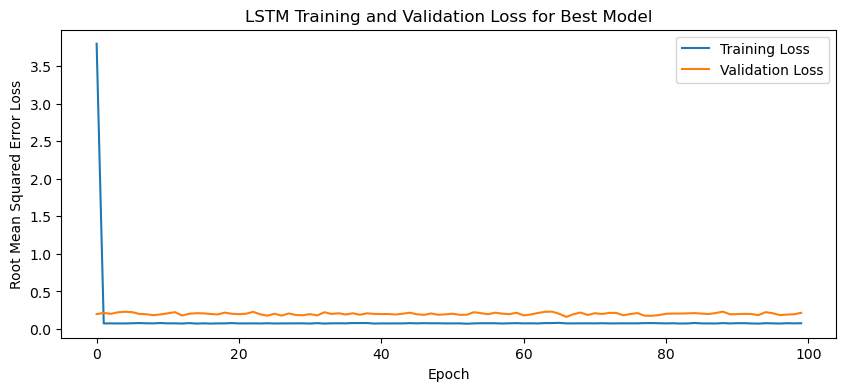

1/1 - 5s - loss: 0.0936 - 5s/epoch - 5s/step
Test Loss: 0.0935535877943039
1/1 [==============================] - 0s 146ms/step


IndexError: index 10 is out of bounds for axis 0 with size 10

In [3]:
n_batch = 1
nb_epoch = 100

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
 
# fit an LSTM network to training data
#Adapted from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch):

    cv_accuracies = []
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters to be tuned by Optuna (taken from Javier Leon's dissertation 'Fruit Prices')
    lr = trial.suggest_float('lr', 1e-3, 1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    if optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=lr)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=lr)
    else:
        optimizer = SGD(learning_rate=lr)
    
    #Optuna will try either Rectified Linear Unit (ReLU) = max(0, x), tanh, or sigmoid functions
    activation_function = trial.suggest_categorical('activation_function', ['relu', 'tanh', 'sigmoid'])
    
    lstm_units = trial.suggest_categorical('lstm_units', [256, 512, 1024])
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)

    # design network
    model = Sequential()
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer)
        
    return model

# make forecast with the CNN-LSTM best model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test):
    # plot the entire dataset in blue
    plt.plot(series.values)
    # plot the forecasts in red
    for i in range(len(forecasts)):
        off_s = len(series) - n_test + i - 1
        off_e = off_s + len(forecasts[i]) + 1
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = [series.values[off_s]] + forecasts[i]
        plt.plot(xaxis, yaxis, color='red')
    # show the plot
    plt.show()
    
def objective(trial):
    
    cv_accuracies = []
        
    for i in range(5):
        train1 = train[i]
        test1 = test[i]
        validation1 = validation[i]

        X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
        X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
        X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
        X = X.reshape(X.shape[0], 1, X.shape[1])
        X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
        X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])
    
        model = create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch)

        history = model.fit(X, y, validation_data=(X_val, y_val), epochs=nb_epoch, verbose=0)

        cv_accuracy = model.evaluate(X_test, y_test, verbose=0)
    
        loss = history.history['val_loss'][-1]
    
        # Plotting the training and validation loss
        #plt.figure(figsize=(10, 4))
        #plt.plot(history.history['loss'], label='Training Loss')
        #plt.plot(history.history['val_loss'], label='Validation Loss')
        #title1 = "LSTM Training and Validation Loss for Fold " + str(i+1)
        #plt.title(title1)
        #plt.xlabel('Epoch')
        #plt.ylabel('Root Mean Squared Error Loss')
        #plt.legend()
        #plt.show()
            
        cv_accuracies.append(cv_accuracy)
    
    print("Cross Validation Accuracies:")
    print(cv_accuracies)
    print("Mean Cross Validation Accuracy:")
    print(np.mean(cv_accuracies))
    print("Standard Deviation of Cross Validation Accuracy:")
    print(np.std(cv_accuracies))
        
    return np.mean(cv_accuracies)

n_batch = 1
nb_epoch = 100

# optimize and fit model
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)
print('Number of finished trials:', len(study.trials))

print('Best trial:', study.best_trial.params)
best_params = study.best_params
print("Best hyperparameters: ", best_params)

for i in range(5):
    print("Fold "+str(i+1)+":")
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
    X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
    X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (specific_humidity)
    
    X = X.reshape(X.shape[0], 1, X.shape[1])
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_model(optuna.trial.FixedTrial(best_params), X, y, n_lag, n_seq, n_batch, nb_epoch)
    history=best_model.fit(X, y, epochs=nb_epoch, batch_size=n_batch, validation_data=(X_val, y_val))

    # Plotting the training and validation loss
    plt.figure(figsize=(10, 4))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title1 = "LSTM Training and Validation Loss for Best Model"
    plt.title(title1)
    plt.xlabel('Epoch')
    plt.ylabel('Root Mean Squared Error Loss')
    plt.legend()
    plt.show()

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction
    
    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    for j in range(len(X_test)):
        print("Weather Station "+str(j+1)+":")
        dataset_df = pd.DataFrame(y_test[j].flatten())
        dataset = dataset_df.values
        dataset = dataset[:, 0]
        dataset = np.array(dataset).reshape(-1, 1)
        dataset = dataset.flatten()
        dataset = pd.DataFrame(dataset)
        series = scaler[i].inverse_transform(dataset)
        series = pd.Series(series.flatten())

    # plot forecasts
    plot_forecasts(series, forecasts, 1)
    
    best_model.summary()

    # Print out table of actual and predicted values for each weather station
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")

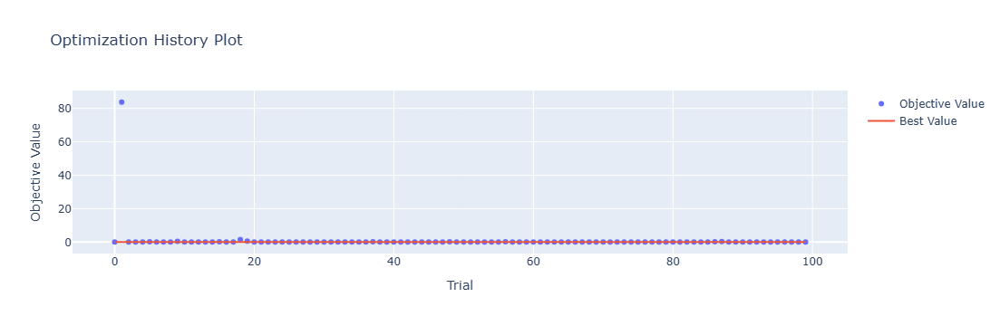

In [4]:
optuna.visualization.plot_optimization_history(study)

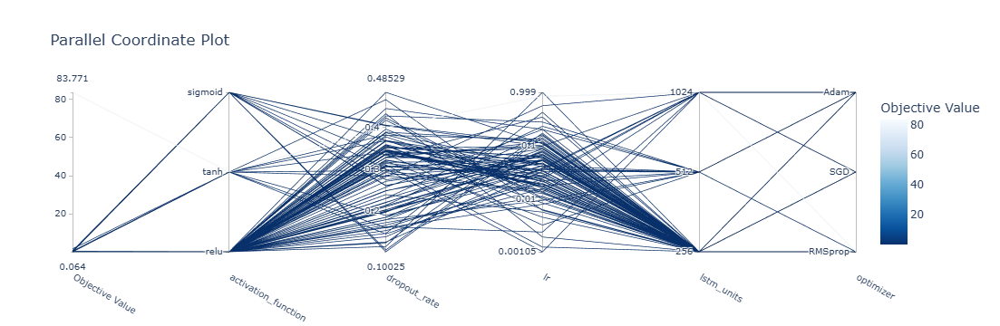

In [5]:
optuna.visualization.plot_parallel_coordinate(study)

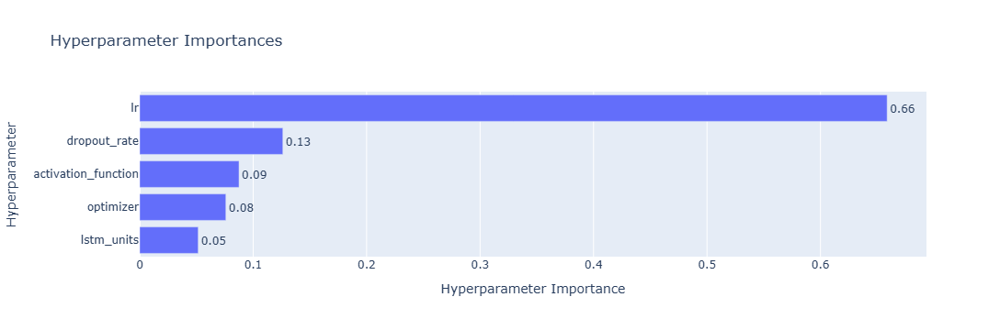

In [6]:
optuna.visualization.plot_param_importances(study)

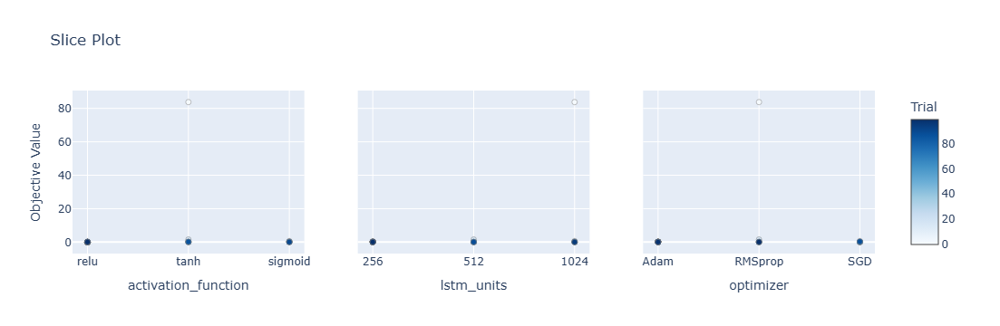

In [7]:
optuna.visualization.plot_slice(study, params=['optimizer', 'activation_function', 'lstm_units'])

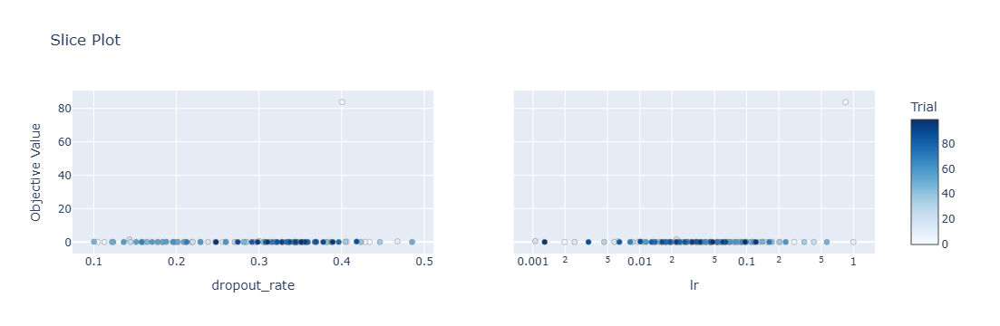

In [8]:
optuna.visualization.plot_slice(study, params=['lr', 'dropout_rate'])

Epoch 1/100
84/84 [==============================] - 28s 107ms/step - loss: 4.0666 - accuracy: 0.2024 - mae: 3.9397 - rmse: 4.0666 - mape: 869.5106 - pearson: 0.5245 - val_loss: 0.0697 - val_accuracy: 0.7000 - val_mae: 0.0551 - val_rmse: 0.0697 - val_mape: 11.7929 - val_pearson: 0.7376
Epoch 2/100
84/84 [==============================] - 3s 38ms/step - loss: 0.0715 - accuracy: 0.4286 - mae: 0.0571 - rmse: 0.0715 - mape: 12.9485 - pearson: 0.7367 - val_loss: 0.0684 - val_accuracy: 0.7000 - val_mae: 0.0553 - val_rmse: 0.0684 - val_mape: 11.7822 - val_pearson: 0.7461
Epoch 3/100
84/84 [==============================] - 4s 47ms/step - loss: 0.0738 - accuracy: 0.3452 - mae: 0.0581 - rmse: 0.0738 - mape: 13.1124 - pearson: 0.7336 - val_loss: 0.0667 - val_accuracy: 0.3000 - val_mae: 0.0514 - val_rmse: 0.0667 - val_mape: 11.4376 - val_pearson: 0.7397
Epoch 4/100
84/84 [==============================] - 3s 31ms/step - loss: 0.0760 - accuracy: 0.3452 - mae: 0.0603 - rmse: 0.0760 - mape: 13.5321 

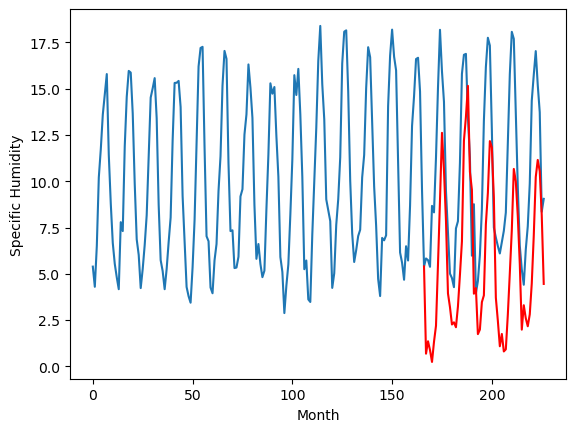

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.70		0.38		2.08
-1.37		1.05		2.42
-1.81		0.57		2.38
-1.08		-0.07		1.01
2.80		1.02		-1.78
1.01		1.89		0.88
3.33		5.20		1.87
7.01		8.64		1.63
8.67		12.31		3.64
8.61		10.28		1.67
6.51		7.56		1.05
3.95		3.63		-0.32
0.62		2.89		2.27
-2.90		1.95		4.85
-2.55		2.07		4.62
-1.84		1.80		3.64
0.37		2.93		2.56
0.59		4.63		4.04
3.08		6.44		3.36
7.83		11.88		4.05
8.63		13.17		4.54
8.79		14.84		6.05
6.63		10.20		3.57
3.55		9.23		5.68
-2.11		3.61		5.72
1.53		3.92		2.39
-3.23		1.43		4.66
-2.01		1.68		3.69
-0.10		3.16		3.26
1.20		3.53		2.33
5.44		7.37		1.93
8.05		9.06		1.01
8.95		11.86		2.91
8.38		11.52		3.14
5.32		8.79		3.47
0.18		3.40		3.22
-0.02		2.16		2.18
-1.22		0.78		2.00
-1.13		1.44		2.57
0.56		0.50		-0.06
0.94		0.61		-0.33
1.73		2.48		0.75
3.92		4.72		0.80
7.25		7.06		-0.19
8.92		10.36		1.44
9.70		9.69		-0.01
5.68		7.80		2.12
0.98		5.22		4.24
-1.20		1.68		2.88
-2.64		2.99		5.63
-3.42		2.29		5.71
-2.20

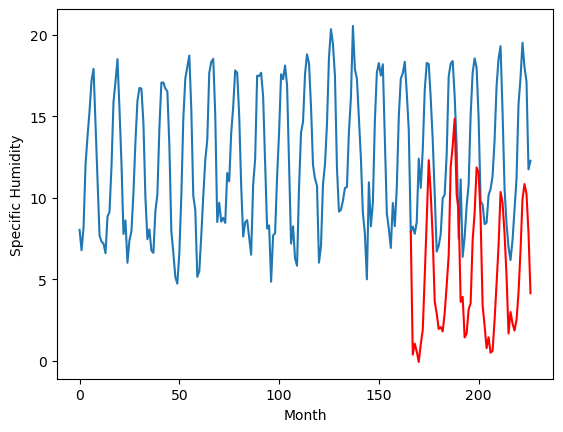

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.36		0.27		1.63
-1.11		0.94		2.05
-1.28		0.46		1.74
-0.73		-0.18		0.55
1.87		0.91		-0.96
0.62		1.78		1.16
3.48		5.09		1.61
7.39		8.53		1.14
9.79		12.20		2.41
9.88		10.17		0.29
6.79		7.45		0.66
4.04		3.52		-0.52
0.71		2.78		2.07
-2.45		1.84		4.29
-2.07		1.96		4.03
-1.92		1.69		3.61
-0.07		2.82		2.89
0.17		4.52		4.35
2.93		6.33		3.40
7.55		11.77		4.22
9.46		13.06		3.60
9.66		14.73		5.07
6.66		10.09		3.43
3.94		9.12		5.18
-1.93		3.50		5.43
0.47		3.81		3.34
-2.94		1.32		4.26
-1.73		1.57		3.30
-1.02		3.05		4.07
0.43		3.42		2.99
4.57		7.26		2.69
7.35		8.95		1.60
9.55		11.75		2.20
8.85		11.41		2.56
5.12		8.68		3.56
0.12		3.29		3.17
-0.20		2.05		2.25
-1.53		0.67		2.20
-1.16		1.33		2.49
-0.05		0.39		0.44
-0.69		0.50		1.19
0.75		2.37		1.62
3.53		4.61		1.08
6.11		6.95		0.84
8.97		10.25		1.28
9.06		9.58		0.52
5.48		7.69		2.21
1.57		5.11		3.54
-0.96		1.57		2.53
-1.77		2.88		4.65
-2.57		2.18		4.75
-1.93	

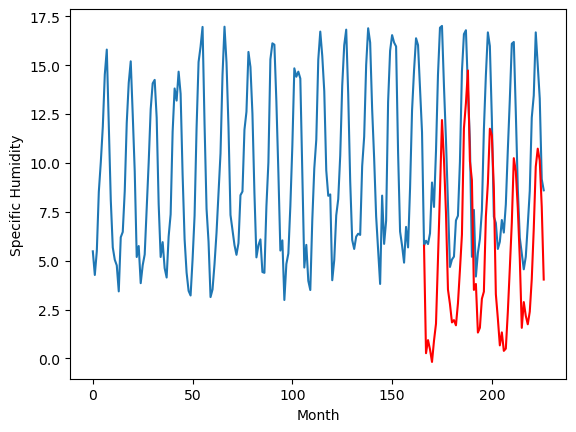

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.82		-0.03		1.79
-1.28		0.64		1.92
-1.04		0.16		1.20
-0.90		-0.48		0.42
3.41		0.61		-2.80
2.26		1.48		-0.78
4.41		4.79		0.38
6.90		8.23		1.33
9.65		11.90		2.25
8.40		9.87		1.47
7.05		7.15		0.10
3.24		3.22		-0.02
0.19		2.48		2.29
-2.88		1.54		4.42
-2.81		1.66		4.47
-2.90		1.39		4.29
0.55		2.52		1.97
1.12		4.22		3.10
4.63		6.03		1.40
8.53		11.47		2.94
9.37		12.76		3.39
8.99		14.43		5.44
6.68		9.79		3.11
4.25		8.82		4.57
-1.96		3.20		5.16
1.09		3.51		2.42
-4.03		1.02		5.05
-2.82		1.27		4.09
-1.73		2.75		4.48
1.19		3.12		1.93
5.43		6.96		1.53
7.44		8.65		1.21
8.65		11.45		2.80
7.93		11.11		3.18
4.55		8.38		3.83
-0.55		2.99		3.54
-1.07		1.75		2.82
-1.57		0.37		1.94
-1.38		1.03		2.41
-0.71		0.09		0.80
0.37		0.20		-0.17
0.77		2.07		1.30
3.62		4.31		0.69
7.77		6.65		-1.12
8.80		9.95		1.15
8.55		9.28		0.73
6.37		7.39		1.02
1.80		4.81		3.01
-1.19		1.27		2.46
-2.59		2.58		5.17
-3.51		1.88		5.39
-1.73	

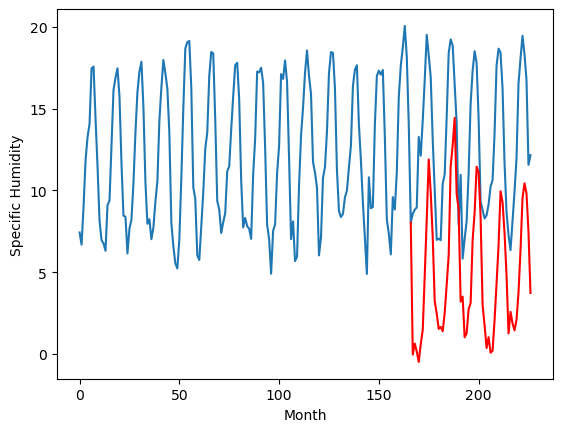

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.25		1.22		-1.03
1.00		1.89		0.89
1.79		1.41		-0.38
1.18		0.77		-0.41
5.63		1.86		-3.77
5.35		2.73		-2.62
7.93		6.04		-1.89
10.29		9.48		-0.81
13.15		13.15		-0.00
10.88		11.12		0.24
9.57		8.40		-1.17
5.29		4.47		-0.82
3.44		3.73		0.29
0.66		2.79		2.13
0.59		2.91		2.32
0.19		2.64		2.45
3.03		3.77		0.74
4.43		5.47		1.04
8.44		7.28		-1.16
12.13		12.72		0.59
12.84		14.01		1.17
12.76		15.68		2.92
8.53		11.04		2.51
6.44		10.07		3.63
2.22		4.45		2.23
4.98		4.76		-0.22
-0.52		2.27		2.79
-0.26		2.52		2.78
1.29		4.00		2.71
5.21		4.37		-0.84
8.91		8.21		-0.70
9.88		9.90		0.02
9.64		12.70		3.06
10.73		12.36		1.63
7.90		9.63		1.73
3.10		4.24		1.14
3.09		3.00		-0.09
2.01		1.62		-0.39
1.25		2.28		1.03
1.59		1.34		-0.25
3.78		1.45		-2.33
4.54		3.32		-1.22
8.48		5.56		-2.92
12.60		7.90		-4.70
11.18		11.20		0.02
9.36		10.53		1.17
9.32		8.64		-0.68
5.57		6.06		0.49
2.77		2.52		-0.25
0.91		3.83		2.92
-0.27		3.1

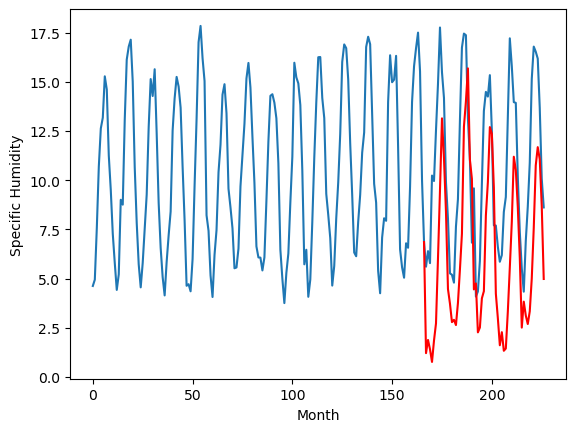

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.59		3.86		1.27
2.55		4.53		1.98
2.07		4.05		1.98
1.96		3.41		1.45
3.72		4.50		0.78
4.06		5.37		1.31
7.19		8.68		1.49
10.92		12.12		1.20
14.40		15.79		1.39
14.43		13.76		-0.67
11.53		11.04		-0.49
7.83		7.11		-0.72
4.88		6.37		1.49
1.12		5.43		4.31
0.51		5.55		5.04
1.10		5.28		4.18
2.67		6.41		3.74
3.68		8.11		4.43
6.18		9.92		3.74
11.44		15.36		3.92
12.56		16.65		4.09
13.72		18.32		4.60
9.63		13.68		4.05
7.31		12.71		5.40
2.05		7.09		5.04
3.47		7.40		3.93
0.36		4.91		4.55
1.74		5.16		3.42
3.07		6.64		3.57
4.20		7.01		2.81
8.98		10.85		1.87
10.07		12.54		2.47
14.40		15.34		0.94
12.61		15.00		2.39
9.91		12.27		2.36
5.27		6.88		1.61
4.61		5.64		1.03
1.26		4.26		3.00
2.01		4.92		2.91
2.94		3.98		1.04
2.72		4.09		1.37
5.40		5.96		0.56
6.16		8.20		2.04
10.06		10.54		0.48
14.41		13.84		-0.57
13.52		13.17		-0.35
10.40		11.28		0.88
6.00		8.70		2.70
2.98		5.16		2.18
2.16		6.47		4.31
1.37		5.77		4.40
1

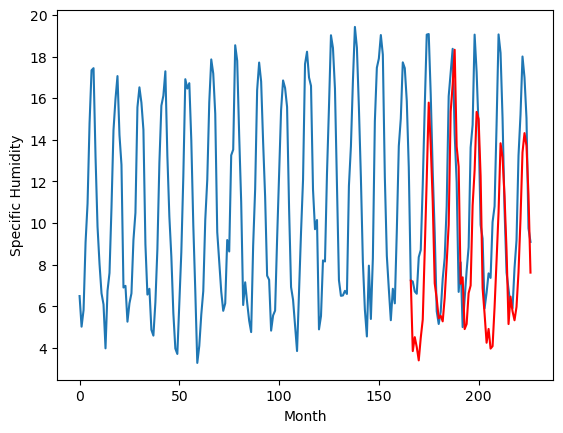

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.36		1.31		0.95
0.48		1.98		1.50
0.40		1.50		1.10
0.76		0.86		0.10
2.39		1.95		-0.44
2.17		2.82		0.65
5.27		6.13		0.86
8.99		9.57		0.58
11.78		13.24		1.46
11.72		11.21		-0.51
8.19		8.49		0.30
5.47		4.56		-0.91
2.62		3.82		1.20
-0.25		2.88		3.13
-0.40		3.00		3.40
-0.35		2.73		3.08
1.24		3.86		2.62
1.84		5.56		3.72
4.84		7.37		2.53
9.22		12.81		3.59
10.66		14.10		3.44
11.19		15.77		4.58
7.87		11.13		3.26
5.76		10.16		4.40
0.01		4.54		4.53
1.85		4.85		3.00
-0.93		2.36		3.29
0.35		2.61		2.26
1.36		4.09		2.73
2.36		4.46		2.10
6.72		8.30		1.58
8.60		9.99		1.39
12.22		12.79		0.57
10.87		12.45		1.58
7.43		9.72		2.29
2.87		4.33		1.46
2.27		3.09		0.82
0.09		1.71		1.62
0.95		2.37		1.42
1.63		1.43		-0.20
1.22		1.54		0.32
3.43		3.41		-0.02
5.02		5.65		0.63
7.75		7.99		0.24
11.49		11.29		-0.20
11.12		10.62		-0.50
8.18		8.73		0.55
3.92		6.15		2.23
0.59		2.61		2.02
0.52		3.92		3.40
-0.15		3.22		3.37
0.01		2

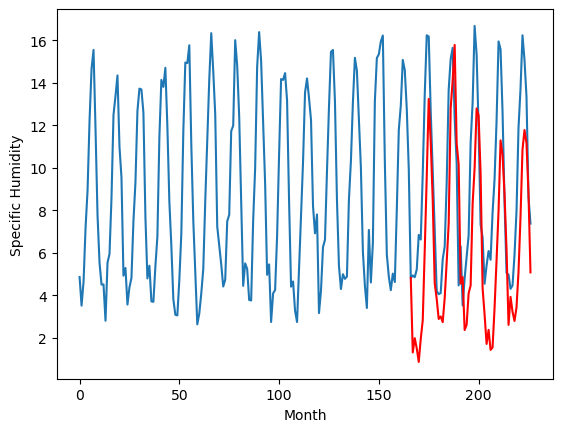

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.52		3.26		0.74
2.77		3.93		1.16
2.80		3.45		0.65
3.02		2.81		-0.21
4.32		3.90		-0.42
4.26		4.77		0.51
6.25		8.08		1.83
10.92		11.52		0.60
13.73		15.19		1.46
13.97		13.16		-0.81
10.07		10.44		0.37
7.36		6.51		-0.85
4.82		5.77		0.95
1.95		4.83		2.88
1.64		4.95		3.31
1.67		4.68		3.01
3.29		5.81		2.52
3.99		7.51		3.52
7.01		9.32		2.31
11.28		14.76		3.48
12.78		16.05		3.27
13.06		17.72		4.66
9.57		13.08		3.51
7.69		12.11		4.42
1.90		6.49		4.59
3.67		6.80		3.13
1.16		4.31		3.15
2.39		4.56		2.17
3.38		6.04		2.66
4.28		6.41		2.13
8.57		10.25		1.68
10.02		11.94		1.92
13.39		14.74		1.35
12.32		14.40		2.08
9.53		11.67		2.14
5.11		6.28		1.17
4.41		5.04		0.63
2.07		3.66		1.59
3.00		4.32		1.32
3.36		3.38		0.02
3.28		3.49		0.21
5.56		5.36		-0.20
6.88		7.60		0.72
9.50		9.94		0.44
13.85		13.24		-0.61
12.79		12.57		-0.22
9.99		10.68		0.69
6.24		8.10		1.86
2.72		4.56		1.84
2.92		5.87		2.95
2.23		5.17		2.94
2.

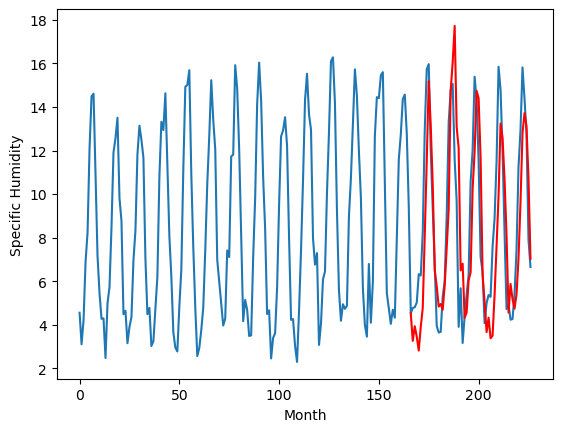

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.35		0.46		-0.89
1.44		1.13		-0.31
1.04		0.65		-0.39
1.03		0.01		-1.02
3.29		1.10		-2.19
3.53		1.97		-1.56
6.75		5.28		-1.47
10.40		8.72		-1.68
13.49		12.39		-1.10
11.46		10.36		-1.10
8.74		7.64		-1.10
4.29		3.71		-0.58
2.53		2.97		0.44
0.62		2.03		1.41
0.39		2.15		1.76
-0.29		1.88		2.17
2.77		3.01		0.24
3.50		4.71		1.21
6.41		6.52		0.11
11.39		11.96		0.57
12.89		13.25		0.36
13.08		14.92		1.84
9.27		10.28		1.01
6.85		9.31		2.46
1.56		3.69		2.13
3.15		4.00		0.85
-0.13		1.51		1.64
0.46		1.76		1.30
2.14		3.24		1.10
3.72		3.61		-0.11
7.91		7.45		-0.46
10.09		9.14		-0.95
13.75		11.94		-1.81
12.78		11.60		-1.18
8.33		8.87		0.54
3.10		3.48		0.38
2.10		2.24		0.14
1.17		0.86		-0.31
1.77		1.52		-0.25
1.84		0.58		-1.26
2.28		0.69		-1.59
3.50		2.56		-0.94
6.99		4.80		-2.19
9.27		7.14		-2.13
12.82		10.44		-2.38
12.82		9.77		-3.05
8.75		7.88		-0.87
4.69		5.30		0.61
2.03		1.76		-0.27
1.42		3.07		1.65
0.24	

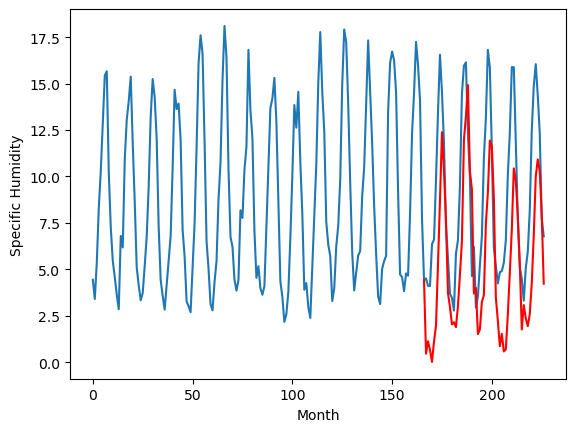

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.84		2.33		-0.51
3.25		3.00		-0.25
2.75		2.52		-0.23
2.43		1.88		-0.55
4.39		2.97		-1.42
4.45		3.84		-0.61
7.59		7.15		-0.44
10.28		10.59		0.31
13.42		14.26		0.84
12.20		12.23		0.03
9.41		9.51		0.10
6.07		5.58		-0.49
4.02		4.84		0.82
2.36		3.90		1.54
2.03		4.02		1.99
1.58		3.75		2.17
3.38		4.88		1.50
4.70		6.58		1.88
6.79		8.39		1.60
11.56		13.83		2.27
12.49		15.12		2.63
12.91		16.79		3.88
9.74		12.15		2.41
8.43		11.18		2.75
2.91		5.56		2.65
3.75		5.87		2.12
1.46		3.38		1.92
2.20		3.63		1.43
3.48		5.11		1.63
5.10		5.48		0.38
9.71		9.32		-0.39
11.39		11.01		-0.38
14.97		13.81		-1.16
13.43		13.47		0.04
10.37		10.74		0.37
4.58		5.35		0.77
3.86		4.11		0.25
2.93		2.73		-0.20
3.54		3.39		-0.15
3.31		2.45		-0.86
3.41		2.56		-0.85
5.14		4.43		-0.71
7.58		6.67		-0.91
10.20		9.01		-1.19
14.02		12.31		-1.71
12.72		11.64		-1.08
10.00		9.75		-0.25
6.76		7.17		0.41
3.41		3.63		0.22
3.60		4.94		1.34
2.63	

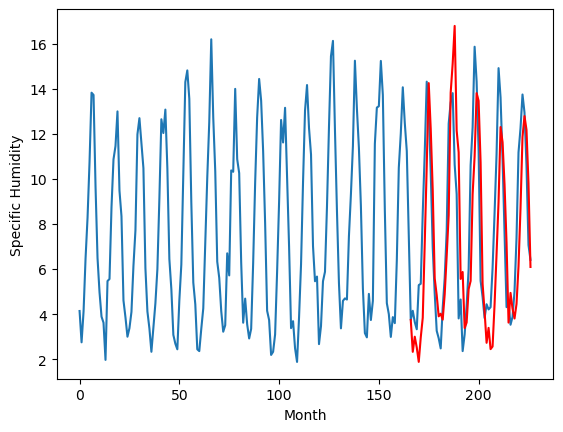

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.21		0.69		-0.52
1.33		1.36		0.03
0.95		0.88		-0.07
0.44		0.24		-0.20
2.04		1.33		-0.71
2.40		2.20		-0.20
5.30		5.51		0.21
8.40		8.95		0.55
11.45		12.62		1.17
9.88		10.59		0.71
7.22		7.87		0.65
3.77		3.94		0.17
2.36		3.20		0.84
0.83		2.26		1.43
0.45		2.38		1.93
-0.29		2.11		2.40
1.33		3.24		1.91
2.93		4.94		2.01
4.45		6.75		2.30
9.58		12.19		2.61
10.65		13.48		2.83
11.14		15.15		4.01
7.52		10.51		2.99
6.53		9.54		3.01
1.68		3.92		2.24
1.68		4.23		2.55
-0.39		1.74		2.13
0.21		1.99		1.78
1.46		3.47		2.01
2.40		3.84		1.44
6.12		7.68		1.56
7.39		9.37		1.98
9.88		12.17		2.29
10.87		11.83		0.96
8.27		9.10		0.83
3.25		3.71		0.46
2.11		2.47		0.36
0.94		1.09		0.15
1.34		1.75		0.41
0.78		0.81		0.03
1.24		0.92		-0.32
2.88		2.79		-0.09
4.09		5.03		0.94
7.10		7.37		0.27
10.93		10.67		-0.26
10.18		10.00		-0.18
8.87		8.11		-0.76
5.11		5.53		0.42
1.70		1.99		0.29
2.23		3.30		1.07
0.71		2.60		1.89
1.24		2.1

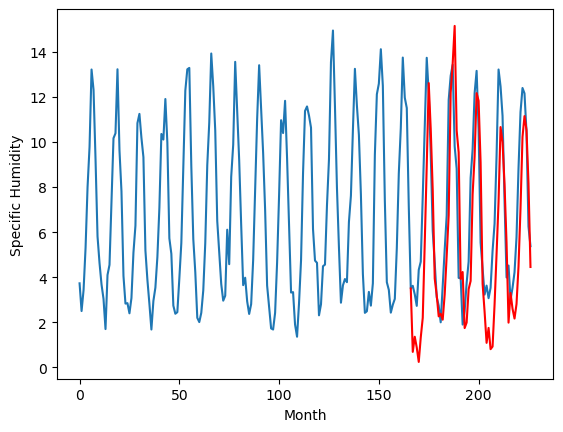

RangeIndex(start=1, stop=12, step=1)
[0.7500000000000009, -1.7000000000000002, -1.3600000000000003, -1.8200000000000012, 2.2500000000000004, 2.59, 0.3600000000000003, 2.5199999999999996, 1.3499999999999996, 2.84, 1.21]
[0.6875146484375003, 0.3775146484374998, 0.2675146484375004, -0.03248535156250032, 1.2175146484374997, 3.8575146484374994, 1.3075146484375004, 3.2575146484374997, 0.4575146484374999, 2.3275146484375, 0.6875146484375003]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.75   0.687515
1                 1   -1.70   0.377515
2                 2   -1.36   0.267515
3                 3   -1.82  -0.032485
4                 4    2.25   1.217515
5                 5    2.59   3.857515
6                 6    0.36   1.307515
7                 7    2.52   3.257515
8                 8    1.35   0.457515
9                 9    2.84   2.327515
10               10    1.21   0.687515


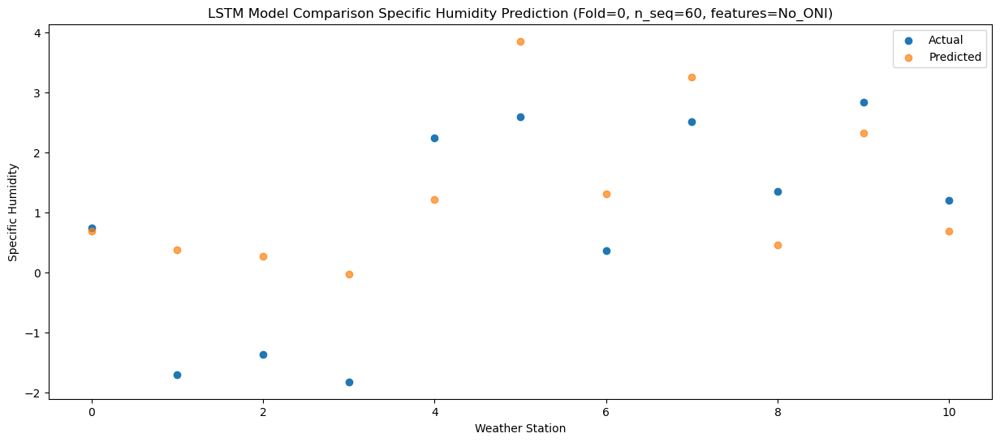

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    1.18   1.358937
1                 1   -1.37   1.048937
2                 2   -1.11   0.938937
3                 3   -1.28   0.638937
4                 4    1.00   1.888937
5                 5    2.55   4.528937
6                 6    0.48   1.978937
7                 7    2.77   3.928937
8                 8    1.44   1.128937
9                 9    3.25   2.998937
10               10    1.33   1.358937


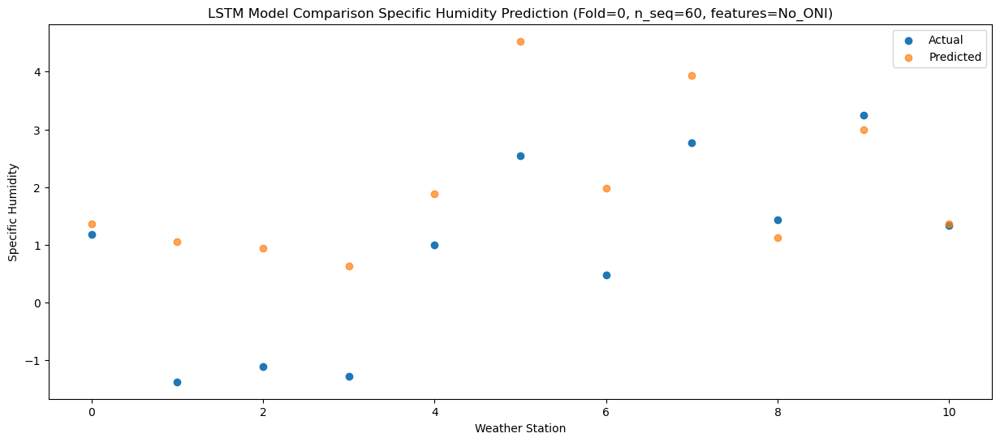

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    1.09   0.881372
1                 1   -1.81   0.571372
2                 2   -1.28   0.461372
3                 3   -1.04   0.161372
4                 4    1.79   1.411372
5                 5    2.07   4.051372
6                 6    0.40   1.501372
7                 7    2.80   3.451372
8                 8    1.04   0.651372
9                 9    2.75   2.521372
10               10    0.95   0.881372


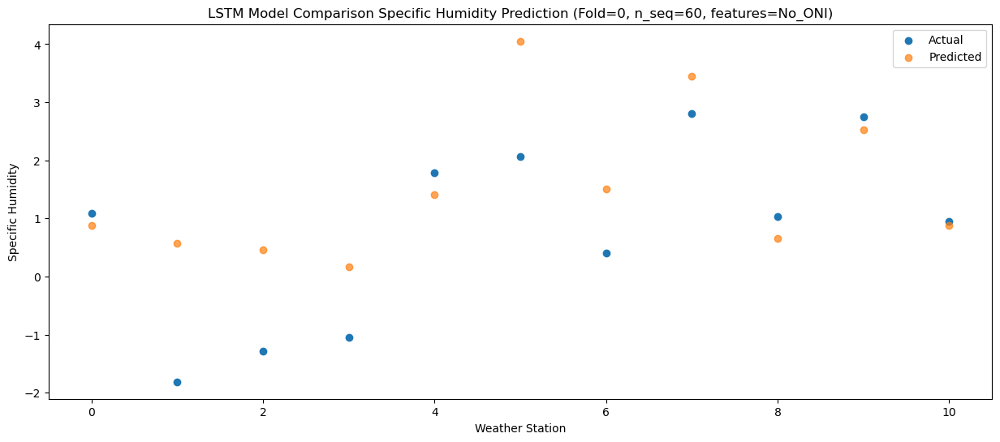

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.73   0.241975
1                 1   -1.08  -0.068025
2                 2   -0.73  -0.178025
3                 3   -0.90  -0.478025
4                 4    1.18   0.771975
5                 5    1.96   3.411975
6                 6    0.76   0.861975
7                 7    3.02   2.811975
8                 8    1.03   0.011975
9                 9    2.43   1.881975
10               10    0.44   0.241975


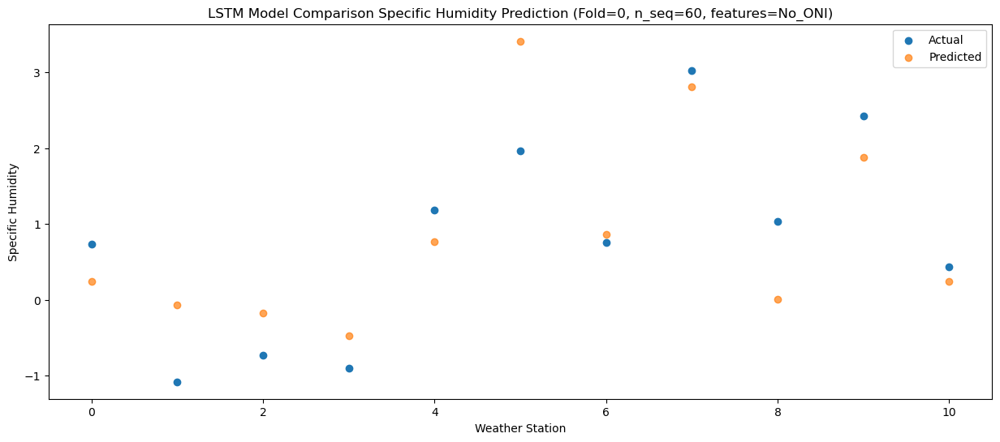

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    4.02   1.326343
1                 1    2.80   1.016343
2                 2    1.87   0.906343
3                 3    3.41   0.606343
4                 4    5.63   1.856343
5                 5    3.72   4.496343
6                 6    2.39   1.946343
7                 7    4.32   3.896343
8                 8    3.29   1.096343
9                 9    4.39   2.966343
10               10    2.04   1.326343


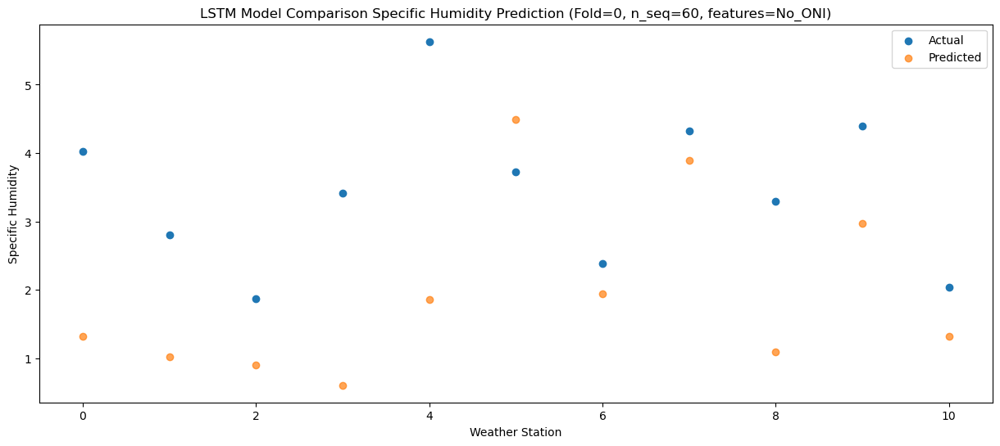

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.67   2.197114
1                 1    1.01   1.887114
2                 2    0.62   1.777114
3                 3    2.26   1.477114
4                 4    5.35   2.727114
5                 5    4.06   5.367114
6                 6    2.17   2.817114
7                 7    4.26   4.767114
8                 8    3.53   1.967114
9                 9    4.45   3.837114
10               10    2.40   2.197114


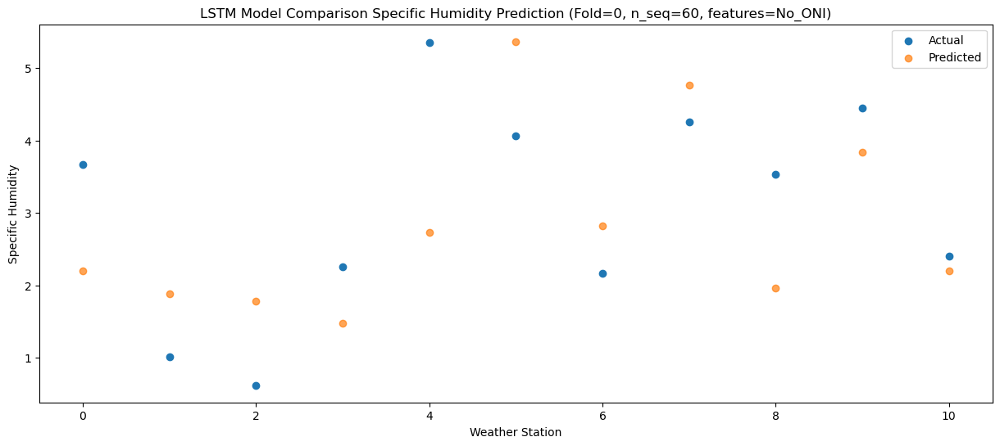

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    6.64   5.510797
1                 1    3.33   5.200797
2                 2    3.48   5.090797
3                 3    4.41   4.790797
4                 4    7.93   6.040797
5                 5    7.19   8.680797
6                 6    5.27   6.130797
7                 7    6.25   8.080797
8                 8    6.75   5.280797
9                 9    7.59   7.150797
10               10    5.30   5.510797


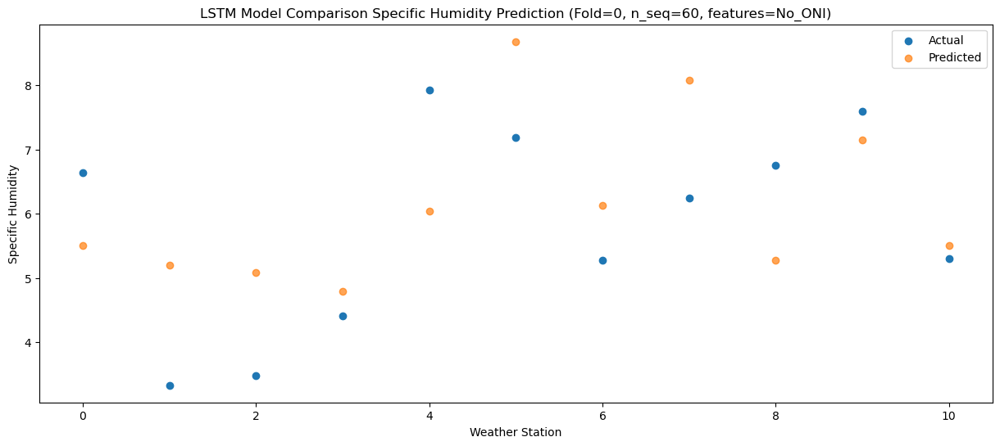

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   10.40   8.950648
1                 1    7.01   8.640648
2                 2    7.39   8.530648
3                 3    6.90   8.230648
4                 4   10.29   9.480648
5                 5   10.92  12.120648
6                 6    8.99   9.570648
7                 7   10.92  11.520648
8                 8   10.40   8.720648
9                 9   10.28  10.590648
10               10    8.40   8.950648


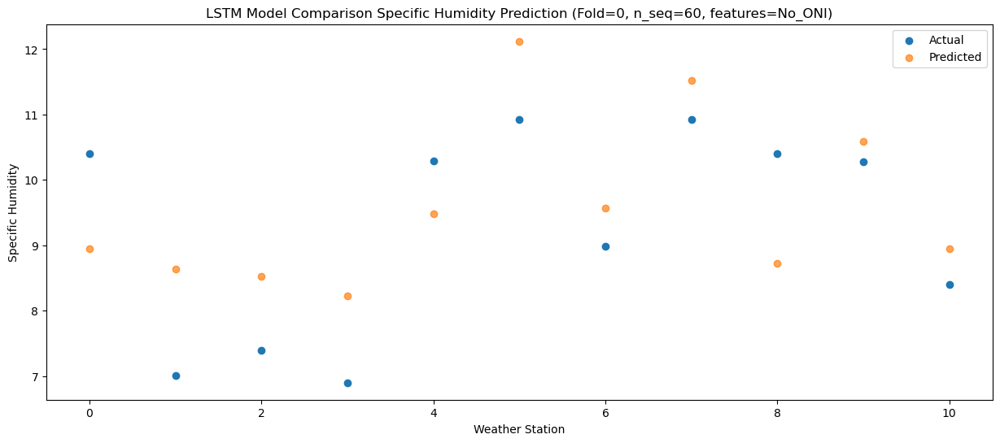

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   13.53  12.615448
1                 1    8.67  12.305448
2                 2    9.79  12.195448
3                 3    9.65  11.895448
4                 4   13.15  13.145448
5                 5   14.40  15.785448
6                 6   11.78  13.235448
7                 7   13.73  15.185448
8                 8   13.49  12.385448
9                 9   13.42  14.255448
10               10   11.45  12.615448


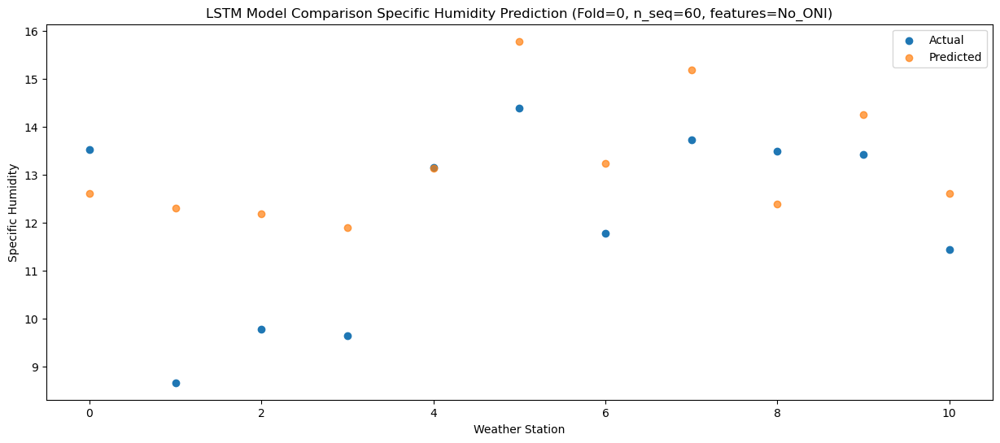

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   11.28   10.58562
1                 1    8.61   10.27562
2                 2    9.88   10.16562
3                 3    8.40    9.86562
4                 4   10.88   11.11562
5                 5   14.43   13.75562
6                 6   11.72   11.20562
7                 7   13.97   13.15562
8                 8   11.46   10.35562
9                 9   12.20   12.22562
10               10    9.88   10.58562


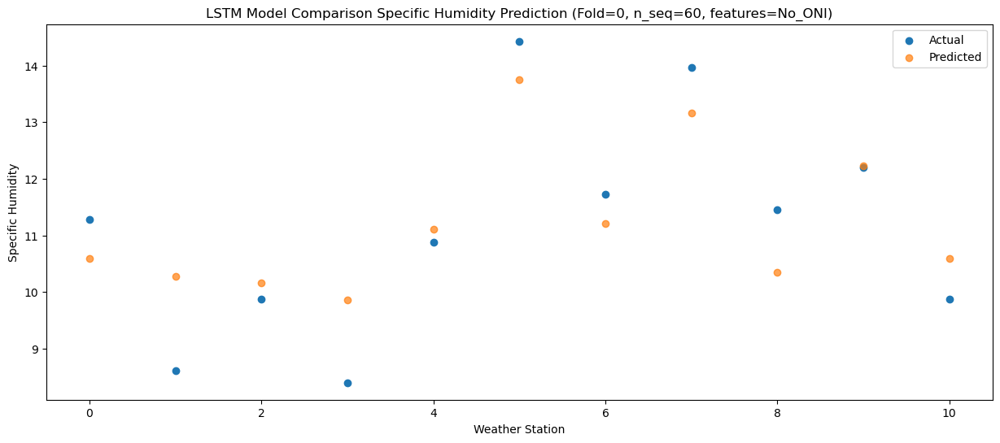

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    9.64   7.872828
1                 1    6.51   7.562828
2                 2    6.79   7.452828
3                 3    7.05   7.152828
4                 4    9.57   8.402828
5                 5   11.53  11.042828
6                 6    8.19   8.492828
7                 7   10.07  10.442828
8                 8    8.74   7.642828
9                 9    9.41   9.512828
10               10    7.22   7.872828


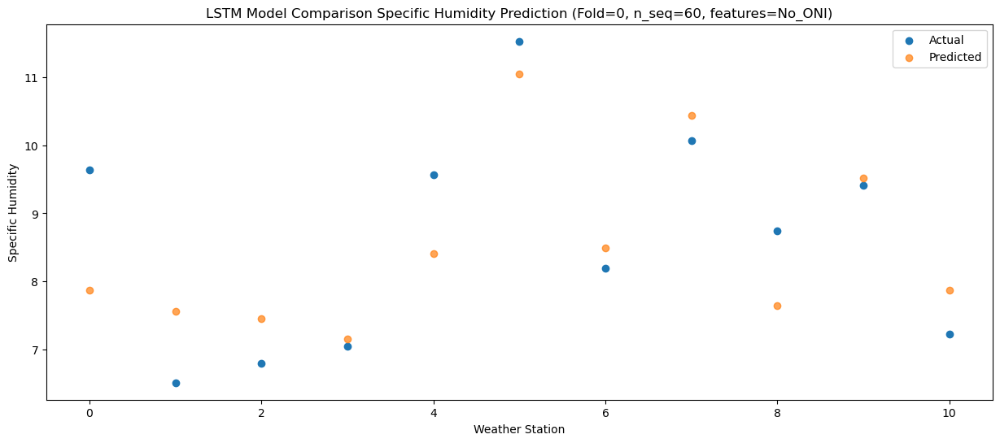

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.83   3.943911
1                 1    3.95   3.633911
2                 2    4.04   3.523911
3                 3    3.24   3.223911
4                 4    5.29   4.473911
5                 5    7.83   7.113911
6                 6    5.47   4.563911
7                 7    7.36   6.513911
8                 8    4.29   3.713911
9                 9    6.07   5.583911
10               10    3.77   3.943911


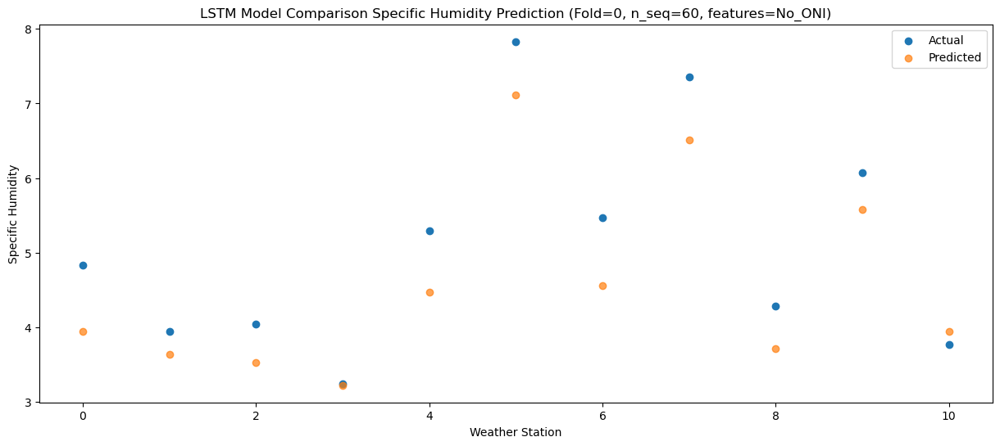

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    2.59   3.203177
1                 1    0.62   2.893177
2                 2    0.71   2.783177
3                 3    0.19   2.483177
4                 4    3.44   3.733177
5                 5    4.88   6.373177
6                 6    2.62   3.823177
7                 7    4.82   5.773177
8                 8    2.53   2.973177
9                 9    4.02   4.843177
10               10    2.36   3.203177


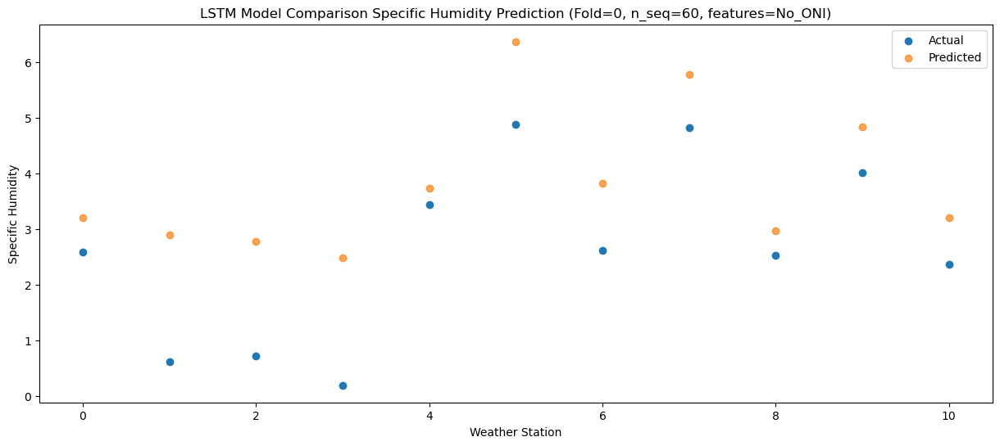

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    0.36   2.263295
1                 1   -2.90   1.953295
2                 2   -2.45   1.843295
3                 3   -2.88   1.543295
4                 4    0.66   2.793295
5                 5    1.12   5.433295
6                 6   -0.25   2.883295
7                 7    1.95   4.833295
8                 8    0.62   2.033295
9                 9    2.36   3.903295
10               10    0.83   2.263295


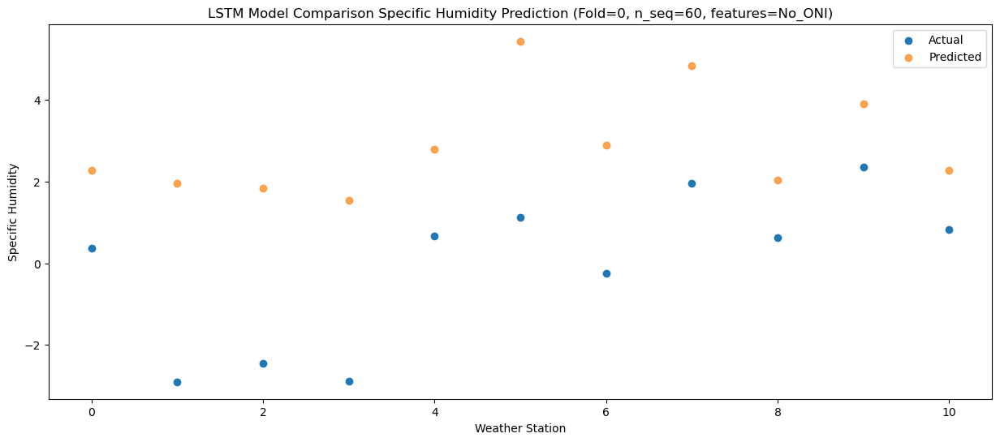

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0    0.12   2.380342
1                 1   -2.55   2.070342
2                 2   -2.07   1.960342
3                 3   -2.81   1.660342
4                 4    0.59   2.910342
5                 5    0.51   5.550342
6                 6   -0.40   3.000342
7                 7    1.64   4.950342
8                 8    0.39   2.150342
9                 9    2.03   4.020342
10               10    0.45   2.380342


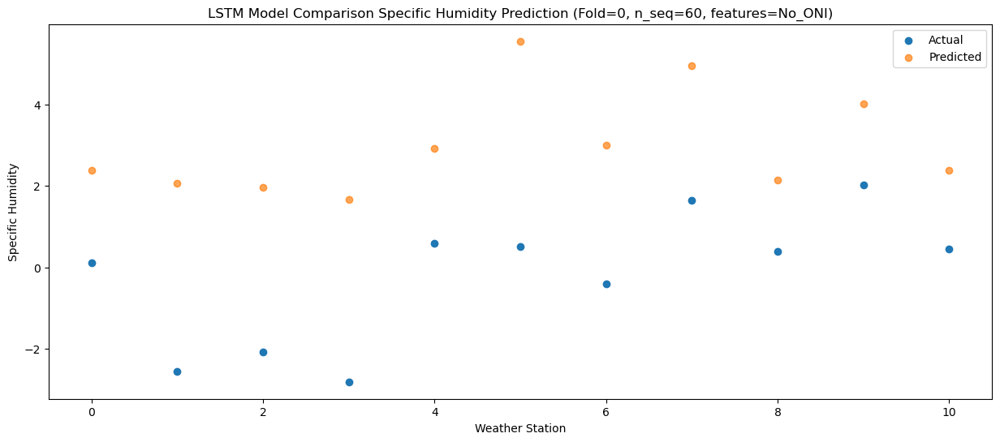

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -0.37   2.114765
1                 1   -1.84   1.804765
2                 2   -1.92   1.694765
3                 3   -2.90   1.394765
4                 4    0.19   2.644765
5                 5    1.10   5.284765
6                 6   -0.35   2.734765
7                 7    1.67   4.684765
8                 8   -0.29   1.884765
9                 9    1.58   3.754765
10               10   -0.29   2.114765


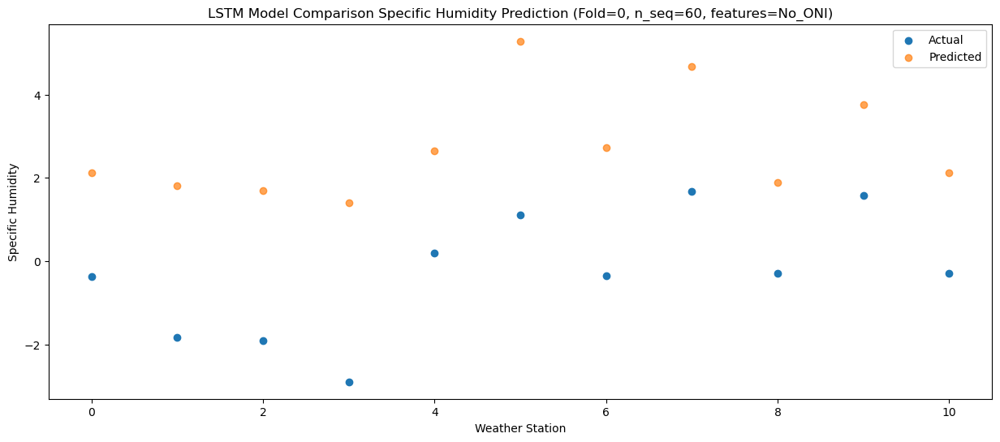

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.80   3.239174
1                 1    0.37   2.929174
2                 2   -0.07   2.819174
3                 3    0.55   2.519174
4                 4    3.03   3.769174
5                 5    2.67   6.409174
6                 6    1.24   3.859174
7                 7    3.29   5.809174
8                 8    2.77   3.009174
9                 9    3.38   4.879174
10               10    1.33   3.239174


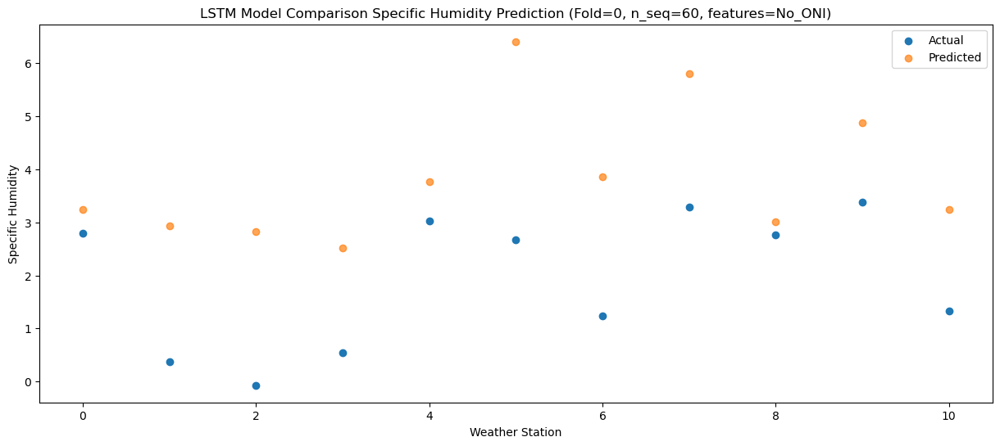

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    3.19    4.94397
1                 1    0.59    4.63397
2                 2    0.17    4.52397
3                 3    1.12    4.22397
4                 4    4.43    5.47397
5                 5    3.68    8.11397
6                 6    1.84    5.56397
7                 7    3.99    7.51397
8                 8    3.50    4.71397
9                 9    4.70    6.58397
10               10    2.93    4.94397


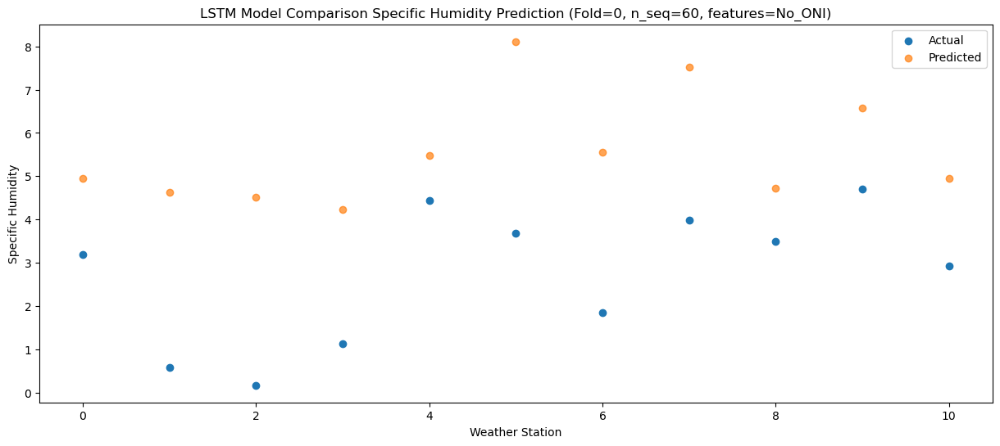

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    6.34   6.753073
1                 1    3.08   6.443073
2                 2    2.93   6.333073
3                 3    4.63   6.033073
4                 4    8.44   7.283073
5                 5    6.18   9.923073
6                 6    4.84   7.373073
7                 7    7.01   9.323073
8                 8    6.41   6.523073
9                 9    6.79   8.393073
10               10    4.45   6.753073


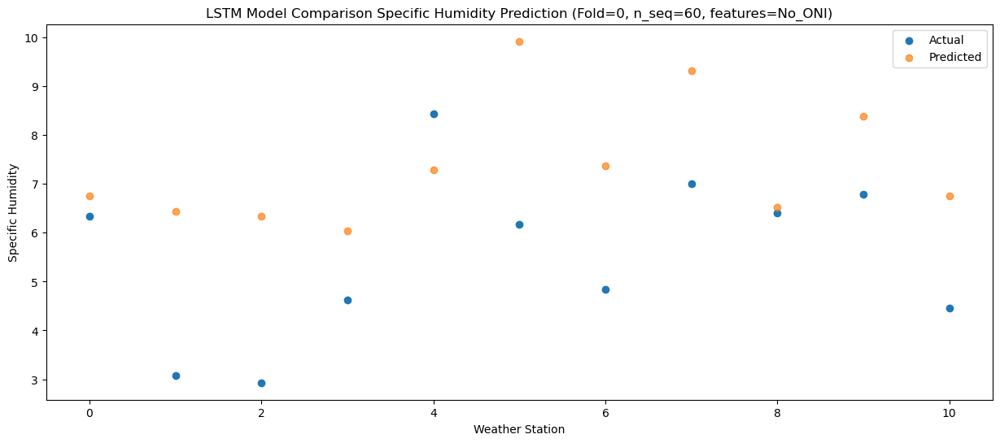

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   11.15  12.188788
1                 1    7.83  11.878788
2                 2    7.55  11.768788
3                 3    8.53  11.468788
4                 4   12.13  12.718788
5                 5   11.44  15.358788
6                 6    9.22  12.808788
7                 7   11.28  14.758788
8                 8   11.39  11.958788
9                 9   11.56  13.828788
10               10    9.58  12.188788


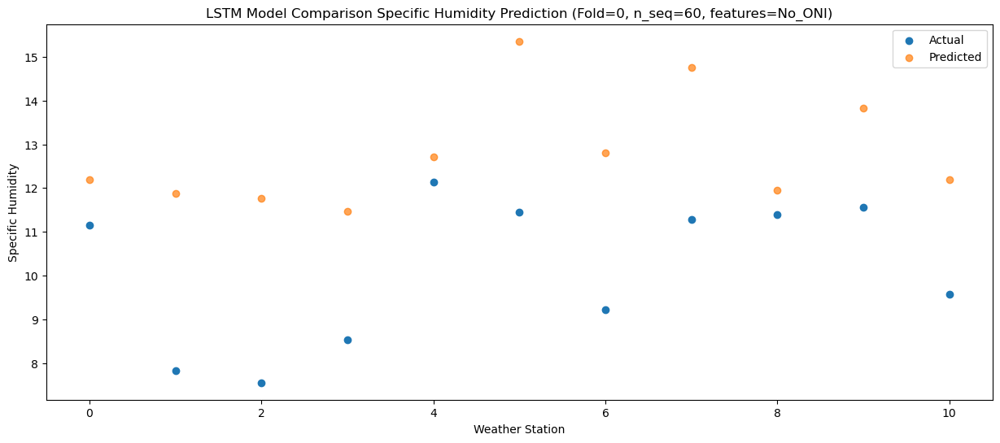

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   12.18  13.479583
1                 1    8.63  13.169583
2                 2    9.46  13.059583
3                 3    9.37  12.759583
4                 4   12.84  14.009583
5                 5   12.56  16.649583
6                 6   10.66  14.099583
7                 7   12.78  16.049583
8                 8   12.89  13.249583
9                 9   12.49  15.119583
10               10   10.65  13.479583


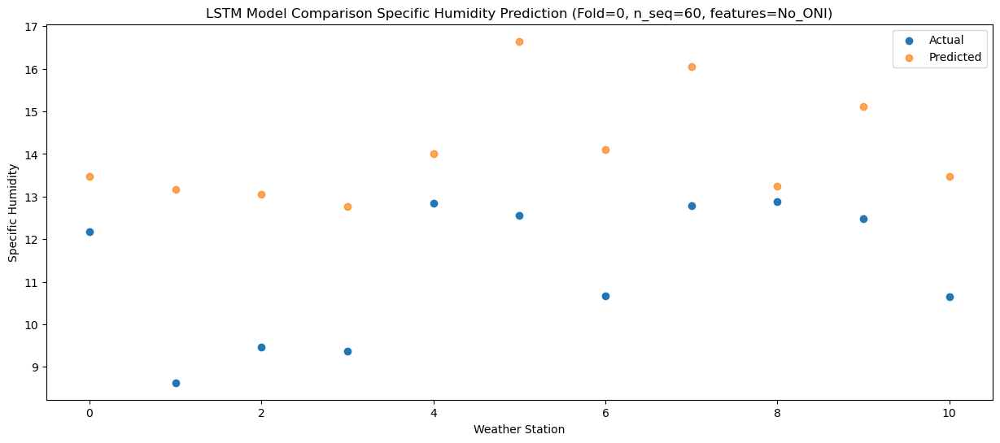

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   12.23  15.153909
1                 1    8.79  14.843909
2                 2    9.66  14.733909
3                 3    8.99  14.433909
4                 4   12.76  15.683909
5                 5   13.72  18.323909
6                 6   11.19  15.773909
7                 7   13.06  17.723909
8                 8   13.08  14.923909
9                 9   12.91  16.793909
10               10   11.14  15.153909


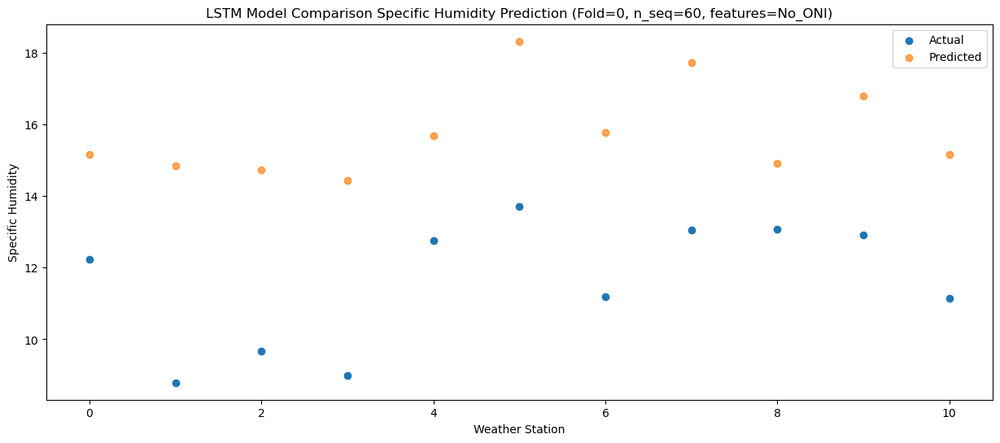

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    8.81  10.509546
1                 1    6.63  10.199546
2                 2    6.66  10.089546
3                 3    6.68   9.789546
4                 4    8.53  11.039546
5                 5    9.63  13.679546
6                 6    7.87  11.129546
7                 7    9.57  13.079546
8                 8    9.27  10.279546
9                 9    9.74  12.149546
10               10    7.52  10.509546


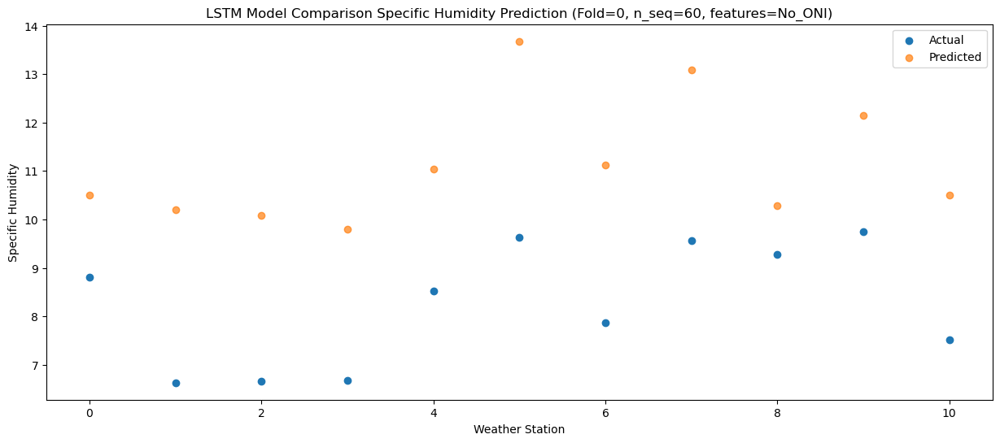

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    6.63   9.541697
1                 1    3.55   9.231697
2                 2    3.94   9.121697
3                 3    4.25   8.821697
4                 4    6.44  10.071697
5                 5    7.31  12.711697
6                 6    5.76  10.161697
7                 7    7.69  12.111697
8                 8    6.85   9.311697
9                 9    8.43  11.181697
10               10    6.53   9.541697


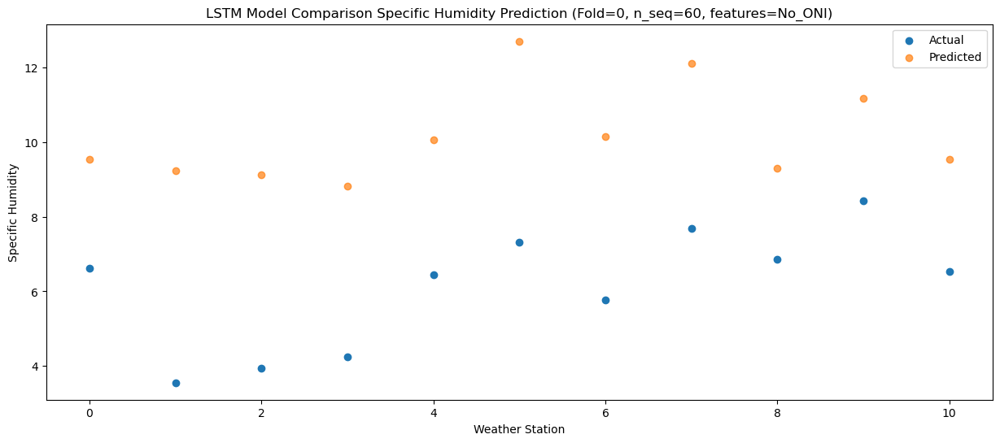

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    1.33   3.924427
1                 1   -2.11   3.614427
2                 2   -1.93   3.504427
3                 3   -1.96   3.204427
4                 4    2.22   4.454427
5                 5    2.05   7.094427
6                 6    0.01   4.544427
7                 7    1.90   6.494427
8                 8    1.56   3.694427
9                 9    2.91   5.564427
10               10    1.68   3.924427


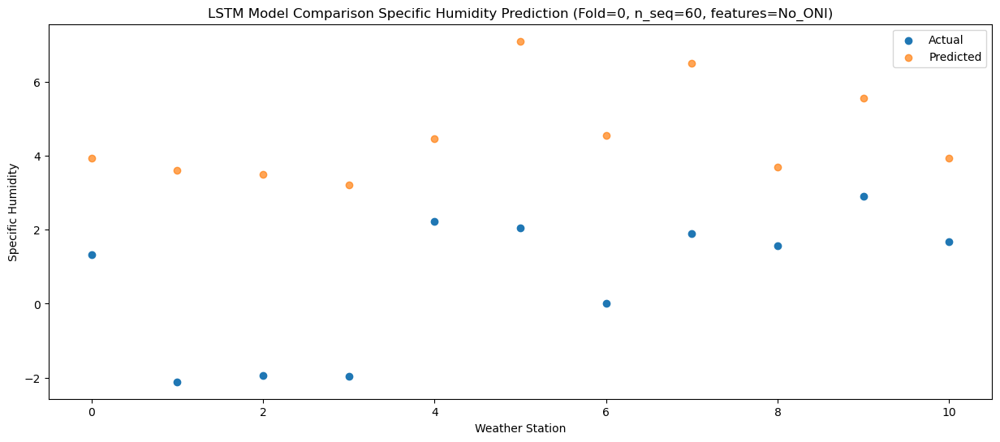

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    4.11   4.231235
1                 1    1.53   3.921235
2                 2    0.47   3.811235
3                 3    1.09   3.511235
4                 4    4.98   4.761235
5                 5    3.47   7.401235
6                 6    1.85   4.851235
7                 7    3.67   6.801235
8                 8    3.15   4.001235
9                 9    3.75   5.871235
10               10    1.68   4.231235


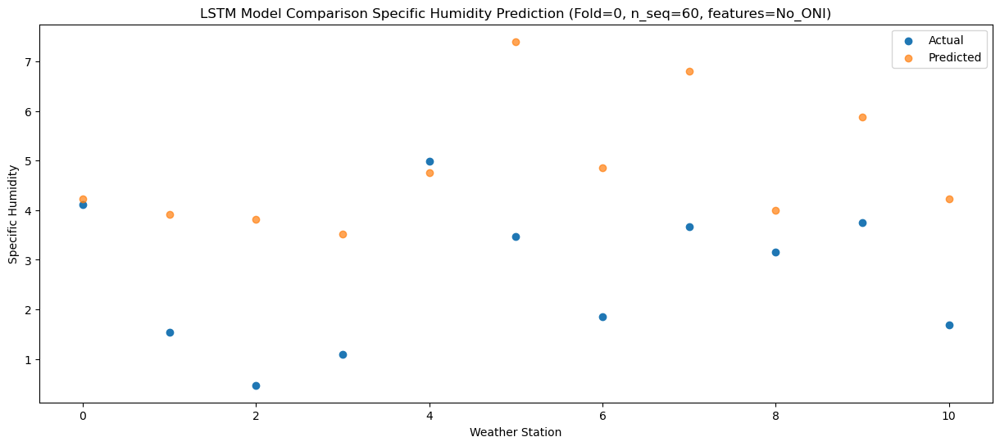

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -0.70   1.743332
1                 1   -3.23   1.433332
2                 2   -2.94   1.323332
3                 3   -4.03   1.023332
4                 4   -0.52   2.273332
5                 5    0.36   4.913332
6                 6   -0.93   2.363332
7                 7    1.16   4.313332
8                 8   -0.13   1.513332
9                 9    1.46   3.383332
10               10   -0.39   1.743332


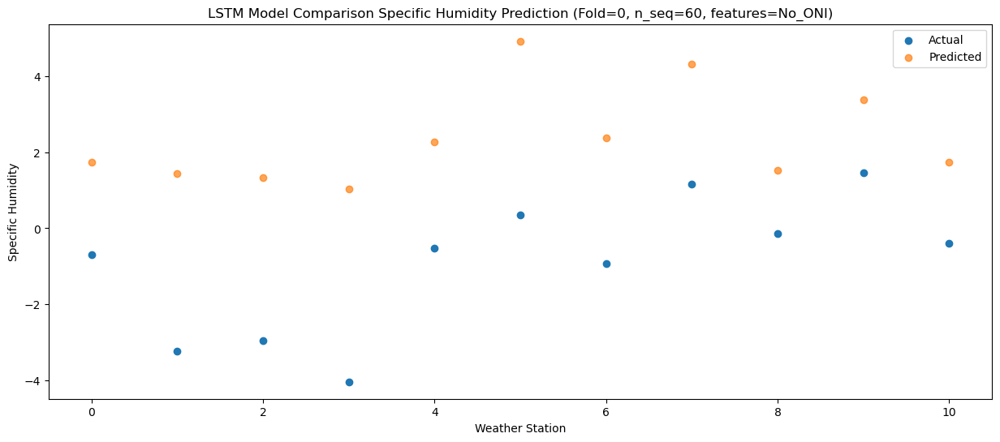

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.04   1.989279
1                 1   -2.01   1.679279
2                 2   -1.73   1.569279
3                 3   -2.82   1.269279
4                 4   -0.26   2.519279
5                 5    1.74   5.159279
6                 6    0.35   2.609279
7                 7    2.39   4.559279
8                 8    0.46   1.759279
9                 9    2.20   3.629279
10               10    0.21   1.989279


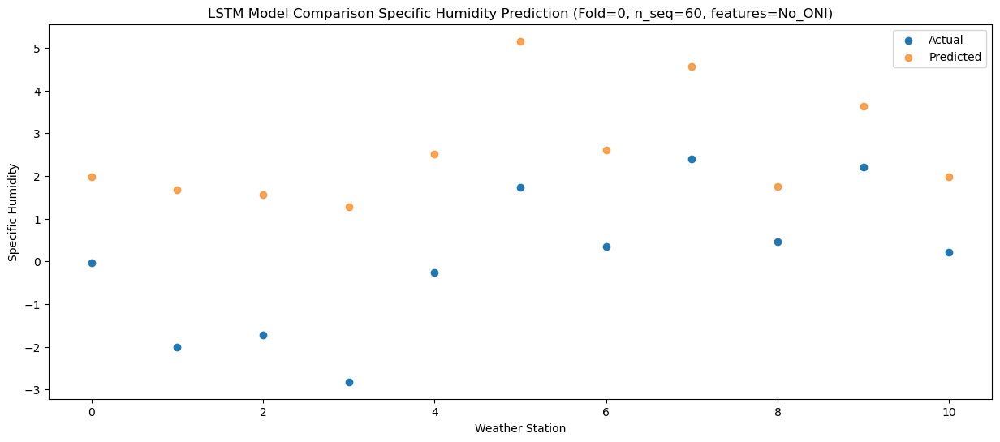

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    1.36   3.472215
1                 1   -0.10   3.162215
2                 2   -1.02   3.052215
3                 3   -1.73   2.752215
4                 4    1.29   4.002215
5                 5    3.07   6.642215
6                 6    1.36   4.092215
7                 7    3.38   6.042215
8                 8    2.14   3.242215
9                 9    3.48   5.112215
10               10    1.46   3.472215


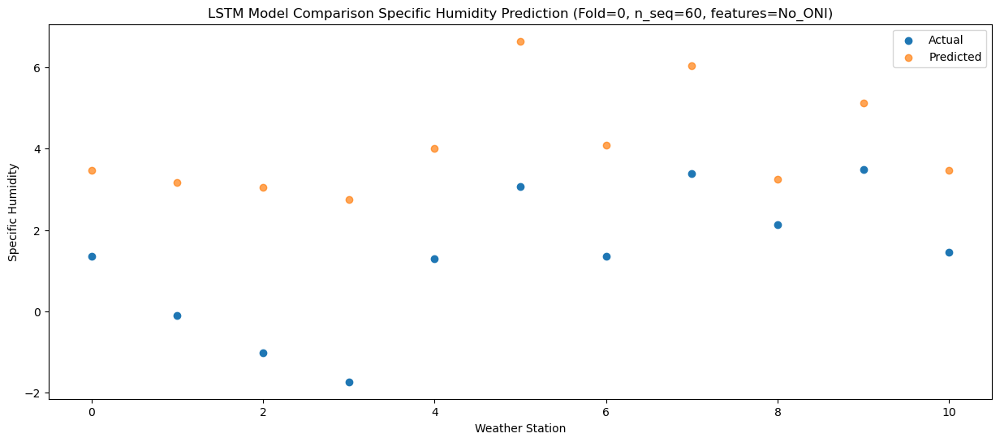

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    3.83   3.835055
1                 1    1.20   3.525055
2                 2    0.43   3.415055
3                 3    1.19   3.115055
4                 4    5.21   4.365055
5                 5    4.20   7.005055
6                 6    2.36   4.455055
7                 7    4.28   6.405055
8                 8    3.72   3.605055
9                 9    5.10   5.475055
10               10    2.40   3.835055


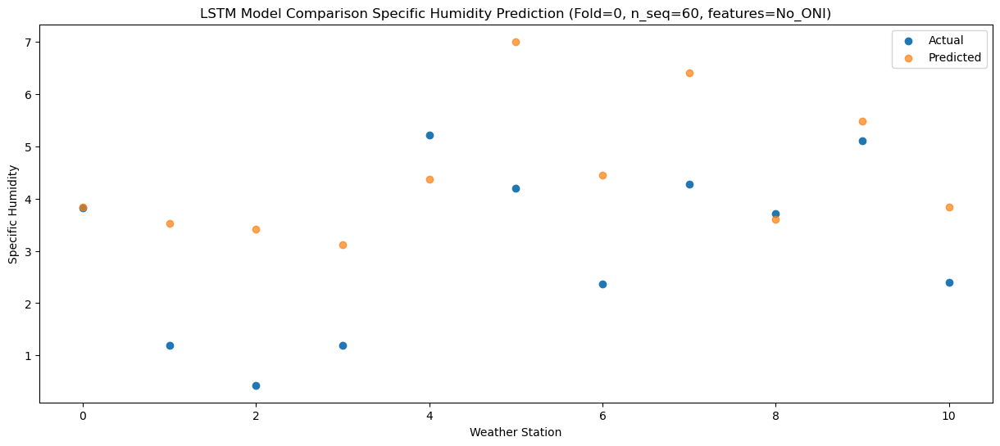

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    8.60   7.680152
1                 1    5.44   7.370152
2                 2    4.57   7.260152
3                 3    5.43   6.960152
4                 4    8.91   8.210152
5                 5    8.98  10.850152
6                 6    6.72   8.300152
7                 7    8.57  10.250152
8                 8    7.91   7.450152
9                 9    9.71   9.320152
10               10    6.12   7.680152


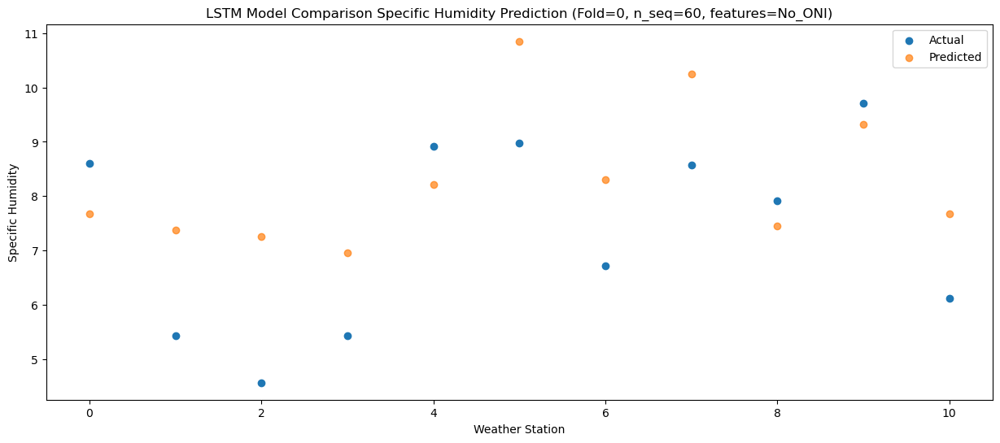

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   11.52    9.37153
1                 1    8.05    9.06153
2                 2    7.35    8.95153
3                 3    7.44    8.65153
4                 4    9.88    9.90153
5                 5   10.07   12.54153
6                 6    8.60    9.99153
7                 7   10.02   11.94153
8                 8   10.09    9.14153
9                 9   11.39   11.01153
10               10    7.39    9.37153


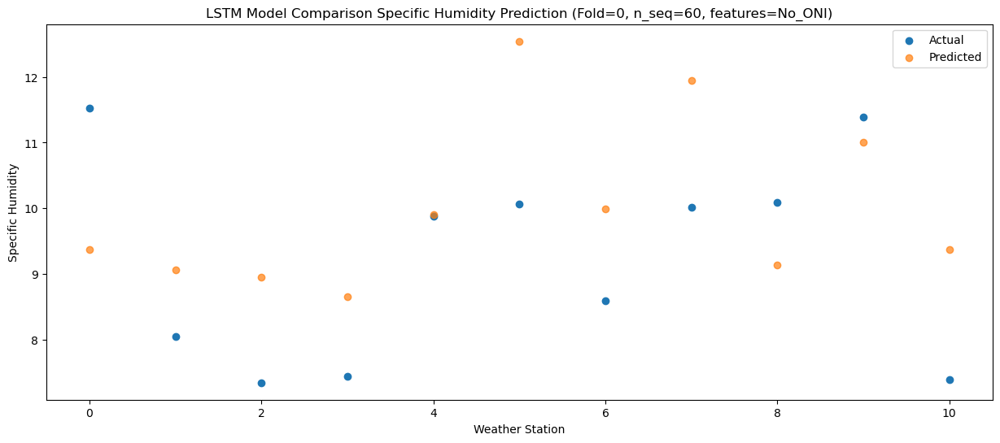

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   13.10  12.170186
1                 1    8.95  11.860186
2                 2    9.55  11.750186
3                 3    8.65  11.450186
4                 4    9.64  12.700186
5                 5   14.40  15.340186
6                 6   12.22  12.790186
7                 7   13.39  14.740186
8                 8   13.75  11.940186
9                 9   14.97  13.810186
10               10    9.88  12.170186


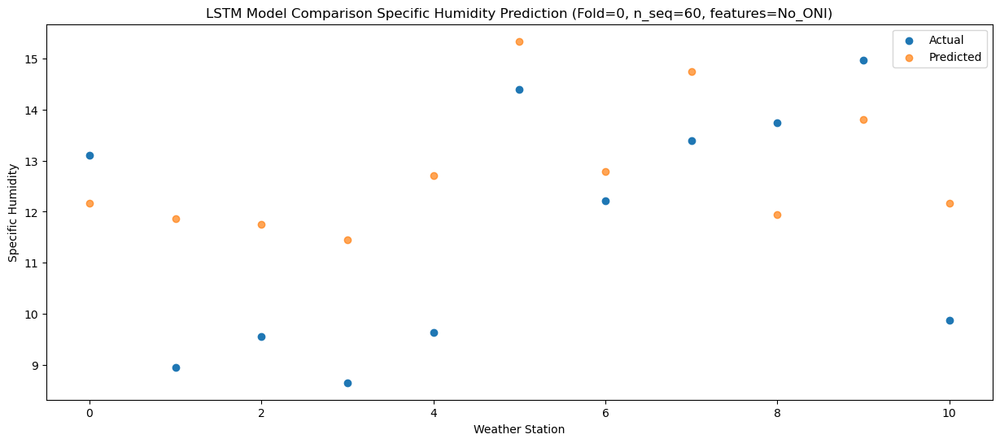

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   12.68  11.830119
1                 1    8.38  11.520119
2                 2    8.85  11.410119
3                 3    7.93  11.110119
4                 4   10.73  12.360119
5                 5   12.61  15.000119
6                 6   10.87  12.450119
7                 7   12.32  14.400119
8                 8   12.78  11.600119
9                 9   13.43  13.470119
10               10   10.87  11.830119


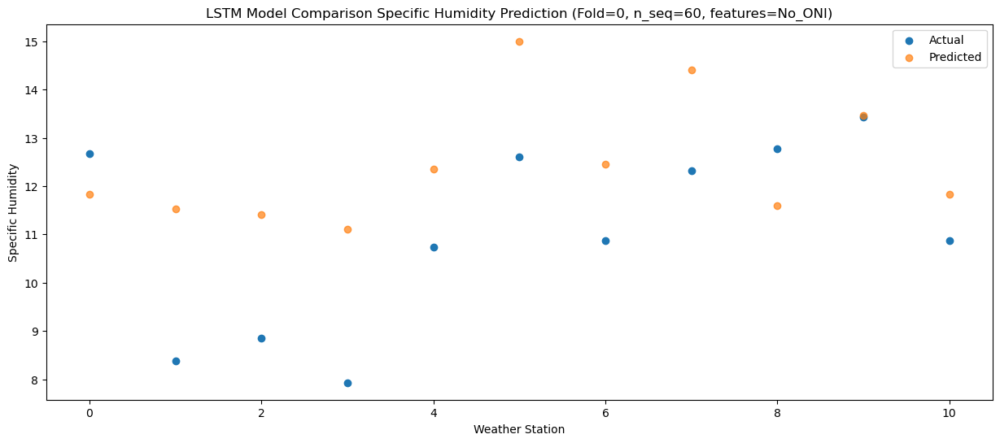

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    8.13   9.095936
1                 1    5.32   8.785936
2                 2    5.12   8.675936
3                 3    4.55   8.375936
4                 4    7.90   9.625936
5                 5    9.91  12.265936
6                 6    7.43   9.715936
7                 7    9.53  11.665936
8                 8    8.33   8.865936
9                 9   10.37  10.735936
10               10    8.27   9.095936


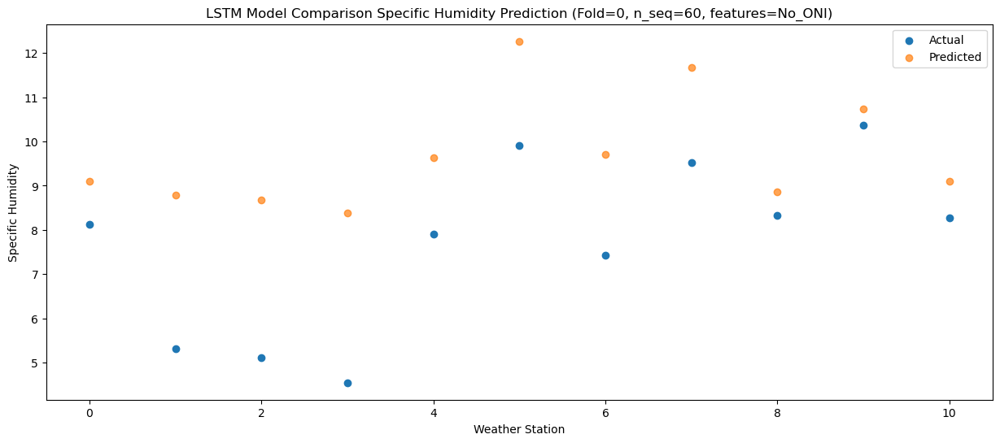

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    2.85   3.708717
1                 1    0.18   3.398717
2                 2    0.12   3.288717
3                 3   -0.55   2.988717
4                 4    3.10   4.238717
5                 5    5.27   6.878717
6                 6    2.87   4.328717
7                 7    5.11   6.278717
8                 8    3.10   3.478717
9                 9    4.58   5.348717
10               10    3.25   3.708717


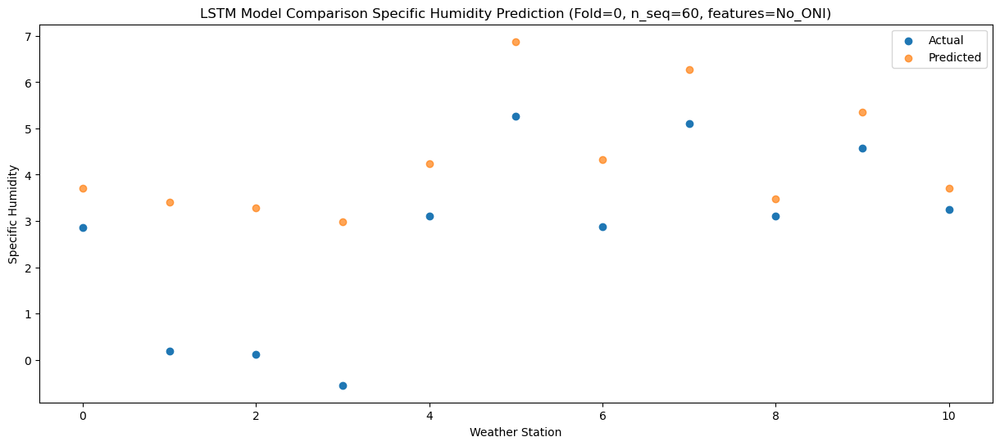

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    2.31   2.467698
1                 1   -0.02   2.157698
2                 2   -0.20   2.047698
3                 3   -1.07   1.747698
4                 4    3.09   2.997698
5                 5    4.61   5.637698
6                 6    2.27   3.087698
7                 7    4.41   5.037698
8                 8    2.10   2.237698
9                 9    3.86   4.107698
10               10    2.11   2.467698


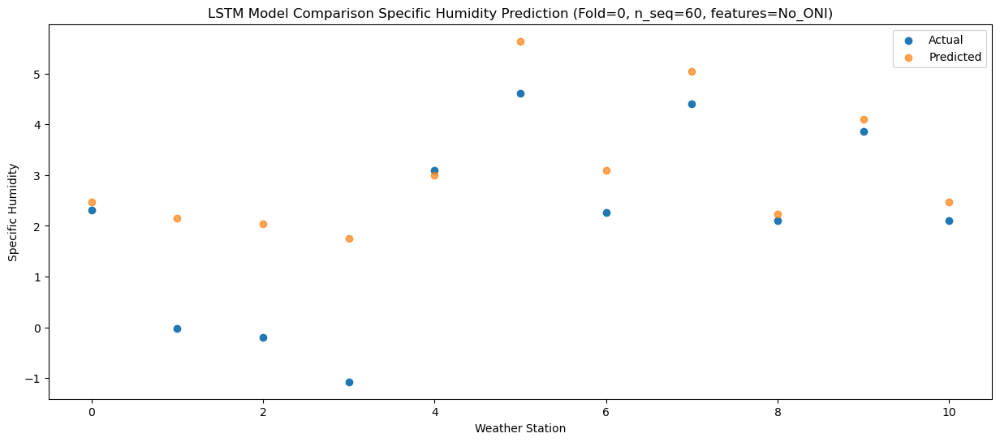

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.85   1.088226
1                 1   -1.22   0.778226
2                 2   -1.53   0.668226
3                 3   -1.57   0.368226
4                 4    2.01   1.618226
5                 5    1.26   4.258226
6                 6    0.09   1.708226
7                 7    2.07   3.658226
8                 8    1.17   0.858226
9                 9    2.93   2.728226
10               10    0.94   1.088226


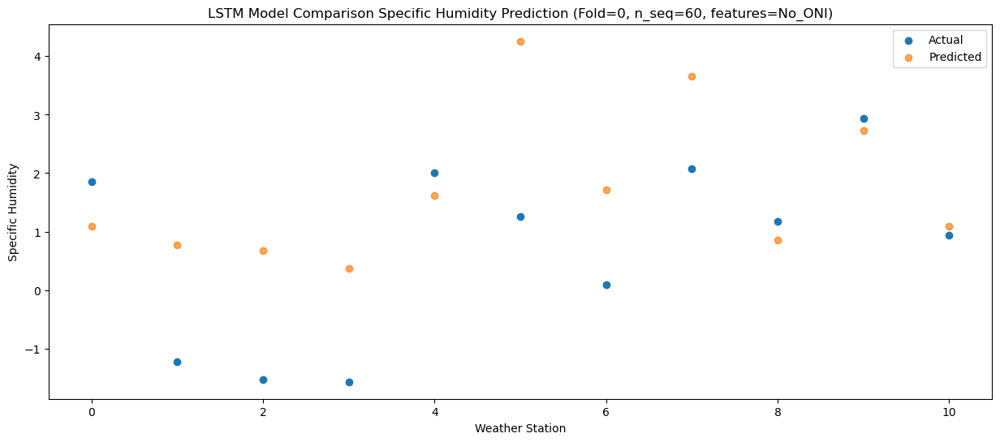

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    1.45    1.75198
1                 1   -1.13    1.44198
2                 2   -1.16    1.33198
3                 3   -1.38    1.03198
4                 4    1.25    2.28198
5                 5    2.01    4.92198
6                 6    0.95    2.37198
7                 7    3.00    4.32198
8                 8    1.77    1.52198
9                 9    3.54    3.39198
10               10    1.34    1.75198


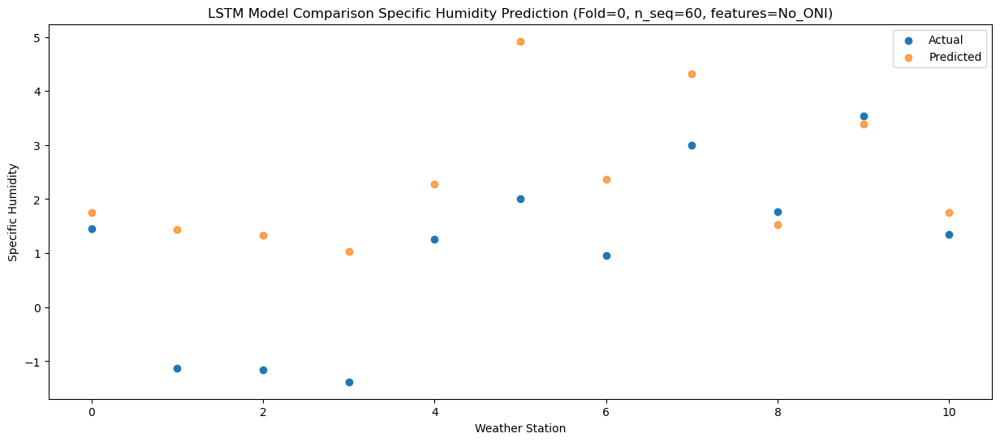

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    2.07    0.80754
1                 1    0.56    0.49754
2                 2   -0.05    0.38754
3                 3   -0.71    0.08754
4                 4    1.59    1.33754
5                 5    2.94    3.97754
6                 6    1.63    1.42754
7                 7    3.36    3.37754
8                 8    1.84    0.57754
9                 9    3.31    2.44754
10               10    0.78    0.80754


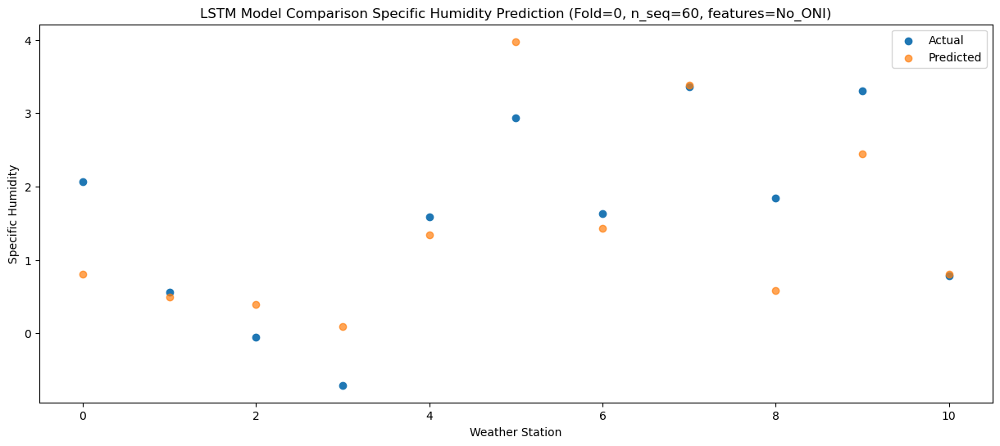

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    2.67   0.923674
1                 1    0.94   0.613674
2                 2   -0.69   0.503674
3                 3    0.37   0.203674
4                 4    3.78   1.453674
5                 5    2.72   4.093674
6                 6    1.22   1.543674
7                 7    3.28   3.493674
8                 8    2.28   0.693674
9                 9    3.41   2.563674
10               10    1.24   0.923674


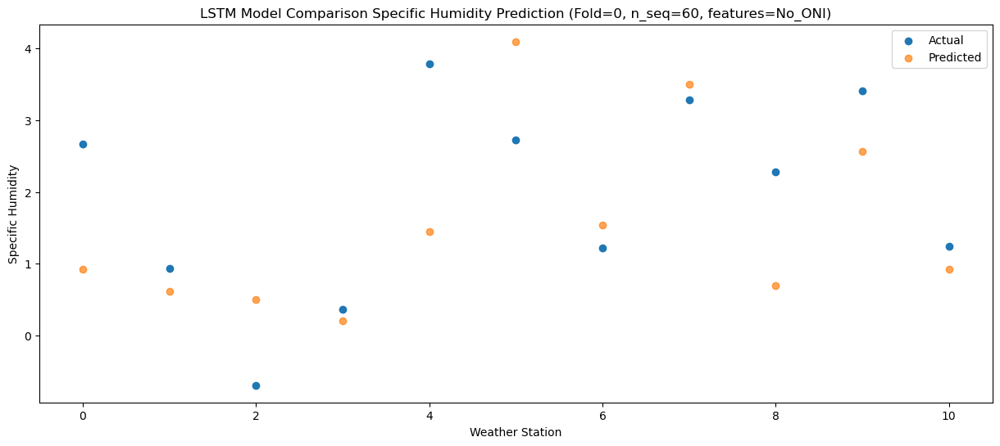

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    3.66   2.790853
1                 1    1.73   2.480853
2                 2    0.75   2.370853
3                 3    0.77   2.070853
4                 4    4.54   3.320853
5                 5    5.40   5.960853
6                 6    3.43   3.410853
7                 7    5.56   5.360853
8                 8    3.50   2.560853
9                 9    5.14   4.430853
10               10    2.88   2.790853


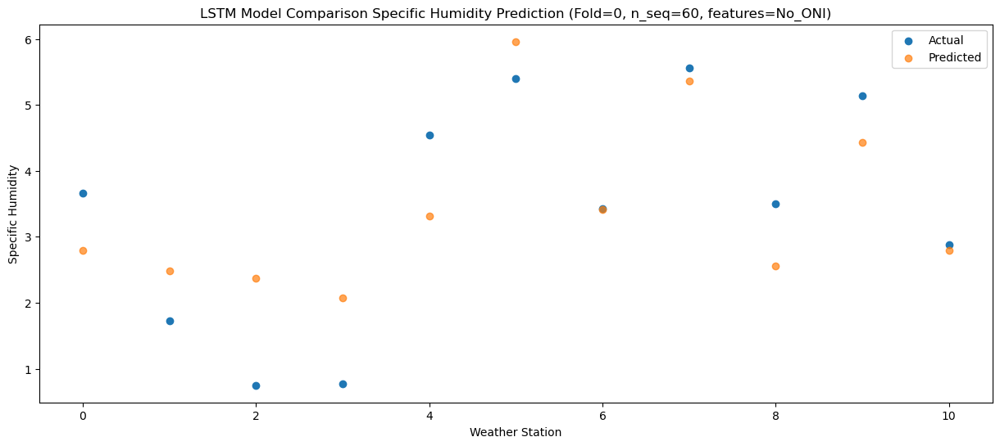

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    7.34   5.034532
1                 1    3.92   4.724532
2                 2    3.53   4.614532
3                 3    3.62   4.314532
4                 4    8.48   5.564532
5                 5    6.16   8.204532
6                 6    5.02   5.654532
7                 7    6.88   7.604532
8                 8    6.99   4.804532
9                 9    7.58   6.674532
10               10    4.09   5.034532


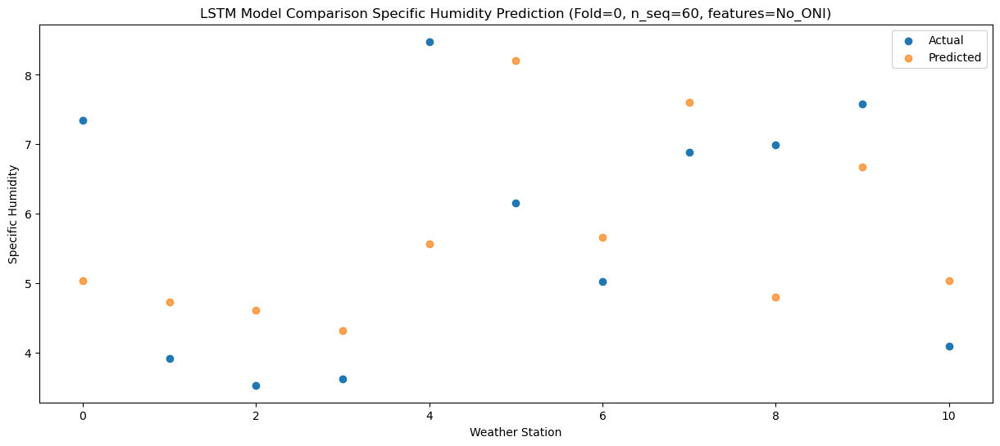

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   11.13   7.365261
1                 1    7.25   7.055261
2                 2    6.11   6.945261
3                 3    7.77   6.645261
4                 4   12.60   7.895261
5                 5   10.06  10.535261
6                 6    7.75   7.985261
7                 7    9.50   9.935261
8                 8    9.27   7.135261
9                 9   10.20   9.005261
10               10    7.10   7.365261


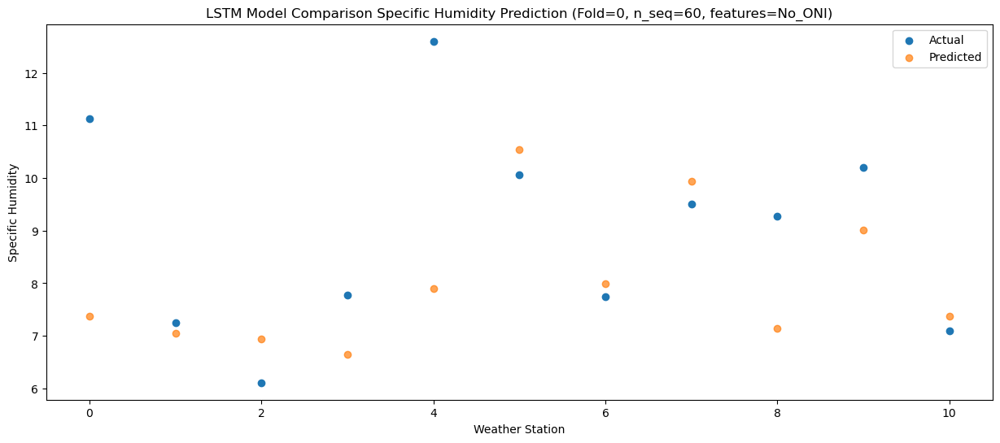

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   13.42  10.665136
1                 1    8.92  10.355136
2                 2    8.97  10.245136
3                 3    8.80   9.945136
4                 4   11.18  11.195136
5                 5   14.41  13.835136
6                 6   11.49  11.285136
7                 7   13.85  13.235136
8                 8   12.82  10.435136
9                 9   14.02  12.305136
10               10   10.93  10.665136


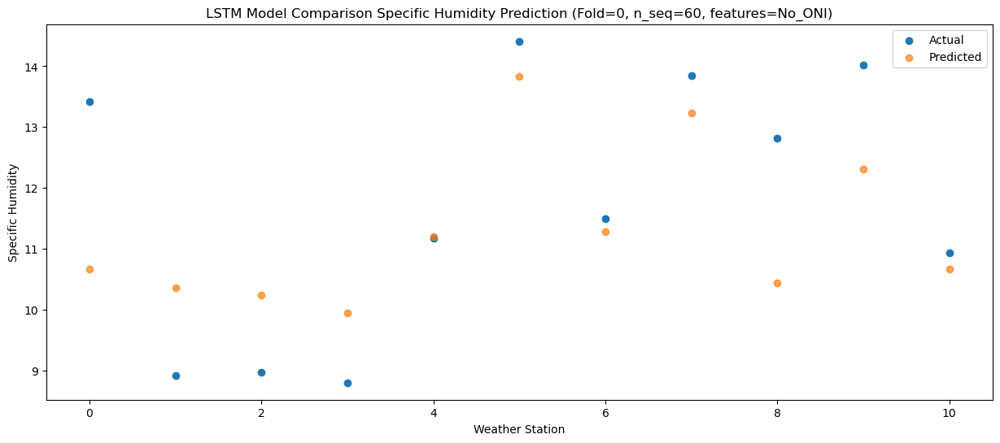

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   13.04    9.99723
1                 1    9.70    9.68723
2                 2    9.06    9.57723
3                 3    8.55    9.27723
4                 4    9.36   10.52723
5                 5   13.52   13.16723
6                 6   11.12   10.61723
7                 7   12.79   12.56723
8                 8   12.82    9.76723
9                 9   12.72   11.63723
10               10   10.18    9.99723


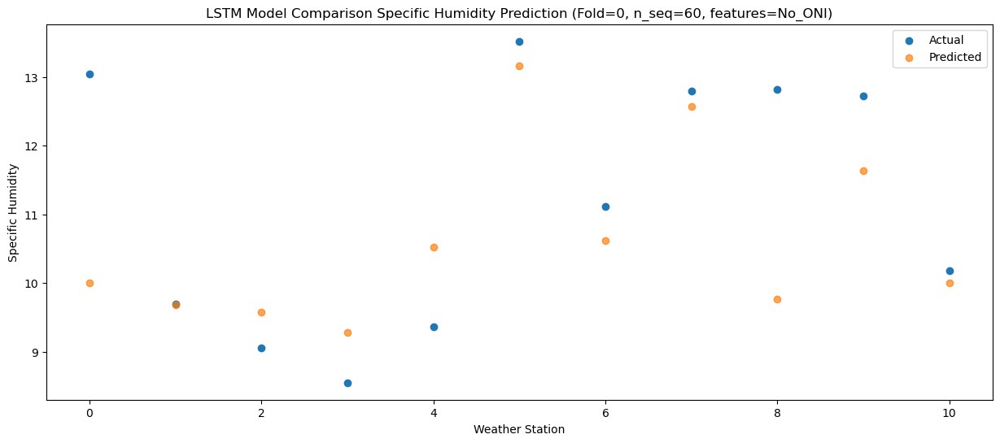

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    9.07   8.111419
1                 1    5.68   7.801419
2                 2    5.48   7.691419
3                 3    6.37   7.391419
4                 4    9.32   8.641419
5                 5   10.40  11.281419
6                 6    8.18   8.731419
7                 7    9.99  10.681419
8                 8    8.75   7.881419
9                 9   10.00   9.751419
10               10    8.87   8.111419


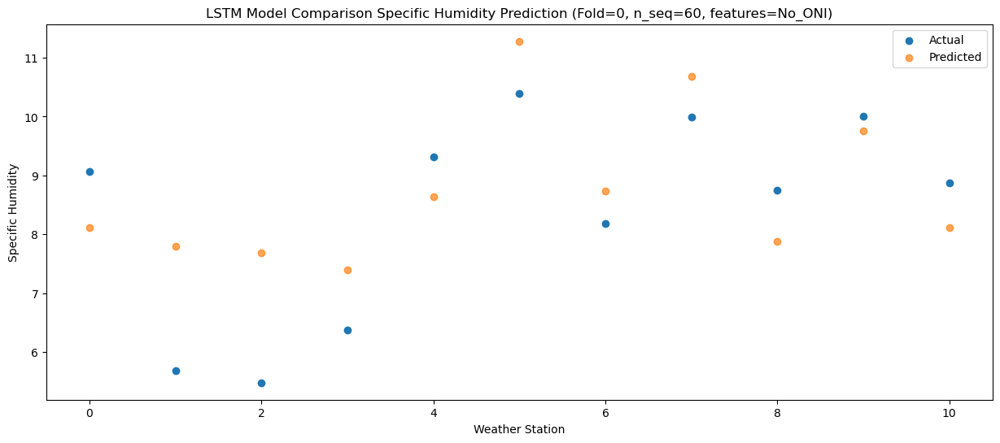

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    5.04   5.528325
1                 1    0.98   5.218325
2                 2    1.57   5.108325
3                 3    1.80   4.808325
4                 4    5.57   6.058325
5                 5    6.00   8.698325
6                 6    3.92   6.148325
7                 7    6.24   8.098325
8                 8    4.69   5.298325
9                 9    6.76   7.168325
10               10    5.11   5.528325


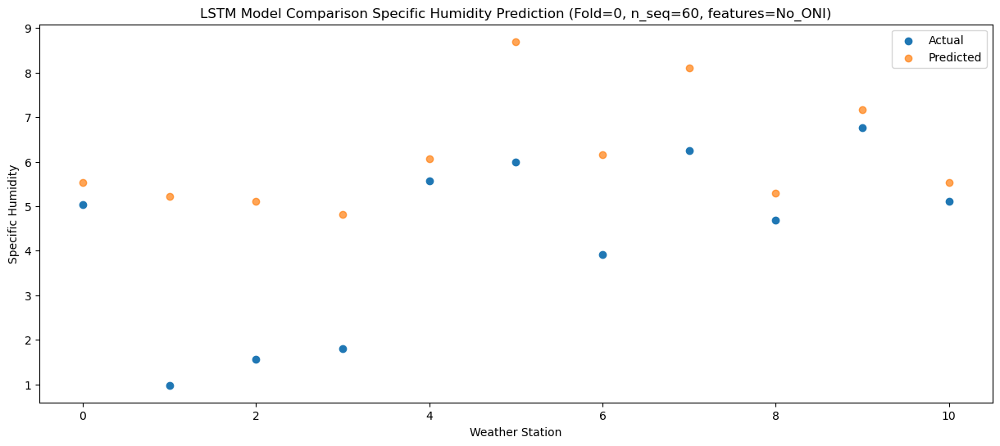

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    1.86   1.985264
1                 1   -1.20   1.675264
2                 2   -0.96   1.565264
3                 3   -1.19   1.265264
4                 4    2.77   2.515264
5                 5    2.98   5.155264
6                 6    0.59   2.605264
7                 7    2.72   4.555264
8                 8    2.03   1.755264
9                 9    3.41   3.625264
10               10    1.70   1.985264


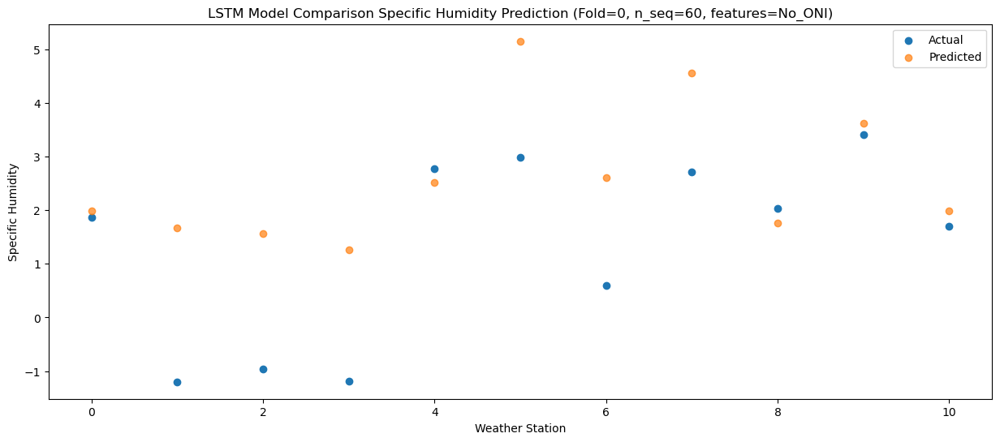

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    0.58   3.303764
1                 1   -2.64   2.993764
2                 2   -1.77   2.883764
3                 3   -2.59   2.583764
4                 4    0.91   3.833764
5                 5    2.16   6.473764
6                 6    0.52   3.923764
7                 7    2.92   5.873764
8                 8    1.42   3.073764
9                 9    3.60   4.943764
10               10    2.23   3.303764


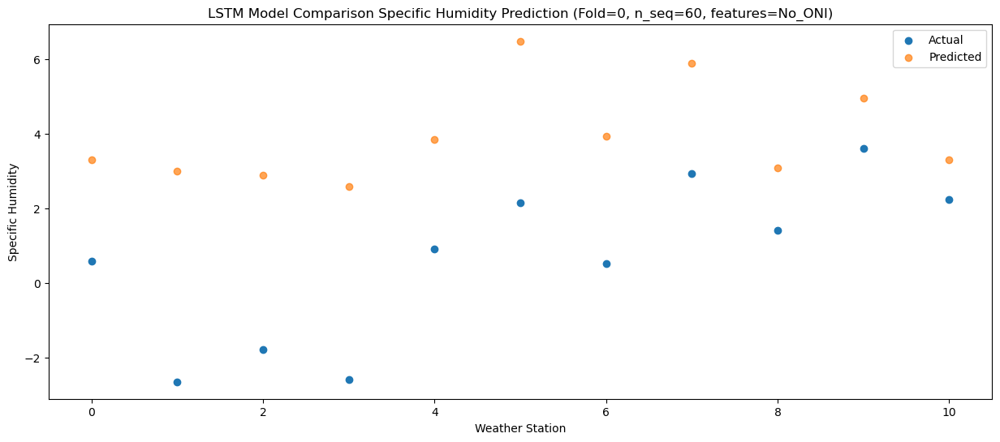

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -0.24   2.603224
1                 1   -3.42   2.293224
2                 2   -2.57   2.183224
3                 3   -3.51   1.883224
4                 4   -0.27   3.133224
5                 5    1.37   5.773224
6                 6   -0.15   3.223224
7                 7    2.23   5.173224
8                 8    0.24   2.373224
9                 9    2.63   4.243224
10               10    0.71   2.603224


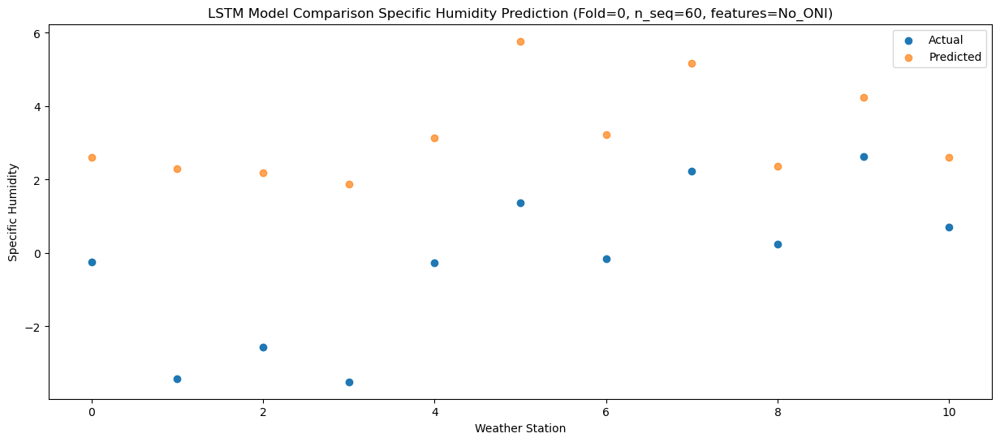

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    1.66   2.166857
1                 1   -2.20   1.856857
2                 2   -1.93   1.746857
3                 3   -1.73   1.446857
4                 4    2.30   2.696857
5                 5    1.27   5.336857
6                 6    0.01   2.786857
7                 7    2.26   4.736857
8                 8    2.00   1.936857
9                 9    2.98   3.806857
10               10    1.24   2.166857


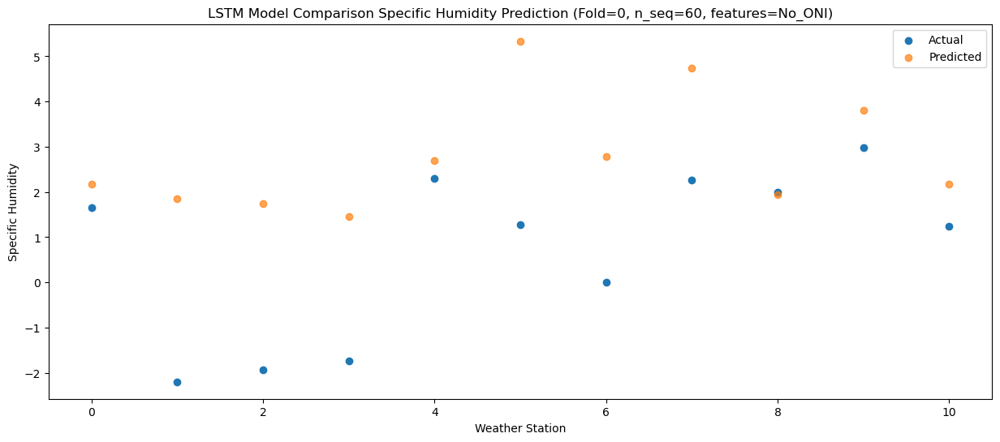

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.92   2.811943
1                 1   -0.35   2.501943
2                 2   -0.30   2.391943
3                 3    0.06   2.091943
4                 4    4.04   3.341943
5                 5    3.19   5.981943
6                 6    1.46   3.431943
7                 7    3.40   5.381943
8                 8    2.87   2.581943
9                 9    4.11   4.451943
10               10    1.93   2.811943


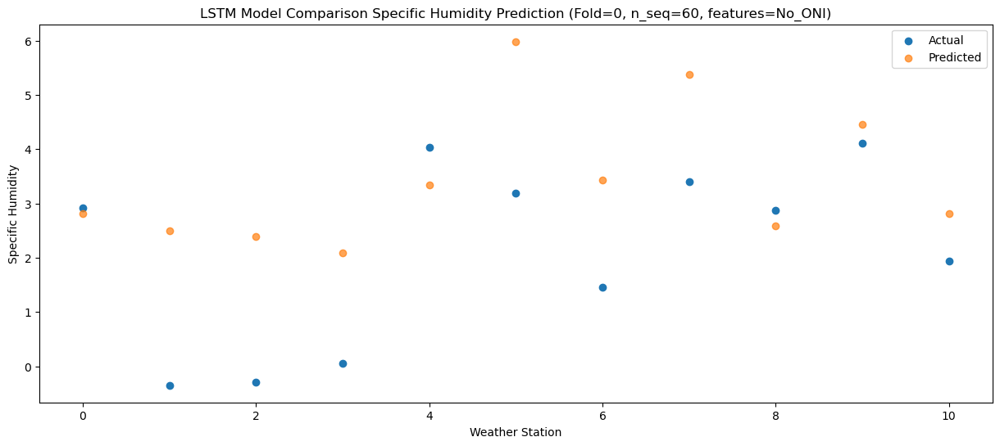

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    5.23    4.48062
1                 1    1.56    4.17062
2                 2    1.44    4.06062
3                 3    2.11    3.76062
4                 4    6.28    5.01062
5                 5    4.53    7.65062
6                 6    3.52    5.10062
7                 7    5.42    7.05062
8                 8    5.10    4.25062
9                 9    6.48    6.12062
10               10    3.49    4.48062


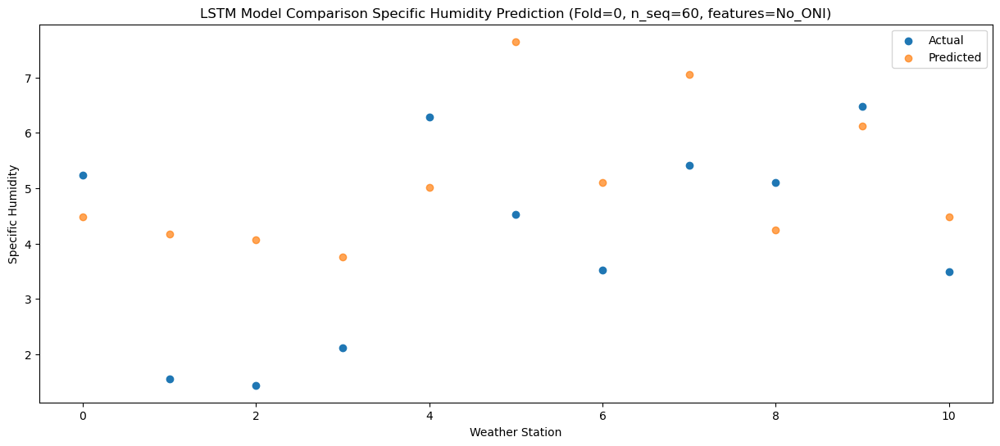

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    9.70   7.051469
1                 1    6.14   6.741469
2                 2    5.19   6.631469
3                 3    6.68   6.331469
4                 4   10.53   7.581469
5                 5    8.59  10.221469
6                 6    7.43   7.671469
7                 7    9.24   9.621469
8                 8    9.38   6.821469
9                 9   10.28   8.691469
10               10    6.54   7.051469


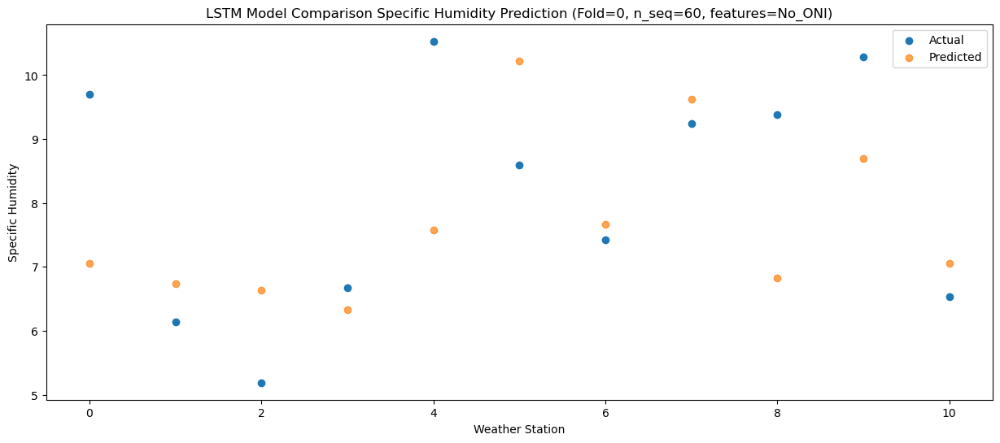

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   11.09  10.227029
1                 1    7.74   9.917029
2                 2    6.32   9.807029
3                 3    8.19   9.507029
4                 4   12.18  10.757029
5                 5   10.56  13.397029
6                 6    9.25  10.847029
7                 7   10.93  12.797029
8                 8   11.80   9.997029
9                 9   11.35  11.867029
10               10    9.04  10.227029


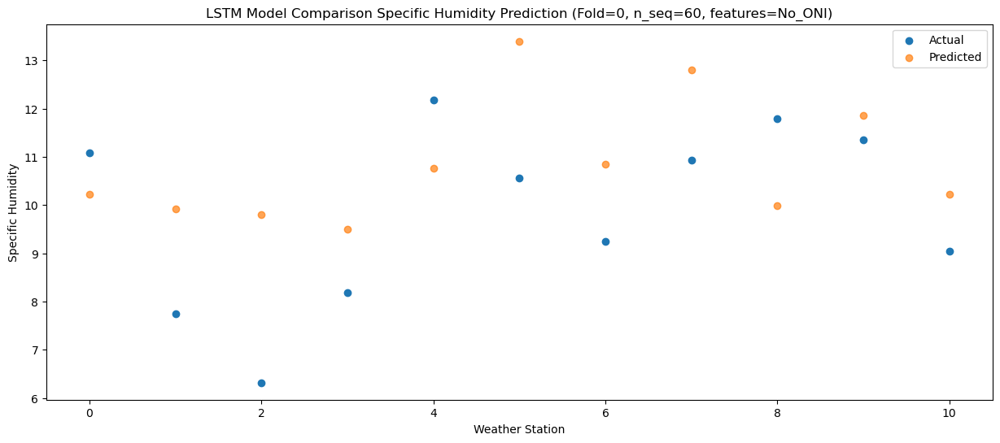

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   12.38  11.151439
1                 1    9.91  10.841439
2                 2    9.55  10.731439
3                 3    9.59  10.431439
4                 4   11.92  11.681439
5                 5   13.35  14.321439
6                 6   11.78  11.771439
7                 7   13.82  13.721439
8                 8   12.98  10.921439
9                 9   12.85  12.791439
10               10   10.11  11.151439


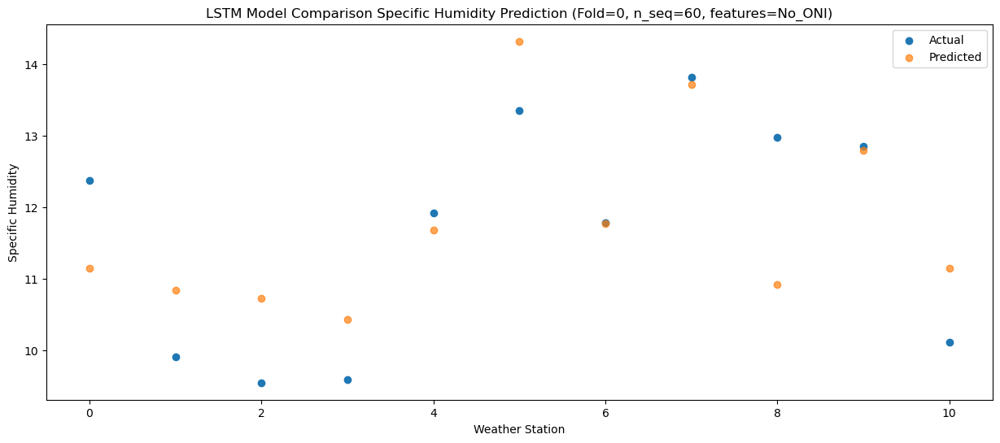

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   10.55  10.544291
1                 1    8.41  10.234291
2                 2    7.86  10.124291
3                 3    8.45   9.824291
4                 4   11.57  11.074291
5                 5   12.34  13.714291
6                 6   10.62  11.164291
7                 7   12.39  13.114291
8                 8   11.31  10.314291
9                 9   12.05  12.184291
10               10    9.87  10.544291


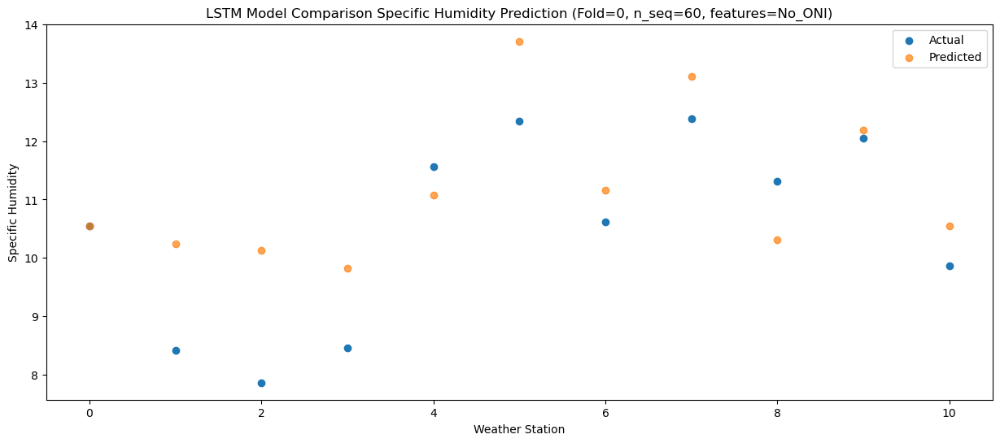

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    9.08   8.177098
1                 1    7.54   7.867098
2                 2    6.17   7.757098
3                 3    6.89   7.457098
4                 4    9.08   8.707098
5                 5   10.39  11.347098
6                 6    8.89   8.797098
7                 7   10.80  10.747098
8                 8    9.27   7.947098
9                 9    9.70   9.817098
10               10    8.16   8.177098


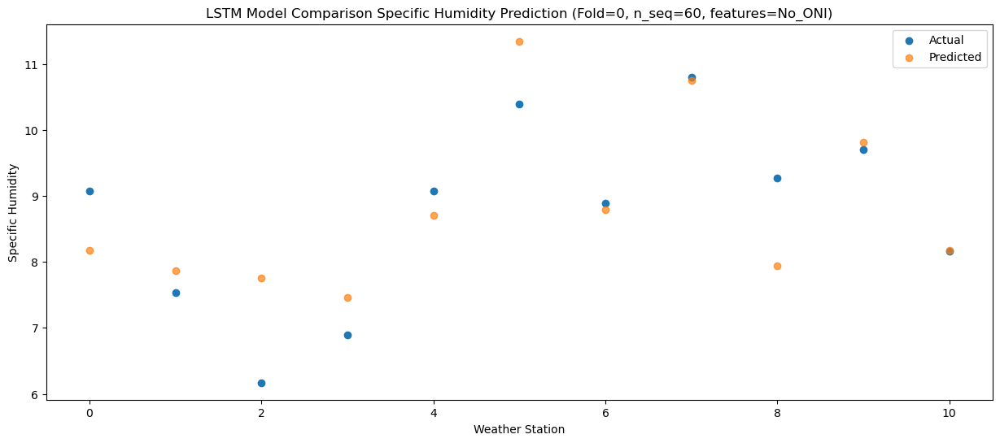

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    3.70   4.455282
1                 1    2.14   4.145282
2                 2    2.04   4.035282
3                 3    1.70   3.735282
4                 4    5.47   4.985282
5                 5    5.10   7.625282
6                 6    4.19   5.075282
7                 7    5.91   7.025282
8                 8    4.67   4.225282
9                 9    6.17   6.095282
10               10    3.96   4.455282


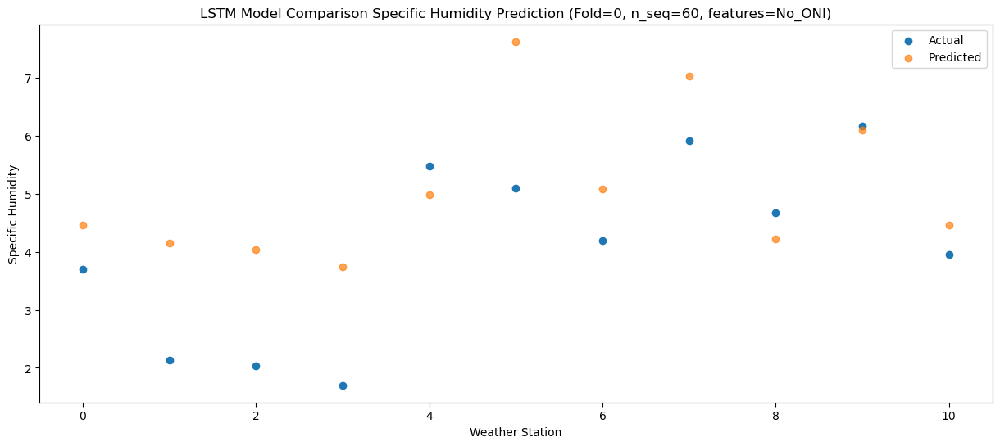

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (1, 1, 256)               2121728   
                                                                 
 dropout (Dropout)           (1, 1, 256)               0         
                                                                 
 lstm_1 (LSTM)               (1, 256)                  525312    
                                                                 
 dropout_1 (Dropout)         (1, 256)                  0         
                                                                 
 dense (Dense)               (1, 256)                  65792     
                                                                 
 dense_1 (Dense)             (1, 128)                  32896     
                                                                 
 dense_2 (Dense)             (1, 60)                   7

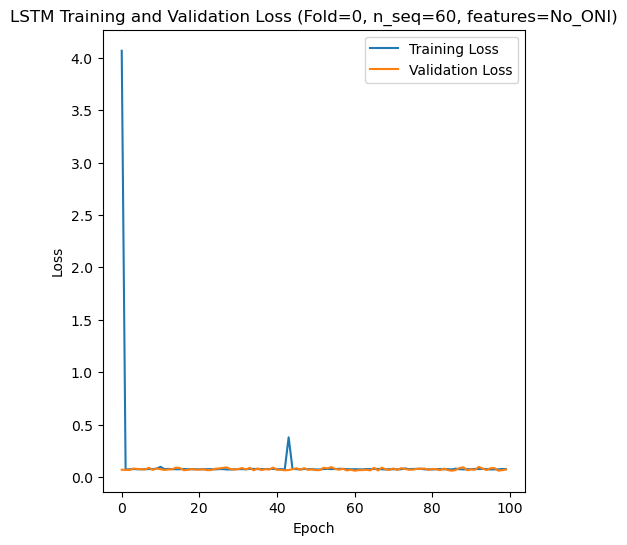

Epoch 1/100
84/84 [==============================] - 29s 98ms/step - loss: 4.2812 - accuracy: 0.3690 - mae: 4.0018 - rmse: 4.2812 - mape: 864.0197 - pearson: 0.5551 - val_loss: 0.0740 - val_accuracy: 0.0000e+00 - val_mae: 0.0580 - val_rmse: 0.0740 - val_mape: 13.2066 - val_pearson: 0.7168
Epoch 2/100
84/84 [==============================] - 3s 34ms/step - loss: 0.0730 - accuracy: 0.4048 - mae: 0.0575 - rmse: 0.0730 - mape: 13.0560 - pearson: 0.7440 - val_loss: 0.0722 - val_accuracy: 0.5000 - val_mae: 0.0576 - val_rmse: 0.0722 - val_mape: 12.8115 - val_pearson: 0.7181
Epoch 3/100
84/84 [==============================] - 3s 35ms/step - loss: 0.0748 - accuracy: 0.3929 - mae: 0.0591 - rmse: 0.0748 - mape: 13.3999 - pearson: 0.7287 - val_loss: 0.0796 - val_accuracy: 0.0000e+00 - val_mae: 0.0632 - val_rmse: 0.0796 - val_mape: 13.3826 - val_pearson: 0.7378
Epoch 4/100
84/84 [==============================] - 3s 33ms/step - loss: 0.0768 - accuracy: 0.3214 - mae: 0.0610 - rmse: 0.0768 - mape: 1

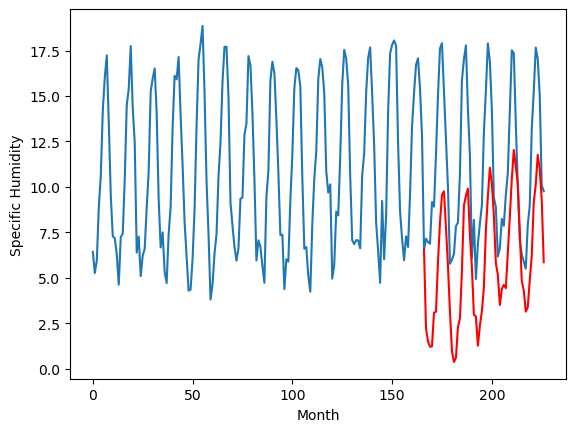

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.00		1.72		2.72
-0.95		1.00		1.95
-1.20		0.71		1.91
-0.68		0.74		1.42
1.55		2.58		1.03
-0.04		2.64		2.68
2.97		5.40		2.43
6.77		7.56		0.79
8.81		9.06		0.25
8.86		9.27		0.41
5.96		7.26		1.30
3.29		5.16		1.87
0.23		2.66		2.43
-2.36		0.48		2.84
-2.34		-0.12		2.22
-2.15		0.10		2.25
-0.62		1.80		2.42
-0.26		2.26		2.52
2.66		4.90		2.24
6.64		8.48		1.84
8.51		9.03		0.52
8.72		9.41		0.69
5.77		6.86		1.09
3.73		5.08		1.35
-1.86		2.47		4.33
0.31		2.38		2.07
-2.69		0.77		3.46
-1.74		1.88		3.62
-1.06		2.66		3.72
0.00		3.96		3.96
4.17		7.10		2.93
6.57		8.98		2.41
9.24		10.57		1.33
8.83		9.72		0.89
5.47		7.95		2.48
0.58		5.32		4.74
0.10		4.68		4.58
-1.49		3.01		4.50
-1.08		3.89		4.97
0.04		4.12		4.08
-0.83		3.93		4.76
0.77		5.88		5.11
3.51		7.84		4.33
5.86		9.94		4.08
8.82		11.54		2.72
8.95		10.65		1.70
5.84		9.66		3.82
1.99		7.05		5.06
-1.02		4.31		5.33
-1.60		3.81		5.41
-2.37		2.64		5.01
-2.03		2.89		4

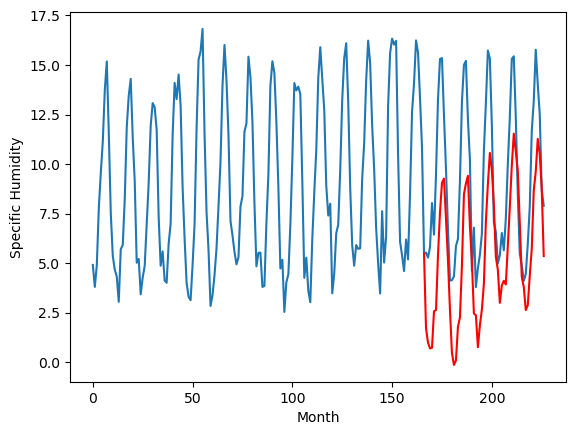

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.90		0.47		2.37
-0.99		-0.25		0.74
-1.50		-0.54		0.96
-1.11		-0.51		0.60
2.05		1.33		-0.72
0.43		1.39		0.96
3.20		4.15		0.95
7.05		6.31		-0.74
9.60		7.81		-1.79
9.12		8.02		-1.10
6.17		6.01		-0.16
3.41		3.91		0.50
0.23		1.41		1.18
-2.54		-0.77		1.77
-2.39		-1.37		1.02
-2.39		-1.15		1.24
0.23		0.55		0.32
-0.06		1.01		1.07
2.78		3.65		0.87
7.30		7.23		-0.07
8.89		7.78		-1.11
9.11		8.16		-0.95
6.35		5.61		-0.74
3.60		3.83		0.23
-1.90		1.22		3.12
0.74		1.13		0.39
-3.14		-0.48		2.66
-2.11		0.63		2.74
-1.32		1.41		2.73
0.44		2.71		2.27
4.80		5.85		1.05
7.89		7.73		-0.16
9.52		9.32		-0.20
8.65		8.47		-0.18
5.14		6.70		1.56
0.03		4.07		4.04
-0.34		3.43		3.77
-1.03		1.76		2.79
-1.06		2.64		3.70
-0.01		2.87		2.88
-0.48		2.68		3.16
0.88		4.63		3.75
4.18		6.59		2.41
6.83		8.69		1.86
9.97		10.29		0.32
9.90		9.40		-0.50
6.09		8.41		2.32
1.58		5.80		4.22
-0.97		3.06		4.03
-1.99		2.56		4.55
-2.62		1.39		4.

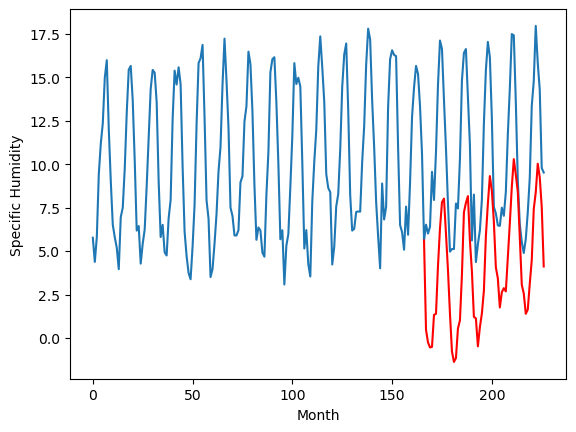

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.51		-0.23		1.28
-2.71		-0.95		1.76
-1.81		-1.24		0.57
-2.51		-1.21		1.30
1.85		0.63		-1.22
1.51		0.69		-0.82
3.49		3.45		-0.04
5.61		5.61		-0.00
8.12		7.11		-1.01
7.01		7.32		0.31
5.43		5.31		-0.12
2.03		3.21		1.18
-0.07		0.71		0.78
-2.62		-1.47		1.15
-2.96		-2.07		0.89
-2.89		-1.85		1.04
-0.25		-0.15		0.10
1.09		0.31		-0.78
4.98		2.95		-2.03
8.17		6.53		-1.64
8.65		7.08		-1.57
8.99		7.46		-1.53
5.90		4.91		-0.99
3.65		3.13		-0.52
-0.80		0.52		1.32
2.12		0.43		-1.69
-3.53		-1.18		2.35
-3.36		-0.07		3.29
-1.68		0.71		2.39
2.48		2.01		-0.47
6.29		5.15		-1.14
7.34		7.03		-0.31
8.26		8.62		0.36
8.51		7.77		-0.74
5.22		6.00		0.78
0.26		3.37		3.11
-0.24		2.73		2.97
-1.05		1.06		2.11
-1.47		1.94		3.41
-0.69		2.17		2.86
0.86		1.98		1.12
1.23		3.93		2.70
5.01		5.89		0.88
8.41		7.99		-0.42
8.97		9.59		0.62
7.30		8.70		1.40
6.10		7.71		1.61
2.68		5.10		2.42
-0.65		2.36		3.01
-2.29		1.86		4.15
-3.39		

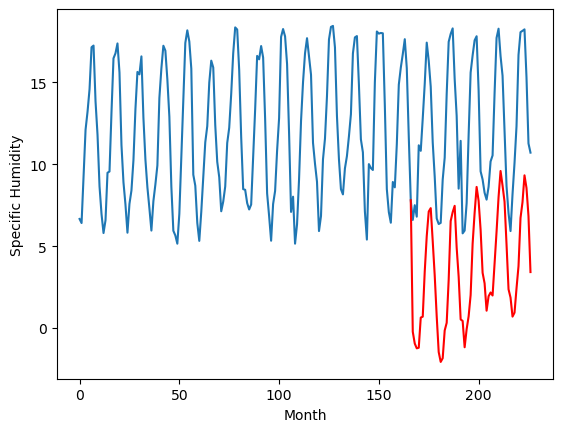

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.21		3.83		1.62
0.97		3.11		2.14
1.88		2.82		0.94
1.20		2.85		1.65
5.93		4.69		-1.24
5.62		4.75		-0.87
7.74		7.51		-0.23
10.03		9.67		-0.36
12.63		11.17		-1.46
11.18		11.38		0.20
9.69		9.37		-0.32
5.84		7.27		1.43
3.36		4.77		1.41
0.54		2.59		2.05
0.29		1.99		1.70
0.33		2.21		1.88
3.05		3.91		0.86
4.31		4.37		0.06
8.34		7.01		-1.33
11.75		10.59		-1.16
11.93		11.14		-0.79
11.97		11.52		-0.45
8.87		8.97		0.10
6.92		7.19		0.27
2.33		4.58		2.25
5.26		4.49		-0.77
-0.28		2.88		3.16
-0.08		3.99		4.07
1.62		4.77		3.15
5.72		6.07		0.35
9.60		9.21		-0.39
10.72		11.09		0.37
11.47		12.68		1.21
11.85		11.83		-0.02
8.50		10.06		1.56
3.60		7.43		3.83
3.22		6.79		3.57
2.40		5.12		2.72
1.92		6.00		4.08
2.52		6.23		3.71
4.22		6.04		1.82
4.67		7.99		3.32
8.34		9.95		1.61
11.60		12.05		0.45
11.68		13.65		1.97
10.28		12.76		2.48
9.53		11.77		2.24
6.14		9.16		3.02
2.80		6.42		3.62
1.08		5.92		4.84
-0.09		4.75		4.

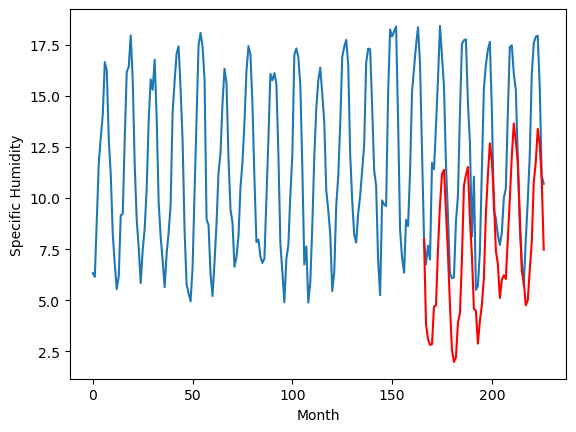

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.35		2.32		-1.03
1.87		1.60		-0.27
1.59		1.31		-0.28
1.77		1.34		-0.43
4.44		3.18		-1.26
3.43		3.24		-0.19
6.11		6.00		-0.11
7.93		8.16		0.23
8.92		9.66		0.74
7.69		9.87		2.18
7.26		7.86		0.60
3.75		5.76		2.01
3.19		3.26		0.07
0.75		1.08		0.33
1.58		0.48		-1.10
0.95		0.70		-0.25
1.74		2.40		0.66
3.04		2.86		-0.18
7.35		5.50		-1.85
9.52		9.08		-0.44
10.85		9.63		-1.22
11.07		10.01		-1.06
7.53		7.46		-0.07
4.42		5.68		1.26
2.58		3.07		0.49
1.53		2.98		1.45
0.26		1.37		1.11
0.14		2.48		2.34
0.69		3.26		2.57
2.96		4.56		1.60
4.73		7.70		2.97
7.33		9.58		2.25
8.28		11.17		2.89
10.39		10.32		-0.07
9.12		8.55		-0.57
5.93		5.92		-0.01
3.06		5.28		2.22
2.39		3.61		1.22
0.84		4.49		3.65
0.87		4.72		3.85
1.92		4.53		2.61
2.18		6.48		4.30
6.55		8.44		1.89
6.50		10.54		4.04
8.67		12.14		3.47
8.82		11.25		2.43
8.46		10.26		1.80
6.48		7.65		1.17
3.85		4.91		1.06
1.98		4.41		2.43
0.83		3.24		2.41
1.24		3.49

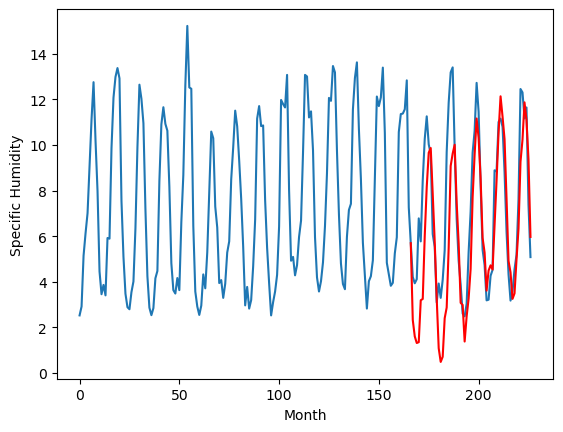

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.70		3.17		2.47
0.73		2.45		1.72
0.31		2.16		1.85
0.79		2.19		1.40
2.76		4.03		1.27
2.11		4.09		1.98
5.31		6.85		1.54
8.95		9.01		0.06
11.39		10.51		-0.88
11.41		10.72		-0.69
8.10		8.71		0.61
5.61		6.61		1.00
2.50		4.11		1.61
-0.22		1.93		2.15
-0.33		1.33		1.66
-0.21		1.55		1.76
1.35		3.25		1.90
1.97		3.71		1.74
4.90		6.35		1.45
9.25		9.93		0.68
11.75		10.48		-1.27
12.04		10.86		-1.18
8.69		8.31		-0.38
6.56		6.53		-0.03
0.63		3.92		3.29
2.50		3.83		1.33
-0.50		2.22		2.72
0.63		3.33		2.70
1.38		4.11		2.73
2.57		5.41		2.84
6.83		8.55		1.72
9.55		10.43		0.88
12.54		12.02		-0.52
11.45		11.17		-0.28
7.97		9.40		1.43
2.91		6.77		3.86
2.42		6.13		3.71
0.52		4.46		3.94
0.88		5.34		4.46
2.08		5.57		3.49
1.32		5.38		4.06
3.13		7.33		4.20
5.69		9.29		3.60
8.27		11.39		3.12
11.89		12.99		1.10
11.78		12.10		0.32
8.81		11.11		2.30
4.56		8.50		3.94
1.21		5.76		4.55
0.71		5.26		4.55
-0.11		4.09		4.20
0.37		

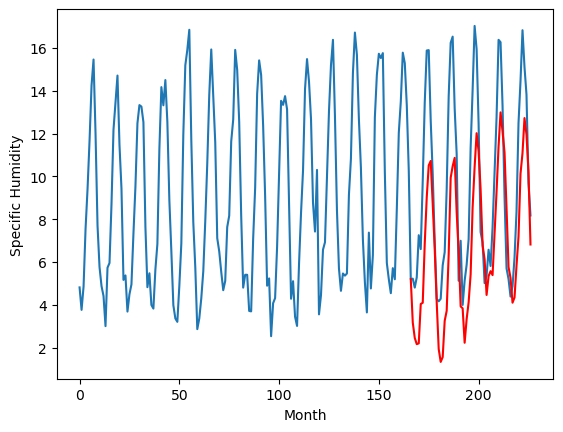

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.11		4.06		0.95
2.78		3.34		0.56
2.70		3.05		0.35
2.58		3.08		0.50
5.24		4.92		-0.32
5.50		4.98		-0.52
8.40		7.74		-0.66
12.23		9.90		-2.33
15.31		11.40		-3.91
13.14		11.61		-1.53
11.34		9.60		-1.74
6.52		7.50		0.98
4.50		5.00		0.50
2.18		2.82		0.64
2.05		2.22		0.17
1.53		2.44		0.91
4.26		4.14		-0.12
5.49		4.60		-0.89
8.70		7.24		-1.46
13.46		10.82		-2.64
14.09		11.37		-2.72
13.94		11.75		-2.19
10.69		9.20		-1.49
7.96		7.42		-0.54
3.40		4.81		1.41
5.04		4.72		-0.32
1.29		3.11		1.82
1.97		4.22		2.25
3.50		5.00		1.50
5.69		6.30		0.61
10.14		9.44		-0.70
12.90		11.32		-1.58
13.87		12.91		-0.96
13.78		12.06		-1.72
9.82		10.29		0.47
5.28		7.66		2.38
4.03		7.02		2.99
3.12		5.35		2.23
3.24		6.23		2.99
3.34		6.46		3.12
4.10		6.27		2.17
5.30		8.22		2.92
9.34		10.18		0.84
12.26		12.28		0.02
14.83		13.88		-0.95
14.41		12.99		-1.42
9.92		12.00		2.08
6.67		9.39		2.72
3.96		6.65		2.69
2.57		6.15		3.58
1.50

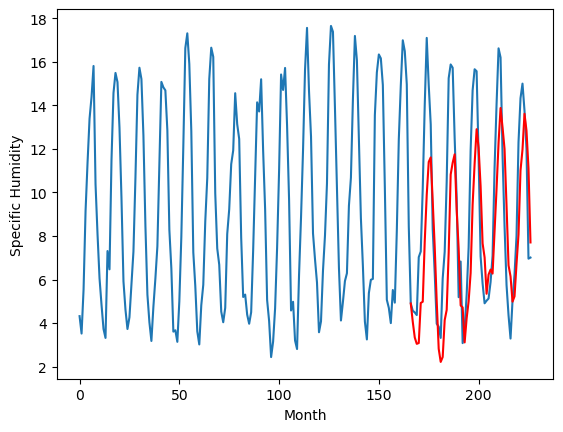

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.03		3.73		-0.30
3.19		3.01		-0.18
3.64		2.72		-0.92
3.02		2.75		-0.27
6.04		4.59		-1.45
6.23		4.65		-1.58
9.56		7.41		-2.15
11.70		9.57		-2.13
15.06		11.07		-3.99
12.16		11.28		-0.88
10.68		9.27		-1.41
6.01		7.17		1.16
4.90		4.67		-0.23
2.62		2.49		-0.13
2.78		1.89		-0.89
1.97		2.11		0.14
4.58		3.81		-0.77
5.74		4.27		-1.47
9.96		6.91		-3.05
13.10		10.49		-2.61
14.15		11.04		-3.11
13.73		11.42		-2.31
10.16		8.87		-1.29
7.72		7.09		-0.63
4.19		4.48		0.29
3.58		4.39		0.81
1.60		2.78		1.18
2.13		3.89		1.76
3.22		4.67		1.45
6.34		5.97		-0.37
10.58		9.11		-1.47
12.48		10.99		-1.49
11.84		12.58		0.74
12.58		11.73		-0.85
9.84		9.96		0.12
5.89		7.33		1.44
4.91		6.69		1.78
3.17		5.02		1.85
2.69		5.90		3.21
3.02		6.13		3.11
4.44		5.94		1.50
5.66		7.89		2.23
10.71		9.85		-0.86
13.29		11.95		-1.34
13.52		13.55		0.03
11.69		12.66		0.97
10.74		11.67		0.93
7.31		9.06		1.75
4.64		6.32		1.68
3.59		5.82		2.2

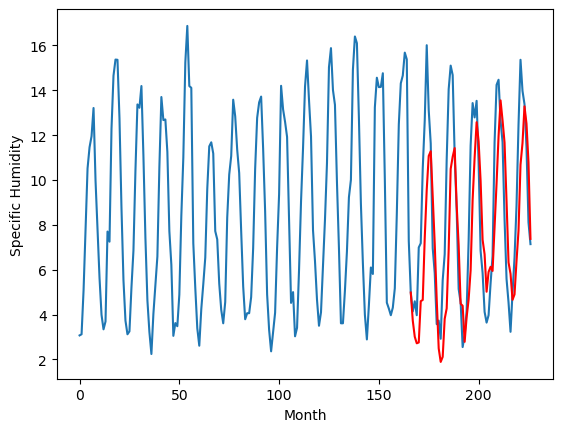

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.80		-0.08		-0.88
0.15		-0.80		-0.95
-0.00		-1.09		-1.09
0.01		-1.06		-1.07
1.90		0.78		-1.12
2.06		0.84		-1.22
4.88		3.60		-1.28
6.59		5.76		-0.83
9.48		7.26		-2.22
8.16		7.47		-0.69
5.37		5.46		0.09
1.85		3.36		1.51
1.53		0.86		-0.67
-0.33		-1.32		-0.99
-0.14		-1.92		-1.78
-0.88		-1.70		-0.82
0.94		-0.00		-0.94
1.11		0.46		-0.65
6.26		3.10		-3.16
9.25		6.68		-2.57
10.49		7.23		-3.26
9.46		7.61		-1.85
6.50		5.06		-1.44
3.06		3.28		0.22
0.70		0.67		-0.03
-0.28		0.58		0.86
-0.92		-1.03		-0.11
-1.00		0.08		1.08
-0.04		0.86		0.90
0.93		2.16		1.23
3.49		5.30		1.81
7.67		7.18		-0.49
8.32		8.77		0.45
8.73		7.92		-0.81
6.73		6.15		-0.58
3.34		3.52		0.18
1.36		2.88		1.52
0.15		1.21		1.06
-0.16		2.09		2.25
-0.30		2.32		2.62
0.49		2.13		1.64
1.01		4.08		3.07
6.74		6.04		-0.70
8.35		8.14		-0.21
10.28		9.74		-0.54
8.37		8.85		0.48
6.72		7.86		1.14
3.61		5.25		1.64
1.29		2.51		1.22
0.85		2.01		1.16
0.11

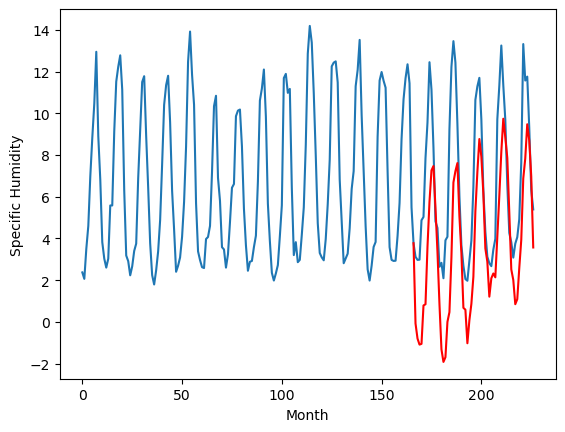

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.62		2.21		1.59
0.61		1.49		0.88
0.46		1.20		0.74
0.53		1.23		0.70
1.48		3.07		1.59
1.77		3.13		1.36
4.34		5.89		1.55
7.98		8.05		0.07
11.62		9.55		-2.07
11.53		9.76		-1.77
8.05		7.75		-0.30
5.13		5.65		0.52
2.75		3.15		0.40
0.59		0.97		0.38
-0.14		0.37		0.51
-0.10		0.59		0.69
1.14		2.29		1.15
2.51		2.75		0.24
4.04		5.39		1.35
9.36		8.97		-0.39
11.22		9.52		-1.70
11.56		9.90		-1.66
8.37		7.35		-1.02
6.51		5.57		-0.94
1.32		2.96		1.64
1.20		2.87		1.67
-0.41		1.26		1.67
0.33		2.37		2.04
1.35		3.15		1.80
2.01		4.45		2.44
6.14		7.59		1.45
7.73		9.47		1.74
11.36		11.06		-0.30
10.93		10.21		-0.72
7.68		8.44		0.76
4.24		5.81		1.57
2.74		5.17		2.43
0.61		3.50		2.89
1.47		4.38		2.91
0.67		4.61		3.94
0.70		4.42		3.72
3.31		6.37		3.06
3.61		8.33		4.72
6.90		10.43		3.53
11.61		12.03		0.42
9.32		11.14		1.82
8.06		10.15		2.09
5.01		7.54		2.53
1.35		4.80		3.45
1.59		4.30		2.71
0.54		3.13		2.59
0.41		3.38	

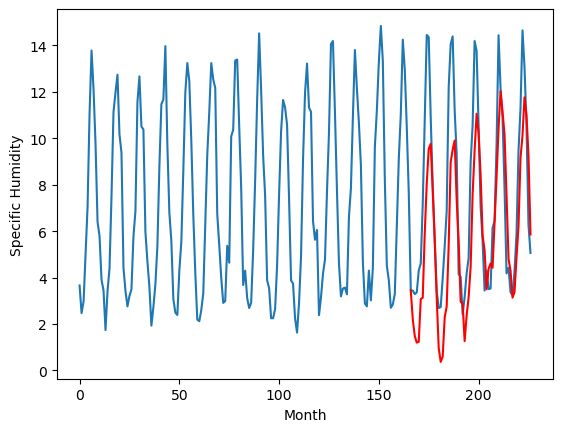

RangeIndex(start=1, stop=12, step=1)
[-1.4400000000000013, -1.0, -1.9, -1.5099999999999993, 2.209999999999999, 3.3500000000000005, 0.7000000000000002, 3.110000000000001, 4.03, 0.7999999999999996, 0.6200000000000001]
[2.2095494842529293, 1.71954948425293, 0.4695494842529295, -0.2304505157470702, 3.8295494842529294, 2.3195494842529296, 3.1695494842529293, 4.05954948425293, 3.7295494842529298, -0.0804505157470703, 2.2095494842529293]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -1.44   2.209549
1                 1   -1.00   1.719549
2                 2   -1.90   0.469549
3                 3   -1.51  -0.230451
4                 4    2.21   3.829549
5                 5    3.35   2.319549
6                 6    0.70   3.169549
7                 7    3.11   4.059549
8                 8    4.03   3.729549
9                 9    0.80  -0.080451
10               10    0.62   2.209549


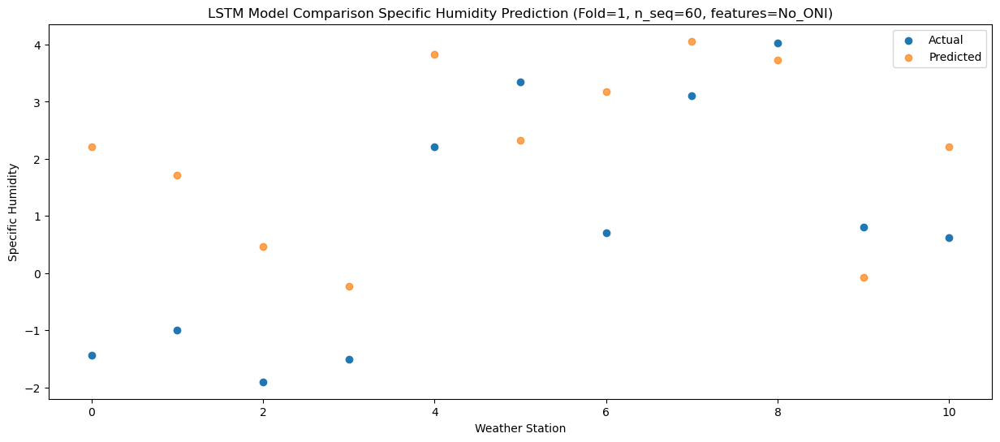

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -0.84   1.488818
1                 1   -0.95   0.998818
2                 2   -0.99  -0.251182
3                 3   -2.71  -0.951182
4                 4    0.97   3.108818
5                 5    1.87   1.598818
6                 6    0.73   2.448818
7                 7    2.78   3.338818
8                 8    3.19   3.008818
9                 9    0.15  -0.801182
10               10    0.61   1.488818


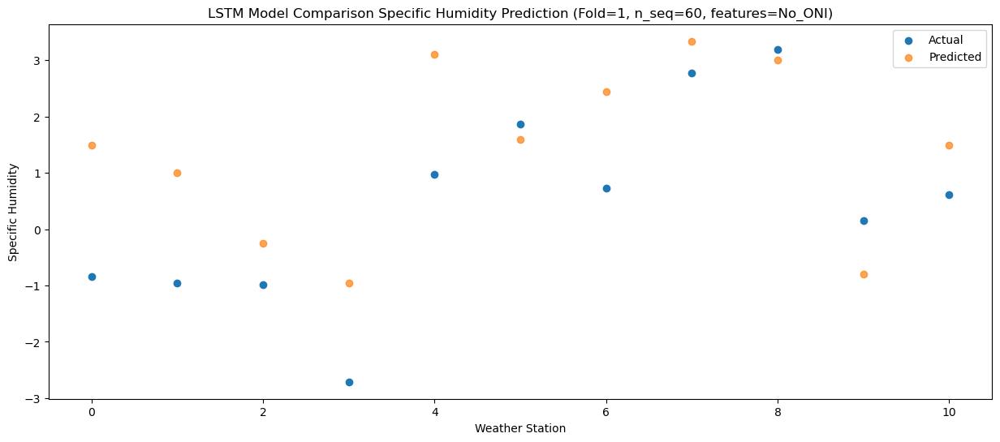

Predictions for (t+2):
    Weather_Station        Actual  Predicted
0                 0 -1.030000e+00   1.197867
1                 1 -1.200000e+00   0.707867
2                 2 -1.500000e+00  -0.542133
3                 3 -1.810000e+00  -1.242133
4                 4  1.880000e+00   2.817867
5                 5  1.590000e+00   1.307867
6                 6  3.100000e-01   2.157867
7                 7  2.700000e+00   3.047867
8                 8  3.640000e+00   2.717867
9                 9 -2.775558e-16  -1.092133
10               10  4.600000e-01   1.197867


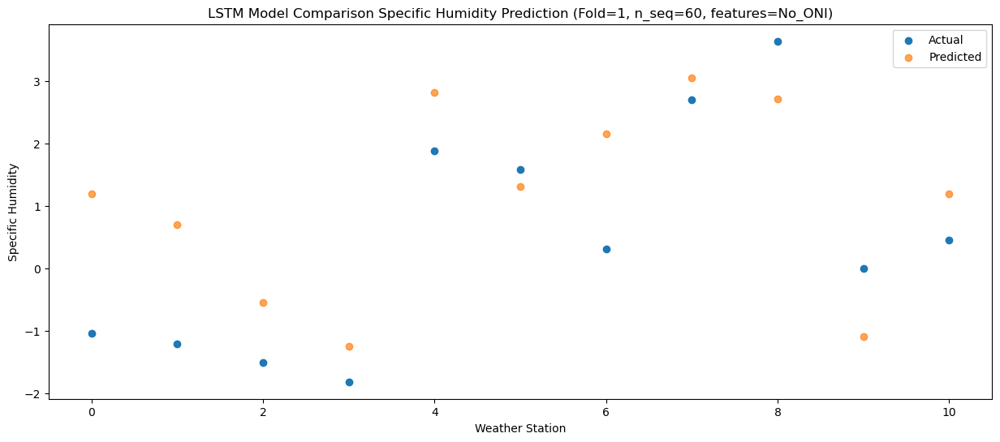

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -1.12   1.234519
1                 1   -0.68   0.744519
2                 2   -1.11  -0.505481
3                 3   -2.51  -1.205481
4                 4    1.20   2.854519
5                 5    1.77   1.344519
6                 6    0.79   2.194519
7                 7    2.58   3.084519
8                 8    3.02   2.754519
9                 9    0.01  -1.055481
10               10    0.53   1.234519


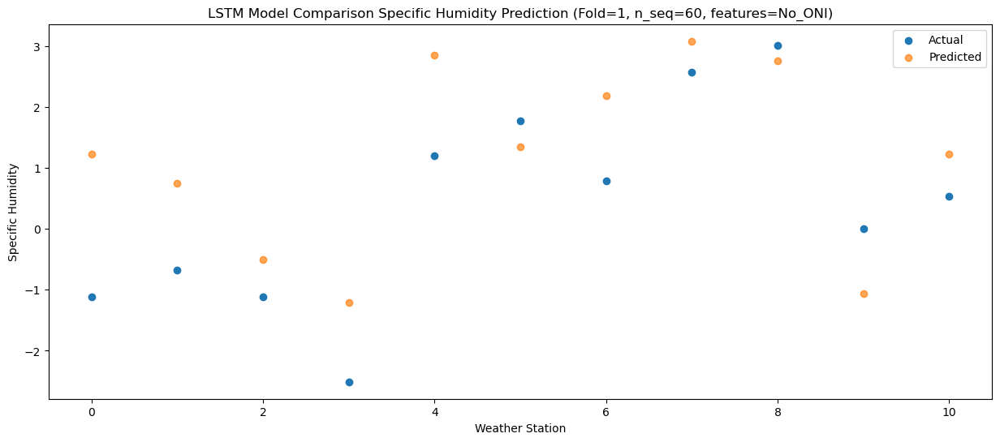

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    1.18   3.074149
1                 1    1.55   2.584149
2                 2    2.05   1.334149
3                 3    1.85   0.634149
4                 4    5.93   4.694149
5                 5    4.44   3.184149
6                 6    2.76   4.034149
7                 7    5.24   4.924149
8                 8    6.04   4.594149
9                 9    1.90   0.784149
10               10    1.48   3.074149


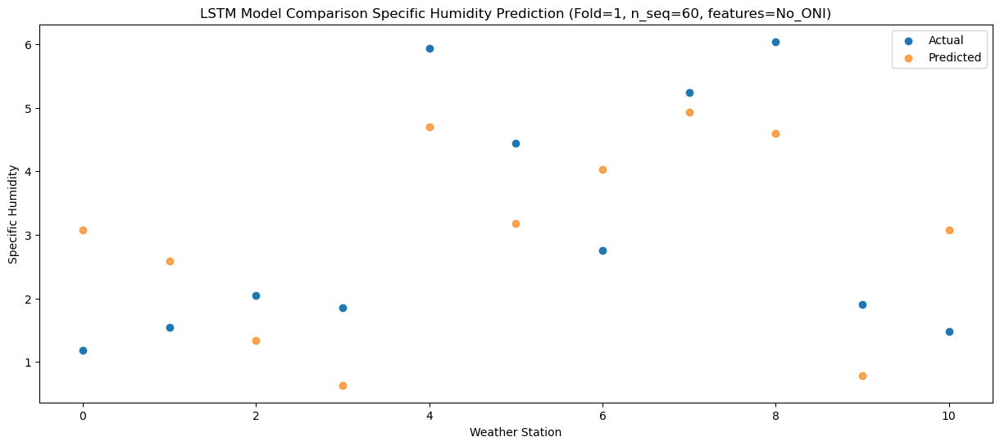

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    0.92   3.132639
1                 1   -0.04   2.642639
2                 2    0.43   1.392639
3                 3    1.51   0.692639
4                 4    5.62   4.752639
5                 5    3.43   3.242639
6                 6    2.11   4.092639
7                 7    5.50   4.982639
8                 8    6.23   4.652639
9                 9    2.06   0.842639
10               10    1.77   3.132639


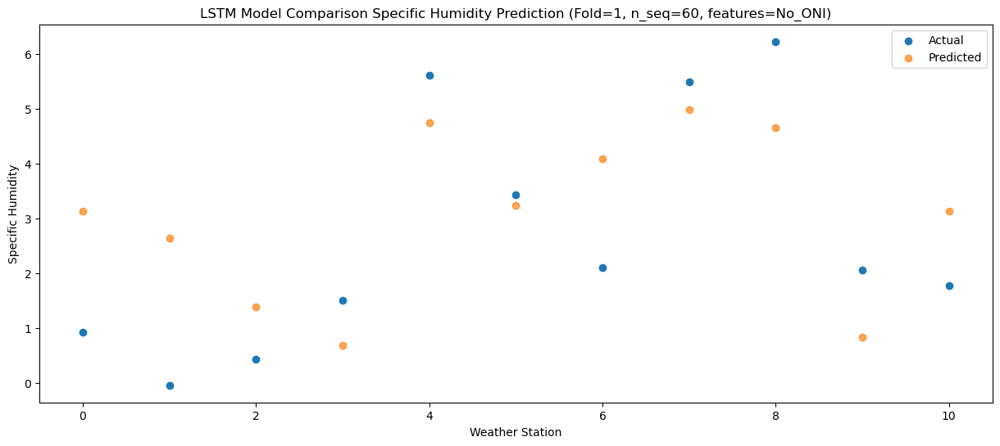

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    3.82   5.894071
1                 1    2.97   5.404071
2                 2    3.20   4.154071
3                 3    3.49   3.454071
4                 4    7.74   7.514071
5                 5    6.11   6.004071
6                 6    5.31   6.854071
7                 7    8.40   7.744071
8                 8    9.56   7.414071
9                 9    4.88   3.604071
10               10    4.34   5.894071


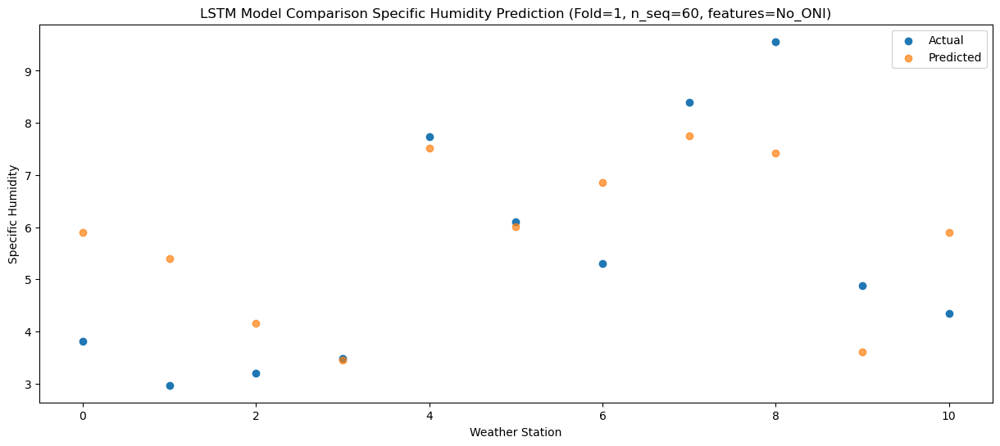

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    7.06   8.045865
1                 1    6.77   7.555865
2                 2    7.05   6.305865
3                 3    5.61   5.605865
4                 4   10.03   9.665865
5                 5    7.93   8.155865
6                 6    8.95   9.005865
7                 7   12.23   9.895865
8                 8   11.70   9.565865
9                 9    6.59   5.755865
10               10    7.98   8.045865


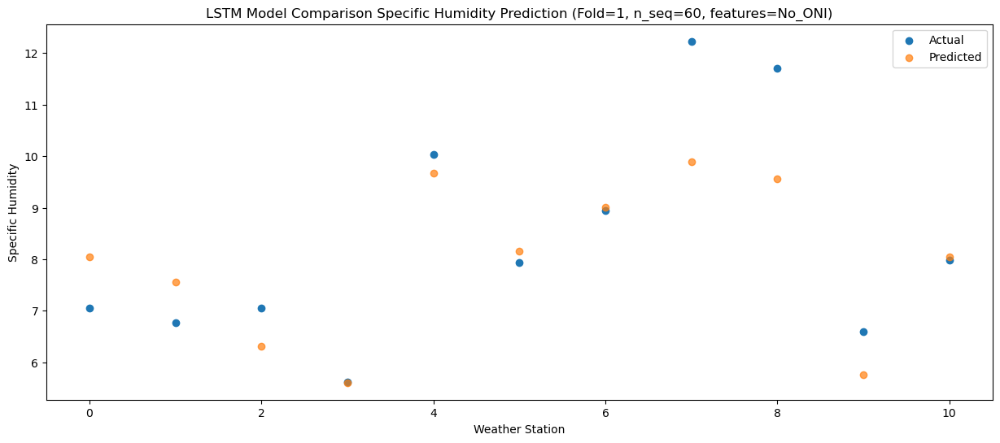

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0    9.63   9.552425
1                 1    8.81   9.062425
2                 2    9.60   7.812425
3                 3    8.12   7.112425
4                 4   12.63  11.172425
5                 5    8.92   9.662425
6                 6   11.39  10.512425
7                 7   15.31  11.402425
8                 8   15.06  11.072425
9                 9    9.48   7.262425
10               10   11.62   9.552425


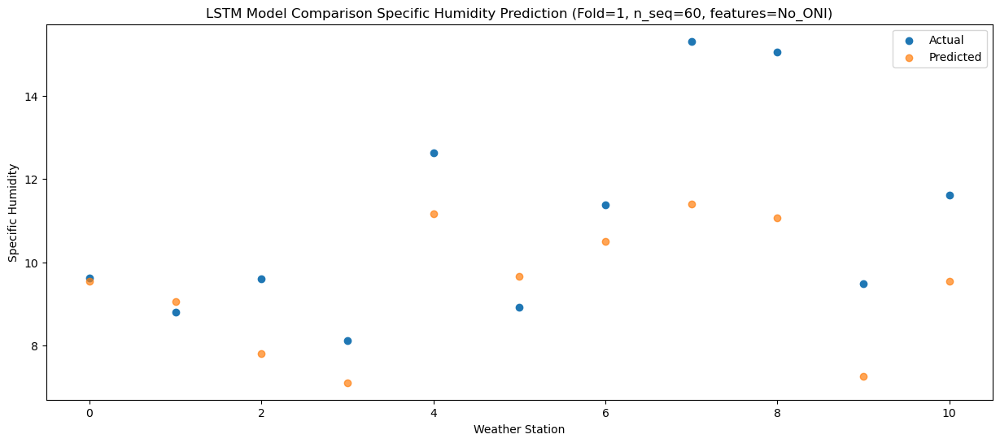

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0    9.92   9.760708
1                 1    8.86   9.270708
2                 2    9.12   8.020708
3                 3    7.01   7.320708
4                 4   11.18  11.380708
5                 5    7.69   9.870708
6                 6   11.41  10.720708
7                 7   13.14  11.610708
8                 8   12.16  11.280708
9                 9    8.16   7.470708
10               10   11.53   9.760708


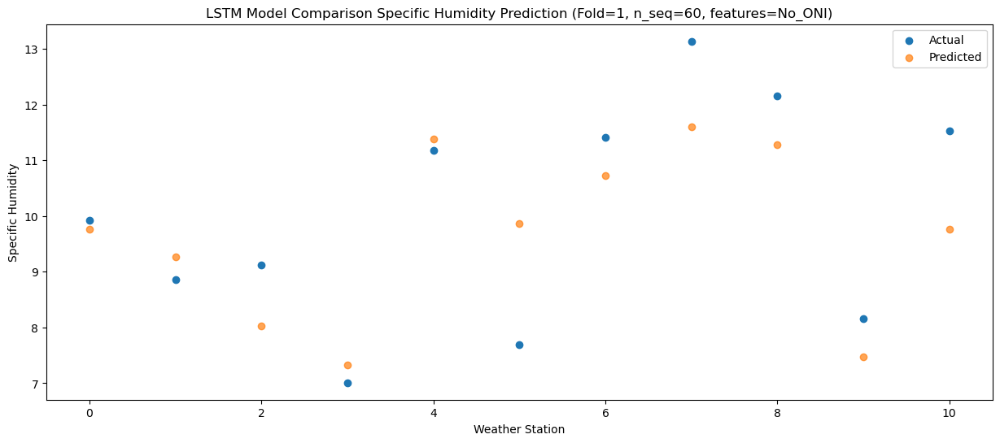

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    7.30   7.746418
1                 1    5.96   7.256418
2                 2    6.17   6.006418
3                 3    5.43   5.306418
4                 4    9.69   9.366418
5                 5    7.26   7.856418
6                 6    8.10   8.706418
7                 7   11.34   9.596418
8                 8   10.68   9.266418
9                 9    5.37   5.456418
10               10    8.05   7.746418


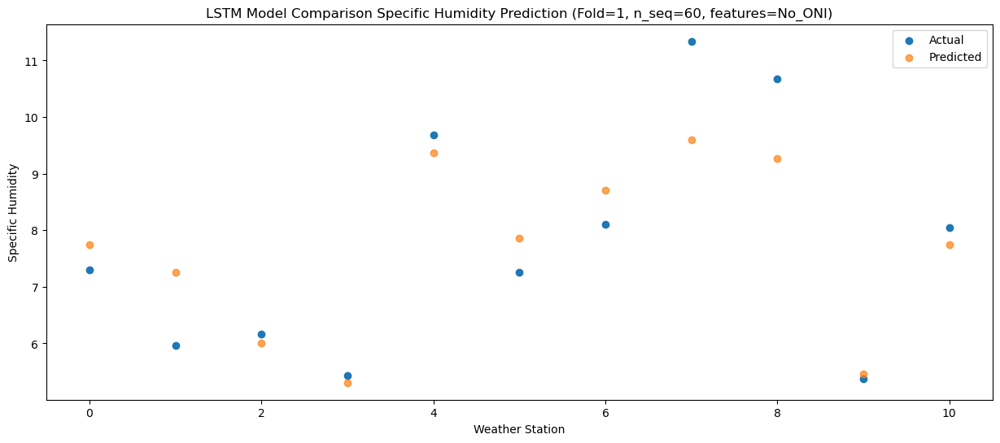

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.62   5.650901
1                 1    3.29   5.160901
2                 2    3.41   3.910901
3                 3    2.03   3.210901
4                 4    5.84   7.270901
5                 5    3.75   5.760901
6                 6    5.61   6.610901
7                 7    6.52   7.500901
8                 8    6.01   7.170901
9                 9    1.85   3.360901
10               10    5.13   5.650901


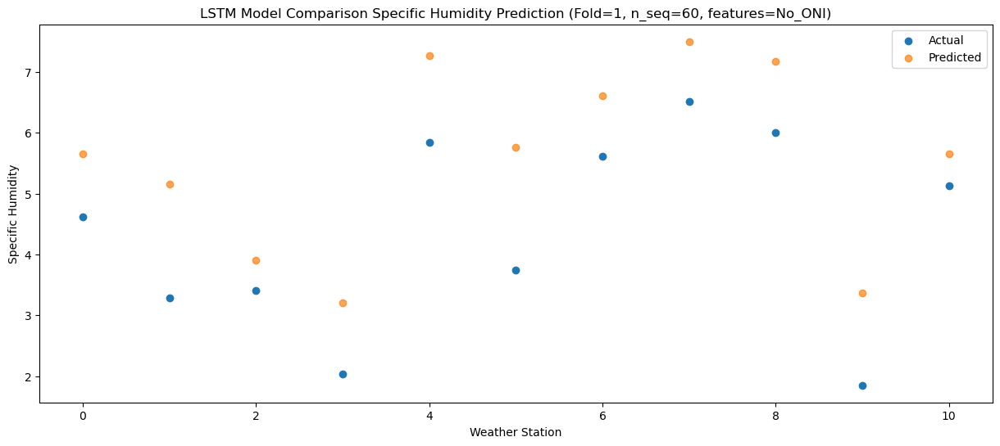

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.99   3.148439
1                 1    0.23   2.658439
2                 2    0.23   1.408439
3                 3   -0.07   0.708439
4                 4    3.36   4.768439
5                 5    3.19   3.258439
6                 6    2.50   4.108439
7                 7    4.50   4.998439
8                 8    4.90   4.668439
9                 9    1.53   0.858439
10               10    2.75   3.148439


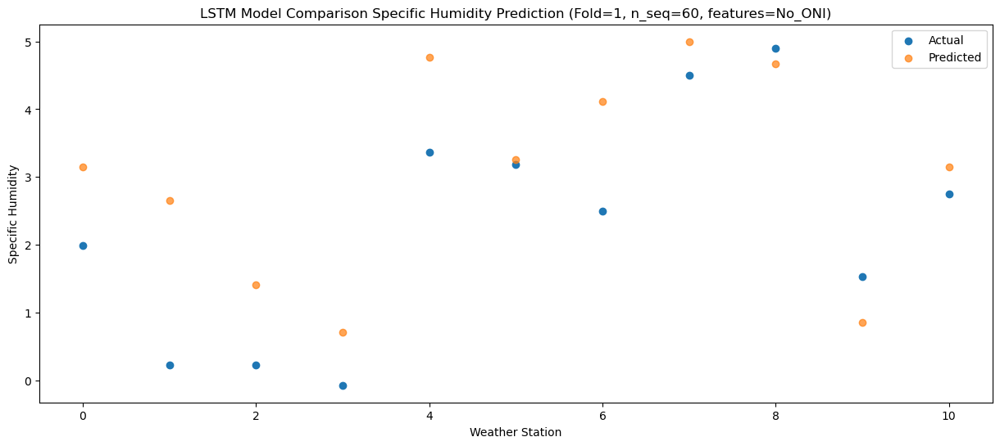

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -2.22   0.969365
1                 1   -2.36   0.479365
2                 2   -2.54  -0.770635
3                 3   -2.62  -1.470635
4                 4    0.54   2.589365
5                 5    0.75   1.079365
6                 6   -0.22   1.929365
7                 7    2.18   2.819365
8                 8    2.62   2.489365
9                 9   -0.33  -1.320635
10               10    0.59   0.969365


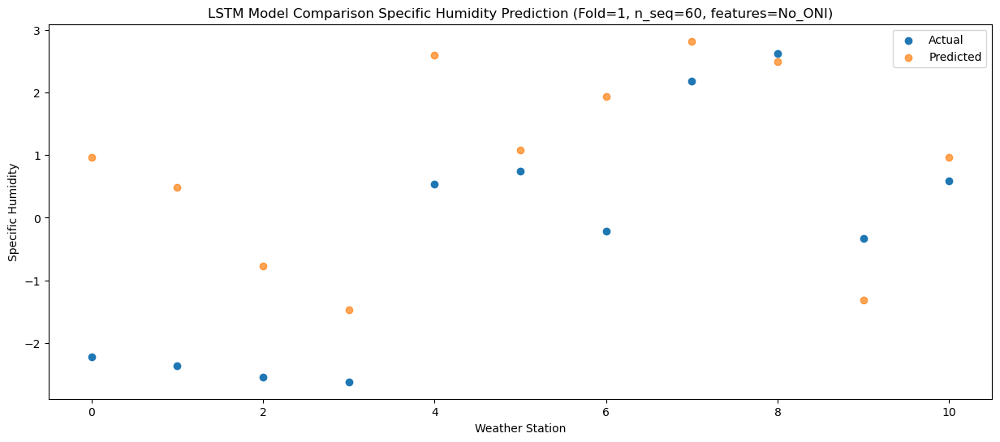

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -2.00    0.36738
1                 1   -2.34   -0.12262
2                 2   -2.39   -1.37262
3                 3   -2.96   -2.07262
4                 4    0.29    1.98738
5                 5    1.58    0.47738
6                 6   -0.33    1.32738
7                 7    2.05    2.21738
8                 8    2.78    1.88738
9                 9   -0.14   -1.92262
10               10   -0.14    0.36738


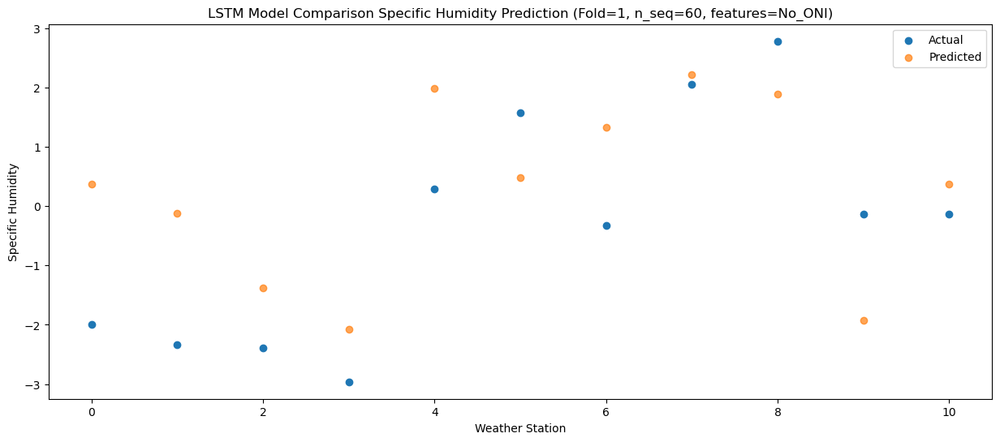

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -1.68   0.593786
1                 1   -2.15   0.103786
2                 2   -2.39  -1.146214
3                 3   -2.89  -1.846214
4                 4    0.33   2.213786
5                 5    0.95   0.703786
6                 6   -0.21   1.553786
7                 7    1.53   2.443786
8                 8    1.97   2.113786
9                 9   -0.88  -1.696214
10               10   -0.10   0.593786


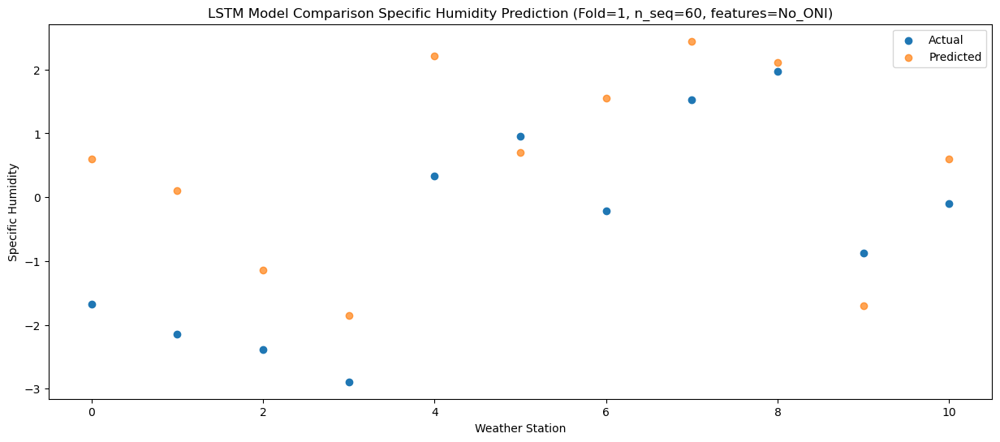

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0   -0.15   2.287462
1                 1   -0.62   1.797462
2                 2    0.23   0.547462
3                 3   -0.25  -0.152538
4                 4    3.05   3.907462
5                 5    1.74   2.397462
6                 6    1.35   3.247462
7                 7    4.26   4.137462
8                 8    4.58   3.807462
9                 9    0.94  -0.002538
10               10    1.14   2.287462


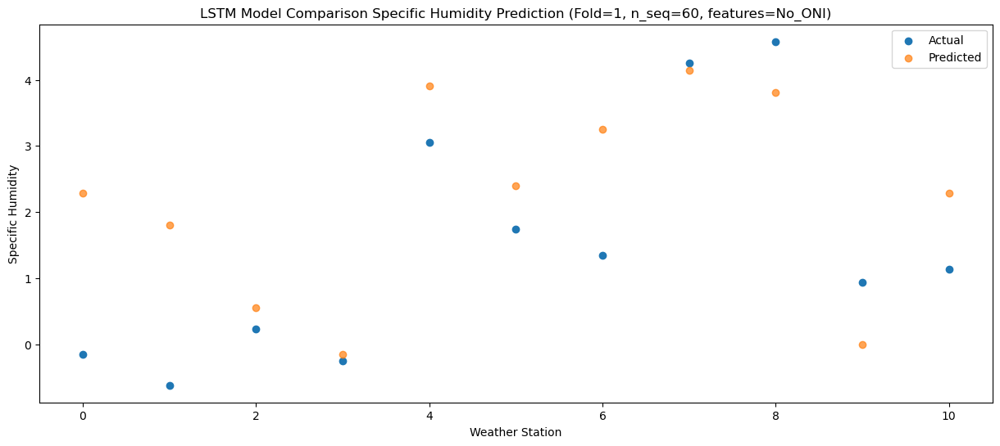

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    0.05   2.754759
1                 1   -0.26   2.264759
2                 2   -0.06   1.014759
3                 3    1.09   0.314759
4                 4    4.31   4.374759
5                 5    3.04   2.864759
6                 6    1.97   3.714759
7                 7    5.49   4.604759
8                 8    5.74   4.274759
9                 9    1.11   0.464759
10               10    2.51   2.754759


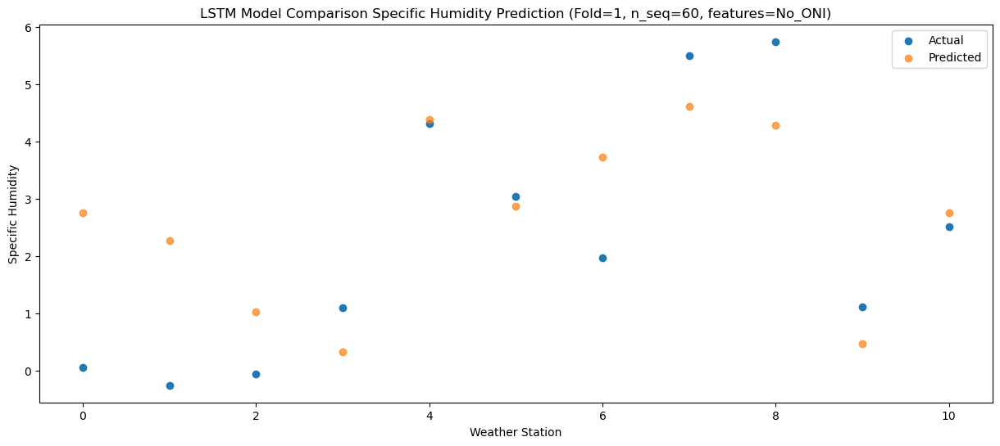

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    2.73   5.387146
1                 1    2.66   4.897146
2                 2    2.78   3.647146
3                 3    4.98   2.947146
4                 4    8.34   7.007146
5                 5    7.35   5.497146
6                 6    4.90   6.347146
7                 7    8.70   7.237146
8                 8    9.96   6.907146
9                 9    6.26   3.097146
10               10    4.04   5.387146


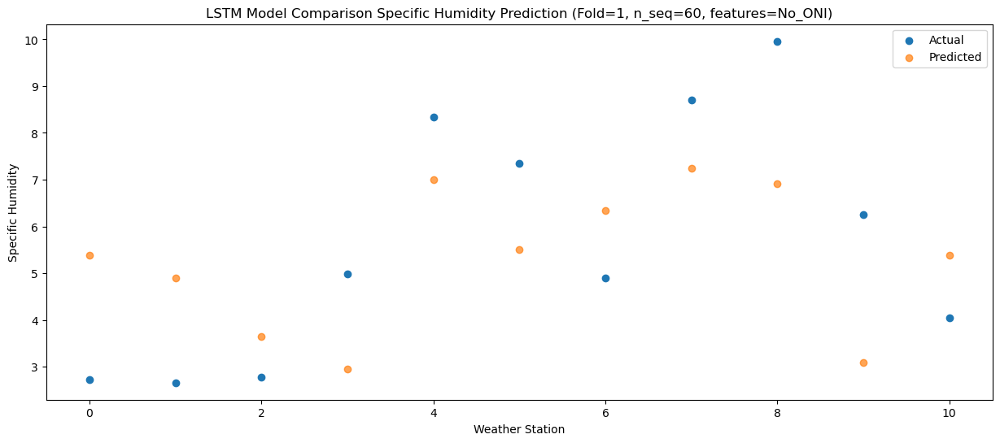

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    7.89   8.974232
1                 1    6.64   8.484232
2                 2    7.30   7.234232
3                 3    8.17   6.534232
4                 4   11.75  10.594232
5                 5    9.52   9.084232
6                 6    9.25   9.934232
7                 7   13.46  10.824232
8                 8   13.10  10.494232
9                 9    9.25   6.684232
10               10    9.36   8.974232


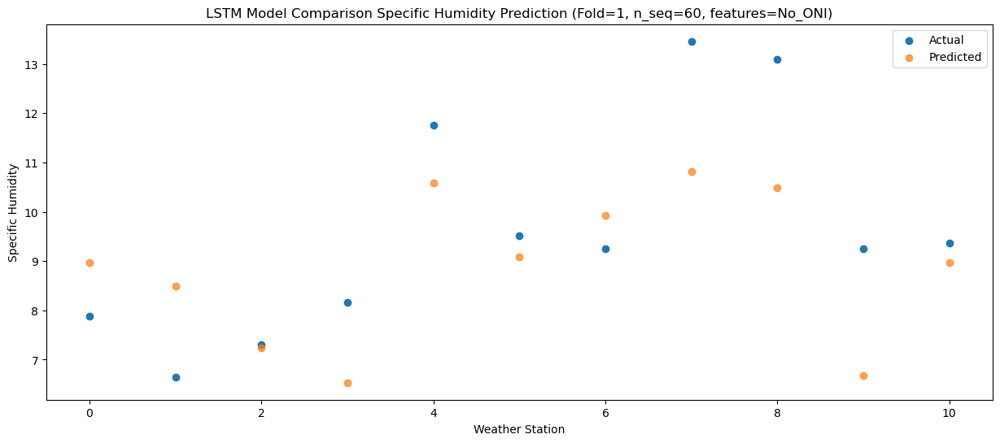

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    9.04   9.515059
1                 1    8.51   9.025059
2                 2    8.89   7.775059
3                 3    8.65   7.075059
4                 4   11.93  11.135059
5                 5   10.85   9.625059
6                 6   11.75  10.475059
7                 7   14.09  11.365059
8                 8   14.15  11.035059
9                 9   10.49   7.225059
10               10   11.22   9.515059


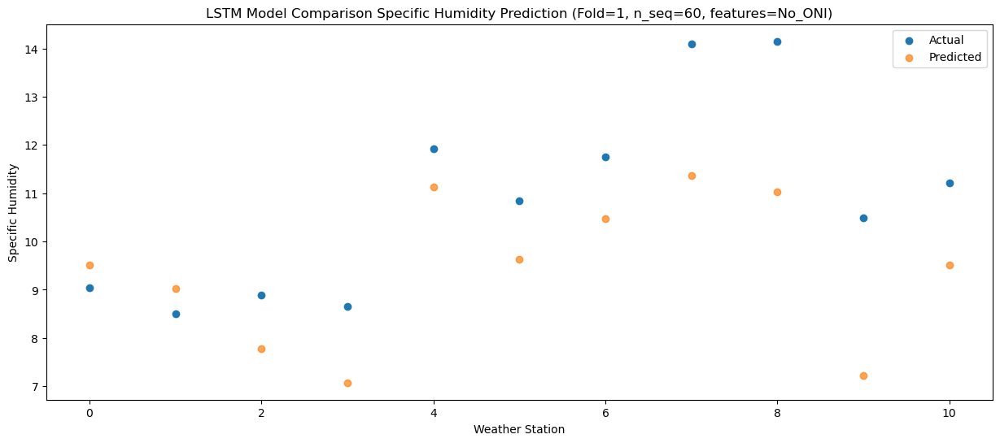

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    9.80   9.902564
1                 1    8.72   9.412564
2                 2    9.11   8.162564
3                 3    8.99   7.462564
4                 4   11.97  11.522564
5                 5   11.07  10.012564
6                 6   12.04  10.862564
7                 7   13.94  11.752564
8                 8   13.73  11.422564
9                 9    9.46   7.612564
10               10   11.56   9.902564


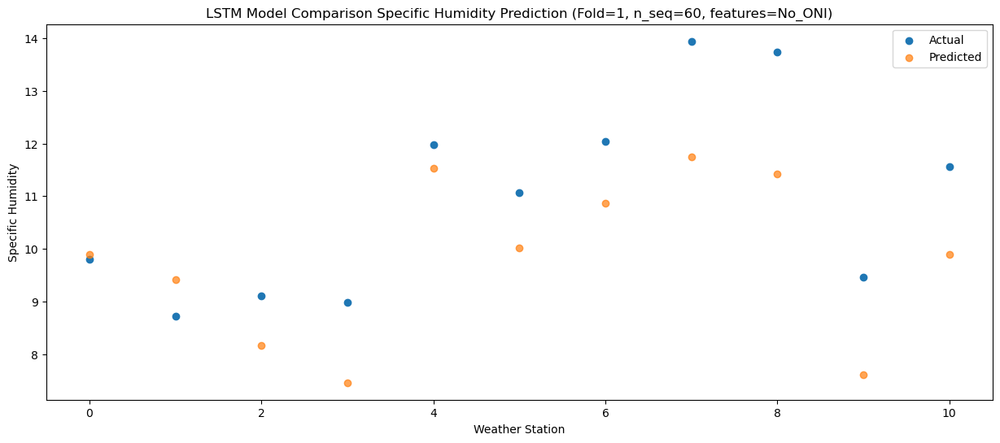

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    6.32   7.354674
1                 1    5.77   6.864674
2                 2    6.35   5.614674
3                 3    5.90   4.914674
4                 4    8.87   8.974674
5                 5    7.53   7.464674
6                 6    8.69   8.314674
7                 7   10.69   9.204674
8                 8   10.16   8.874674
9                 9    6.50   5.064674
10               10    8.37   7.354674


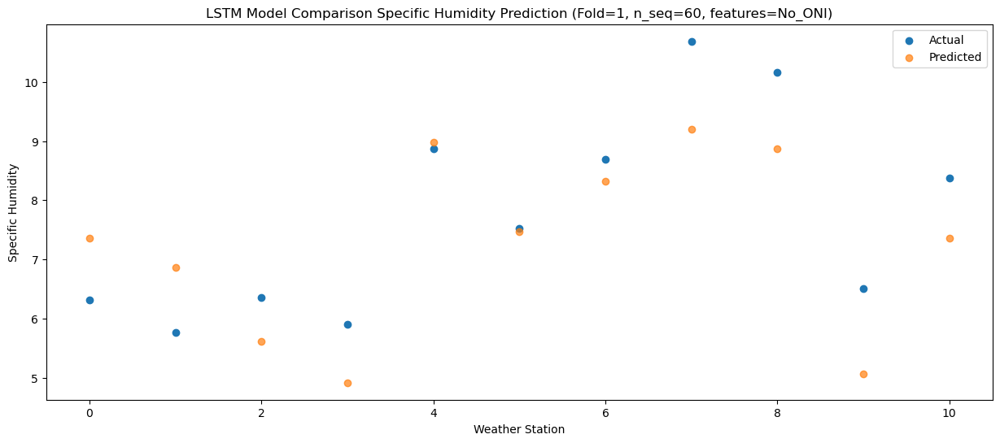

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    3.74   5.572164
1                 1    3.73   5.082164
2                 2    3.60   3.832164
3                 3    3.65   3.132164
4                 4    6.92   7.192164
5                 5    4.42   5.682164
6                 6    6.56   6.532164
7                 7    7.96   7.422164
8                 8    7.72   7.092164
9                 9    3.06   3.282164
10               10    6.51   5.572164


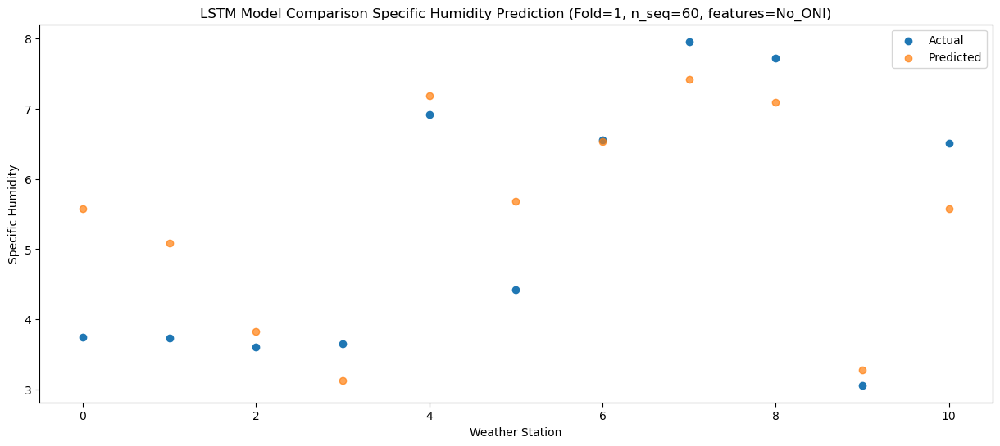

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -1.92   2.961503
1                 1   -1.86   2.471503
2                 2   -1.90   1.221503
3                 3   -0.80   0.521503
4                 4    2.33   4.581503
5                 5    2.58   3.071503
6                 6    0.63   3.921503
7                 7    3.40   4.811503
8                 8    4.19   4.481503
9                 9    0.70   0.671503
10               10    1.32   2.961503


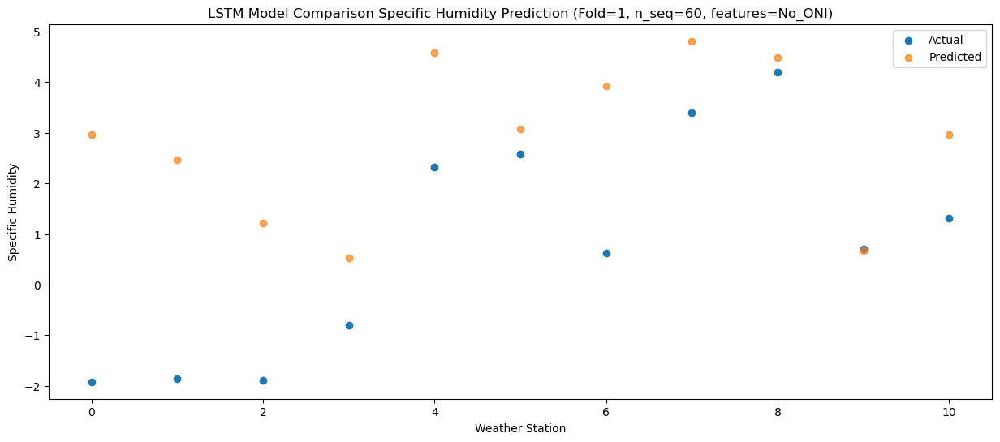

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    0.19    2.87168
1                 1    0.31    2.38168
2                 2    0.74    1.13168
3                 3    2.12    0.43168
4                 4    5.26    4.49168
5                 5    1.53    2.98168
6                 6    2.50    3.83168
7                 7    5.04    4.72168
8                 8    3.58    4.39168
9                 9   -0.28    0.58168
10               10    1.20    2.87168


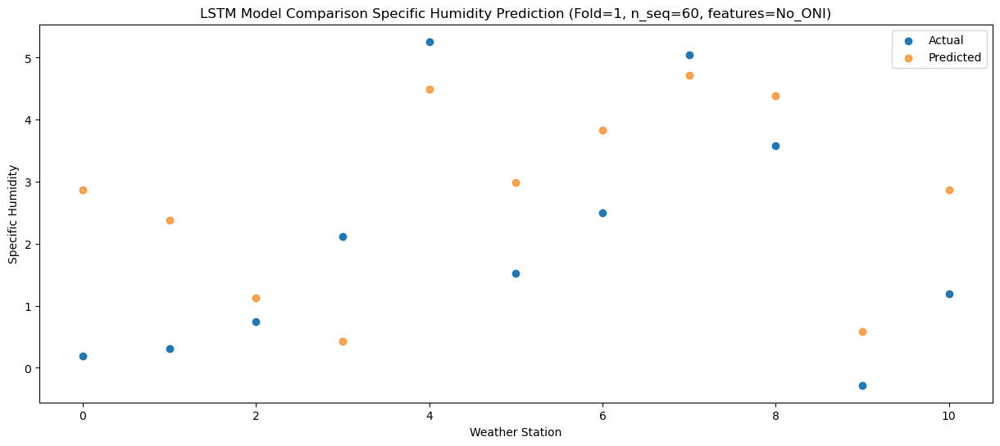

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -3.06   1.262664
1                 1   -2.69   0.772664
2                 2   -3.14  -0.477336
3                 3   -3.53  -1.177336
4                 4   -0.28   2.882664
5                 5    0.26   1.372664
6                 6   -0.50   2.222664
7                 7    1.29   3.112664
8                 8    1.60   2.782664
9                 9   -0.92  -1.027336
10               10   -0.41   1.262664


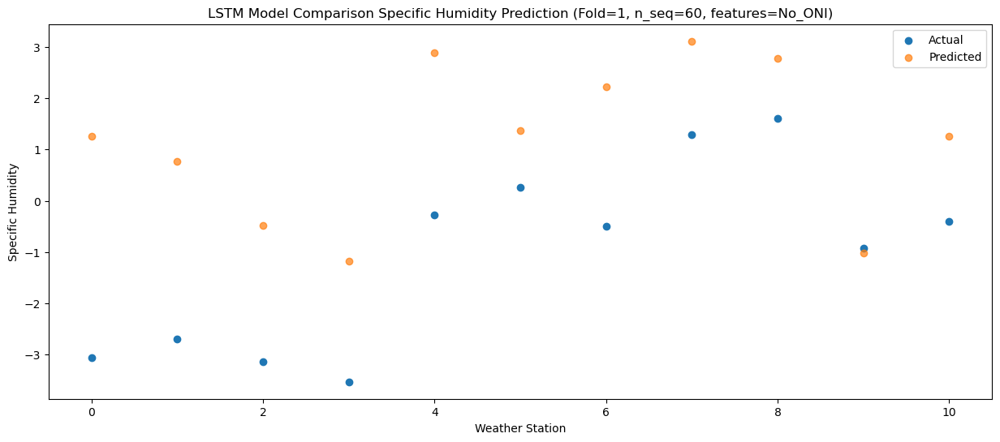

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -1.12   2.365701
1                 1   -1.74   1.875701
2                 2   -2.11   0.625701
3                 3   -3.36  -0.074299
4                 4   -0.08   3.985701
5                 5    0.14   2.475701
6                 6    0.63   3.325701
7                 7    1.97   4.215701
8                 8    2.13   3.885701
9                 9   -1.00   0.075701
10               10    0.33   2.365701


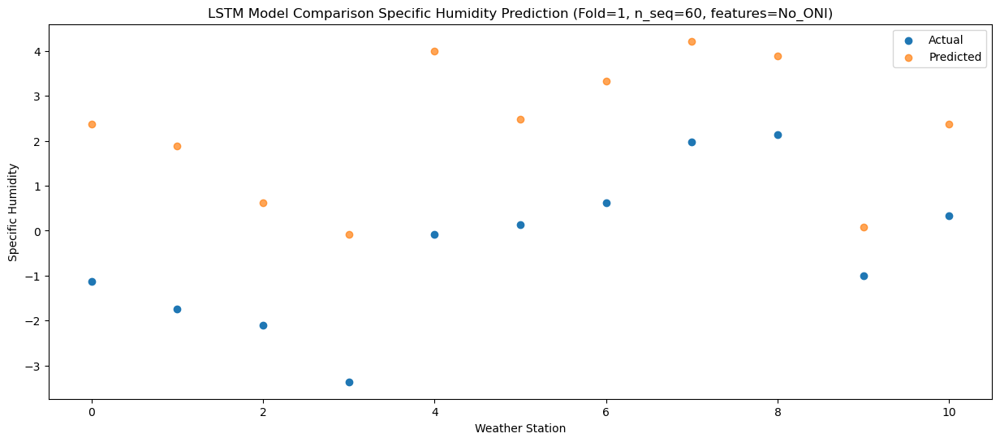

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -0.01   3.153541
1                 1   -1.06   2.663541
2                 2   -1.32   1.413541
3                 3   -1.68   0.713541
4                 4    1.62   4.773541
5                 5    0.69   3.263541
6                 6    1.38   4.113541
7                 7    3.50   5.003541
8                 8    3.22   4.673541
9                 9   -0.04   0.863541
10               10    1.35   3.153541


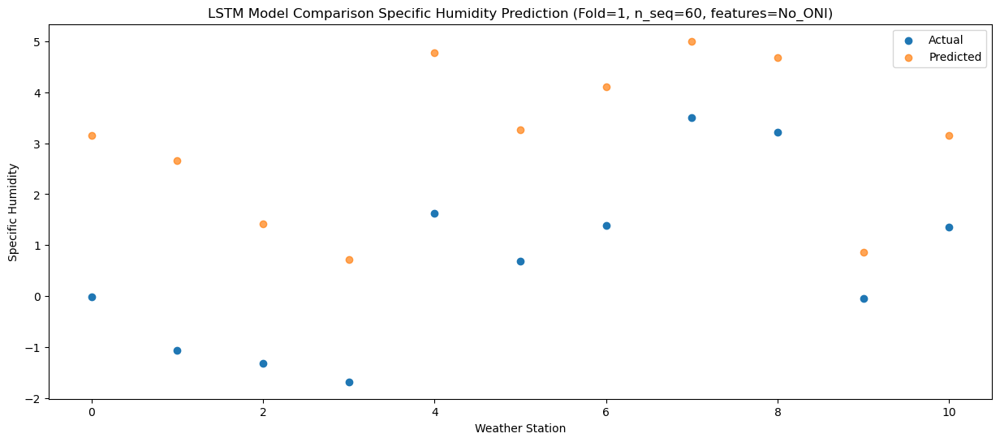

Predictions for (t+29):
    Weather_Station        Actual  Predicted
0                 0  1.010000e+00   4.452558
1                 1  1.332268e-15   3.962558
2                 2  4.400000e-01   2.712558
3                 3  2.480000e+00   2.012558
4                 4  5.720000e+00   6.072558
5                 5  2.960000e+00   4.562558
6                 6  2.570000e+00   5.412558
7                 7  5.690000e+00   6.302558
8                 8  6.340000e+00   5.972558
9                 9  9.300000e-01   2.162558
10               10  2.010000e+00   4.452558


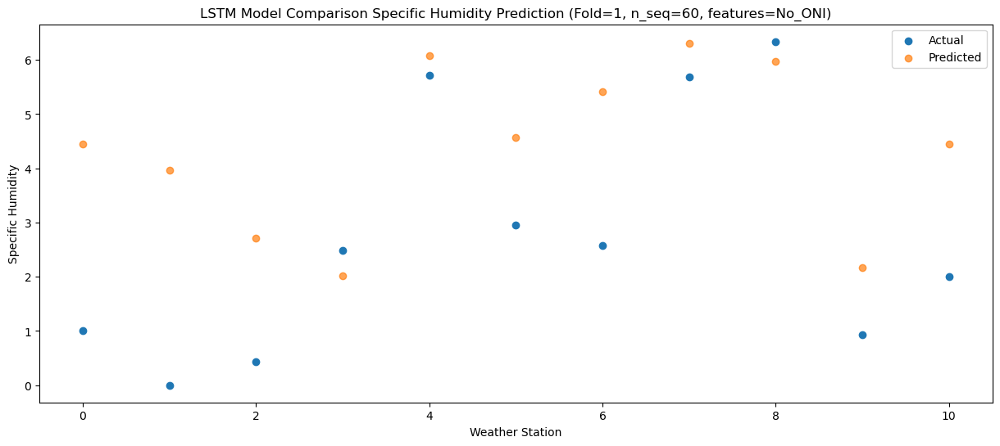

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    4.99   7.588088
1                 1    4.17   7.098088
2                 2    4.80   5.848088
3                 3    6.29   5.148088
4                 4    9.60   9.208088
5                 5    4.73   7.698088
6                 6    6.83   8.548088
7                 7   10.14   9.438088
8                 8   10.58   9.108088
9                 9    3.49   5.298088
10               10    6.14   7.588088


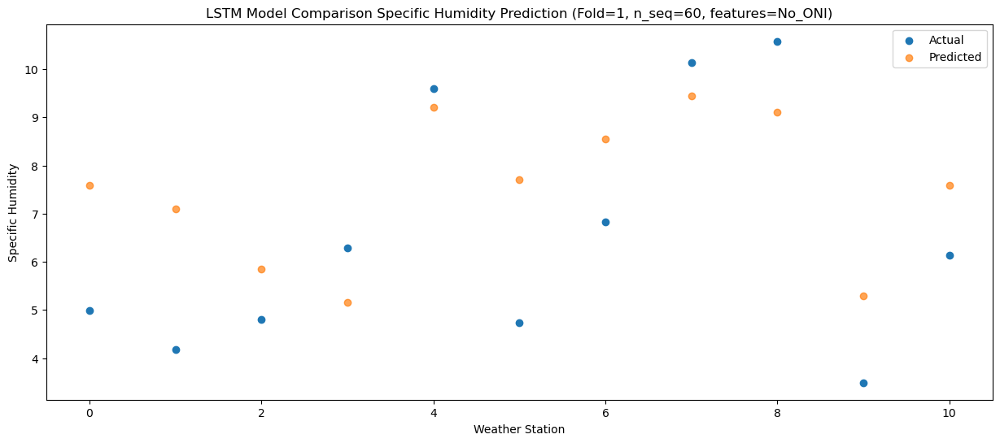

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    7.29   9.471562
1                 1    6.57   8.981562
2                 2    7.89   7.731562
3                 3    7.34   7.031562
4                 4   10.72  11.091562
5                 5    7.33   9.581562
6                 6    9.55  10.431562
7                 7   12.90  11.321562
8                 8   12.48  10.991562
9                 9    7.67   7.181562
10               10    7.73   9.471562


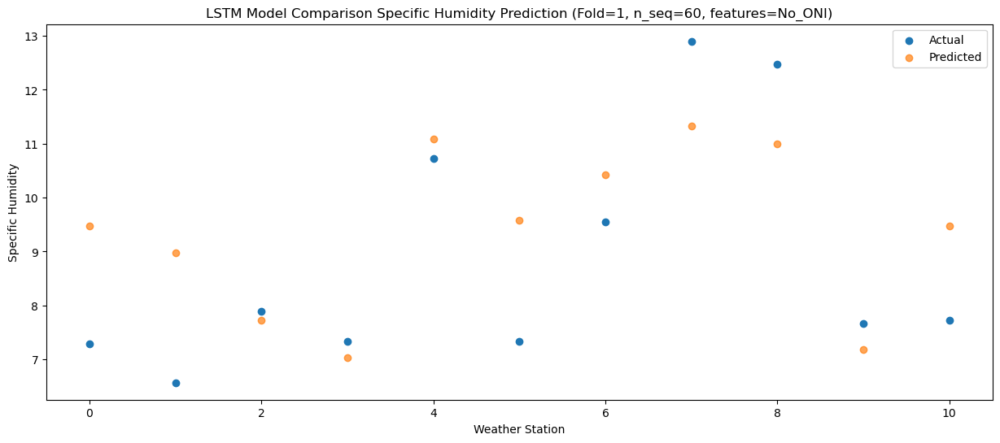

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0    9.91  11.056222
1                 1    9.24  10.566222
2                 2    9.52   9.316222
3                 3    8.26   8.616222
4                 4   11.47  12.676222
5                 5    8.28  11.166222
6                 6   12.54  12.016222
7                 7   13.87  12.906222
8                 8   11.84  12.576222
9                 9    8.32   8.766222
10               10   11.36  11.056222


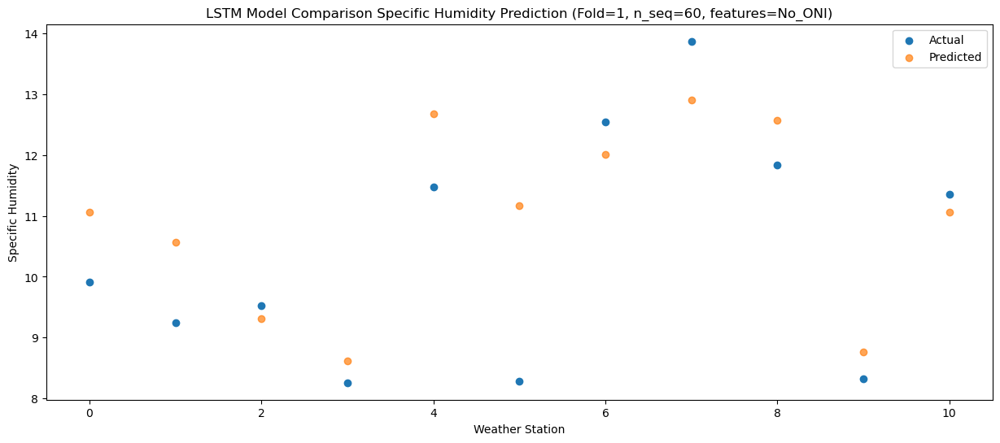

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    8.91  10.205657
1                 1    8.83   9.715657
2                 2    8.65   8.465657
3                 3    8.51   7.765657
4                 4   11.85  11.825657
5                 5   10.39  10.315657
6                 6   11.45  11.165657
7                 7   13.78  12.055657
8                 8   12.58  11.725657
9                 9    8.73   7.915657
10               10   10.93  10.205657


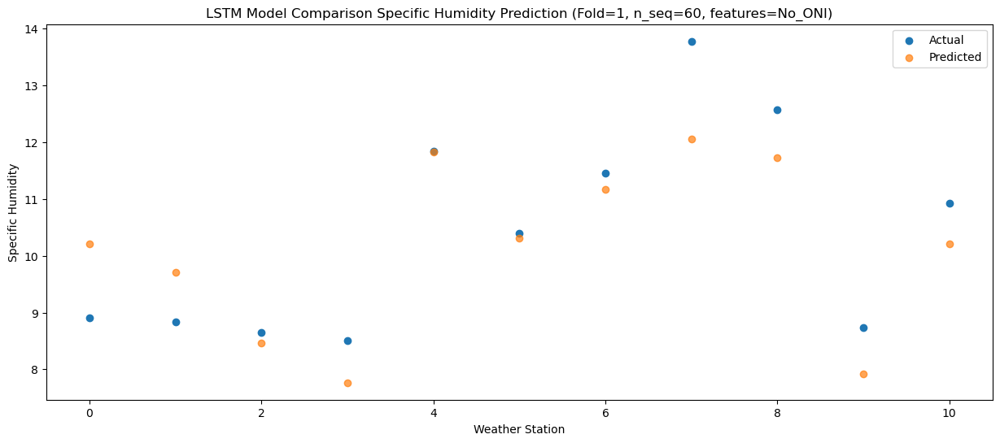

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    6.29   8.440333
1                 1    5.47   7.950333
2                 2    5.14   6.700333
3                 3    5.22   6.000333
4                 4    8.50  10.060333
5                 5    9.12   8.550333
6                 6    7.97   9.400333
7                 7    9.82  10.290333
8                 8    9.84   9.960333
9                 9    6.73   6.150333
10               10    7.68   8.440333


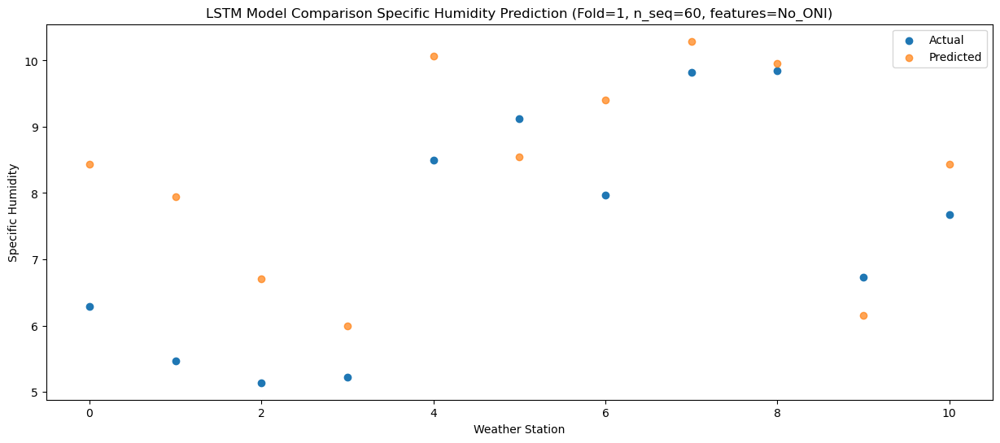

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    1.43   5.811922
1                 1    0.58   5.321922
2                 2    0.03   4.071922
3                 3    0.26   3.371922
4                 4    3.60   7.431922
5                 5    5.93   5.921922
6                 6    2.91   6.771922
7                 7    5.28   7.661922
8                 8    5.89   7.331922
9                 9    3.34   3.521922
10               10    4.24   5.811922


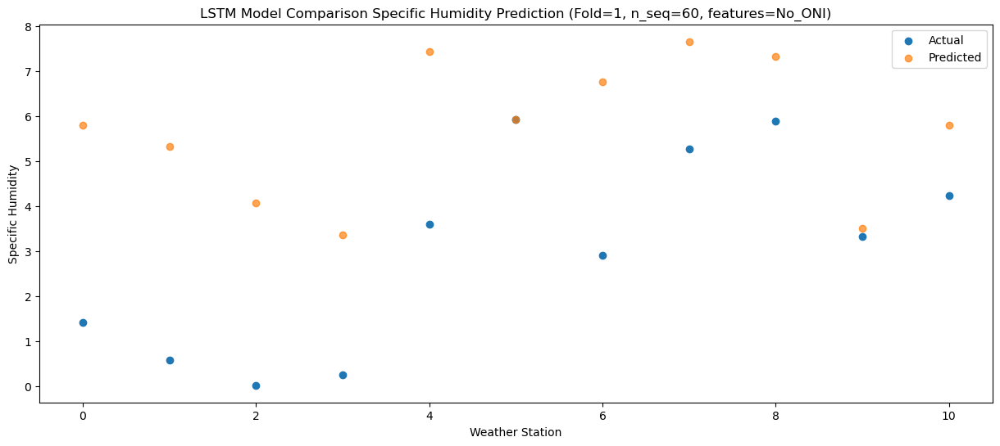

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    0.90   5.169064
1                 1    0.10   4.679064
2                 2   -0.34   3.429064
3                 3   -0.24   2.729064
4                 4    3.22   6.789064
5                 5    3.06   5.279064
6                 6    2.42   6.129064
7                 7    4.03   7.019064
8                 8    4.91   6.689064
9                 9    1.36   2.879064
10               10    2.74   5.169064


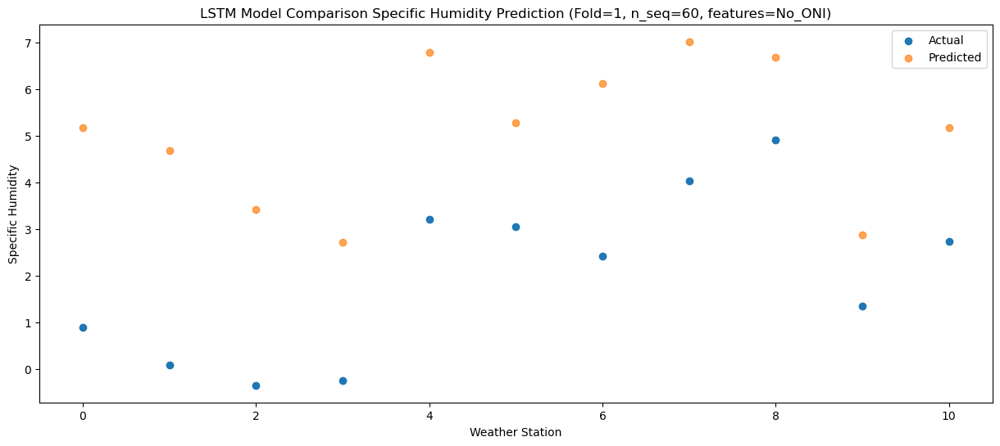

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -1.82   3.496893
1                 1   -1.49   3.006893
2                 2   -1.03   1.756893
3                 3   -1.05   1.056893
4                 4    2.40   5.116893
5                 5    2.39   3.606893
6                 6    0.52   4.456893
7                 7    3.12   5.346893
8                 8    3.17   5.016893
9                 9    0.15   1.206893
10               10    0.61   3.496893


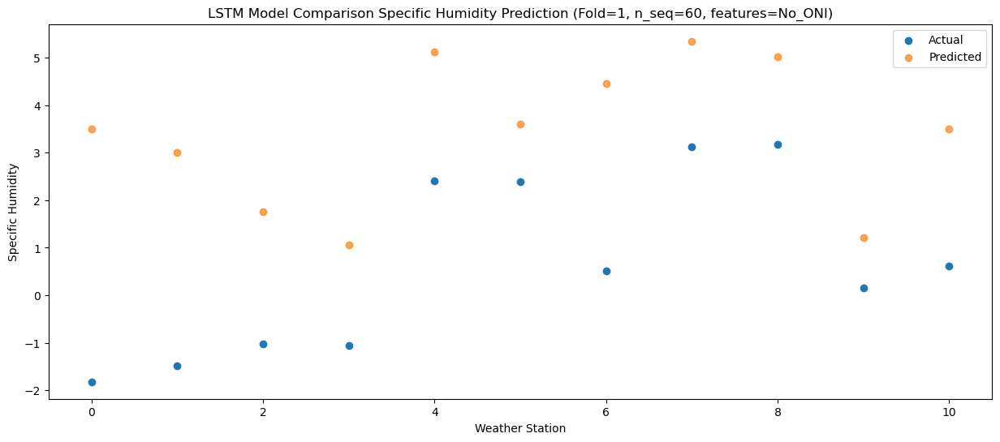

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -1.36   4.378669
1                 1   -1.08   3.888669
2                 2   -1.06   2.638669
3                 3   -1.47   1.938669
4                 4    1.92   5.998669
5                 5    0.84   4.488669
6                 6    0.88   5.338669
7                 7    3.24   6.228669
8                 8    2.69   5.898669
9                 9   -0.16   2.088669
10               10    1.47   4.378669


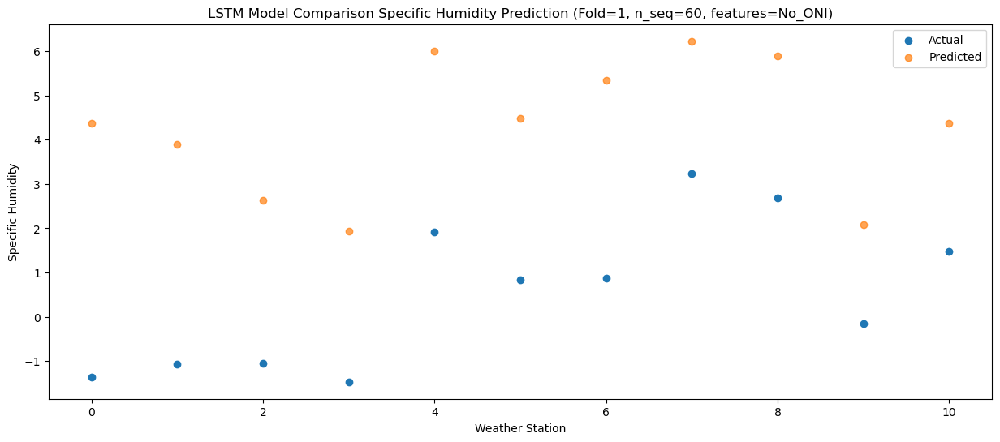

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    0.25   4.608699
1                 1    0.04   4.118699
2                 2   -0.01   2.868699
3                 3   -0.69   2.168699
4                 4    2.52   6.228699
5                 5    0.87   4.718699
6                 6    2.08   5.568699
7                 7    3.34   6.458699
8                 8    3.02   6.128699
9                 9   -0.30   2.318699
10               10    0.67   4.608699


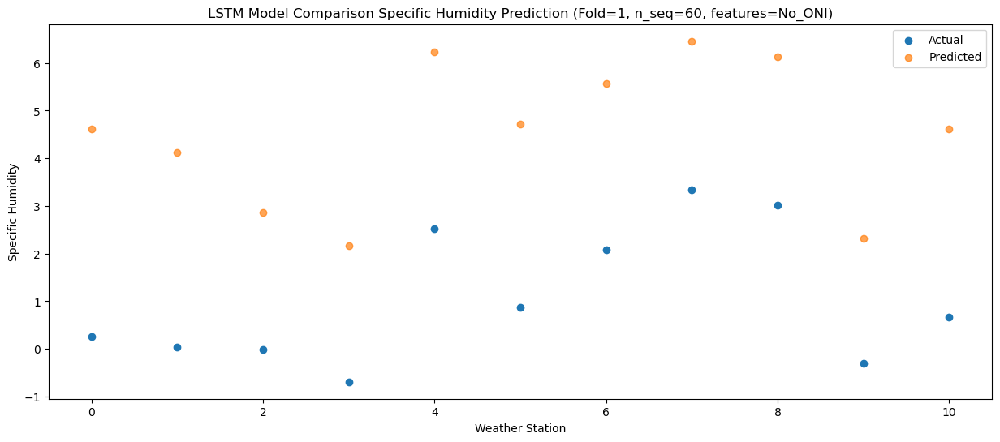

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -0.13   4.423647
1                 1   -0.83   3.933647
2                 2   -0.48   2.683647
3                 3    0.86   1.983647
4                 4    4.22   6.043647
5                 5    1.92   4.533647
6                 6    1.32   5.383647
7                 7    4.10   6.273647
8                 8    4.44   5.943647
9                 9    0.49   2.133647
10               10    0.70   4.423647


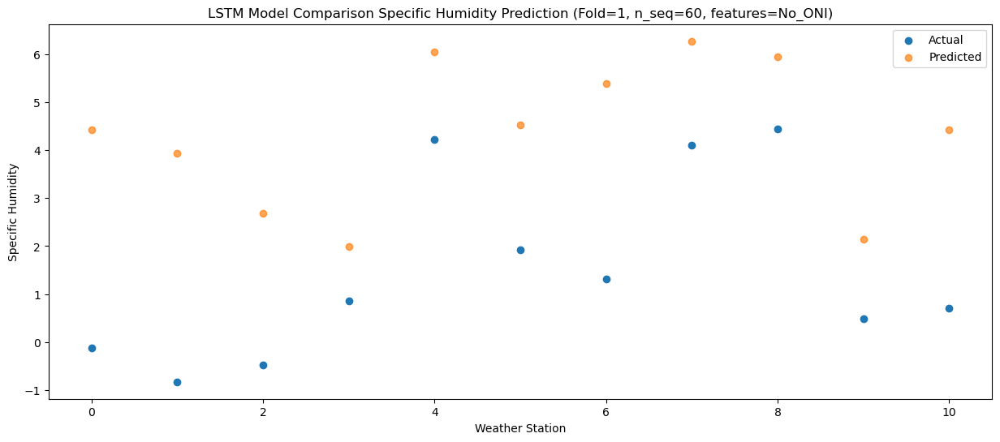

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    1.57   6.373065
1                 1    0.77   5.883065
2                 2    0.88   4.633065
3                 3    1.23   3.933065
4                 4    4.67   7.993065
5                 5    2.18   6.483065
6                 6    3.13   7.333065
7                 7    5.30   8.223065
8                 8    5.66   7.893065
9                 9    1.01   4.083065
10               10    3.31   6.373065


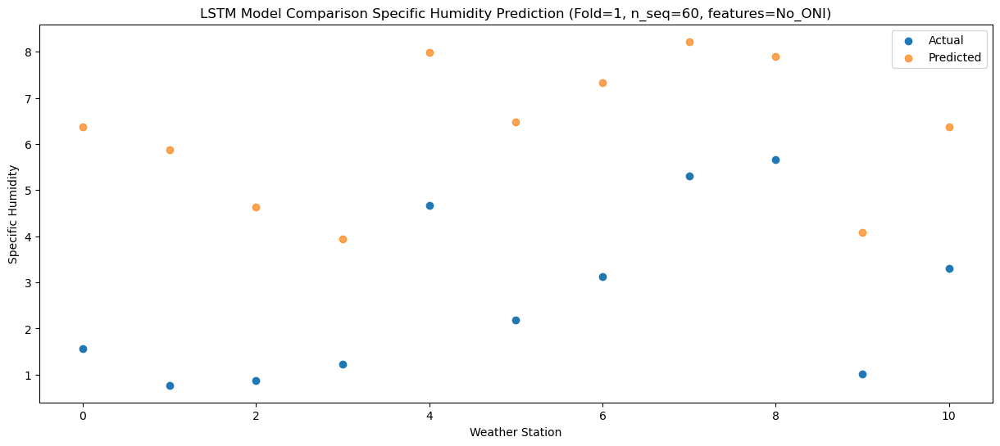

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    2.77   8.331158
1                 1    3.51   7.841158
2                 2    4.18   6.591158
3                 3    5.01   5.891158
4                 4    8.34   9.951158
5                 5    6.55   8.441158
6                 6    5.69   9.291158
7                 7    9.34  10.181158
8                 8   10.71   9.851158
9                 9    6.74   6.041158
10               10    3.61   8.331158


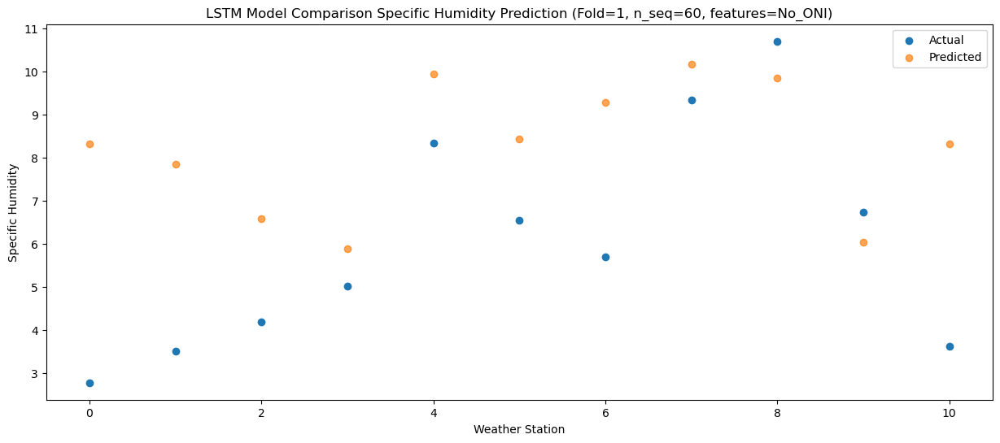

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    6.12  10.432334
1                 1    5.86   9.942334
2                 2    6.83   8.692334
3                 3    8.41   7.992334
4                 4   11.60  12.052334
5                 5    6.50  10.542334
6                 6    8.27  11.392334
7                 7   12.26  12.282334
8                 8   13.29  11.952334
9                 9    8.35   8.142334
10               10    6.90  10.432334


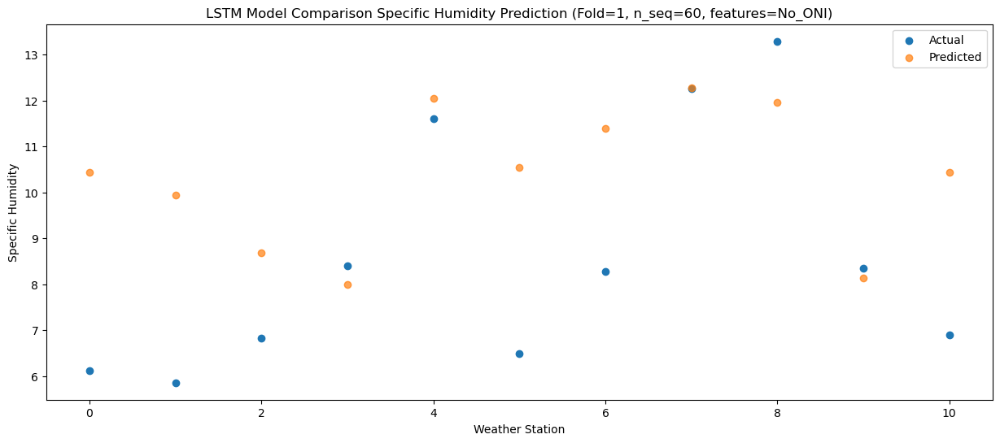

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0    9.53  12.029905
1                 1    8.82  11.539905
2                 2    9.97  10.289905
3                 3    8.97   9.589905
4                 4   11.68  13.649905
5                 5    8.67  12.139905
6                 6   11.89  12.989905
7                 7   14.83  13.879905
8                 8   13.52  13.549905
9                 9   10.28   9.739905
10               10   11.61  12.029905


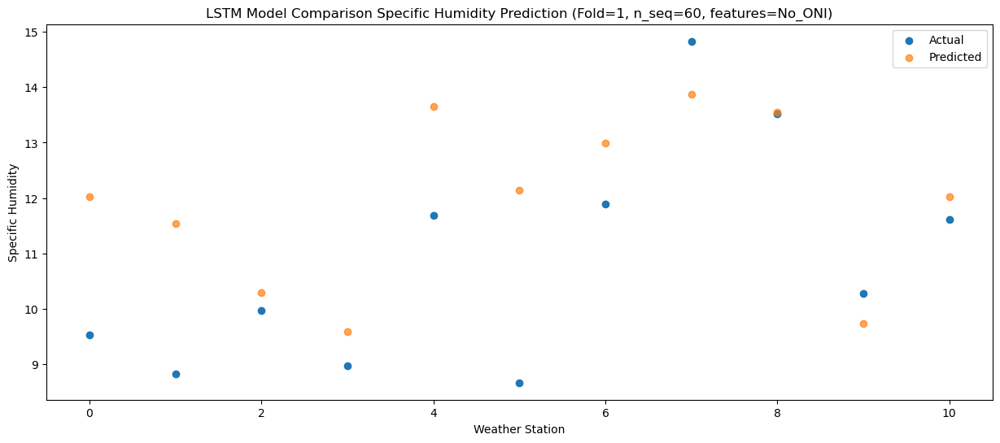

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    9.36  11.137683
1                 1    8.95  10.647683
2                 2    9.90   9.397683
3                 3    7.30   8.697683
4                 4   10.28  12.757683
5                 5    8.82  11.247683
6                 6   11.78  12.097683
7                 7   14.41  12.987683
8                 8   11.69  12.657683
9                 9    8.37   8.847683
10               10    9.32  11.137683


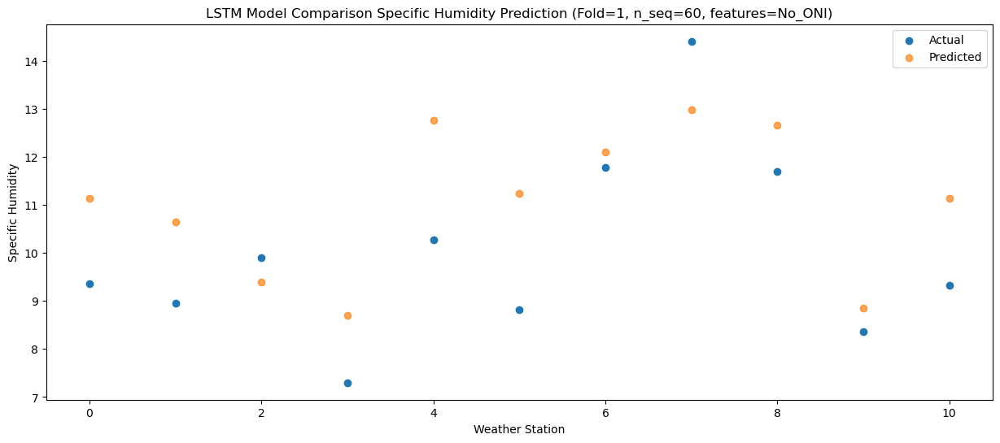

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    5.50  10.149646
1                 1    5.84   9.659646
2                 2    6.09   8.409646
3                 3    6.10   7.709646
4                 4    9.53  11.769646
5                 5    8.46  10.259646
6                 6    8.81  11.109646
7                 7    9.92  11.999646
8                 8   10.74  11.669646
9                 9    6.72   7.859646
10               10    8.06  10.149646


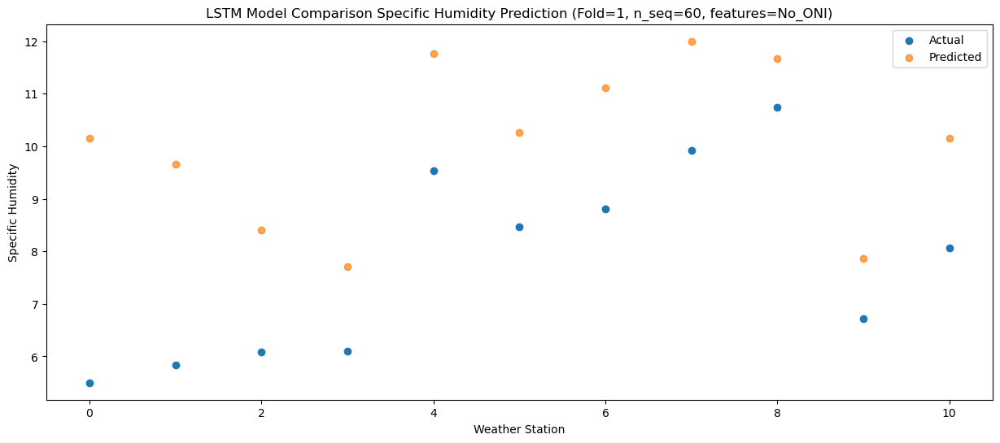

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    2.10   7.535236
1                 1    1.99   7.045236
2                 2    1.58   5.795236
3                 3    2.68   5.095236
4                 4    6.14   9.155236
5                 5    6.48   7.645236
6                 6    4.56   8.495236
7                 7    6.67   9.385236
8                 8    7.31   9.055236
9                 9    3.61   5.245236
10               10    5.01   7.535236


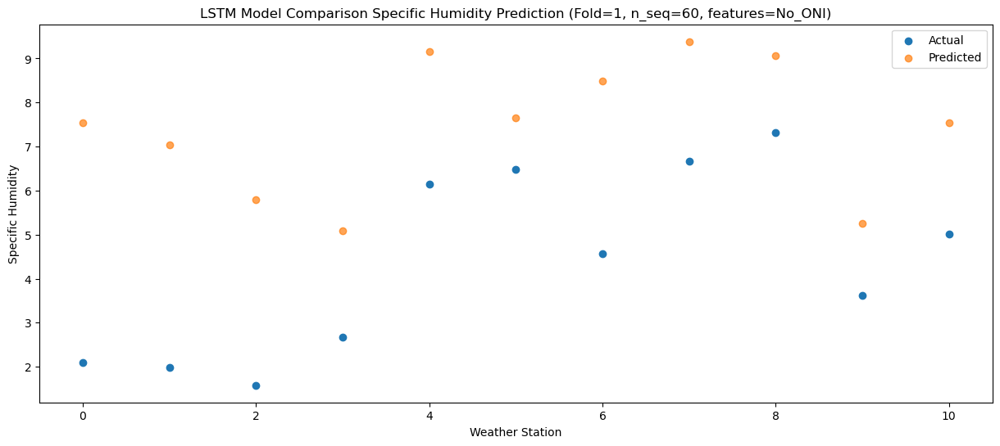

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -0.96   4.803669
1                 1   -1.02   4.313669
2                 2   -0.97   3.063669
3                 3   -0.65   2.363669
4                 4    2.80   6.423669
5                 5    3.85   4.913669
6                 6    1.21   5.763669
7                 7    3.96   6.653669
8                 8    4.64   6.323669
9                 9    1.29   2.513669
10               10    1.35   4.803669


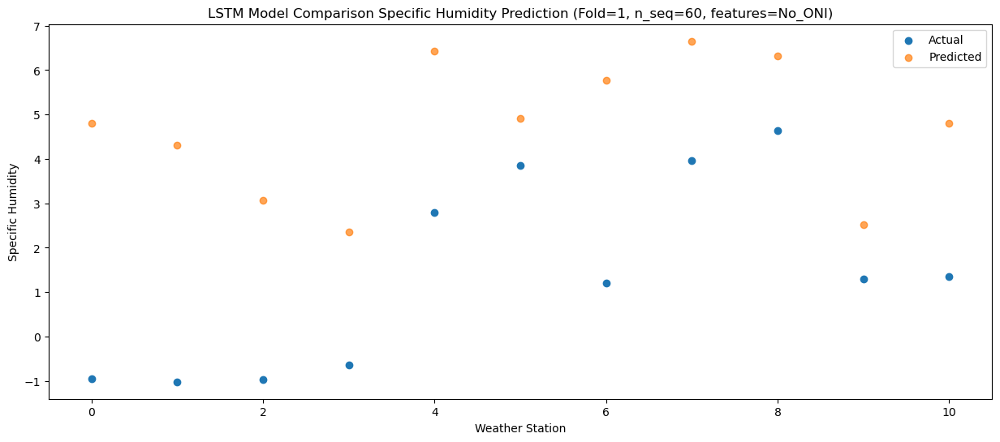

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -1.71   4.298185
1                 1   -1.60   3.808185
2                 2   -1.99   2.558185
3                 3   -2.29   1.858185
4                 4    1.08   5.918185
5                 5    1.98   4.408185
6                 6    0.71   5.258185
7                 7    2.57   6.148185
8                 8    3.59   5.818185
9                 9    0.85   2.008185
10               10    1.59   4.298185


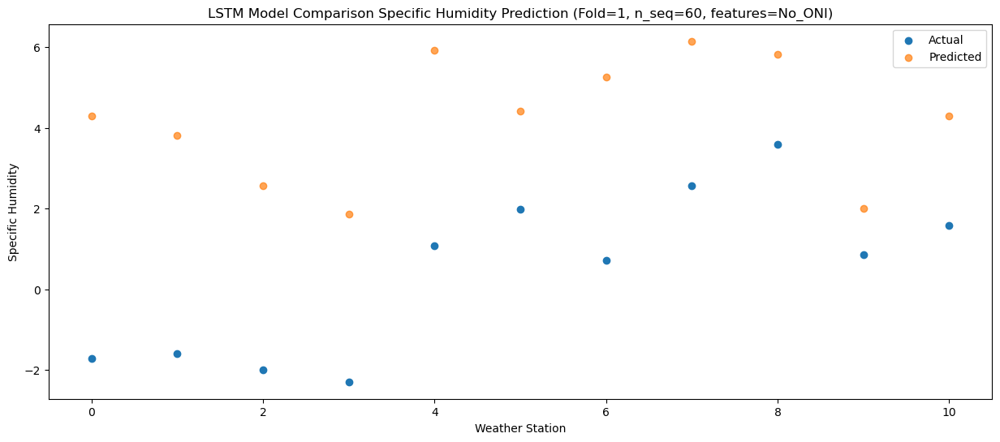

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -2.10   3.134717
1                 1   -2.37   2.644717
2                 2   -2.62   1.394717
3                 3   -3.39   0.694717
4                 4   -0.09   4.754717
5                 5    0.83   3.244717
6                 6   -0.11   4.094717
7                 7    1.50   4.984717
8                 8    2.28   4.654717
9                 9    0.11   0.844717
10               10    0.54   3.134717


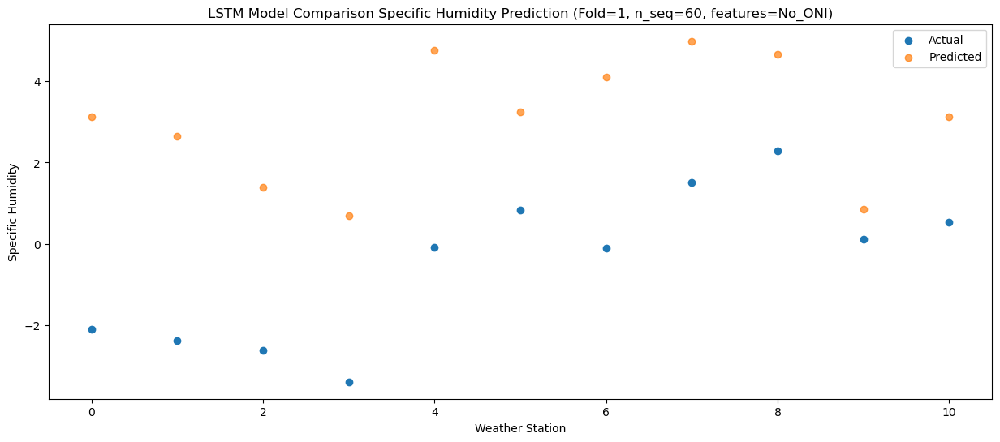

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -2.49   3.377142
1                 1   -2.03   2.887142
2                 2   -1.82   1.637142
3                 3   -1.14   0.937142
4                 4    2.16   4.997142
5                 5    1.24   3.487142
6                 6    0.37   4.337142
7                 7    3.25   5.227142
8                 8    4.03   4.897142
9                 9    0.78   1.087142
10               10    0.41   3.377142


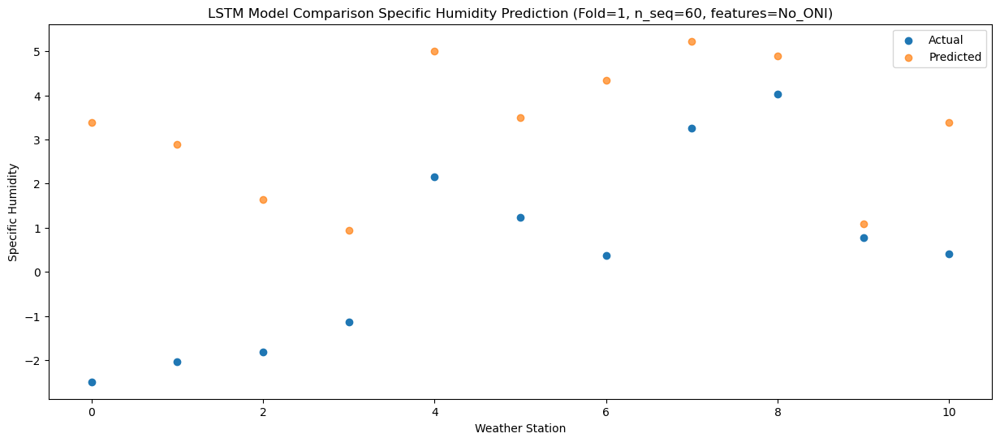

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -0.08   4.862538
1                 1   -0.52   4.372538
2                 2   -0.28   3.122538
3                 3    0.77   2.422538
4                 4    4.09   6.482538
5                 5    2.20   4.972538
6                 6    1.71   5.822538
7                 7    4.44   6.712538
8                 8    5.58   6.382538
9                 9    1.09   2.572538
10               10    1.44   4.862538


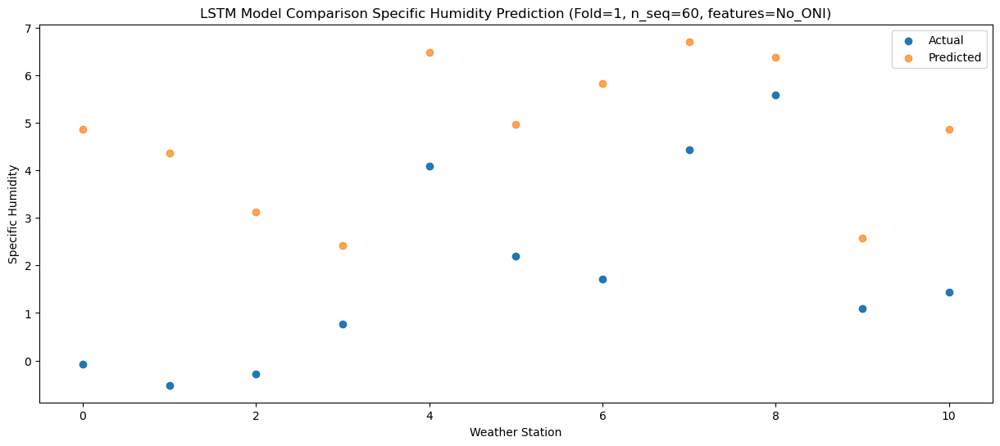

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    0.99   6.219281
1                 1    1.37   5.729281
2                 2    1.71   4.479281
3                 3    3.02   3.779281
4                 4    6.29   7.839281
5                 5    2.84   6.329281
6                 6    3.86   7.179281
7                 7    6.21   8.069281
8                 8    7.90   7.739281
9                 9    1.95   3.929281
10               10    3.05   6.219281


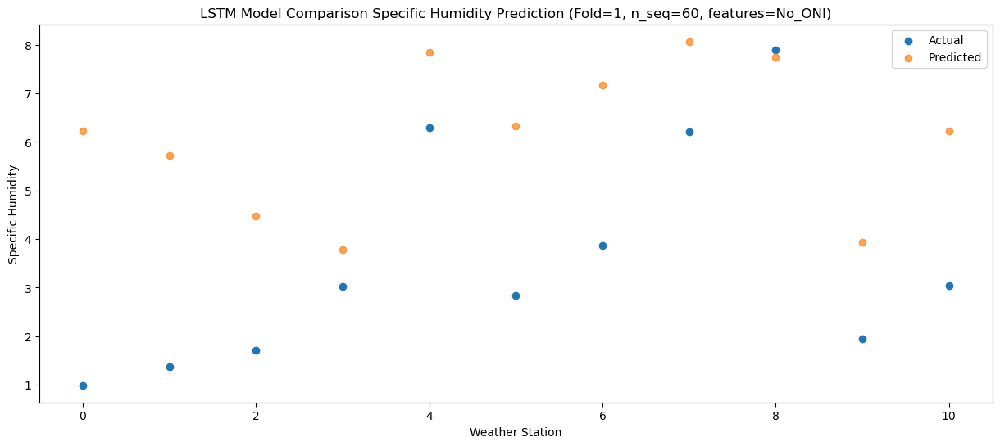

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    5.19   9.159612
1                 1    5.17   8.669612
2                 2    5.84   7.419612
3                 3    7.37   6.719612
4                 4   10.27  10.779612
5                 5    5.27   9.269612
6                 6    8.00  10.119612
7                 7   10.52  11.009612
8                 8   11.50  10.679612
9                 9    4.68   6.869612
10               10    6.63   9.159612


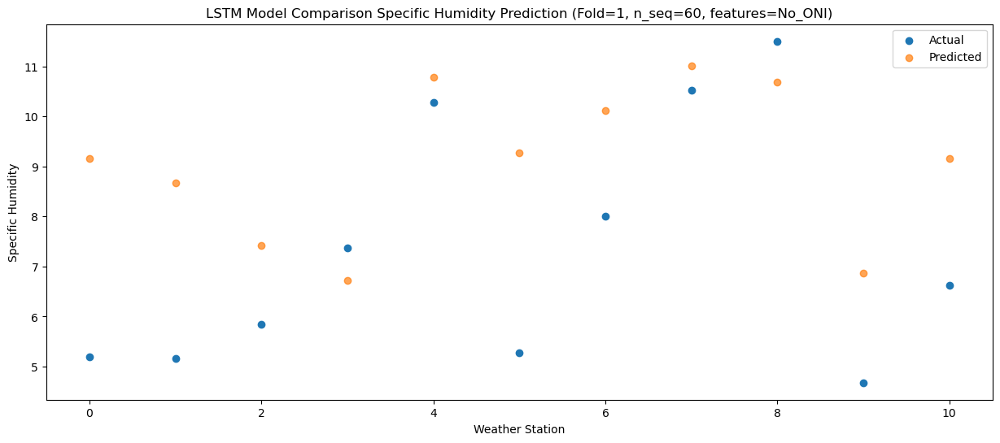

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    7.26  10.123302
1                 1    6.68   9.633302
2                 2    7.27   8.383302
3                 3    8.76   7.683302
4                 4   11.78  11.743302
5                 5   10.12  10.233302
6                 6    9.96  11.083302
7                 7   12.54  11.973302
8                 8   14.41  11.643302
9                 9   10.35   7.833302
10               10    8.45  10.123302


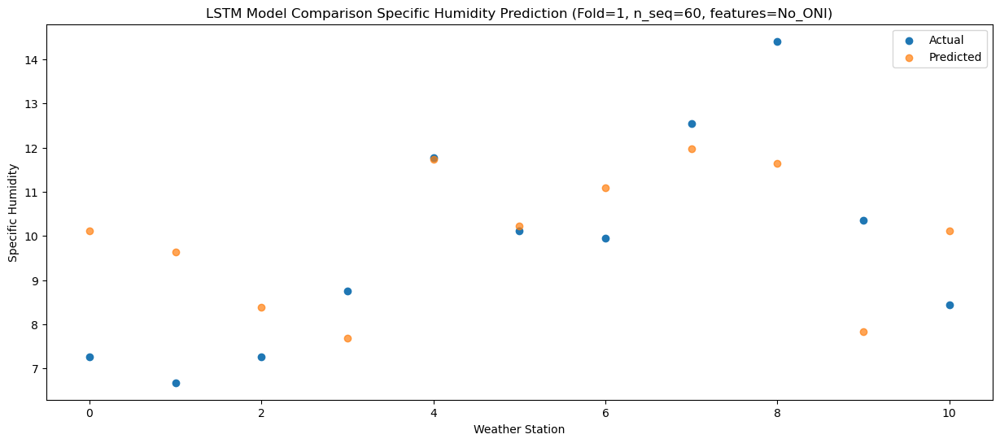

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0    9.68  11.764138
1                 1    9.28  11.274138
2                 2   10.44  10.024138
3                 3    8.84   9.324138
4                 4   12.10  13.384138
5                 5    9.97  11.874138
6                 6   12.34  12.724138
7                 7   13.21  13.614138
8                 8   13.02  13.284138
9                 9    8.60   9.474138
10               10   11.82  11.764138


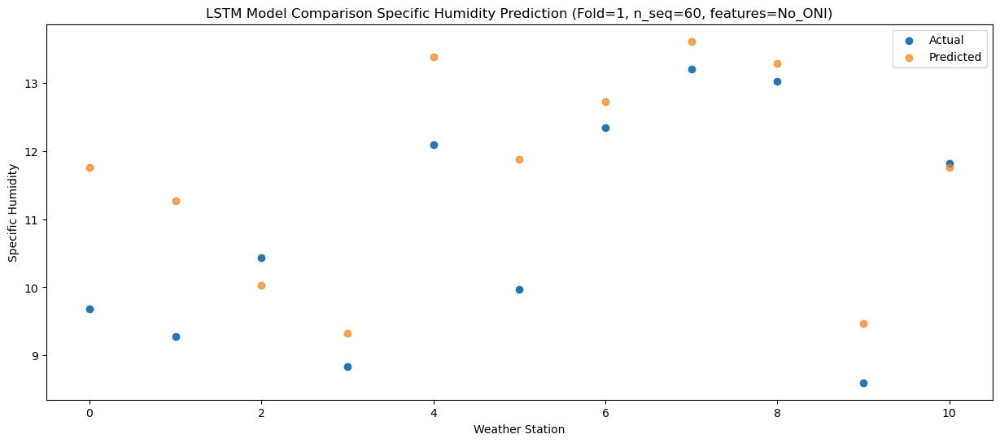

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    9.04   10.99106
1                 1    7.55   10.50106
2                 2    8.32    9.25106
3                 3    8.93    8.55106
4                 4   12.15   12.61106
5                 5    8.83   11.10106
6                 6   10.62   11.95106
7                 7   11.97   12.84106
8                 8   12.43   12.51106
9                 9    8.79    8.70106
10               10   10.24   10.99106


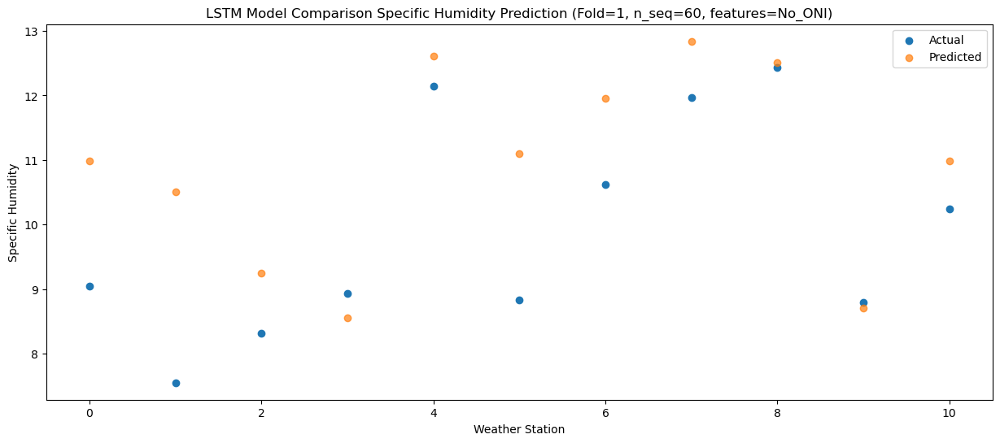

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    7.05   9.268315
1                 1    6.03   8.778315
2                 2    6.77   7.528315
3                 3    6.01   6.828315
4                 4    9.61  10.888315
5                 5    9.31   9.378315
6                 6    9.33  10.228315
7                 7   10.21  11.118315
8                 8   10.52  10.788315
9                 9    6.35   6.978315
10               10    7.75   9.268315


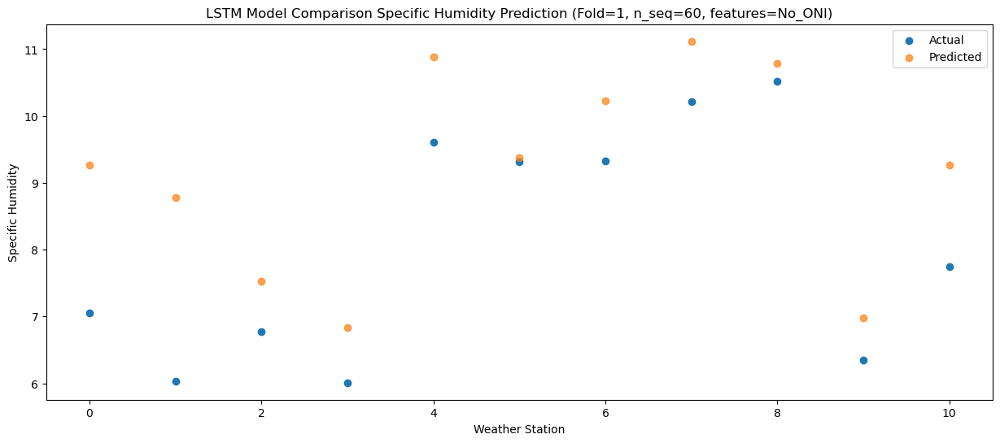

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    2.10   5.855412
1                 1    2.20   5.365412
2                 2    2.27   4.115412
3                 3    1.96   3.415412
4                 4    5.28   7.475412
5                 5    5.04   5.965412
6                 6    5.19   6.815412
7                 7    5.17   7.705412
8                 8    7.16   7.375412
9                 9    3.36   3.565412
10               10    3.44   5.855412


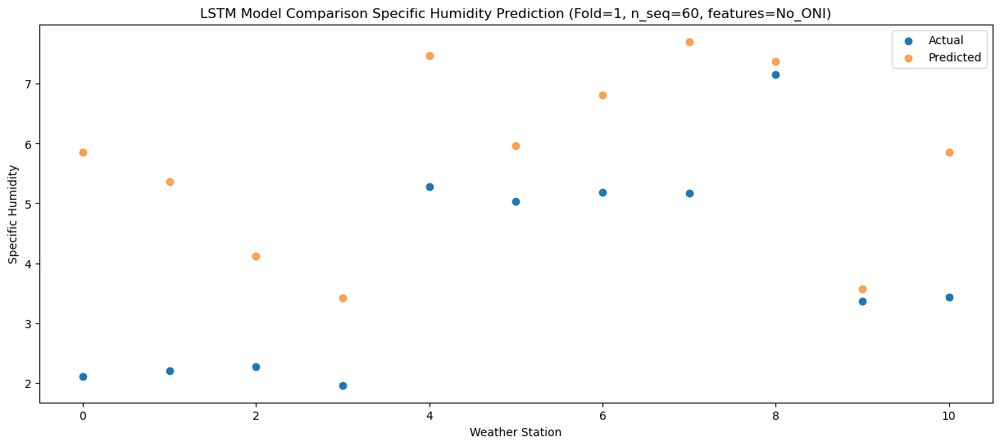

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_2 (LSTM)               (1, 1, 256)               2121728   
                                                                 
 dropout_2 (Dropout)         (1, 1, 256)               0         
                                                                 
 lstm_3 (LSTM)               (1, 256)                  525312    
                                                                 
 dropout_3 (Dropout)         (1, 256)                  0         
                                                                 
 dense_3 (Dense)             (1, 256)                  65792     
                                                                 
 dense_4 (Dense)             (1, 128)                  32896     
                                                                 
 dense_5 (Dense)             (1, 60)                  

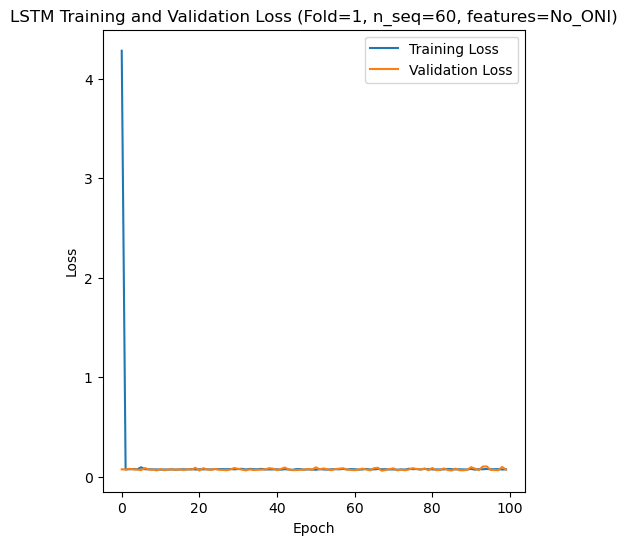

Epoch 1/100
84/84 [==============================] - 10s 34ms/step - loss: 1.8228 - accuracy: 0.3095 - mae: 1.6964 - rmse: 1.8228 - mape: 367.2444 - pearson: 0.5806 - val_loss: 0.0544 - val_accuracy: 0.8000 - val_mae: 0.0424 - val_rmse: 0.0544 - val_mape: 9.4500 - val_pearson: 0.8738
Epoch 2/100
84/84 [==============================] - 2s 20ms/step - loss: 0.0754 - accuracy: 0.4643 - mae: 0.0600 - rmse: 0.0754 - mape: 13.6043 - pearson: 0.7222 - val_loss: 0.0475 - val_accuracy: 0.8000 - val_mae: 0.0365 - val_rmse: 0.0475 - val_mape: 8.0673 - val_pearson: 0.8978
Epoch 3/100
84/84 [==============================] - 1s 14ms/step - loss: 0.0781 - accuracy: 0.2976 - mae: 0.0615 - rmse: 0.0781 - mape: 13.9378 - pearson: 0.7240 - val_loss: 0.0768 - val_accuracy: 0.0000e+00 - val_mae: 0.0626 - val_rmse: 0.0768 - val_mape: 13.9282 - val_pearson: 0.7266
Epoch 4/100
84/84 [==============================] - 1s 14ms/step - loss: 0.0748 - accuracy: 0.3929 - mae: 0.0589 - rmse: 0.0748 - mape: 13.3386

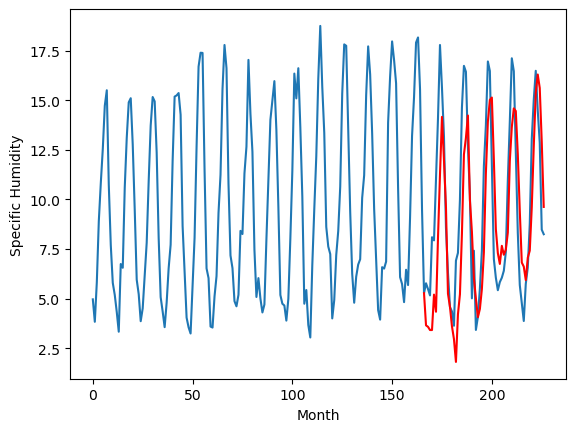

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.26		0.93		0.67
-0.25		0.86		1.11
-0.27		0.70		0.97
-0.21		0.69		0.90
1.58		2.48		0.90
1.87		1.62		-0.25
4.77		5.34		0.57
6.19		8.52		2.33
11.00		11.43		0.43
9.57		9.25		-0.32
5.51		6.86		1.35
1.78		2.53		0.75
1.56		1.86		0.30
-0.17		0.89		1.06
-0.22		0.24		0.46
-0.90		-0.91		-0.01
0.95		1.48		0.53
1.07		2.49		1.42
6.19		5.55		-0.64
9.10		9.54		0.44
10.71		10.37		-0.34
9.09		11.50		2.41
6.27		7.23		0.96
2.88		5.64		2.76
0.45		3.31		2.86
-0.61		2.28		2.89
-0.94		1.34		2.28
-1.03		1.76		2.79
-0.15		2.76		2.91
1.00		4.61		3.61
3.39		8.58		5.19
7.75		11.19		3.44
9.09		12.28		3.19
8.59		12.40		3.81
6.02		9.29		3.27
2.34		5.78		3.44
0.84		4.57		3.73
-0.35		4.02		4.37
-0.36		4.93		5.29
-0.44		4.49		4.93
0.25		4.74		4.49
0.87		5.60		4.73
6.65		9.21		2.56
9.30		10.92		1.62
11.36		11.86		0.50
9.47		11.72		2.25
6.88		9.56		2.68
3.42		6.69		3.27
0.86		4.09		3.23
0.47		3.89		3.42
-0.12		3.21		3.33
0.70		

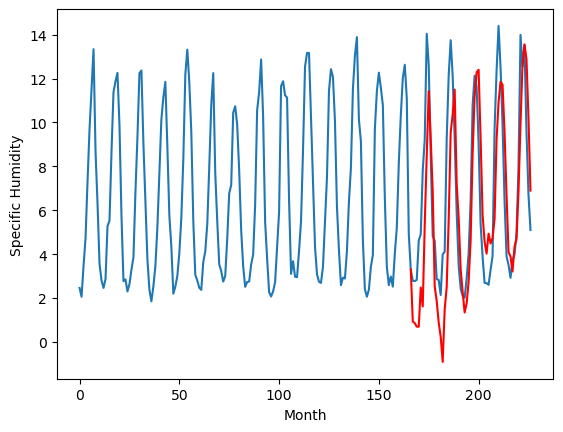

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.12		4.08		3.96
0.43		4.01		3.58
-1.13		3.85		4.98
-0.25		3.84		4.09
0.92		5.63		4.71
2.40		4.77		2.37
3.51		8.49		4.98
6.85		11.67		4.82
7.87		14.58		6.71
8.57		12.40		3.83
7.87		10.01		2.14
5.28		5.68		0.40
2.33		5.01		2.68
-2.34		4.04		6.38
-1.85		3.39		5.24
0.28		2.24		1.96
0.50		4.63		4.13
1.47		5.64		4.17
2.78		8.70		5.92
6.56		12.69		6.13
6.96		13.52		6.56
7.58		14.65		7.07
6.30		10.38		4.08
3.64		8.79		5.15
-0.31		6.46		6.77
1.09		5.43		4.34
-2.56		4.49		7.05
-1.37		4.91		6.28
0.44		5.91		5.47
1.80		7.76		5.96
4.90		11.73		6.83
6.83		14.34		7.51
7.66		15.43		7.77
7.55		15.55		8.00
7.40		12.44		5.04
3.01		8.93		5.92
2.90		7.72		4.82
-0.76		7.17		7.93
-1.14		8.08		9.22
0.71		7.64		6.93
1.10		7.89		6.79
2.61		8.75		6.14
3.42		12.36		8.94
6.58		14.07		7.49
7.55		15.01		7.46
8.27		14.87		6.60
5.88		12.71		6.83
2.96		9.84		6.88
0.46		7.24		6.78
-0.11		7.04		7.15
-1.18		6.36		7.54
-1.60		7.

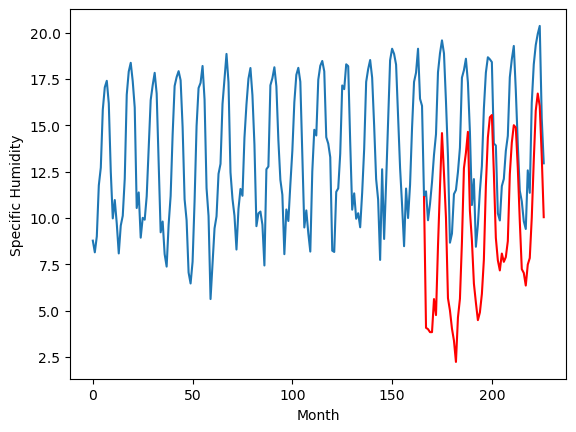

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.77		4.10		3.33
0.21		4.03		3.82
0.03		3.87		3.84
0.05		3.86		3.81
0.57		5.65		5.08
0.95		4.79		3.84
3.20		8.51		5.31
7.21		11.69		4.48
10.59		14.60		4.01
9.76		12.42		2.66
6.67		10.03		3.36
4.16		5.70		1.54
2.29		5.03		2.74
0.37		4.06		3.69
-0.71		3.41		4.12
-0.54		2.26		2.80
0.10		4.65		4.55
1.45		5.66		4.21
3.13		8.72		5.59
7.73		12.71		4.98
10.33		13.54		3.21
11.07		14.67		3.60
8.41		10.40		1.99
5.45		8.81		3.36
1.00		6.48		5.48
0.64		5.45		4.81
-0.69		4.51		5.20
-0.12		4.93		5.05
0.64		5.93		5.29
1.34		7.78		6.44
4.64		11.75		7.11
6.90		14.36		7.46
10.26		15.45		5.19
10.94		15.57		4.63
7.14		12.46		5.32
4.27		8.95		4.68
2.45		7.74		5.29
0.36		7.19		6.83
0.87		8.10		7.23
0.11		7.66		7.55
0.36		7.91		7.55
2.44		8.77		6.33
3.25		12.38		9.13
7.15		14.09		6.94
11.41		15.03		3.62
9.07		14.89		5.82
8.06		12.73		4.67
4.70		9.86		5.16
0.87		7.26		6.39
1.16		7.06		5.90
-0.17		6.38		6.55
-0.22		7.

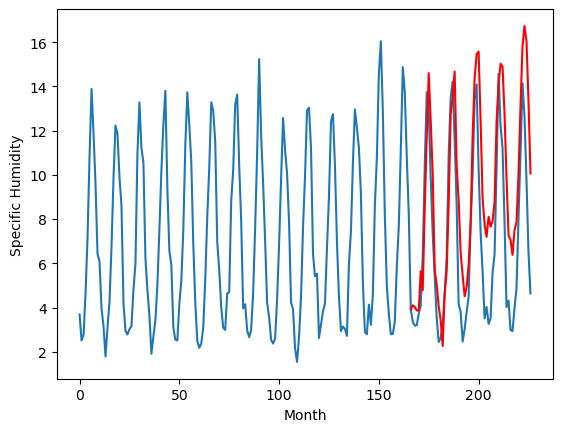

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.79		4.01		4.80
0.01		3.94		3.93
0.04		3.78		3.74
0.36		3.77		3.41
3.85		5.56		1.71
2.89		4.70		1.81
5.01		8.42		3.41
8.35		11.60		3.25
10.48		14.51		4.03
9.75		12.33		2.58
7.95		9.94		1.99
4.74		5.61		0.87
2.01		4.94		2.93
-1.27		3.97		5.24
-1.14		3.32		4.46
-1.16		2.17		3.33
2.13		4.56		2.43
2.15		5.57		3.42
5.35		8.63		3.28
9.24		12.62		3.38
10.27		13.45		3.18
9.87		14.58		4.71
7.73		10.31		2.58
5.20		8.72		3.52
-0.46		6.39		6.85
2.82		5.36		2.54
-2.09		4.42		6.51
-0.63		4.84		5.47
0.22		5.84		5.62
2.65		7.69		5.04
6.68		11.66		4.98
8.98		14.27		5.29
10.27		15.36		5.09
10.67		15.48		4.81
7.16		12.37		5.21
1.98		8.86		6.88
1.54		7.65		6.11
0.99		7.10		6.11
0.90		8.01		7.11
2.20		7.57		5.37
3.08		7.82		4.74
3.63		8.68		5.05
6.69		12.29		5.60
10.00		14.00		4.00
11.34		14.94		3.60
11.37		14.80		3.43
9.02		12.64		3.62
3.79		9.77		5.98
1.27		7.17		5.90
-0.32		6.97		7.29
-1.19		6.29		7.48
-0.13

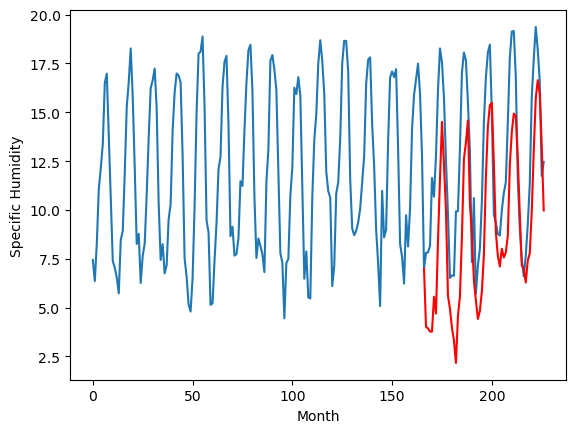

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.21		1.50		2.71
-2.40		1.43		3.83
-1.57		1.27		2.84
-2.24		1.26		3.50
2.37		3.05		0.68
1.85		2.19		0.34
3.93		5.91		1.98
6.05		9.09		3.04
8.63		12.00		3.37
7.19		9.82		2.63
5.74		7.43		1.69
1.87		3.10		1.23
-0.19		2.43		2.62
-2.51		1.46		3.97
-2.64		0.81		3.45
-2.69		-0.34		2.35
0.30		2.05		1.75
1.87		3.06		1.19
6.70		6.12		-0.58
9.34		10.11		0.77
8.30		10.94		2.64
8.43		12.07		3.64
4.87		7.80		2.93
3.28		6.21		2.93
-0.91		3.88		4.79
1.96		2.85		0.89
-3.67		1.91		5.58
-3.45		2.33		5.78
-1.83		3.33		5.16
2.13		5.18		3.05
5.78		9.15		3.37
6.81		11.76		4.95
7.91		12.85		4.94
8.37		12.97		4.60
5.01		9.86		4.85
0.19		6.35		6.16
0.05		5.14		5.09
-0.86		4.59		5.45
-1.24		5.50		6.74
-0.79		5.06		5.85
0.99		5.31		4.32
1.54		6.17		4.63
5.24		9.78		4.54
8.70		11.49		2.79
8.41		12.43		4.02
6.98		12.29		5.31
6.43		10.13		3.70
2.90		7.26		4.36
-0.27		4.66		4.93
-2.20		4.46		6.66
-3.21		3.78		6.99
-0.81		

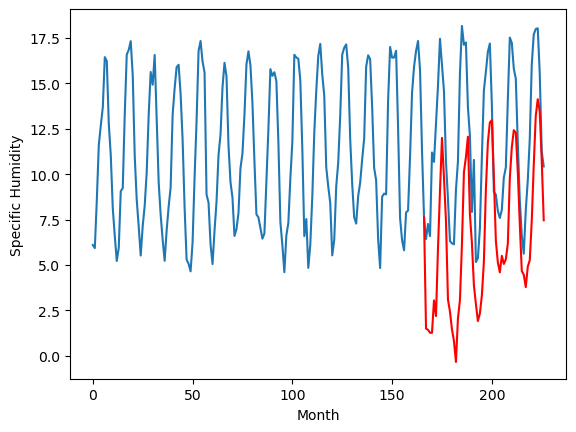

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
5.57		7.82		2.25
4.47		7.75		3.28
5.15		7.59		2.44
4.59		7.58		2.99
8.81		9.37		0.56
8.39		8.51		0.12
11.33		12.23		0.90
13.61		15.41		1.80
16.52		18.32		1.80
13.82		16.14		2.32
12.88		13.75		0.87
8.39		9.42		1.03
6.80		8.75		1.95
4.09		7.78		3.69
3.99		7.13		3.14
3.66		5.98		2.32
6.52		8.37		1.85
7.84		9.38		1.54
12.04		12.44		0.40
15.79		16.43		0.64
16.61		17.26		0.65
16.99		18.39		1.40
12.54		14.12		1.58
9.93		12.53		2.60
5.94		10.20		4.26
8.44		9.17		0.73
3.15		8.23		5.08
3.62		8.65		5.03
5.25		9.65		4.40
9.15		11.50		2.35
13.24		15.47		2.23
14.04		18.08		4.04
13.36		19.17		5.81
14.42		19.29		4.87
11.75		16.18		4.43
6.97		12.67		5.70
6.52		11.46		4.94
5.35		10.91		5.56
4.57		11.82		7.25
4.97		11.38		6.41
6.88		11.63		4.75
7.55		12.49		4.94
11.44		16.10		4.66
15.34		17.81		2.47
14.63		18.75		4.12
12.58		18.61		6.03
11.95		16.45		4.50
8.80		13.58		4.78
6.18		10.98		4.80
4.36		10.78		6.42
3.

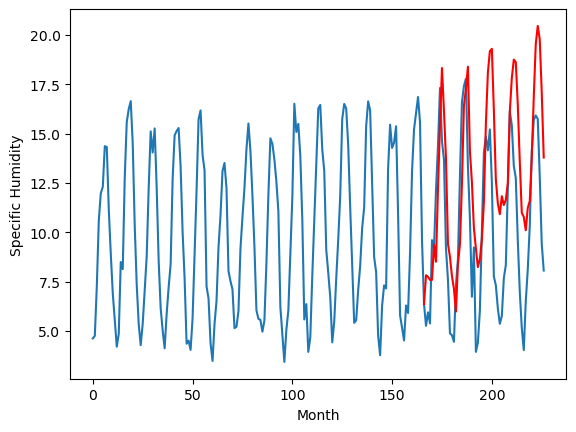

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.62		2.73		0.11
2.17		2.66		0.49
1.22		2.50		1.28
1.75		2.49		0.74
3.21		4.28		1.07
1.81		3.42		1.61
2.05		7.14		5.09
3.73		10.32		6.59
7.17		13.23		6.06
5.44		11.05		5.61
4.79		8.66		3.87
1.72		4.33		2.61
1.77		3.66		1.89
0.51		2.69		2.18
0.79		2.04		1.25
0.66		0.89		0.23
0.75		3.28		2.53
1.05		4.29		3.24
1.17		7.35		6.18
3.83		11.34		7.51
9.07		12.17		3.10
9.36		13.30		3.94
6.60		9.03		2.43
2.89		7.44		4.55
1.24		5.11		3.87
1.37		4.08		2.71
1.09		3.14		2.05
0.10		3.56		3.46
0.50		4.56		4.06
0.51		6.41		5.90
0.44		10.38		9.94
5.94		12.99		7.05
8.50		14.08		5.58
10.47		14.20		3.73
7.43		11.09		3.66
5.35		7.58		2.23
1.38		6.37		4.99
2.20		5.82		3.62
1.31		6.73		5.42
1.19		6.29		5.10
1.53		6.54		5.01
0.69		7.40		6.71
2.69		11.01		8.32
2.49		12.72		10.23
5.84		13.66		7.82
8.03		13.52		5.49
6.22		11.36		5.14
3.77		8.49		4.72
2.85		5.89		3.04
1.33		5.69		4.36
1.75		5.01		3.26
1.77		6.14		4.37
1.9

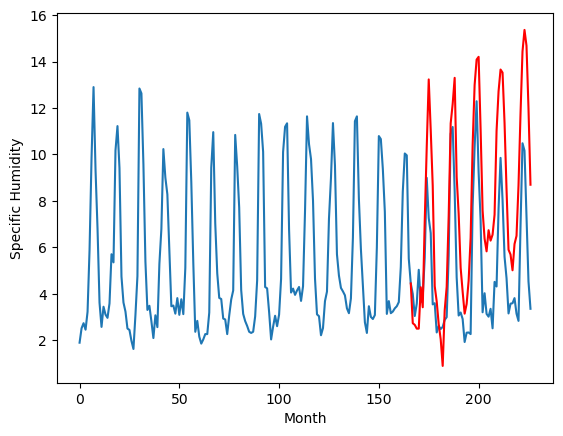

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
7.78		6.48		-1.30
7.60		6.41		-1.19
7.39		6.25		-1.14
6.67		6.24		-0.43
8.31		8.03		-0.28
9.72		7.17		-2.55
10.48		10.89		0.41
10.46		14.07		3.61
11.23		16.98		5.75
12.31		14.80		2.49
10.53		12.41		1.88
9.40		8.08		-1.32
7.16		7.41		0.25
5.59		6.44		0.85
6.44		5.79		-0.65
6.97		4.64		-2.33
7.08		7.03		-0.05
8.40		8.04		-0.36
9.88		11.10		1.22
11.13		15.09		3.96
12.28		15.92		3.64
11.68		17.05		5.37
11.22		12.78		1.56
8.42		11.19		2.77
7.88		8.86		0.98
7.70		7.83		0.13
6.34		6.89		0.55
5.60		7.31		1.71
7.34		8.31		0.97
8.18		10.16		1.98
9.44		14.13		4.69
11.21		16.74		5.53
12.10		17.83		5.73
12.20		17.95		5.75
13.05		14.84		1.79
11.28		11.33		0.05
6.64		10.12		3.48
7.49		9.57		2.08
7.58		10.48		2.90
6.17		10.04		3.87
8.09		10.29		2.20
8.79		11.15		2.36
10.19		14.76		4.57
10.57		16.47		5.90
11.91		17.41		5.50
12.52		17.27		4.75
12.27		15.11		2.84
9.97		12.24		2.27
6.94		9.64		2.70
7.73		9.44		1

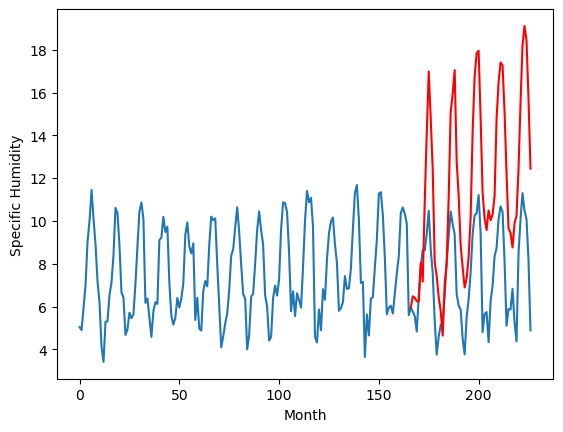

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.89		5.14		4.25
1.00		5.07		4.07
0.98		4.91		3.93
1.37		4.90		3.53
3.00		6.69		3.69
2.91		5.83		2.92
6.24		9.55		3.31
9.75		12.73		2.98
12.60		15.64		3.04
12.59		13.46		0.87
8.87		11.07		2.20
6.25		6.74		0.49
3.60		6.07		2.47
0.38		5.10		4.72
0.26		4.45		4.19
0.33		3.30		2.97
2.06		5.69		3.63
2.59		6.70		4.11
5.30		9.76		4.46
9.80		13.75		3.95
11.32		14.58		3.26
11.90		15.71		3.81
8.30		11.44		3.14
6.14		9.85		3.71
0.58		7.52		6.94
2.43		6.49		4.06
-0.35		5.55		5.90
0.96		5.97		5.01
1.92		6.97		5.05
2.96		8.82		5.86
7.28		12.79		5.51
9.08		15.40		6.32
12.66		16.49		3.83
11.09		16.61		5.52
7.66		13.50		5.84
3.30		9.99		6.69
2.83		8.78		5.95
0.59		8.23		7.64
1.45		9.14		7.69
2.21		8.70		6.49
1.90		8.95		7.05
4.03		9.81		5.78
5.56		13.42		7.86
8.42		15.13		6.71
12.26		16.07		3.81
11.77		15.93		4.16
8.63		13.77		5.14
4.44		10.90		6.46
1.33		8.30		6.97
1.24		8.10		6.86
0.55		7.42		6.87
0.69		8.5

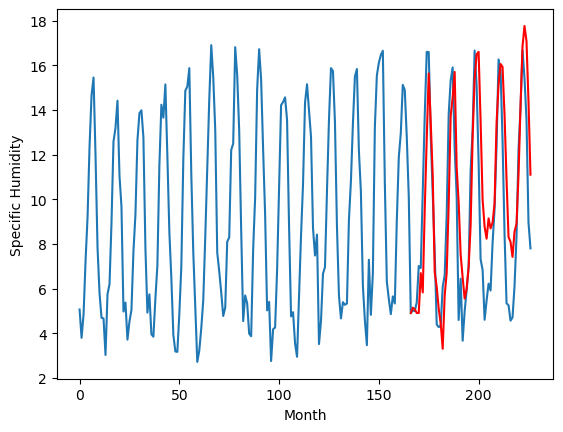

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.08		3.66		3.58
0.53		3.59		3.06
0.33		3.43		3.10
0.44		3.42		2.98
2.29		5.21		2.92
1.72		4.35		2.63
4.51		8.07		3.56
7.95		11.25		3.30
10.65		14.16		3.51
10.41		11.98		1.57
7.80		9.59		1.79
4.61		5.26		0.65
1.49		4.59		3.10
-0.30		3.62		3.92
-0.29		2.97		3.26
-0.05		1.82		1.87
0.98		4.21		3.23
1.59		5.22		3.63
4.26		8.28		4.02
8.36		12.27		3.91
9.77		13.10		3.33
10.16		14.23		4.07
6.95		9.96		3.01
5.22		8.37		3.15
-0.14		6.04		6.18
1.42		5.01		3.59
-1.00		4.07		5.07
-0.10		4.49		4.59
0.52		5.49		4.97
1.79		7.34		5.55
5.95		11.31		5.36
7.91		13.92		6.01
11.12		15.01		3.89
10.13		15.13		5.00
6.65		12.02		5.37
1.99		8.51		6.52
1.37		7.30		5.93
0.28		6.75		6.47
0.55		7.66		7.11
0.95		7.22		6.27
0.55		7.47		6.92
2.19		8.33		6.14
4.78		11.94		7.16
6.62		13.65		7.03
9.93		14.59		4.66
10.04		14.45		4.41
7.62		12.29		4.67
3.51		9.42		5.91
0.56		6.82		6.26
0.35		6.62		6.27
-0.27		5.94		6.21
0.13		7.

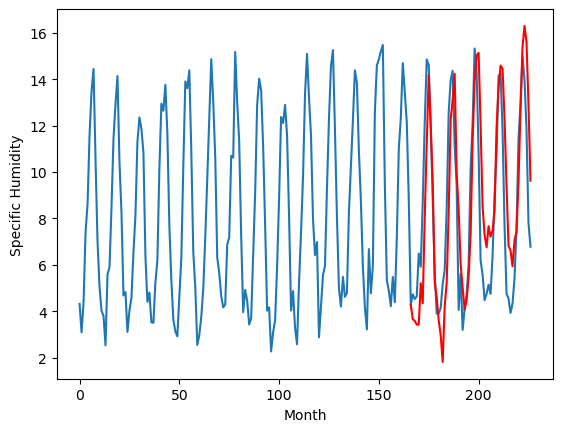

RangeIndex(start=1, stop=12, step=1)
[0.41000000000000014, 0.26000000000000045, 0.1200000000000001, 0.7699999999999987, -0.79, -1.2099999999999995, 5.569999999999999, 2.62, 7.780000000000001, 0.8900000000000006, 0.08000000000000007]
[3.6597337675094606, 0.9297337675094604, 4.0797337675094605, 4.09973376750946, 4.00973376750946, 1.4997337675094604, 7.81973376750946, 2.7297337675094604, 6.479733767509461, 5.13973376750946, 3.6597337675094606]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.41   3.659734
1                 1    0.26   0.929734
2                 2    0.12   4.079734
3                 3    0.77   4.099734
4                 4   -0.79   4.009734
5                 5   -1.21   1.499734
6                 6    5.57   7.819734
7                 7    2.62   2.729734
8                 8    7.78   6.479734
9                 9    0.89   5.139734
10               10    0.08   3.659734


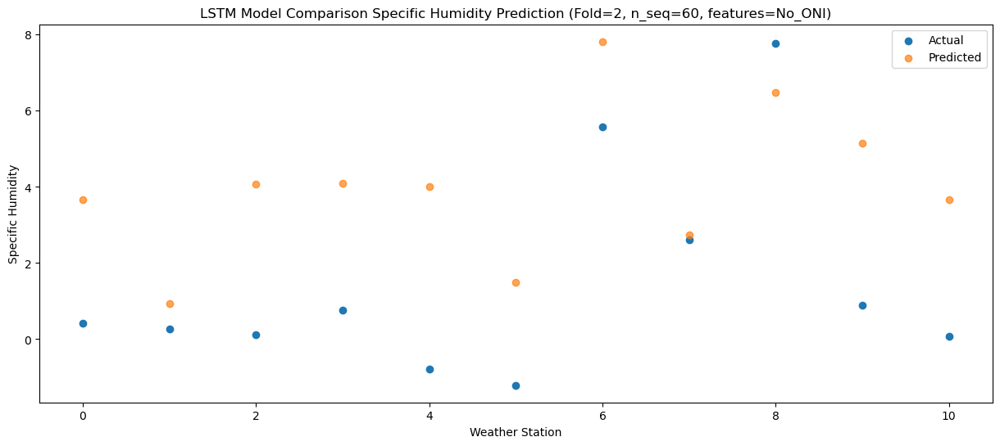

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    0.91   3.587012
1                 1   -0.25   0.857012
2                 2    0.43   4.007012
3                 3    0.21   4.027012
4                 4    0.01   3.937012
5                 5   -2.40   1.427012
6                 6    4.47   7.747012
7                 7    2.17   2.657012
8                 8    7.60   6.407012
9                 9    1.00   5.067012
10               10    0.53   3.587012


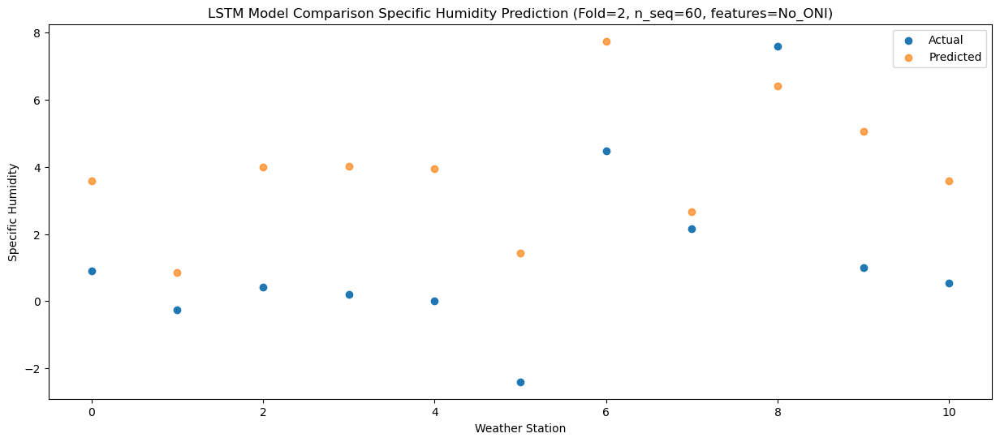

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    0.62   3.425477
1                 1   -0.27   0.695477
2                 2   -1.13   3.845477
3                 3    0.03   3.865477
4                 4    0.04   3.775477
5                 5   -1.57   1.265477
6                 6    5.15   7.585477
7                 7    1.22   2.495477
8                 8    7.39   6.245477
9                 9    0.98   4.905477
10               10    0.33   3.425477


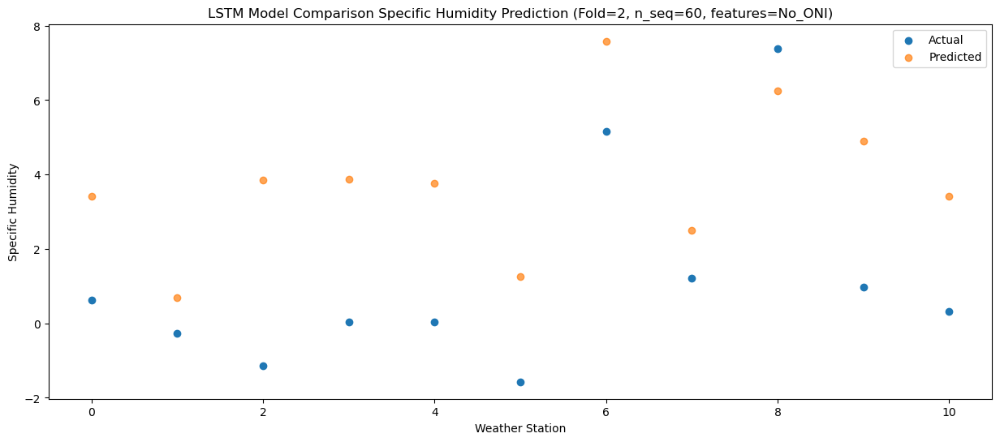

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.30   3.424775
1                 1   -0.21   0.694775
2                 2   -0.25   3.844775
3                 3    0.05   3.864775
4                 4    0.36   3.774775
5                 5   -2.24   1.264775
6                 6    4.59   7.584775
7                 7    1.75   2.494775
8                 8    6.67   6.244775
9                 9    1.37   4.904775
10               10    0.44   3.424775


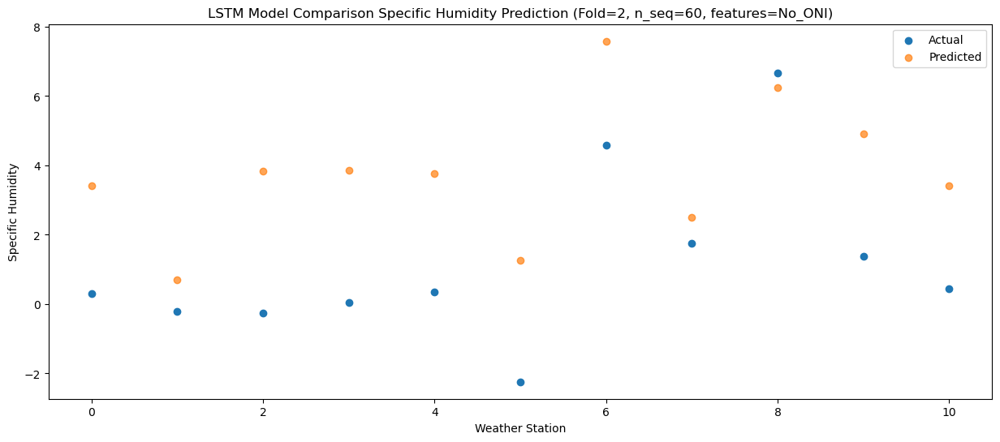

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.23   5.209017
1                 1    1.58   2.479017
2                 2    0.92   5.629017
3                 3    0.57   5.649017
4                 4    3.85   5.559017
5                 5    2.37   3.049017
6                 6    8.81   9.369017
7                 7    3.21   4.279017
8                 8    8.31   8.029017
9                 9    3.00   6.689017
10               10    2.29   5.209017


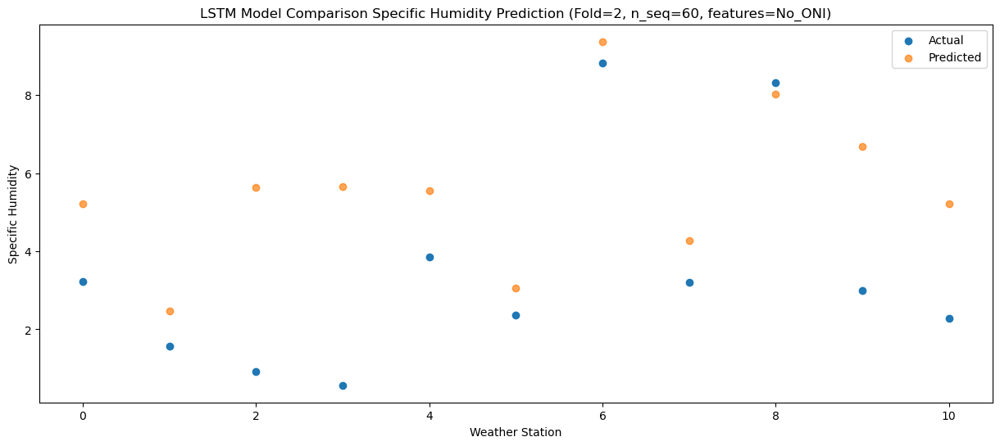

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.07   4.345515
1                 1    1.87   1.615515
2                 2    2.40   4.765515
3                 3    0.95   4.785515
4                 4    2.89   4.695515
5                 5    1.85   2.185515
6                 6    8.39   8.505515
7                 7    1.81   3.415515
8                 8    9.72   7.165515
9                 9    2.91   5.825515
10               10    1.72   4.345515


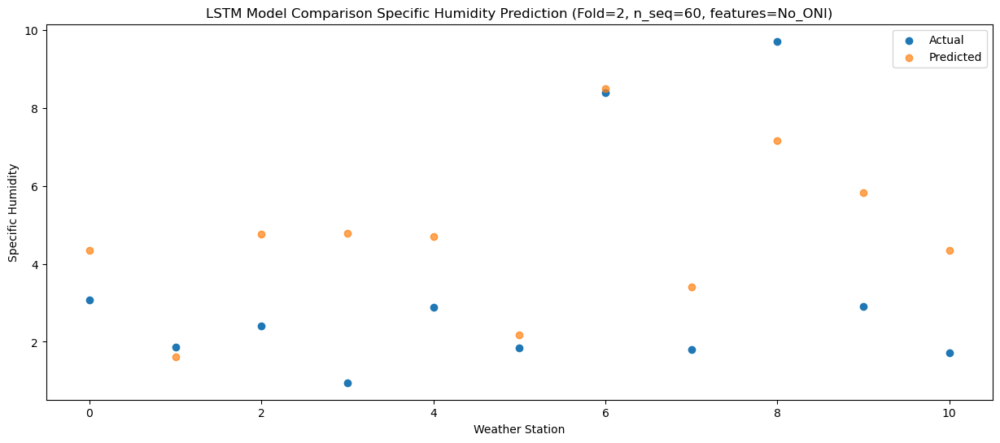

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    6.06   8.066044
1                 1    4.77   5.336044
2                 2    3.51   8.486044
3                 3    3.20   8.506044
4                 4    5.01   8.416044
5                 5    3.93   5.906044
6                 6   11.33  12.226044
7                 7    2.05   7.136044
8                 8   10.48  10.886044
9                 9    6.24   9.546044
10               10    4.51   8.066044


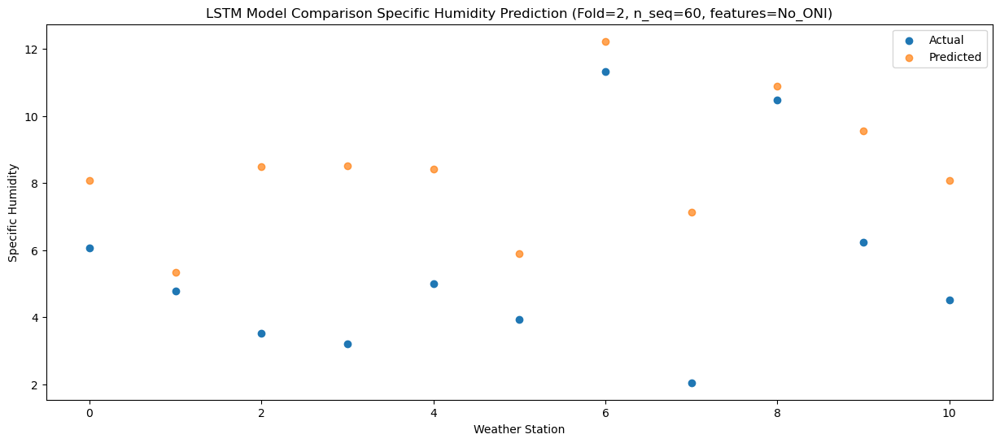

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    9.21  11.248921
1                 1    6.19   8.518921
2                 2    6.85  11.668921
3                 3    7.21  11.688921
4                 4    8.35  11.598921
5                 5    6.05   9.088921
6                 6   13.61  15.408921
7                 7    3.73  10.318921
8                 8   10.46  14.068921
9                 9    9.75  12.728921
10               10    7.95  11.248921


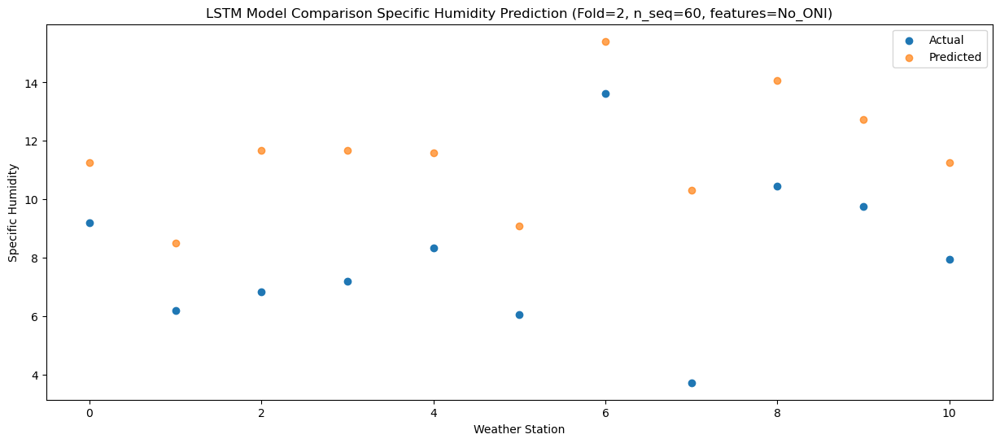

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   12.91  14.160249
1                 1   11.00  11.430249
2                 2    7.87  14.580249
3                 3   10.59  14.600249
4                 4   10.48  14.510249
5                 5    8.63  12.000249
6                 6   16.52  18.320249
7                 7    7.17  13.230249
8                 8   11.23  16.980249
9                 9   12.60  15.640249
10               10   10.65  14.160249


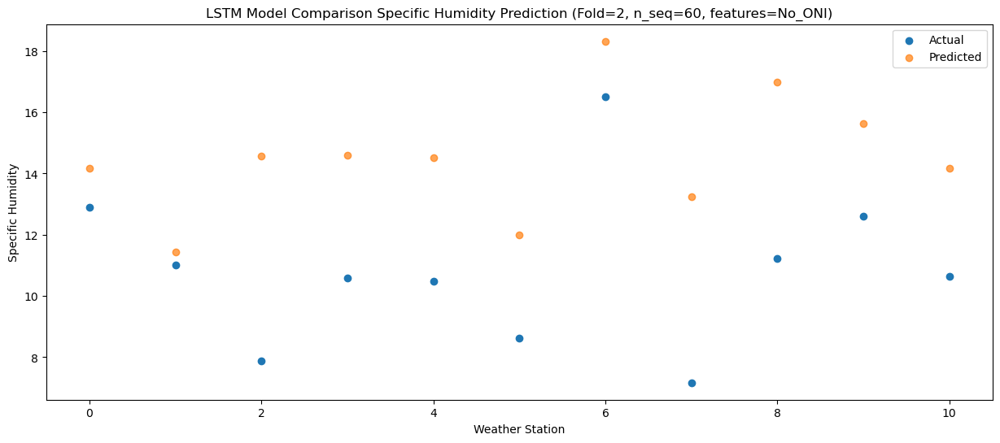

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   10.75  11.980072
1                 1    9.57   9.250072
2                 2    8.57  12.400072
3                 3    9.76  12.420072
4                 4    9.75  12.330072
5                 5    7.19   9.820072
6                 6   13.82  16.140072
7                 7    5.44  11.050072
8                 8   12.31  14.800072
9                 9   12.59  13.460072
10               10   10.41  11.980072


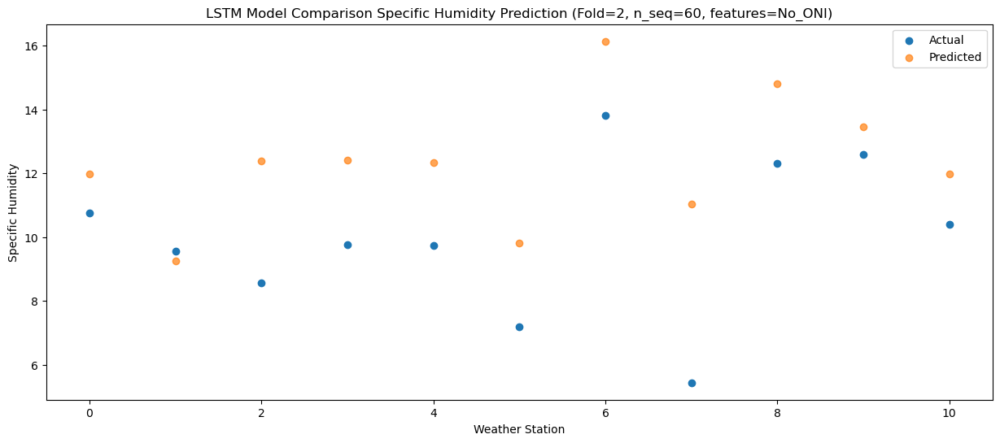

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    8.29   9.590074
1                 1    5.51   6.860074
2                 2    7.87  10.010074
3                 3    6.67  10.030074
4                 4    7.95   9.940074
5                 5    5.74   7.430074
6                 6   12.88  13.750074
7                 7    4.79   8.660074
8                 8   10.53  12.410074
9                 9    8.87  11.070074
10               10    7.80   9.590074


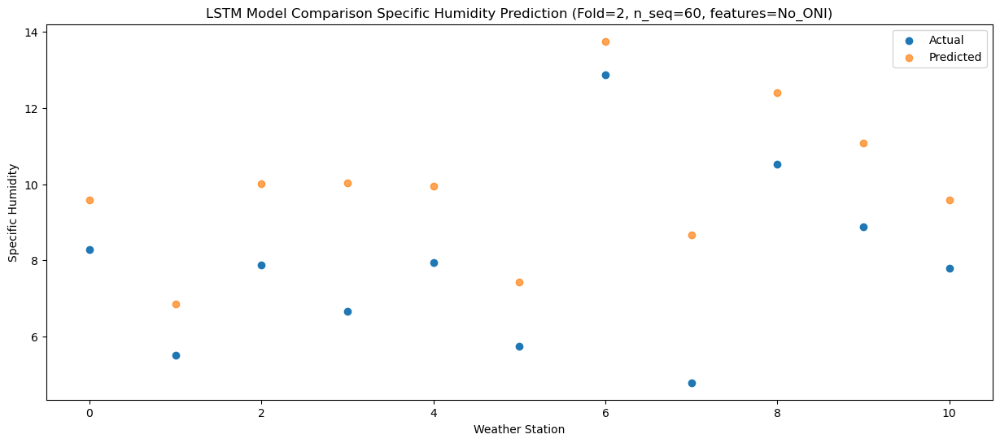

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    3.70   5.256102
1                 1    1.78   2.526102
2                 2    5.28   5.676102
3                 3    4.16   5.696102
4                 4    4.74   5.606102
5                 5    1.87   3.096102
6                 6    8.39   9.416102
7                 7    1.72   4.326102
8                 8    9.40   8.076102
9                 9    6.25   6.736102
10               10    4.61   5.256102


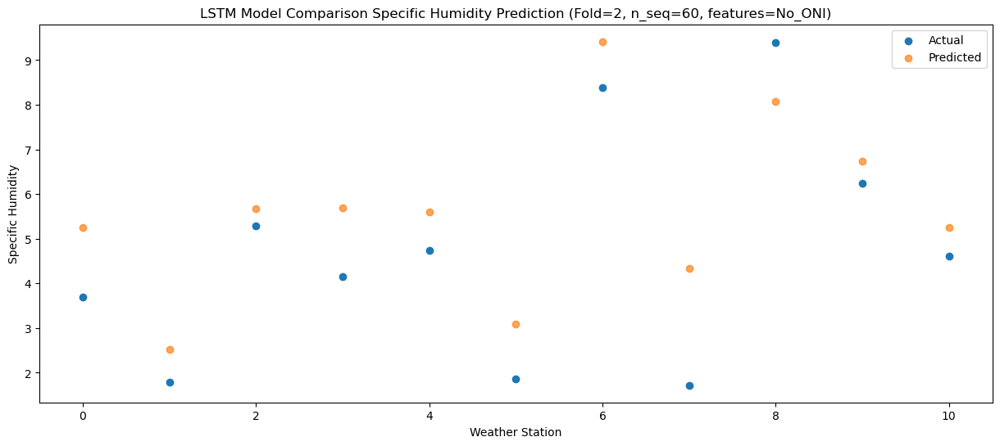

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.45   4.591418
1                 1    1.56   1.861418
2                 2    2.33   5.011418
3                 3    2.29   5.031418
4                 4    2.01   4.941418
5                 5   -0.19   2.431418
6                 6    6.80   8.751418
7                 7    1.77   3.661418
8                 8    7.16   7.411418
9                 9    3.60   6.071418
10               10    1.49   4.591418


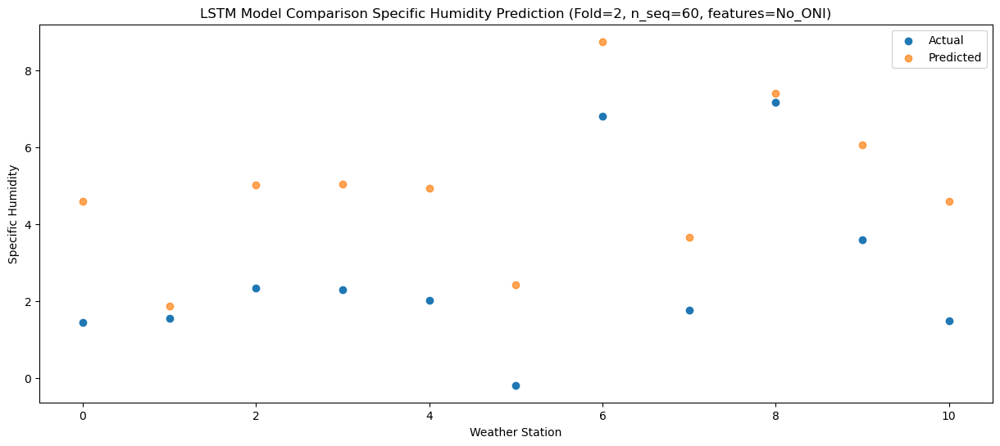

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -0.28   3.615787
1                 1   -0.17   0.885787
2                 2   -2.34   4.035787
3                 3    0.37   4.055787
4                 4   -1.27   3.965787
5                 5   -2.51   1.455787
6                 6    4.09   7.775787
7                 7    0.51   2.685787
8                 8    5.59   6.435787
9                 9    0.38   5.095787
10               10   -0.30   3.615787


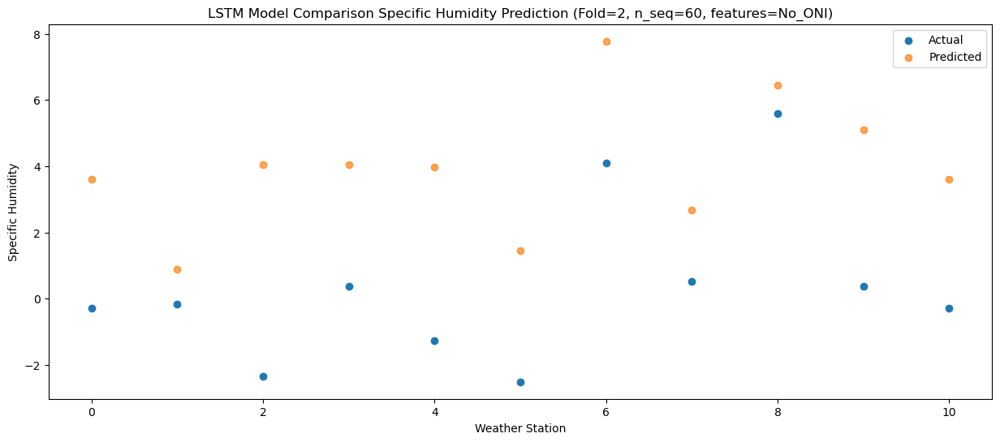

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -0.51   2.968658
1                 1   -0.22   0.238658
2                 2   -1.85   3.388658
3                 3   -0.71   3.408658
4                 4   -1.14   3.318658
5                 5   -2.64   0.808658
6                 6    3.99   7.128658
7                 7    0.79   2.038658
8                 8    6.44   5.788658
9                 9    0.26   4.448658
10               10   -0.29   2.968658


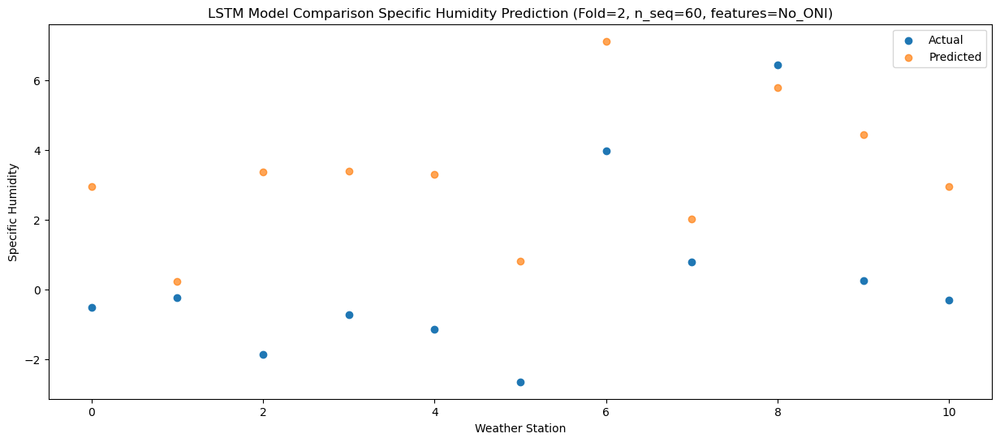

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -1.23   1.819095
1                 1   -0.90  -0.910905
2                 2    0.28   2.239095
3                 3   -0.54   2.259095
4                 4   -1.16   2.169095
5                 5   -2.69  -0.340905
6                 6    3.66   5.979095
7                 7    0.66   0.889095
8                 8    6.97   4.639095
9                 9    0.33   3.299095
10               10   -0.05   1.819095


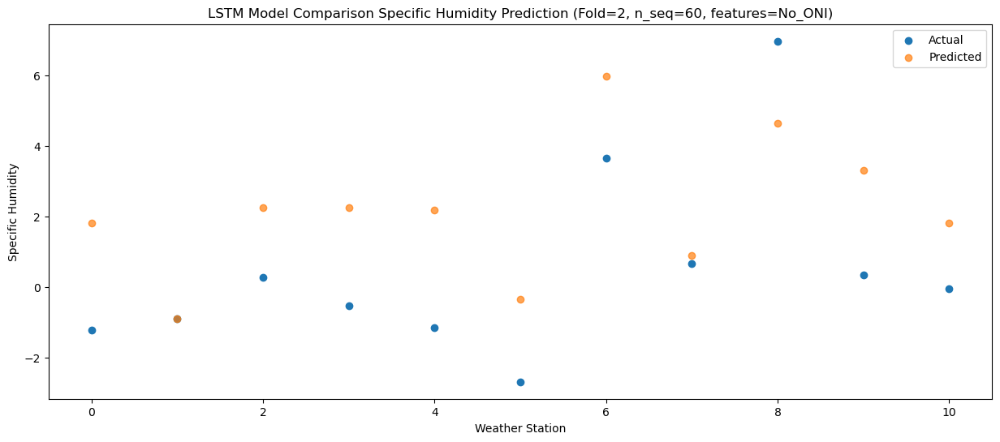

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.05   4.214573
1                 1    0.95   1.484573
2                 2    0.50   4.634573
3                 3    0.10   4.654573
4                 4    2.13   4.564573
5                 5    0.30   2.054573
6                 6    6.52   8.374573
7                 7    0.75   3.284573
8                 8    7.08   7.034573
9                 9    2.06   5.694573
10               10    0.98   4.214573


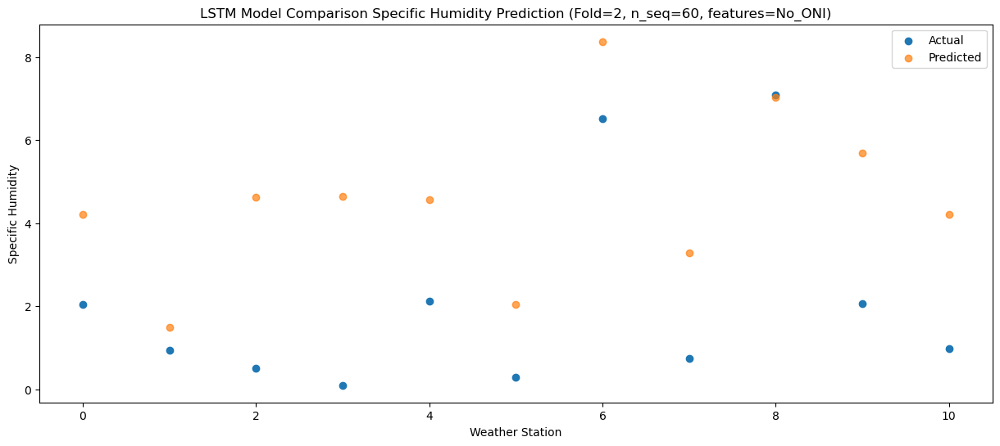

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    2.44   5.224644
1                 1    1.07   2.494644
2                 2    1.47   5.644644
3                 3    1.45   5.664644
4                 4    2.15   5.574644
5                 5    1.87   3.064644
6                 6    7.84   9.384644
7                 7    1.05   4.294644
8                 8    8.40   8.044644
9                 9    2.59   6.704644
10               10    1.59   5.224644


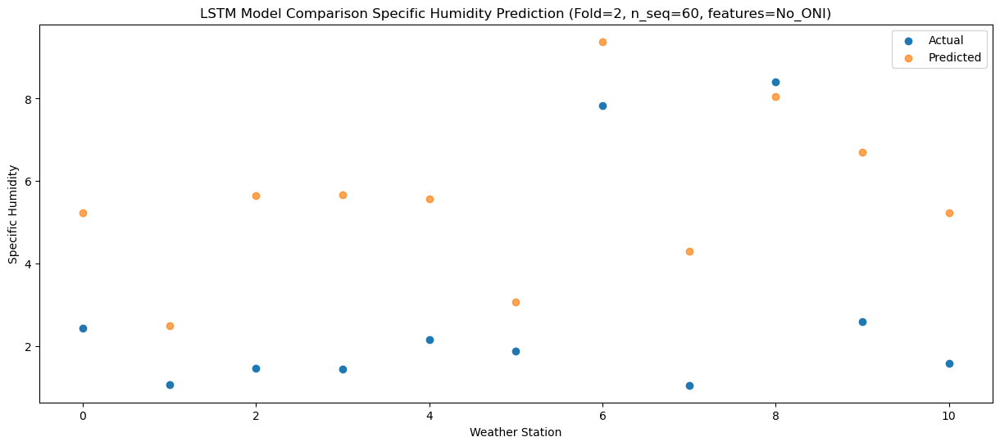

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    5.11   8.278904
1                 1    6.19   5.548904
2                 2    2.78   8.698904
3                 3    3.13   8.718904
4                 4    5.35   8.628904
5                 5    6.70   6.118904
6                 6   12.04  12.438904
7                 7    1.17   7.348904
8                 8    9.88  11.098904
9                 9    5.30   9.758904
10               10    4.26   8.278904


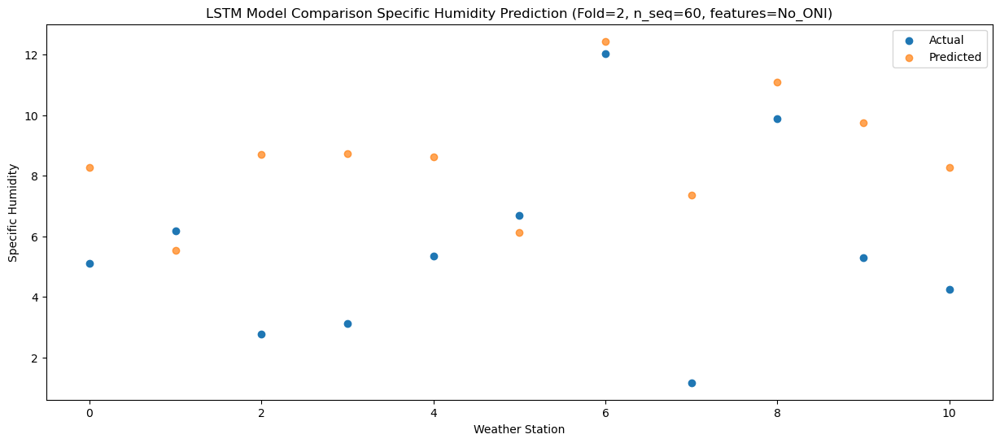

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    9.76  12.266072
1                 1    9.10   9.536072
2                 2    6.56  12.686072
3                 3    7.73  12.706072
4                 4    9.24  12.616072
5                 5    9.34  10.106072
6                 6   15.79  16.426072
7                 7    3.83  11.336072
8                 8   11.13  15.086072
9                 9    9.80  13.746072
10               10    8.36  12.266072


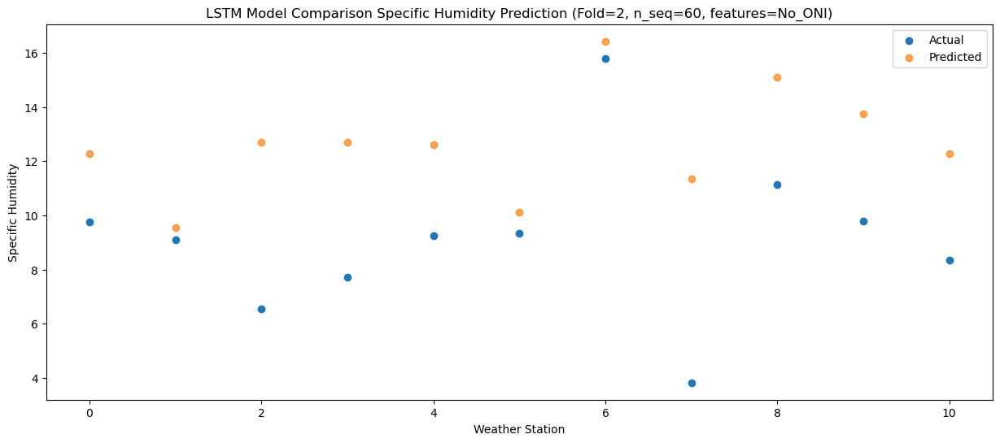

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   11.86  13.102214
1                 1   10.71  10.372214
2                 2    6.96  13.522214
3                 3   10.33  13.542214
4                 4   10.27  13.452214
5                 5    8.30  10.942214
6                 6   16.61  17.262214
7                 7    9.07  12.172214
8                 8   12.28  15.922214
9                 9   11.32  14.582214
10               10    9.77  13.102214


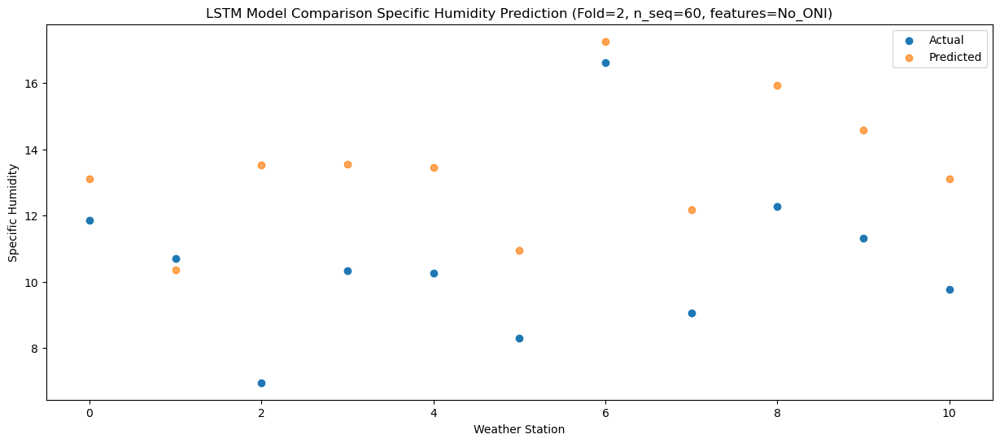

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   11.56  14.228726
1                 1    9.09  11.498726
2                 2    7.58  14.648726
3                 3   11.07  14.668726
4                 4    9.87  14.578726
5                 5    8.43  12.068726
6                 6   16.99  18.388726
7                 7    9.36  13.298726
8                 8   11.68  17.048726
9                 9   11.90  15.708726
10               10   10.16  14.228726


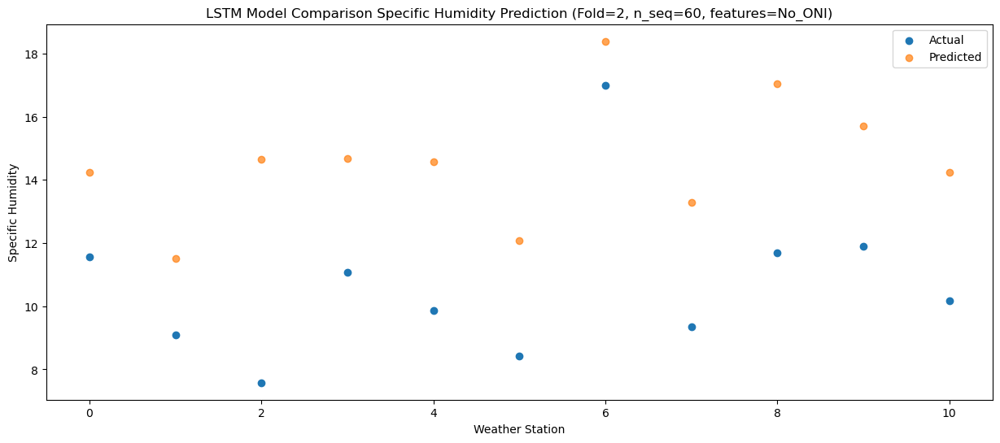

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    7.79   9.964069
1                 1    6.27   7.234069
2                 2    6.30  10.384069
3                 3    8.41  10.404069
4                 4    7.73  10.314069
5                 5    4.87   7.804069
6                 6   12.54  14.124069
7                 7    6.60   9.034069
8                 8   11.22  12.784069
9                 9    8.30  11.444069
10               10    6.95   9.964069


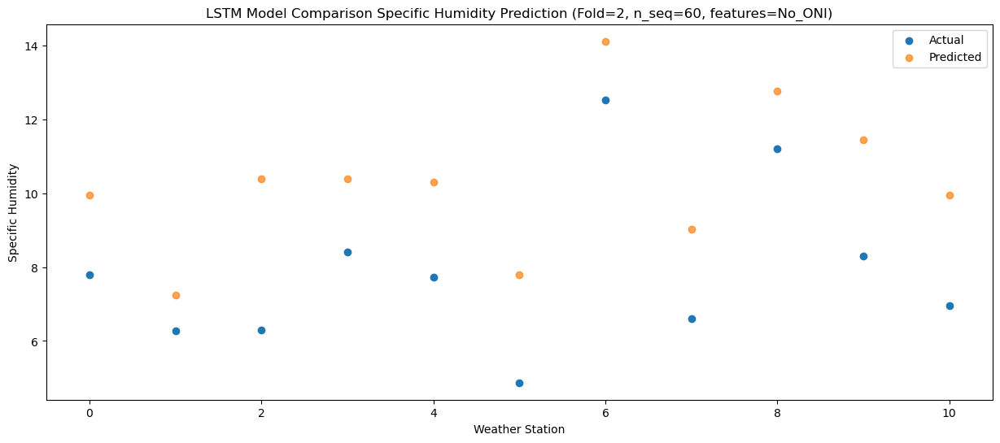

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    5.34   8.374086
1                 1    2.88   5.644086
2                 2    3.64   8.794086
3                 3    5.45   8.814086
4                 4    5.20   8.724086
5                 5    3.28   6.214086
6                 6    9.93  12.534086
7                 7    2.89   7.444086
8                 8    8.42  11.194086
9                 9    6.14   9.854086
10               10    5.22   8.374086


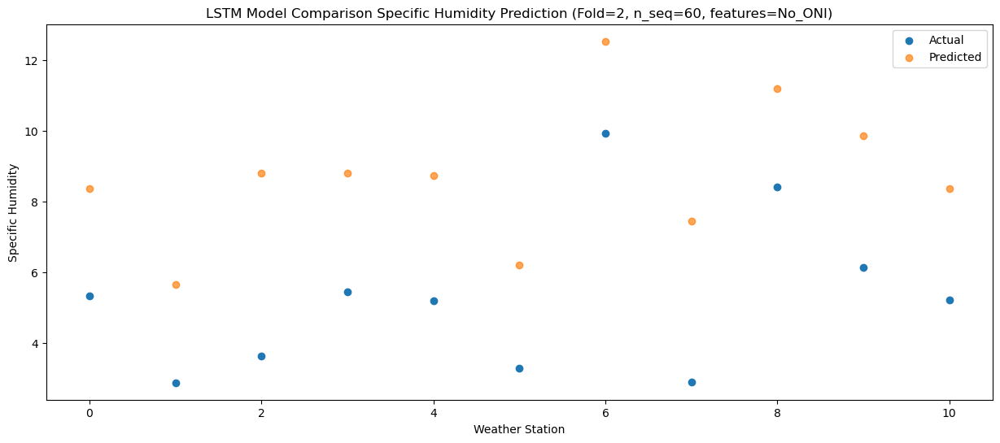

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    0.15   6.043864
1                 1    0.45   3.313864
2                 2   -0.31   6.463864
3                 3    1.00   6.483864
4                 4   -0.46   6.393864
5                 5   -0.91   3.883864
6                 6    5.94  10.203864
7                 7    1.24   5.113864
8                 8    7.88   8.863864
9                 9    0.58   7.523864
10               10   -0.14   6.043864


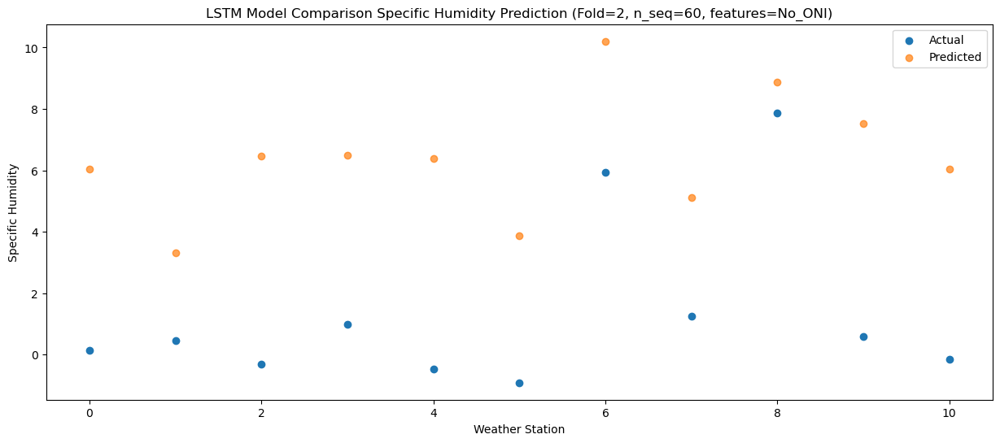

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    2.55   5.014536
1                 1   -0.61   2.284536
2                 2    1.09   5.434536
3                 3    0.64   5.454536
4                 4    2.82   5.364536
5                 5    1.96   2.854536
6                 6    8.44   9.174536
7                 7    1.37   4.084536
8                 8    7.70   7.834536
9                 9    2.43   6.494536
10               10    1.42   5.014536


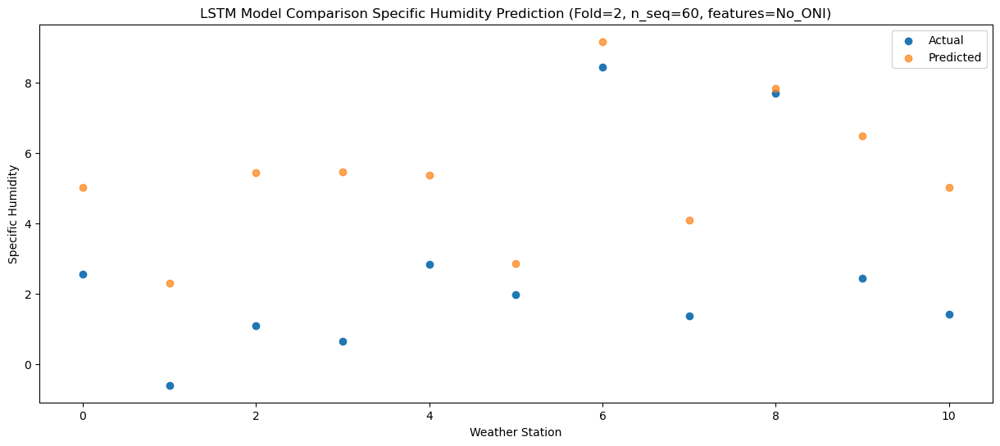

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -1.44   4.071481
1                 1   -0.94   1.341481
2                 2   -2.56   4.491481
3                 3   -0.69   4.511481
4                 4   -2.09   4.421481
5                 5   -3.67   1.911481
6                 6    3.15   8.231481
7                 7    1.09   3.141481
8                 8    6.34   6.891481
9                 9   -0.35   5.551481
10               10   -1.00   4.071481


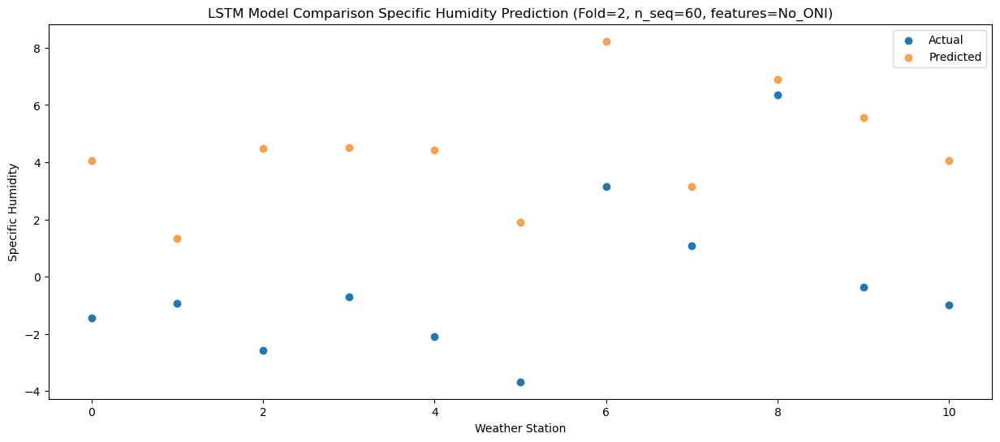

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.78   4.487282
1                 1   -1.03   1.757282
2                 2   -1.37   4.907282
3                 3   -0.12   4.927282
4                 4   -0.63   4.837282
5                 5   -3.45   2.327282
6                 6    3.62   8.647282
7                 7    0.10   3.557282
8                 8    5.60   7.307282
9                 9    0.96   5.967282
10               10   -0.10   4.487282


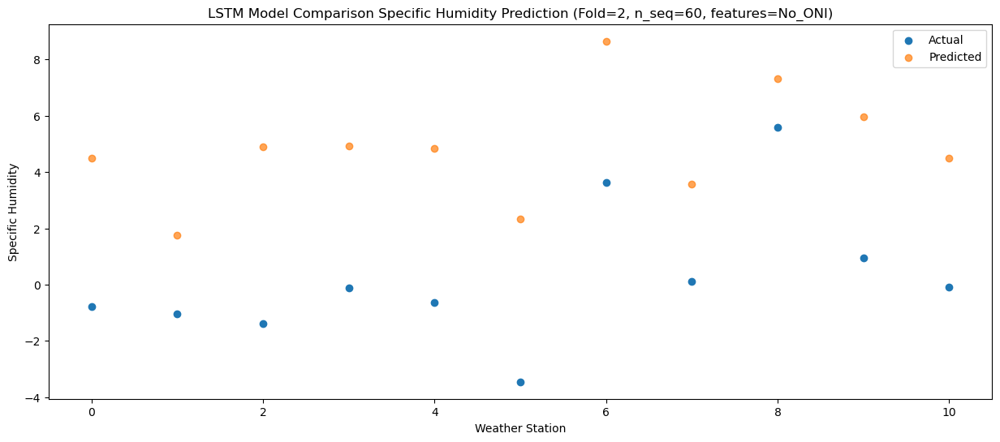

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    0.65    5.48903
1                 1   -0.15    2.75903
2                 2    0.44    5.90903
3                 3    0.64    5.92903
4                 4    0.22    5.83903
5                 5   -1.83    3.32903
6                 6    5.25    9.64903
7                 7    0.50    4.55903
8                 8    7.34    8.30903
9                 9    1.92    6.96903
10               10    0.52    5.48903


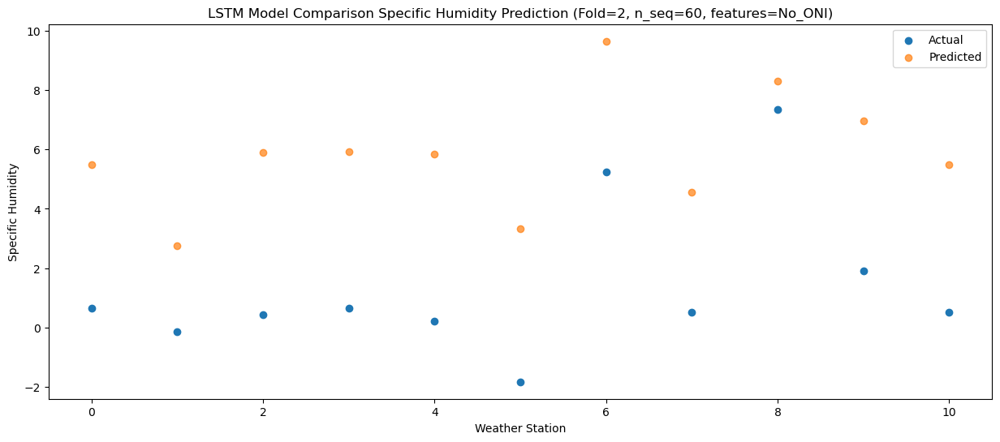

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    2.55   7.337327
1                 1    1.00   4.607327
2                 2    1.80   7.757327
3                 3    1.34   7.777327
4                 4    2.65   7.687327
5                 5    2.13   5.177327
6                 6    9.15  11.497327
7                 7    0.51   6.407327
8                 8    8.18  10.157327
9                 9    2.96   8.817327
10               10    1.79   7.337327


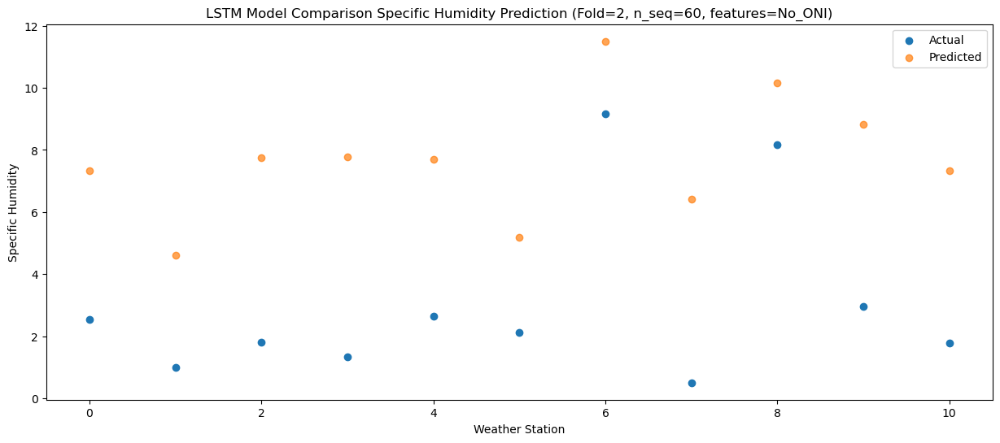

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    6.81  11.312655
1                 1    3.39   8.582655
2                 2    4.90  11.732655
3                 3    4.64  11.752655
4                 4    6.68  11.662655
5                 5    5.78   9.152655
6                 6   13.24  15.472655
7                 7    0.44  10.382655
8                 8    9.44  14.132655
9                 9    7.28  12.792655
10               10    5.95  11.312655


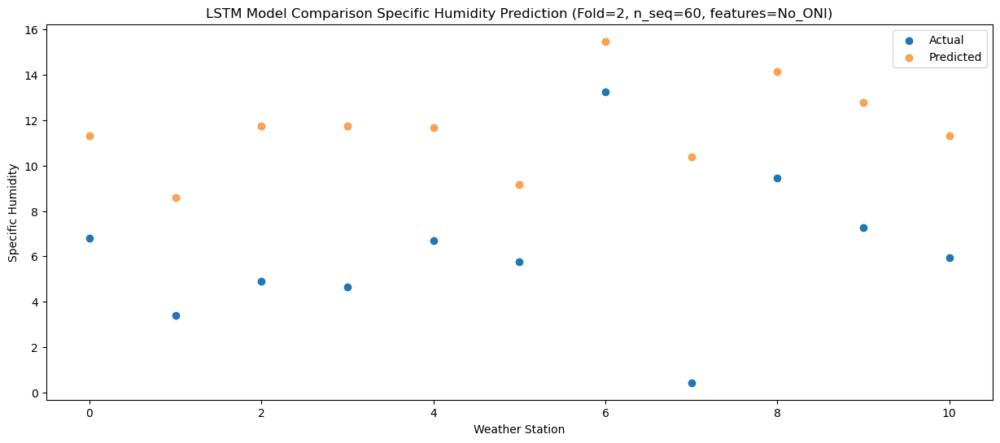

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    8.86  13.917949
1                 1    7.75  11.187949
2                 2    6.83  14.337949
3                 3    6.90  14.357949
4                 4    8.98  14.267949
5                 5    6.81  11.757949
6                 6   14.04  18.077949
7                 7    5.94  12.987949
8                 8   11.21  16.737949
9                 9    9.08  15.397949
10               10    7.91  13.917949


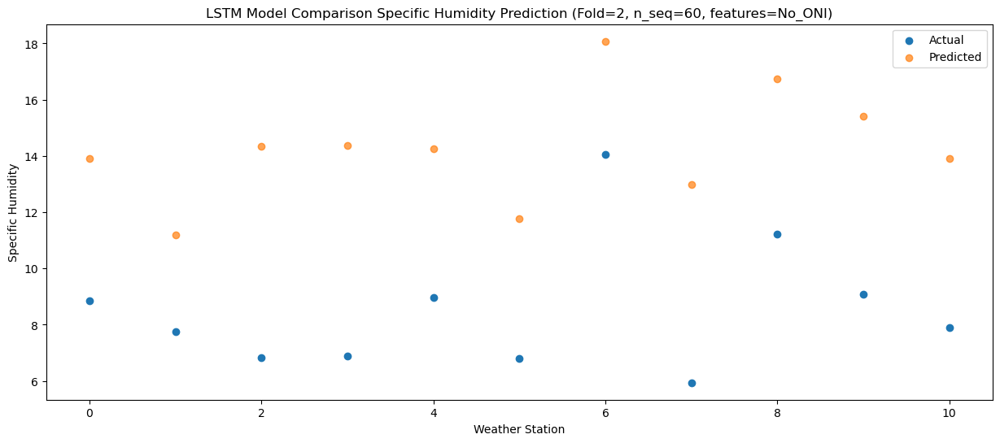

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   12.08  15.013845
1                 1    9.09  12.283845
2                 2    7.66  15.433845
3                 3   10.26  15.453845
4                 4   10.27  15.363845
5                 5    7.91  12.853845
6                 6   13.36  19.173845
7                 7    8.50  14.083845
8                 8   12.10  17.833845
9                 9   12.66  16.493845
10               10   11.12  15.013845


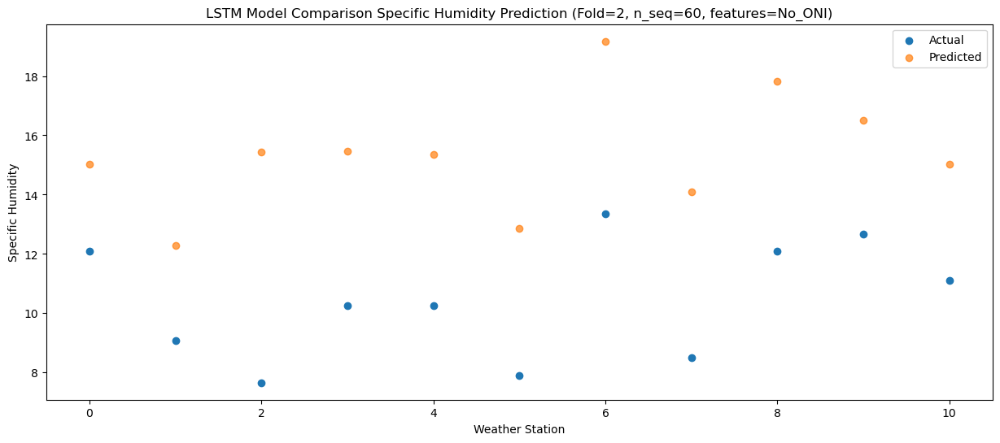

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   11.60  15.133643
1                 1    8.59  12.403643
2                 2    7.55  15.553643
3                 3   10.94  15.573643
4                 4   10.67  15.483643
5                 5    8.37  12.973643
6                 6   14.42  19.293643
7                 7   10.47  14.203643
8                 8   12.20  17.953643
9                 9   11.09  16.613643
10               10   10.13  15.133643


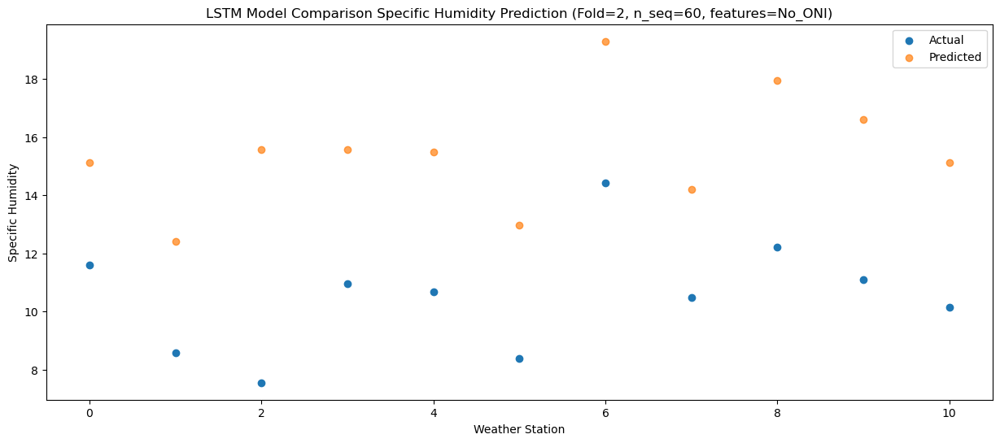

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    6.85   12.01744
1                 1    6.02    9.28744
2                 2    7.40   12.43744
3                 3    7.14   12.45744
4                 4    7.16   12.36744
5                 5    5.01    9.85744
6                 6   11.75   16.17744
7                 7    7.43   11.08744
8                 8   13.05   14.83744
9                 9    7.66   13.49744
10               10    6.65   12.01744


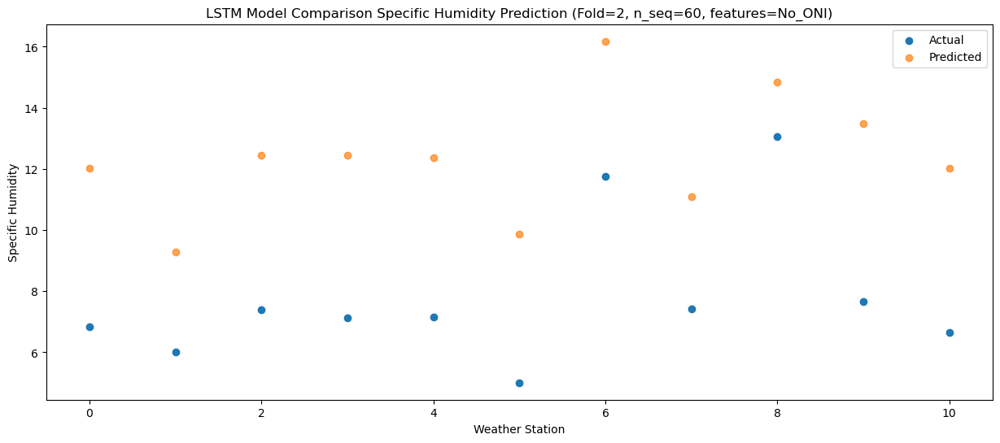

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    2.13   8.509265
1                 1    2.34   5.779265
2                 2    3.01   8.929265
3                 3    4.27   8.949265
4                 4    1.98   8.859265
5                 5    0.19   6.349265
6                 6    6.97  12.669265
7                 7    5.35   7.579265
8                 8   11.28  11.329265
9                 9    3.30   9.989265
10               10    1.99   8.509265


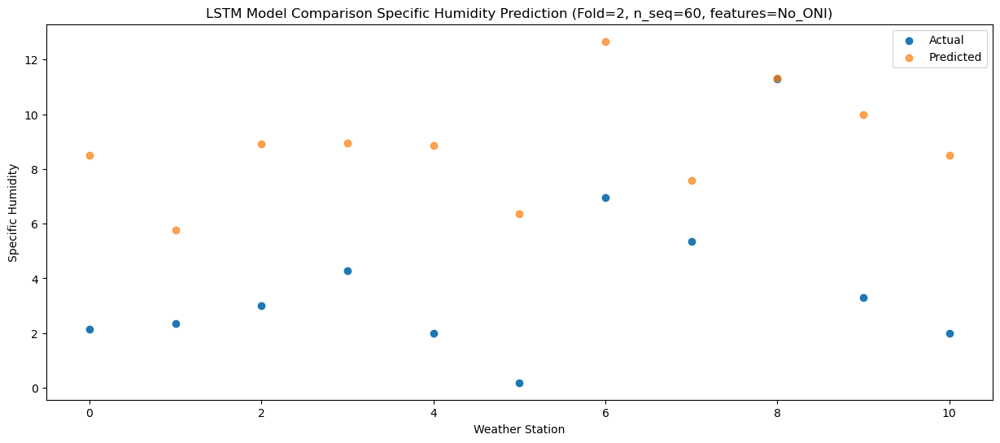

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.19   7.298935
1                 1    0.84   4.568935
2                 2    2.90   7.718935
3                 3    2.45   7.738935
4                 4    1.54   7.648935
5                 5    0.05   5.138935
6                 6    6.52  11.458935
7                 7    1.38   6.368935
8                 8    6.64  10.118935
9                 9    2.83   8.778935
10               10    1.37   7.298935


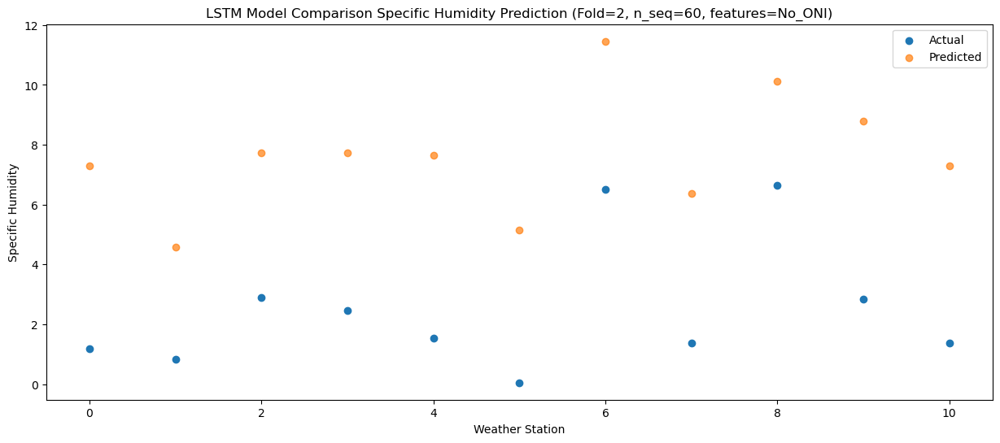

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    0.56   6.754416
1                 1   -0.35   4.024416
2                 2   -0.76   7.174416
3                 3    0.36   7.194416
4                 4    0.99   7.104416
5                 5   -0.86   4.594416
6                 6    5.35  10.914416
7                 7    2.20   5.824416
8                 8    7.49   9.574416
9                 9    0.59   8.234416
10               10    0.28   6.754416


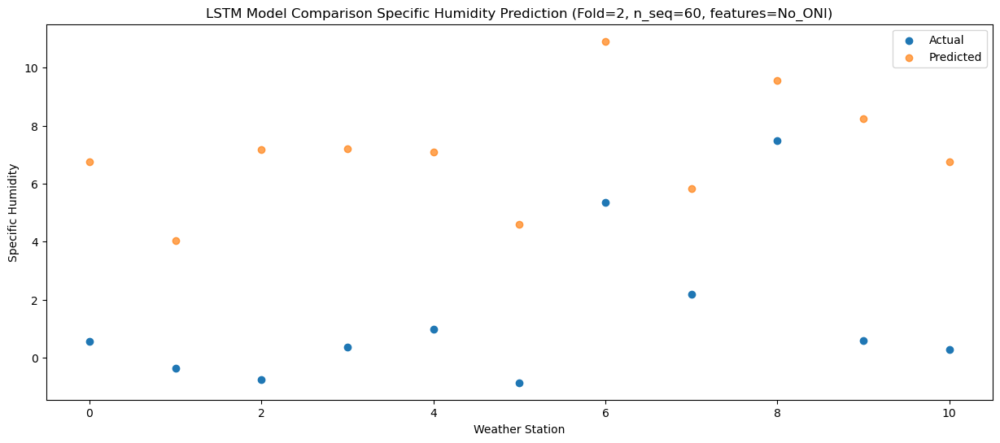

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.97   7.664928
1                 1   -0.36   4.934928
2                 2   -1.14   8.084928
3                 3    0.87   8.104928
4                 4    0.90   8.014928
5                 5   -1.24   5.504928
6                 6    4.57  11.824928
7                 7    1.31   6.734928
8                 8    7.58  10.484928
9                 9    1.45   9.144928
10               10    0.55   7.664928


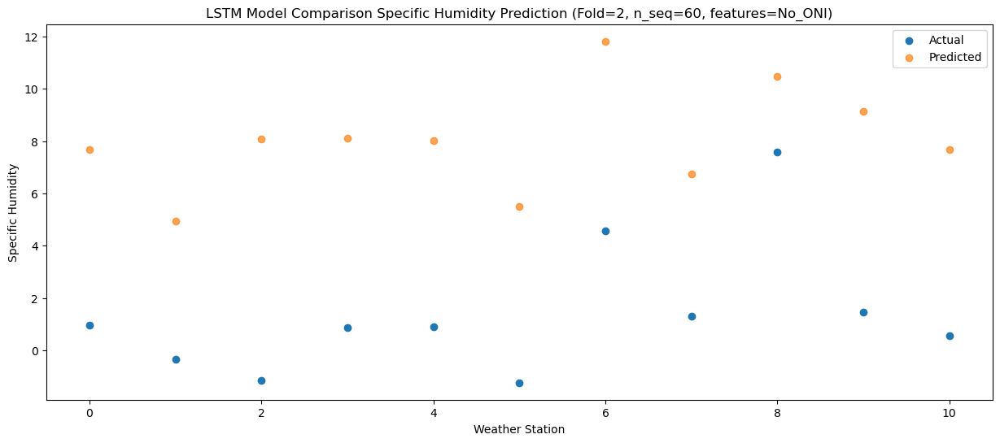

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.19   7.216799
1                 1   -0.44   4.486799
2                 2    0.71   7.636799
3                 3    0.11   7.656799
4                 4    2.20   7.566799
5                 5   -0.79   5.056799
6                 6    4.97  11.376799
7                 7    1.19   6.286799
8                 8    6.17  10.036799
9                 9    2.21   8.696799
10               10    0.95   7.216799


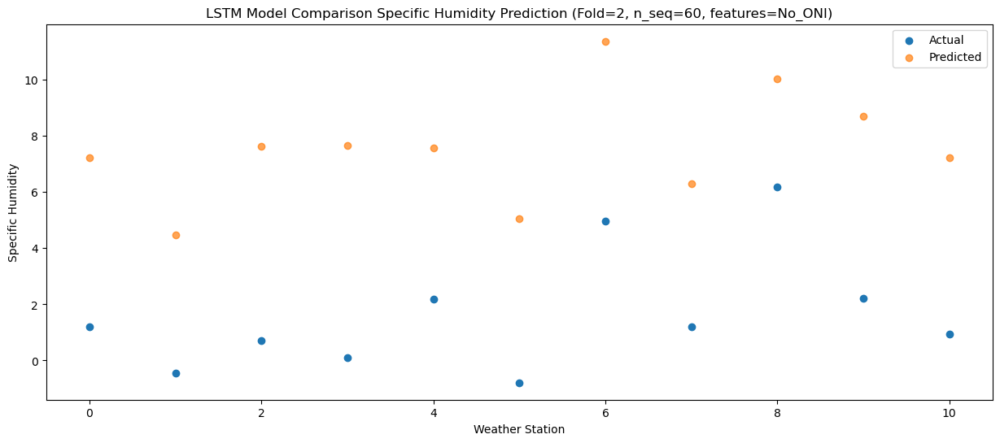

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.54   7.473207
1                 1    0.25   4.743207
2                 2    1.10   7.893207
3                 3    0.36   7.913207
4                 4    3.08   7.823207
5                 5    0.99   5.313207
6                 6    6.88  11.633207
7                 7    1.53   6.543207
8                 8    8.09  10.293207
9                 9    1.90   8.953207
10               10    0.55   7.473207


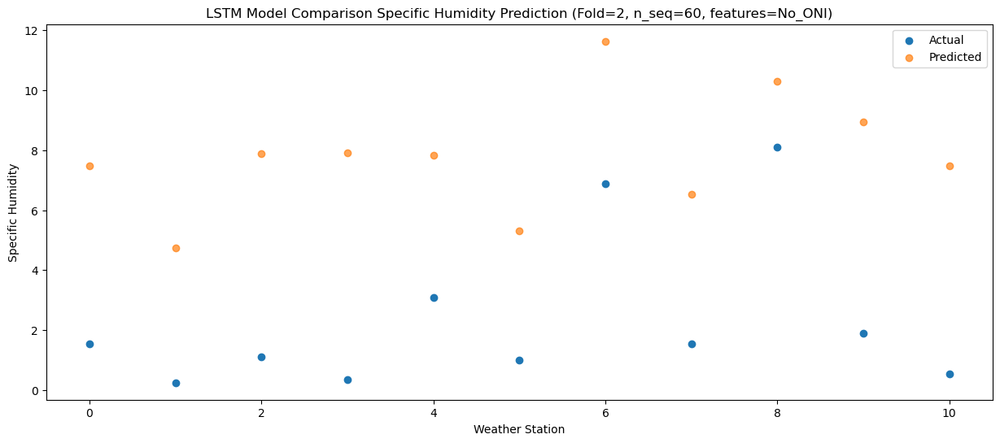

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    2.48   8.333084
1                 1    0.87   5.603084
2                 2    2.61   8.753084
3                 3    2.44   8.773084
4                 4    3.63   8.683084
5                 5    1.54   6.173084
6                 6    7.55  12.493084
7                 7    0.69   7.403084
8                 8    8.79  11.153084
9                 9    4.03   9.813084
10               10    2.19   8.333084


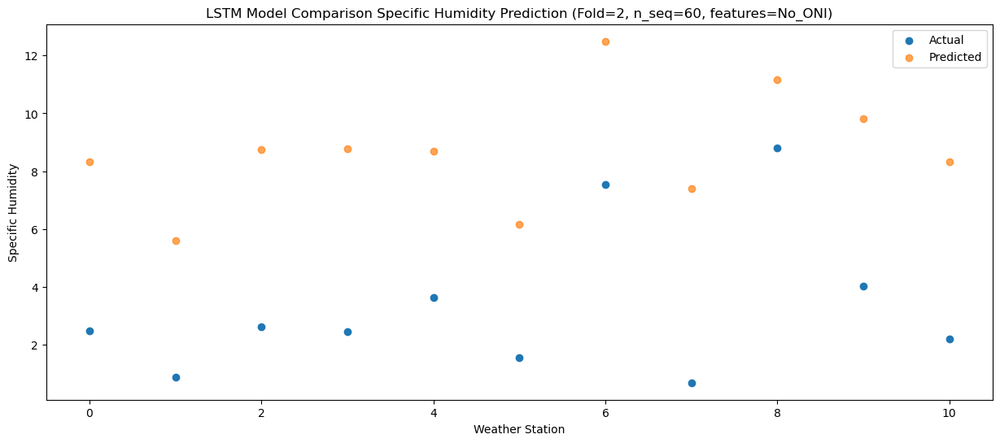

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    6.09  11.943269
1                 1    6.65   9.213269
2                 2    3.42  12.363269
3                 3    3.25  12.383269
4                 4    6.69  12.293269
5                 5    5.24   9.783269
6                 6   11.44  16.103269
7                 7    2.69  11.013269
8                 8   10.19  14.763269
9                 9    5.56  13.423269
10               10    4.78  11.943269


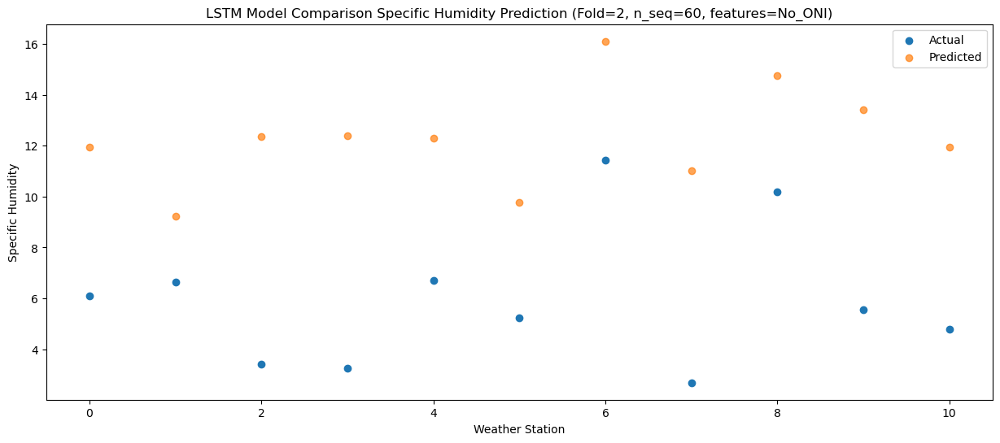

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    9.06  13.647554
1                 1    9.30  10.917554
2                 2    6.58  14.067554
3                 3    7.15  14.087554
4                 4   10.00  13.997554
5                 5    8.70  11.487554
6                 6   15.34  17.807554
7                 7    2.49  12.717554
8                 8   10.57  16.467554
9                 9    8.42  15.127554
10               10    6.62  13.647554


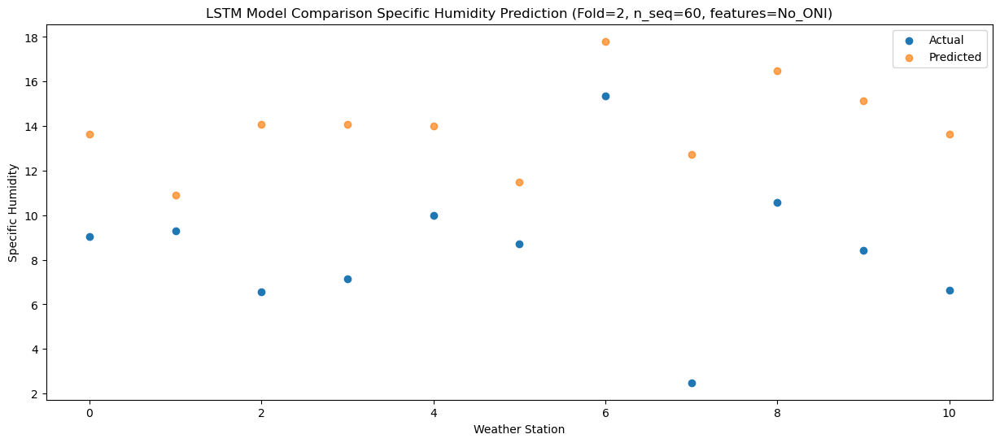

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   12.24  14.586264
1                 1   11.36  11.856264
2                 2    7.55  15.006264
3                 3   11.41  15.026264
4                 4   11.34  14.936264
5                 5    8.41  12.426264
6                 6   14.63  18.746264
7                 7    5.84  13.656264
8                 8   11.91  17.406264
9                 9   12.26  16.066264
10               10    9.93  14.586264


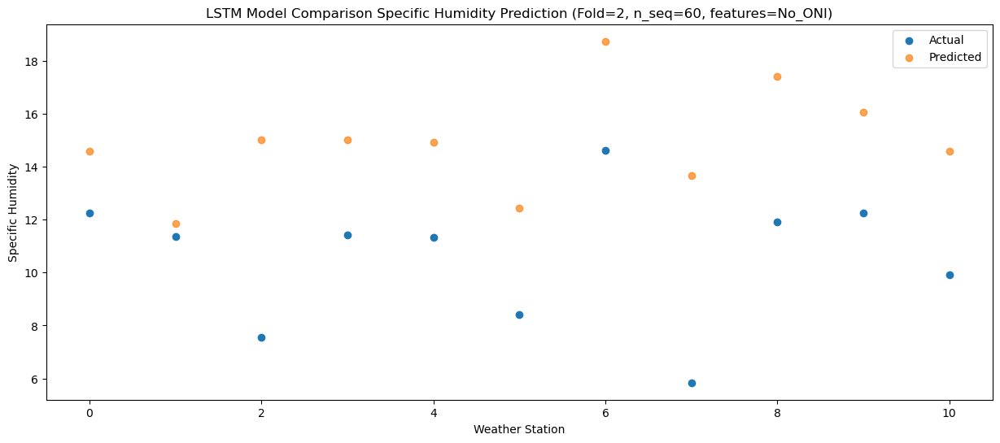

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   11.59  14.453987
1                 1    9.47  11.723987
2                 2    8.27  14.873987
3                 3    9.07  14.893987
4                 4   11.37  14.803987
5                 5    6.98  12.293987
6                 6   12.58  18.613987
7                 7    8.03  13.523987
8                 8   12.52  17.273987
9                 9   11.77  15.933987
10               10   10.04  14.453987


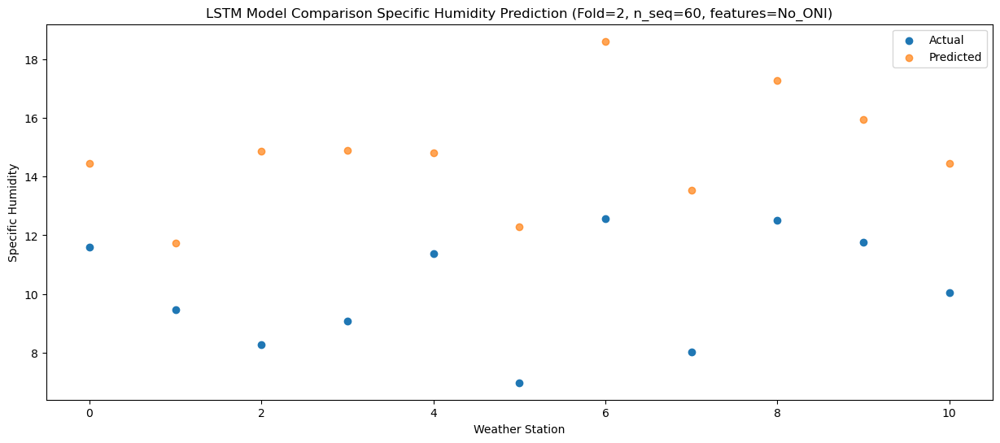

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    7.56  12.288492
1                 1    6.88   9.558492
2                 2    5.88  12.708492
3                 3    8.06  12.728492
4                 4    9.02  12.638492
5                 5    6.43  10.128492
6                 6   11.95  16.448492
7                 7    6.22  11.358492
8                 8   12.27  15.108492
9                 9    8.63  13.768492
10               10    7.62  12.288492


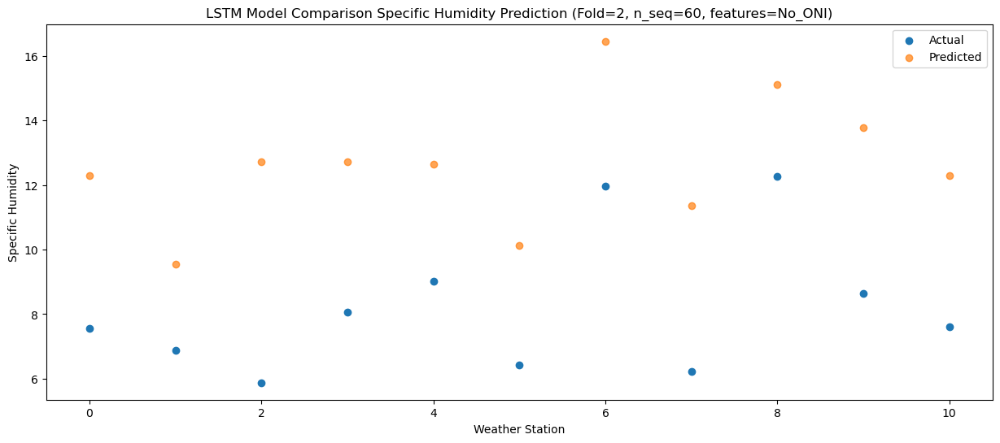

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    3.46   9.416537
1                 1    3.42   6.686537
2                 2    2.96   9.836537
3                 3    4.70   9.856537
4                 4    3.79   9.766537
5                 5    2.90   7.256537
6                 6    8.80  13.576537
7                 7    3.77   8.486537
8                 8    9.97  12.236537
9                 9    4.44  10.896537
10               10    3.51   9.416537


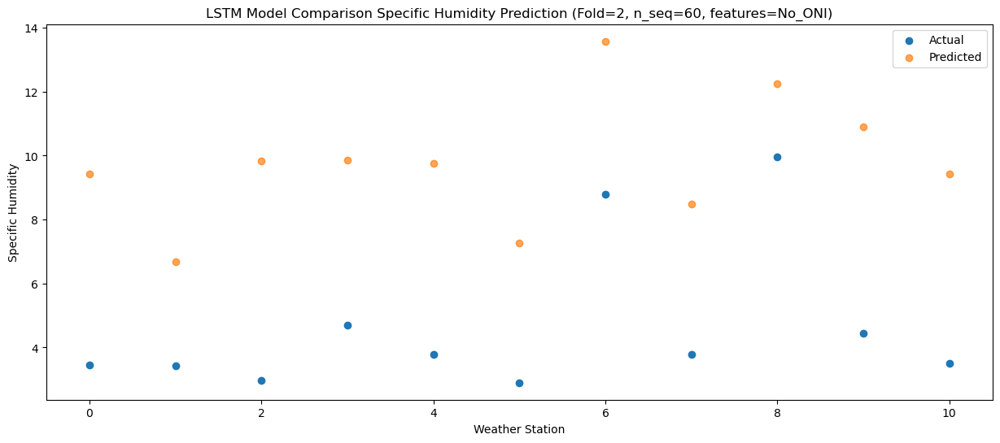

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    0.82   6.824106
1                 1    0.86   4.094106
2                 2    0.46   7.244106
3                 3    0.87   7.264106
4                 4    1.27   7.174106
5                 5   -0.27   4.664106
6                 6    6.18  10.984106
7                 7    2.85   5.894106
8                 8    6.94   9.644106
9                 9    1.33   8.304106
10               10    0.56   6.824106


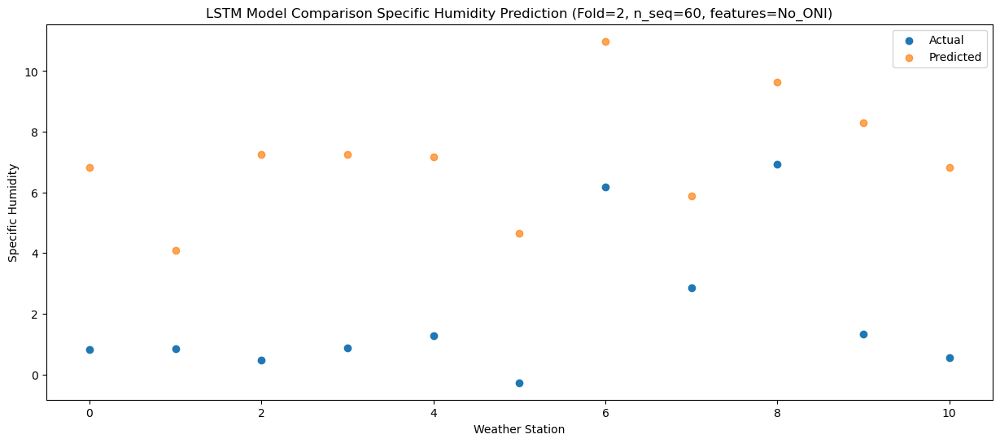

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.10   6.617976
1                 1    0.47   3.887976
2                 2   -0.11   7.037976
3                 3    1.16   7.057976
4                 4   -0.32   6.967976
5                 5   -2.20   4.457976
6                 6    4.36  10.777976
7                 7    1.33   5.687976
8                 8    7.73   9.437976
9                 9    1.24   8.097976
10               10    0.35   6.617976


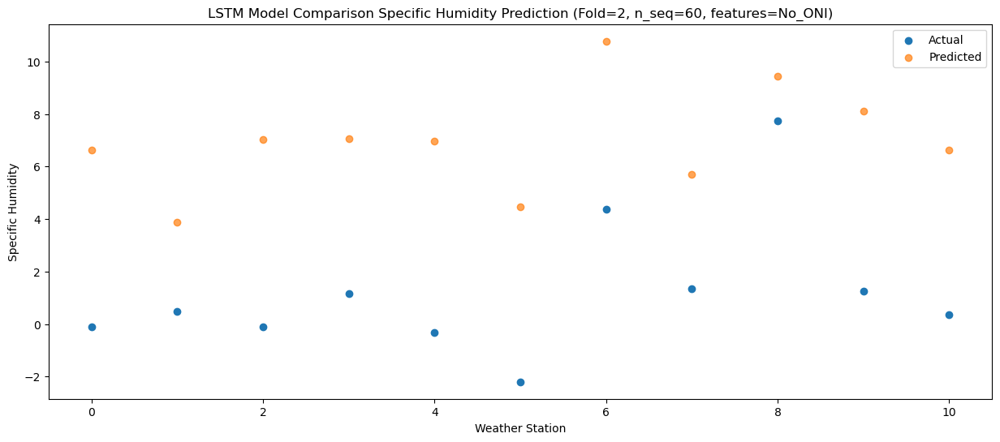

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -0.99   5.938942
1                 1   -0.12   3.208942
2                 2   -1.18   6.358942
3                 3   -0.17   6.378942
4                 4   -1.19   6.288942
5                 5   -3.21   3.778942
6                 6    3.24  10.098942
7                 7    1.75   5.008942
8                 8    7.70   8.758942
9                 9    0.55   7.418942
10               10   -0.27   5.938942


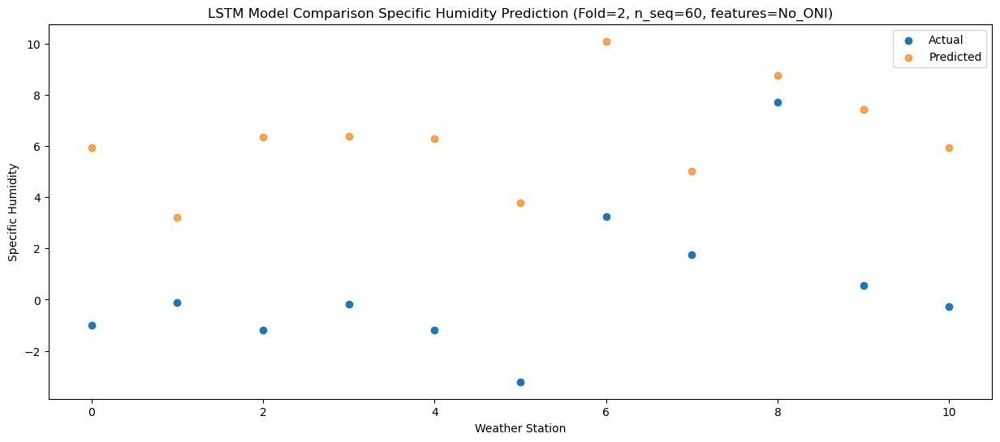

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    0.88   7.069035
1                 1    0.70   4.339035
2                 2   -1.60   7.489035
3                 3   -0.22   7.509035
4                 4   -0.13   7.419035
5                 5   -0.81   4.909035
6                 6    5.71  11.229035
7                 7    1.77   6.139035
8                 8    8.67   9.889035
9                 9    0.69   8.549035
10               10    0.13   7.069035


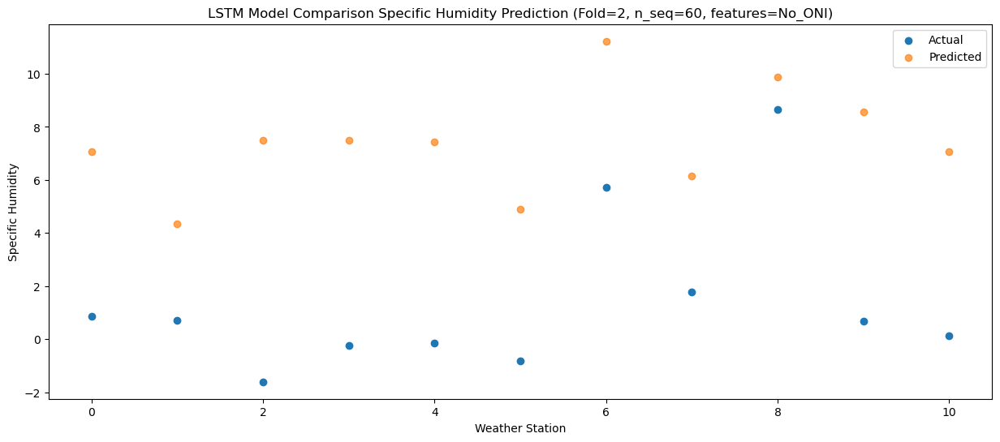

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    1.70   7.421917
1                 1    0.95   4.691917
2                 2    1.56   7.841917
3                 3    0.83   7.861917
4                 4    1.47   7.771917
5                 5    0.83   5.261917
6                 6    7.33  11.581917
7                 7    1.99   6.491917
8                 8    7.11  10.241917
9                 9    2.10   8.901917
10               10    1.23   7.421917


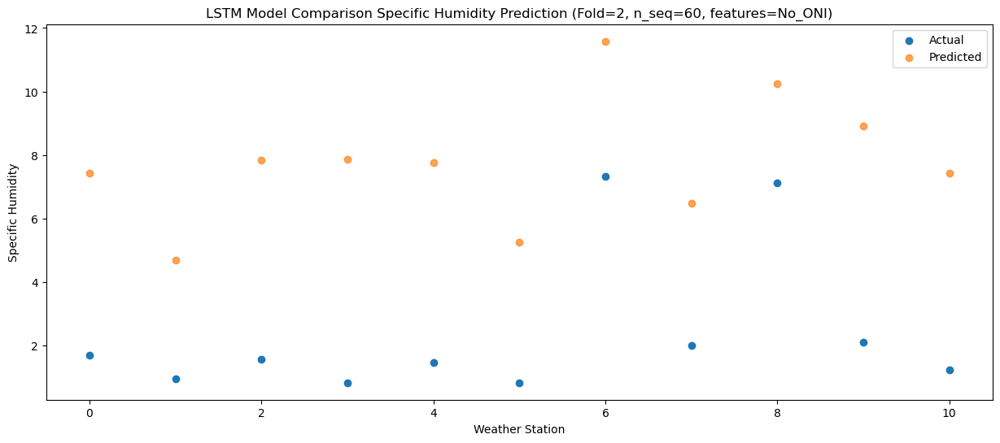

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    3.91   9.594434
1                 1    1.91   6.864434
2                 2    0.35  10.014434
3                 3    1.72  10.034434
4                 4    3.54   9.944434
5                 5    3.11   7.434434
6                 6    9.53  13.754434
7                 7    1.32   8.664434
8                 8    6.21  12.414434
9                 9    4.32  11.074434
10               10    3.34   9.594434


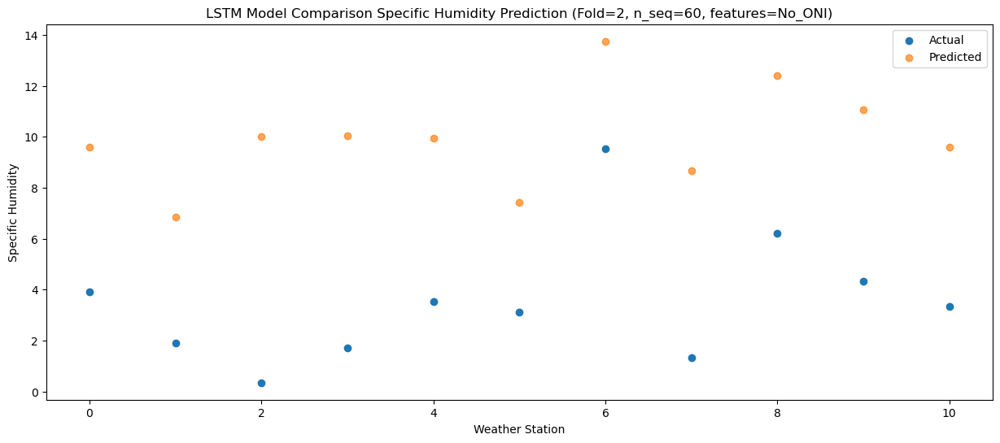

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    8.17  12.662336
1                 1    4.94   9.932336
2                 2    5.21  13.082336
3                 3    4.90  13.102336
4                 4    7.97  13.012336
5                 5    7.21  10.502336
6                 6   13.31  16.822336
7                 7    1.01  11.732336
8                 8   10.31  15.482336
9                 9    8.20  14.142336
10               10    7.20  12.662336


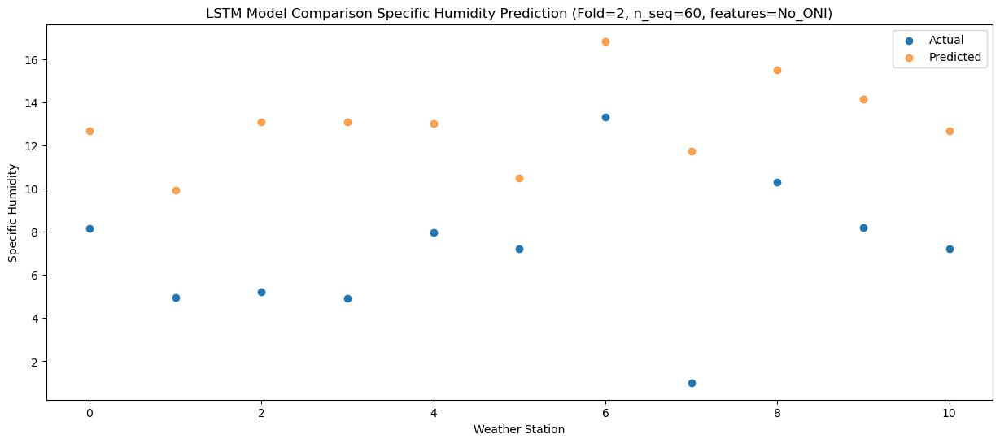

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   10.14   15.36541
1                 1   10.95   12.63541
2                 2    7.27   15.78541
3                 3    7.82   15.80541
4                 4    9.94   15.71541
5                 5    8.87   13.20541
6                 6   14.90   19.52541
7                 7    5.06   14.43541
8                 8   11.91   18.18541
9                 9   10.07   16.84541
10               10    8.75   15.36541


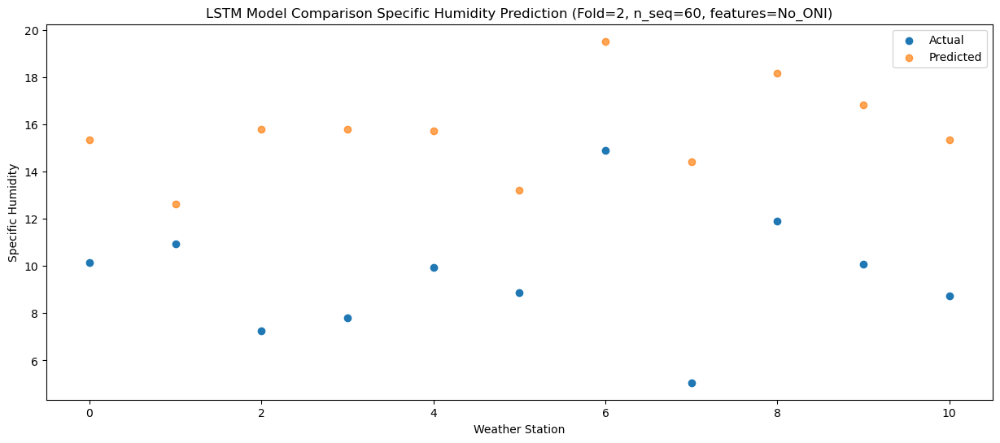

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   11.61  16.292655
1                 1    9.50  13.562655
2                 2    8.32  16.712655
3                 3   10.99  16.732655
4                 4   11.58  16.642655
5                 5    9.17  14.132655
6                 6   15.13  20.452655
7                 7    8.66  15.362655
8                 8   13.14  19.112655
9                 9   12.68  17.772655
10               10   10.79  16.292655


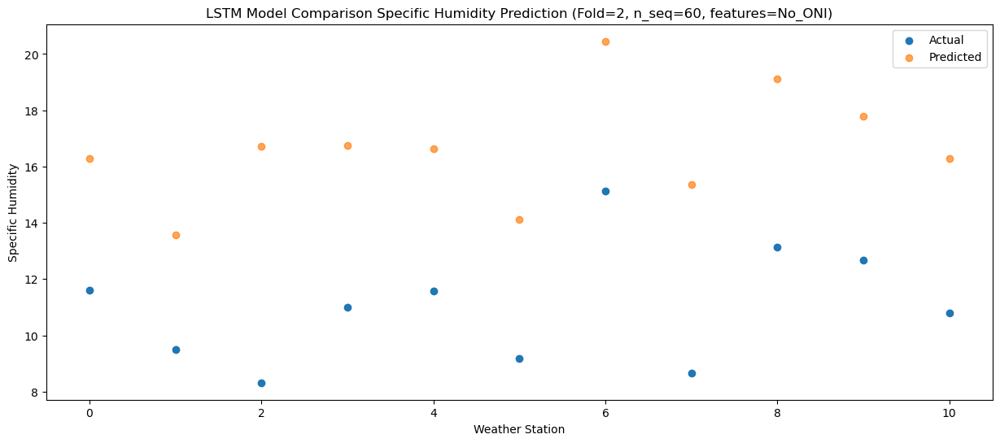

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    9.61  15.613549
1                 1   10.48  12.883549
2                 2    8.92  16.033549
3                 3    9.49  16.053549
4                 4   10.41  15.963549
5                 5    9.21  13.453549
6                 6   14.95  19.773549
7                 7    8.34  14.683549
8                 8   12.32  18.433549
9                 9   11.42  17.093549
10               10    9.78  15.613549


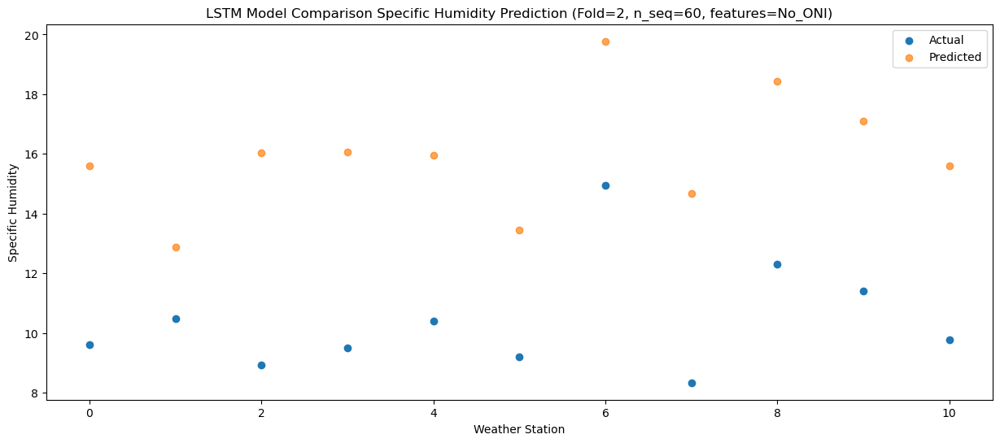

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    7.99  12.922655
1                 1    6.53  10.192655
2                 2    9.35  13.342655
3                 3    6.60  13.362655
4                 4    8.81  13.272655
5                 5    6.72  10.762655
6                 6   12.05  17.082655
7                 7    5.60  11.992655
8                 8   11.93  15.742655
9                 9    9.57  14.402655
10               10    7.68  12.922655


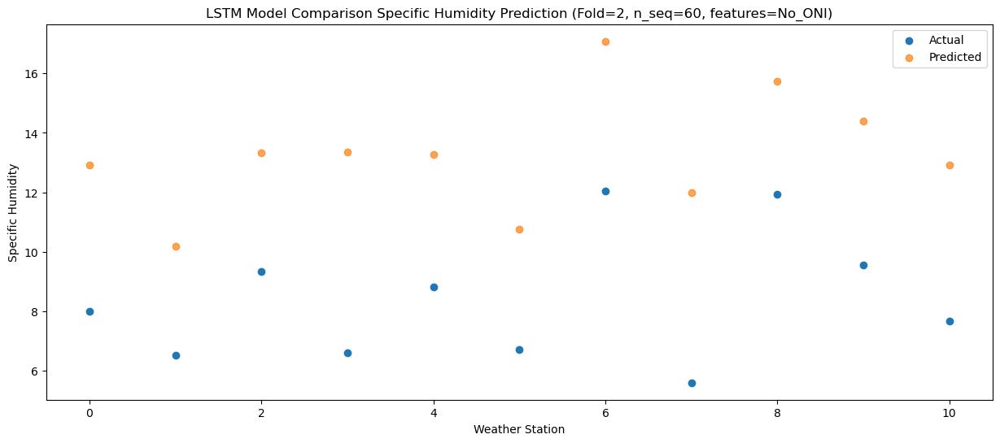

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    3.61    9.62475
1                 1    3.67    6.89475
2                 2    4.37   10.04475
3                 3    3.36   10.06475
4                 4    3.95    9.97475
5                 5    2.40    7.46475
6                 6    8.63   13.78475
7                 7    2.71    8.69475
8                 8   10.03   12.44475
9                 9    4.95   11.10475
10               10    3.61    9.62475


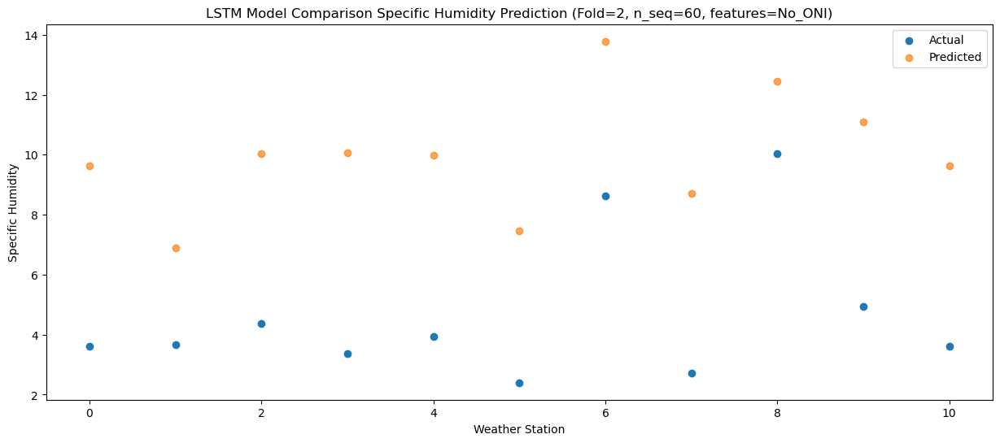

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_4 (LSTM)               (1, 1, 256)               2121728   
                                                                 
 dropout_4 (Dropout)         (1, 1, 256)               0         
                                                                 
 lstm_5 (LSTM)               (1, 256)                  525312    
                                                                 
 dropout_5 (Dropout)         (1, 256)                  0         
                                                                 
 dense_6 (Dense)             (1, 256)                  65792     
                                                                 
 dense_7 (Dense)             (1, 128)                  32896     
                                                                 
 dense_8 (Dense)             (1, 60)                  

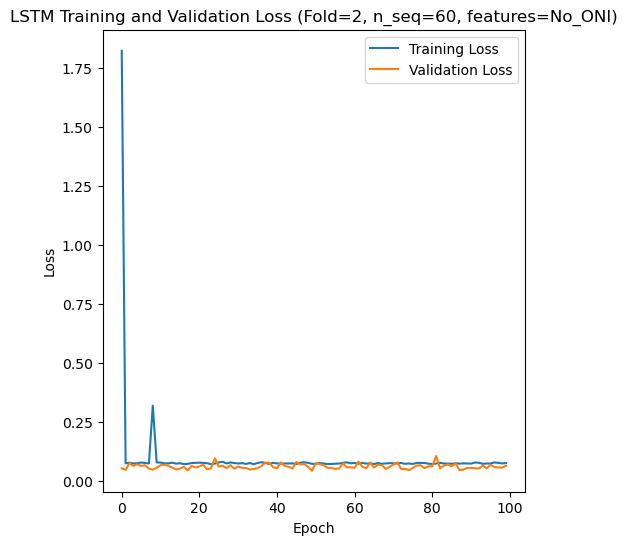

Epoch 1/100
84/84 [==============================] - 26s 108ms/step - loss: 3.9125 - accuracy: 0.3929 - mae: 3.7665 - rmse: 3.9125 - mape: 864.6289 - pearson: 0.5456 - val_loss: 0.0730 - val_accuracy: 0.6000 - val_mae: 0.0579 - val_rmse: 0.0730 - val_mape: 12.3354 - val_pearson: 0.7064
Epoch 2/100
84/84 [==============================] - 2s 29ms/step - loss: 0.0704 - accuracy: 0.4048 - mae: 0.0561 - rmse: 0.0704 - mape: 12.7576 - pearson: 0.7676 - val_loss: 0.0962 - val_accuracy: 0.6000 - val_mae: 0.0763 - val_rmse: 0.0962 - val_mape: 16.2904 - val_pearson: 0.6713
Epoch 3/100
84/84 [==============================] - 3s 32ms/step - loss: 0.0742 - accuracy: 0.4286 - mae: 0.0592 - rmse: 0.0742 - mape: 13.7025 - pearson: 0.7508 - val_loss: 0.0831 - val_accuracy: 0.6000 - val_mae: 0.0650 - val_rmse: 0.0831 - val_mape: 14.0667 - val_pearson: 0.5946
Epoch 4/100
84/84 [==============================] - 3s 32ms/step - loss: 0.0741 - accuracy: 0.2619 - mae: 0.0578 - rmse: 0.0741 - mape: 13.2201 

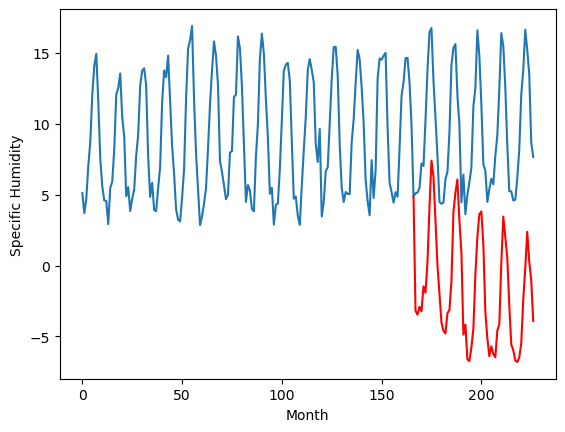

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.14		-2.14		-2.00
-0.55		-2.43		-1.88
-0.58		-1.87		-1.29
-0.94		-2.19		-1.25
1.66		-0.42		-2.08
1.81		-0.87		-2.68
4.78		1.29		-3.49
8.31		5.17		-3.14
11.05		8.45		-2.60
8.38		7.31		-1.07
6.94		4.25		-2.69
2.37		1.05		-1.32
0.87		-0.91		-1.78
-1.17		-2.98		-1.81
-1.26		-3.55		-2.29
-1.82		-3.75		-1.93
0.69		-2.32		-3.01
1.86		-2.09		-3.95
5.38		-0.07		-5.45
9.91		4.80		-5.11
10.79		6.18		-4.61
10.96		7.11		-3.85
6.99		4.23		-2.76
4.80		1.96		-2.84
0.37		-3.84		-4.21
1.34		-3.12		-4.46
-1.85		-5.57		-3.72
-1.48		-5.70		-4.22
-0.01		-4.75		-4.74
2.29		-3.43		-5.72
6.74		0.40		-6.34
9.36		3.07		-6.29
9.57		4.67		-4.90
10.18		4.86		-5.32
6.33		2.52		-3.81
1.87		-2.23		-4.10
0.84		-4.07		-4.91
-0.35		-5.36		-5.01
-0.43		-4.66		-4.23
-0.27		-5.19		-4.92
0.67		-5.43		-6.10
1.54		-3.55		-5.09
5.95		-3.11		-9.06
8.59		1.21		-7.38
10.86		4.50		-6.36
11.10		3.06		-8.04
7.03		1.57		-5.46
3.59		-1.77		

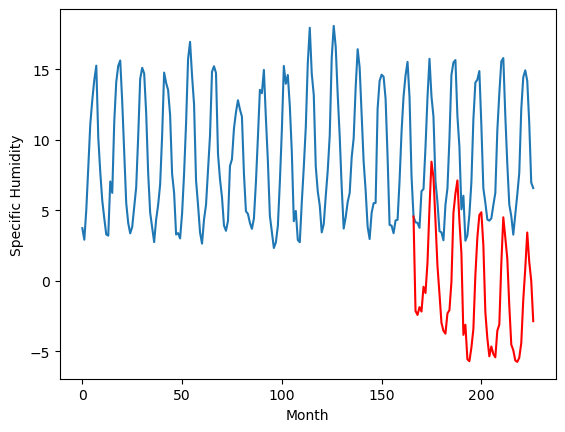

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
5.99		1.06		-4.93
6.53		0.77		-5.76
6.15		1.33		-4.82
5.46		1.01		-4.45
6.54		2.78		-3.76
7.91		2.33		-5.58
7.72		4.49		-3.23
9.26		8.37		-0.89
9.48		11.65		2.17
11.00		10.51		-0.49
10.52		7.45		-3.07
8.64		4.25		-4.39
5.95		2.29		-3.66
5.35		0.22		-5.13
5.79		-0.35		-6.14
5.73		-0.55		-6.28
5.81		0.88		-4.93
6.43		1.11		-5.32
6.83		3.13		-3.70
9.28		8.00		-1.28
9.98		9.38		-0.60
9.51		10.31		0.80
8.22		7.43		-0.79
7.08		5.16		-1.92
7.66		-0.64		-8.30
6.16		0.08		-6.08
5.88		-2.37		-8.25
5.10		-2.50		-7.60
6.44		-1.55		-7.99
6.11		-0.23		-6.34
6.29		3.60		-2.69
7.46		6.27		-1.19
8.63		7.87		-0.76
9.42		8.06		-1.36
9.13		5.72		-3.41
7.96		0.97		-6.99
5.24		-0.87		-6.11
6.08		-2.16		-8.24
6.23		-1.46		-7.69
5.10		-1.99		-7.09
6.62		-2.23		-8.85
6.82		-0.35		-7.17
7.76		0.09		-7.67
8.53		4.41		-4.12
9.63		7.70		-1.93
10.70		6.26		-4.44
9.16		4.77		-4.39
8.00		1.43		-6.57
5.89		-1.33		-7.22
6.12	

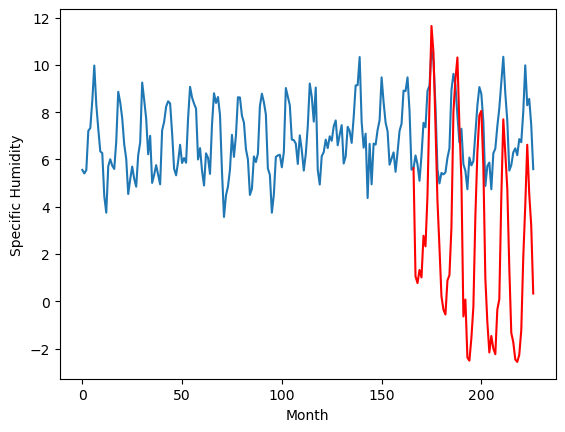

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.83		-1.16		-0.33
-0.30		-1.45		-1.15
-0.70		-0.89		-0.19
-0.88		-1.21		-0.33
0.98		0.56		-0.42
0.90		0.11		-0.79
4.33		2.27		-2.06
7.57		6.15		-1.42
10.67		9.43		-1.24
9.59		8.29		-1.30
7.02		5.23		-1.79
3.33		2.03		-1.30
0.44		0.07		-0.37
-1.17		-2.00		-0.83
-1.44		-2.57		-1.13
-1.51		-2.77		-1.26
-0.21		-1.34		-1.13
0.98		-1.11		-2.09
3.51		0.91		-2.60
8.93		5.78		-3.15
9.56		7.16		-2.40
10.44		8.09		-2.35
6.97		5.21		-1.76
4.91		2.94		-1.97
-0.78		-2.86		-2.08
0.36		-2.14		-2.50
-1.96		-4.59		-2.63
-1.44		-4.72		-3.28
-0.46		-3.77		-3.31
0.81		-2.45		-3.26
5.23		1.38		-3.85
7.49		4.05		-3.44
10.53		5.65		-4.88
9.40		5.84		-3.56
6.15		3.50		-2.65
1.00		-1.25		-2.25
0.19		-3.09		-3.28
-0.84		-4.38		-3.54
-0.30		-3.68		-3.38
-0.48		-4.21		-3.73
-0.61		-4.45		-3.84
0.93		-2.57		-3.50
3.84		-2.13		-5.97
5.86		2.19		-3.67
9.51		5.48		-4.03
8.96		4.04		-4.92
6.49		2.55		-3.94
2.96		-0.79		-3.7

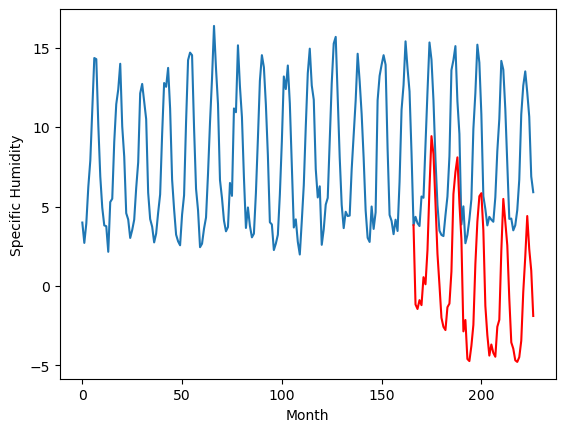

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.61		0.24		-3.37
2.11		-0.05		-2.16
-0.18		0.51		0.69
-0.94		0.19		1.13
1.13		1.96		0.83
1.45		1.51		0.06
5.15		3.67		-1.48
8.24		7.55		-0.69
12.19		10.83		-1.36
9.81		9.69		-0.12
6.85		6.63		-0.22
2.13		3.43		1.30
1.03		1.47		0.44
-0.90		-0.60		0.30
-1.10		-1.17		-0.07
-1.93		-1.37		0.56
0.55		0.06		-0.49
1.61		0.29		-1.32
4.03		2.31		-1.72
8.49		7.18		-1.31
10.44		8.56		-1.88
10.53		9.49		-1.04
6.76		6.61		-0.15
4.81		4.34		-0.47
-0.31		-1.46		-1.15
0.39		-0.74		-1.13
-2.07		-3.19		-1.12
-1.45		-3.32		-1.87
0.12		-2.37		-2.49
1.68		-1.05		-2.73
5.77		2.78		-2.99
7.87		5.45		-2.42
10.46		7.05		-3.41
9.96		7.24		-2.72
6.86		4.90		-1.96
1.86		0.15		-1.71
0.47		-1.69		-2.16
-0.65		-2.98		-2.33
-0.27		-2.28		-2.01
0.61		-2.81		-3.42
0.28		-3.05		-3.33
1.51		-1.17		-2.68
4.69		-0.73		-5.42
6.82		3.59		-3.23
10.59		6.88		-3.71
10.98		5.44		-5.54
6.87		3.95		-2.92
3.25		0.61		-2.64
0.08		-2.15		-2

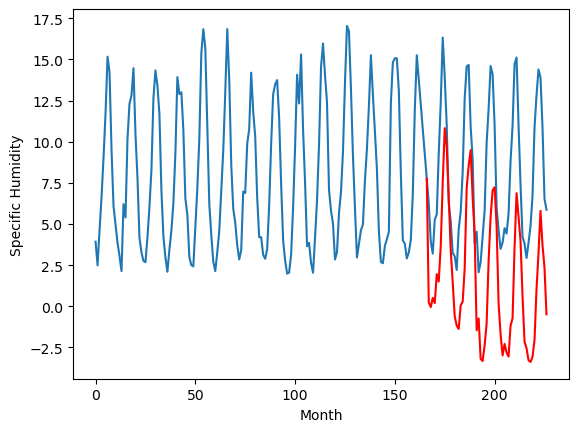

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.24		-1.14		-1.38
0.53		-1.43		-1.96
0.03		-0.87		-0.90
-0.22		-1.19		-0.97
1.77		0.58		-1.19
1.89		0.13		-1.76
5.10		2.29		-2.81
7.83		6.17		-1.66
10.99		9.45		-1.54
9.77		8.31		-1.46
6.59		5.25		-1.34
3.17		2.05		-1.12
1.40		0.09		-1.31
-0.26		-1.98		-1.72
-0.57		-2.55		-1.98
-1.09		-2.75		-1.66
0.94		-1.32		-2.26
2.24		-1.09		-3.33
4.48		0.93		-3.55
9.70		5.80		-3.90
10.95		7.18		-3.77
11.12		8.11		-3.01
7.82		5.23		-2.59
6.20		2.96		-3.24
0.33		-2.84		-3.17
1.38		-2.12		-3.50
-1.13		-4.57		-3.44
-0.60		-4.70		-4.10
0.71		-3.75		-4.46
2.24		-2.43		-4.67
6.47		1.40		-5.07
8.54		4.07		-4.47
11.32		5.67		-5.65
10.12		5.86		-4.26
7.35		3.52		-3.83
2.05		-1.23		-3.28
0.83		-3.07		-3.90
0.07		-4.36		-4.43
0.65		-3.66		-4.31
0.32		-4.19		-4.51
0.75		-4.43		-5.18
2.06		-2.55		-4.61
4.66		-2.11		-6.77
6.82		2.21		-4.61
11.33		5.50		-5.83
10.45		4.06		-6.39
7.22		2.57		-4.65
3.84		-0.77		-4.61
0.65

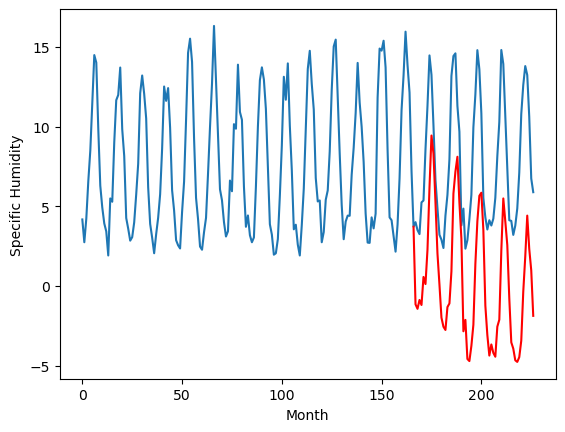

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
6.16		0.69		-5.47
5.79		0.40		-5.39
5.75		0.96		-4.79
5.71		0.64		-5.07
6.34		2.41		-3.93
6.69		1.96		-4.73
7.82		4.12		-3.70
8.88		8.00		-0.88
10.40		11.28		0.88
9.19		10.14		0.95
8.05		7.08		-0.97
6.40		3.88		-2.52
6.34		1.92		-4.42
5.53		-0.15		-5.68
5.70		-0.72		-6.42
5.76		-0.92		-6.68
6.07		0.51		-5.56
6.54		0.74		-5.80
7.94		2.76		-5.18
9.27		7.63		-1.64
11.72		9.01		-2.71
10.29		9.94		-0.35
8.59		7.06		-1.53
7.50		4.79		-2.71
6.79		-1.01		-7.80
6.08		-0.29		-6.37
5.60		-2.74		-8.34
5.39		-2.87		-8.26
6.07		-1.92		-7.99
6.57		-0.60		-7.17
7.38		3.23		-4.15
9.32		5.90		-3.42
12.31		7.50		-4.81
12.15		7.69		-4.46
9.20		5.35		-3.85
7.59		0.60		-6.99
5.93		-1.24		-7.17
5.96		-2.53		-8.49
5.93		-1.83		-7.76
5.55		-2.36		-7.91
5.85		-2.60		-8.45
6.48		-0.72		-7.20
8.64		-0.28		-8.92
8.87		4.04		-4.83
9.71		7.33		-2.38
11.36		5.89		-5.47
8.74		4.40		-4.34
7.49		1.06		-6.43
6.16		-1.70		-7.86


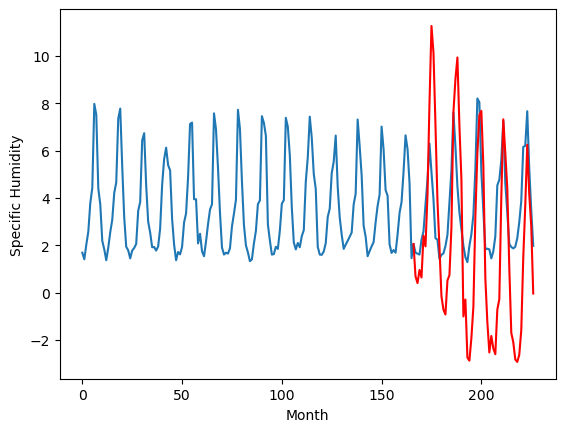

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.99		-0.88		-5.87
5.98		-1.17		-7.15
4.86		-0.61		-5.47
4.44		-0.93		-5.37
6.18		0.84		-5.34
5.99		0.39		-5.60
5.29		2.55		-2.74
5.62		6.43		0.81
6.10		9.71		3.61
6.97		8.57		1.60
5.71		5.51		-0.20
4.70		2.31		-2.39
4.68		0.35		-4.33
3.85		-1.72		-5.57
4.66		-2.29		-6.95
4.18		-2.49		-6.67
4.48		-1.06		-5.54
4.17		-0.83		-5.00
4.73		1.19		-3.54
6.15		6.06		-0.09
11.51		7.44		-4.07
9.08		8.37		-0.71
7.36		5.49		-1.87
6.26		3.22		-3.04
4.99		-2.58		-7.57
5.13		-1.86		-6.99
4.14		-4.31		-8.45
3.71		-4.44		-8.15
4.33		-3.49		-7.82
4.33		-2.17		-6.50
4.59		1.66		-2.93
6.35		4.33		-2.02
9.78		5.93		-3.85
12.85		6.12		-6.73
8.94		3.78		-5.16
6.21		-0.97		-7.18
4.44		-2.81		-7.25
5.19		-4.10		-9.29
5.58		-3.40		-8.98
4.33		-3.93		-8.26
5.37		-4.17		-9.54
4.52		-2.29		-6.81
6.06		-1.85		-7.91
6.56		2.47		-4.09
7.53		5.76		-1.77
10.11		4.32		-5.79
9.17		2.83		-6.34
6.11		-0.51		-6.62
5.10		-3.27		-8.3

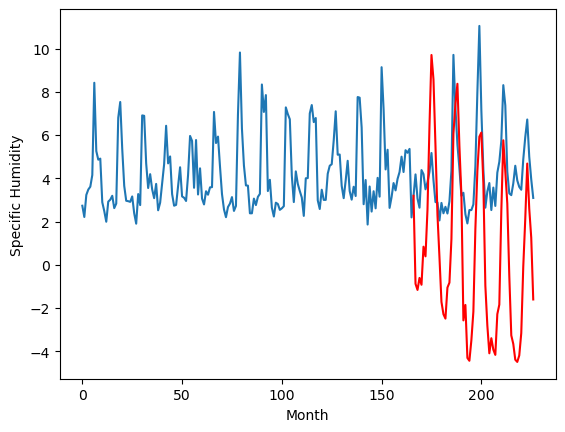

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.53		-0.94		-5.47
5.76		-1.23		-6.99
5.08		-0.67		-5.75
4.19		-0.99		-5.18
4.67		0.78		-3.89
5.73		0.33		-5.40
6.59		2.49		-4.10
6.81		6.37		-0.44
7.28		9.65		2.37
8.08		8.51		0.43
7.69		5.45		-2.24
5.49		2.25		-3.24
4.33		0.29		-4.04
3.99		-1.78		-5.77
4.66		-2.35		-7.01
4.31		-2.55		-6.86
3.96		-1.12		-5.08
4.89		-0.89		-5.78
5.33		1.13		-4.20
6.76		6.00		-0.76
7.24		7.38		0.14
7.63		8.31		0.68
6.99		5.43		-1.56
5.96		3.16		-2.80
6.18		-2.64		-8.82
4.93		-1.92		-6.85
4.60		-4.37		-8.97
3.76		-4.50		-8.26
4.76		-3.55		-8.31
4.86		-2.23		-7.09
5.23		1.60		-3.63
6.72		4.27		-2.45
7.55		5.87		-1.68
8.01		6.06		-1.95
7.41		3.72		-3.69
6.10		-1.03		-7.13
3.85		-2.87		-6.72
4.64		-4.16		-8.80
4.47		-3.46		-7.93
3.61		-3.99		-7.60
4.41		-4.23		-8.64
4.79		-2.35		-7.14
6.38		-1.91		-8.29
6.44		2.41		-4.03
7.28		5.70		-1.58
8.55		4.26		-4.29
8.00		2.77		-5.23
6.57		-0.57		-7.14
5.48		-3.33		-8.81
5.

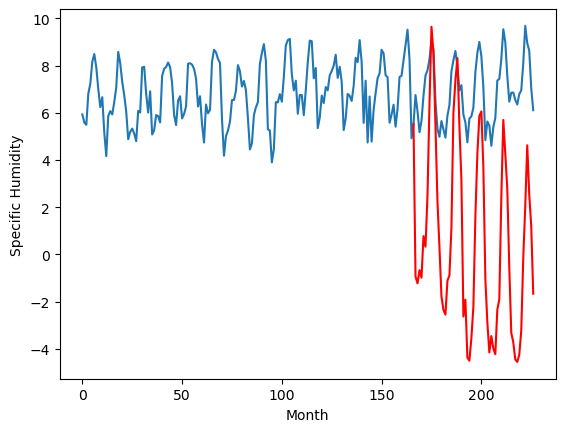

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.50		-0.69		-1.19
0.14		-0.98		-1.12
-0.14		-0.42		-0.28
-0.06		-0.74		-0.68
0.43		1.03		0.60
0.93		0.58		-0.35
3.16		2.74		-0.42
7.27		6.62		-0.65
11.25		9.90		-1.35
10.18		8.76		-1.42
6.81		5.70		-1.11
4.28		2.50		-1.78
2.12		0.54		-1.58
0.16		-1.53		-1.69
-0.93		-2.10		-1.17
-0.78		-2.30		-1.52
0.00		-0.87		-0.87
1.38		-0.64		-2.02
2.95		1.38		-1.57
7.85		6.25		-1.60
10.06		7.63		-2.43
10.44		8.56		-1.88
7.84		5.68		-2.16
5.30		3.41		-1.89
0.77		-2.39		-3.16
0.47		-1.67		-2.14
-1.01		-4.12		-3.11
-0.42		-4.25		-3.83
0.42		-3.30		-3.72
1.07		-1.98		-3.05
4.46		1.85		-2.61
6.80		4.52		-2.28
9.96		6.12		-3.84
10.10		6.31		-3.79
6.43		3.97		-2.46
3.80		-0.78		-4.58
1.95		-2.62		-4.57
-0.02		-3.91		-3.89
0.55		-3.21		-3.76
-0.16		-3.74		-3.58
0.05		-3.98		-4.03
2.29		-2.10		-4.39
2.81		-1.66		-4.47
6.51		2.66		-3.85
11.36		5.95		-5.41
8.79		4.51		-4.28
7.82		3.02		-4.80
4.43		-0.32		-4.75
0.6

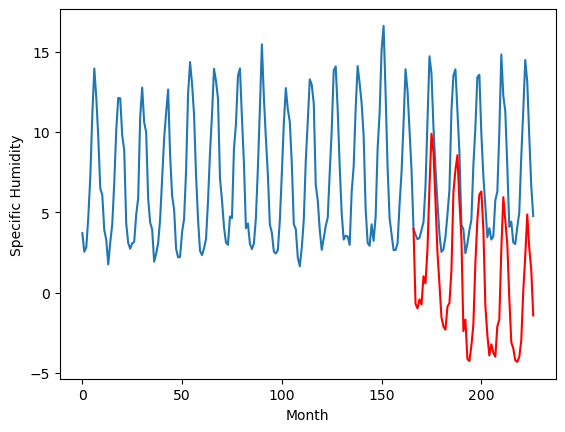

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.56		-3.18		-0.62
-2.68		-3.47		-0.79
-2.76		-2.91		-0.15
-2.77		-3.23		-0.46
-1.81		-1.46		0.35
-1.38		-1.91		-0.53
1.15		0.25		-0.90
4.72		4.13		-0.59
8.07		7.41		-0.66
7.43		6.27		-1.16
4.14		3.21		-0.93
1.37		0.01		-1.36
-0.96		-1.95		-0.99
-2.81		-4.02		-1.21
-3.50		-4.59		-1.09
-3.64		-4.79		-1.15
-2.36		-3.36		-1.00
-0.95		-3.13		-2.18
0.64		-1.11		-1.75
5.51		3.76		-1.75
7.20		5.14		-2.06
7.52		6.07		-1.45
4.60		3.19		-1.41
2.70		0.92		-1.78
-2.22		-4.88		-2.66
-2.32		-4.16		-1.84
-3.83		-6.61		-2.78
-3.13		-6.74		-3.61
-2.19		-5.79		-3.60
-1.55		-4.47		-2.92
2.63		-0.64		-3.27
4.03		2.03		-2.00
7.01		3.63		-3.38
6.64		3.82		-2.82
3.62		1.48		-2.14
0.20		-3.27		-3.47
-1.02		-5.11		-4.09
-2.94		-6.40		-3.46
-2.16		-5.70		-3.54
-2.91		-6.23		-3.32
-2.78		-6.47		-3.69
-0.35		-4.59		-4.24
0.12		-4.15		-4.27
3.81		0.17		-3.64
7.79		3.46		-4.33
6.55		2.02		-4.53
4.86		0.53		-4.33
1.59		-

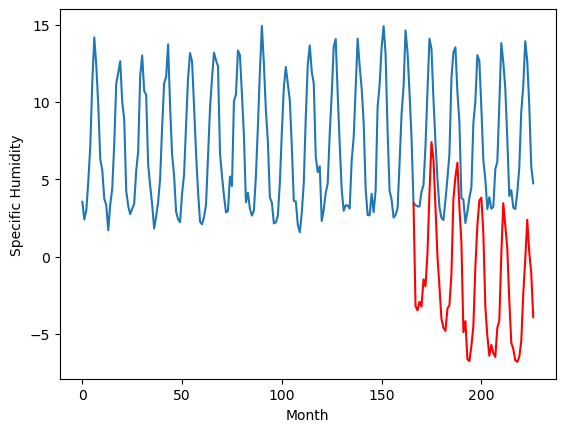

RangeIndex(start=1, stop=12, step=1)
[-3.310000000000001, -0.13999999999999968, 5.989999999999999, -0.8299999999999992, 3.6100000000000003, 0.2400000000000002, 6.16, 4.990000000000001, 4.529999999999999, 0.49999999999999956, -2.56]
[-3.183095989227295, -2.143095989227295, 1.0569040107727048, -1.163095989227295, 0.2369040107727054, -1.143095989227295, 0.6869040107727047, -0.8830959892272947, -0.9430959892272948, -0.6930959892272952, -3.183095989227295]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -3.31  -3.183096
1                 1   -0.14  -2.143096
2                 2    5.99   1.056904
3                 3   -0.83  -1.163096
4                 4    3.61   0.236904
5                 5    0.24  -1.143096
6                 6    6.16   0.686904
7                 7    4.99  -0.883096
8                 8    4.53  -0.943096
9                 9    0.50  -0.693096
10               10   -2.56  -3.183096


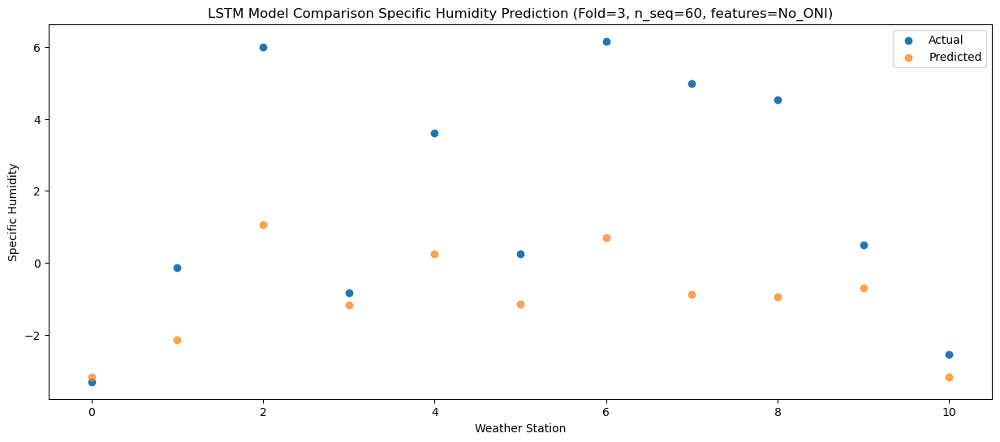

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -3.10  -3.466279
1                 1   -0.55  -2.426279
2                 2    6.53   0.773721
3                 3   -0.30  -1.446279
4                 4    2.11  -0.046279
5                 5    0.53  -1.426279
6                 6    5.79   0.403721
7                 7    5.98  -1.166279
8                 8    5.76  -1.226279
9                 9    0.14  -0.976279
10               10   -2.68  -3.466279


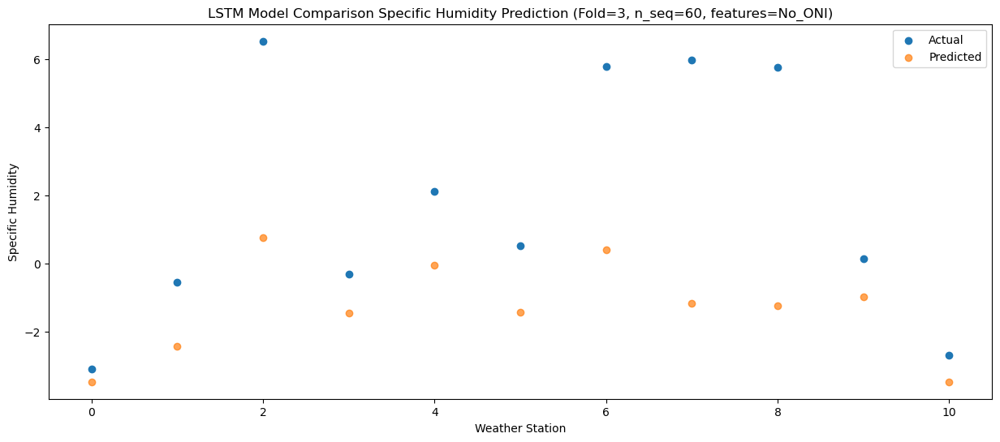

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -3.05  -2.910117
1                 1   -0.58  -1.870117
2                 2    6.15   1.329883
3                 3   -0.70  -0.890117
4                 4   -0.18   0.509883
5                 5    0.03  -0.870117
6                 6    5.75   0.959883
7                 7    4.86  -0.610117
8                 8    5.08  -0.670117
9                 9   -0.14  -0.420117
10               10   -2.76  -2.910117


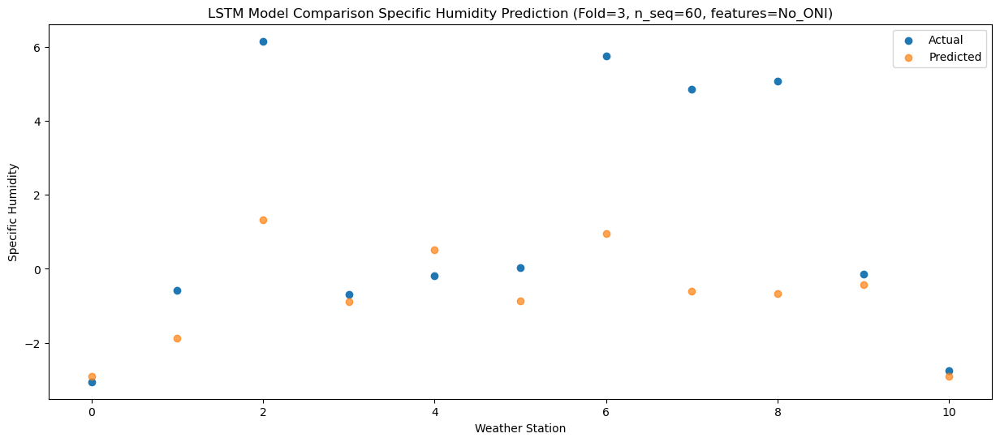

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -2.72   -3.22576
1                 1   -0.94   -2.18576
2                 2    5.46    1.01424
3                 3   -0.88   -1.20576
4                 4   -0.94    0.19424
5                 5   -0.22   -1.18576
6                 6    5.71    0.64424
7                 7    4.44   -0.92576
8                 8    4.19   -0.98576
9                 9   -0.06   -0.73576
10               10   -2.77   -3.22576


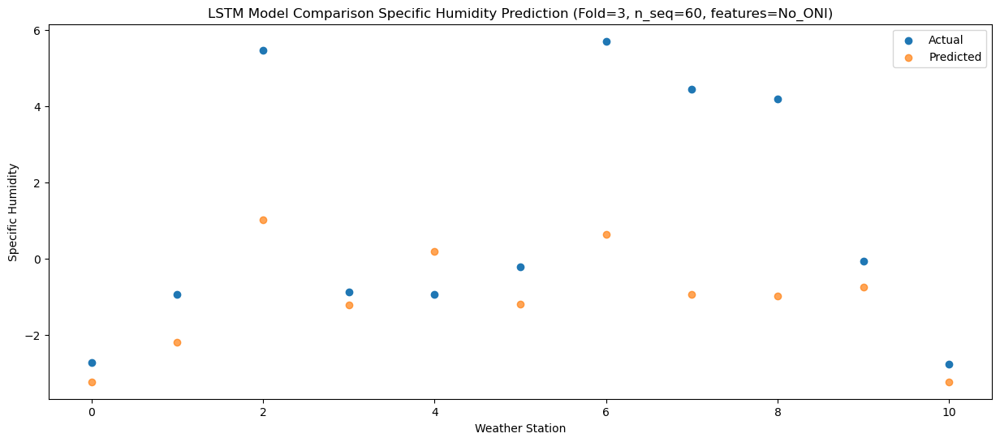

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0   -0.99  -1.464905
1                 1    1.66  -0.424905
2                 2    6.54   2.775095
3                 3    0.98   0.555095
4                 4    1.13   1.955095
5                 5    1.77   0.575095
6                 6    6.34   2.405095
7                 7    6.18   0.835095
8                 8    4.67   0.775095
9                 9    0.43   1.025095
10               10   -1.81  -1.464905


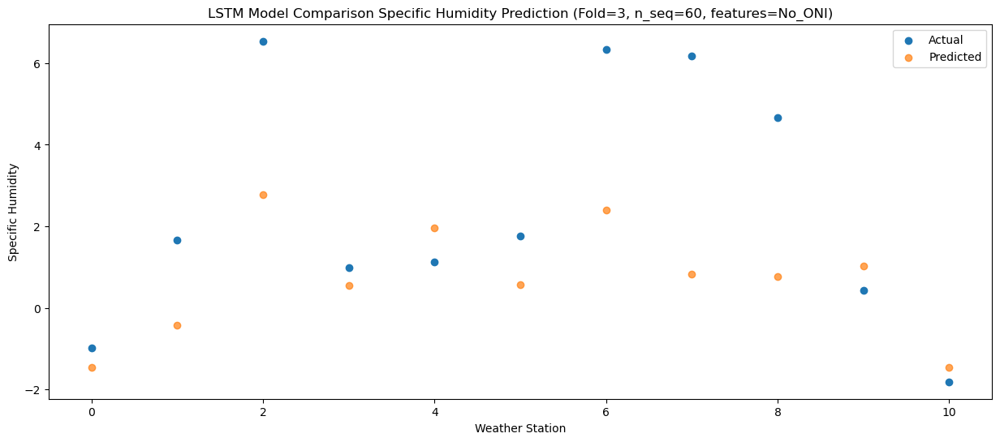

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0   -1.17  -1.911527
1                 1    1.81  -0.871527
2                 2    7.91   2.328473
3                 3    0.90   0.108473
4                 4    1.45   1.508473
5                 5    1.89   0.128473
6                 6    6.69   1.958473
7                 7    5.99   0.388473
8                 8    5.73   0.328473
9                 9    0.93   0.578473
10               10   -1.38  -1.911527


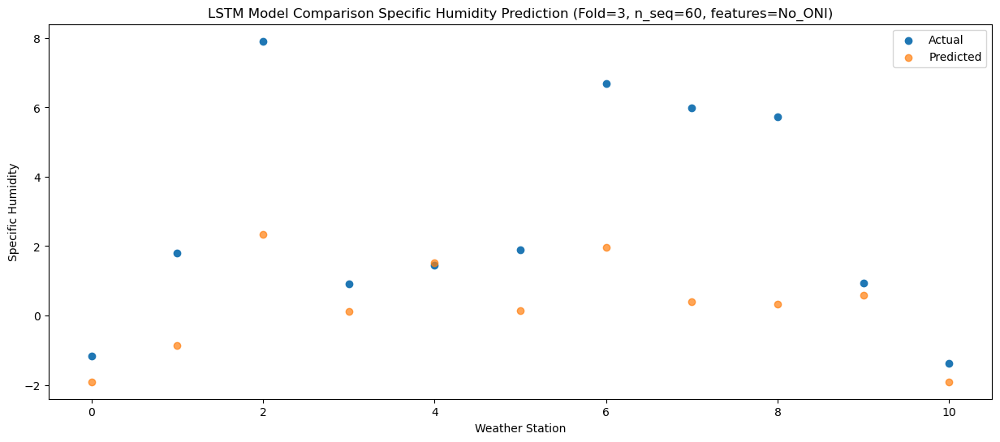

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    2.05   0.247839
1                 1    4.78   1.287839
2                 2    7.72   4.487839
3                 3    4.33   2.267839
4                 4    5.15   3.667839
5                 5    5.10   2.287839
6                 6    7.82   4.117839
7                 7    5.29   2.547839
8                 8    6.59   2.487839
9                 9    3.16   2.737839
10               10    1.15   0.247839


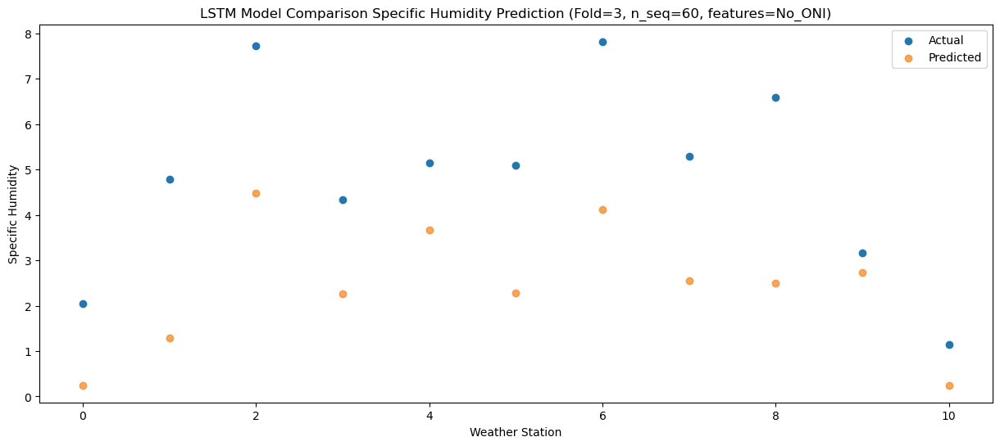

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    5.59   4.130293
1                 1    8.31   5.170293
2                 2    9.26   8.370293
3                 3    7.57   6.150293
4                 4    8.24   7.550293
5                 5    7.83   6.170293
6                 6    8.88   8.000293
7                 7    5.62   6.430293
8                 8    6.81   6.370293
9                 9    7.27   6.620293
10               10    4.72   4.130293


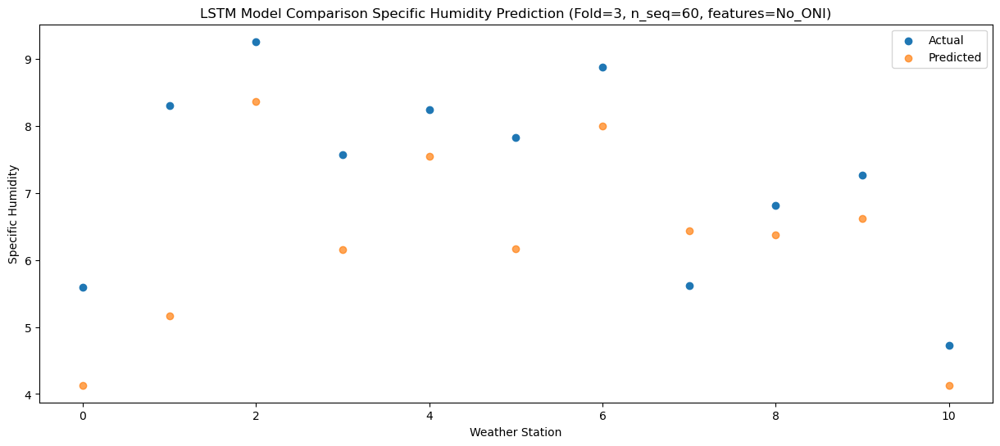

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0    8.28   7.405009
1                 1   11.05   8.445009
2                 2    9.48  11.645009
3                 3   10.67   9.425009
4                 4   12.19  10.825009
5                 5   10.99   9.445009
6                 6   10.40  11.275009
7                 7    6.10   9.705009
8                 8    7.28   9.645009
9                 9   11.25   9.895009
10               10    8.07   7.405009


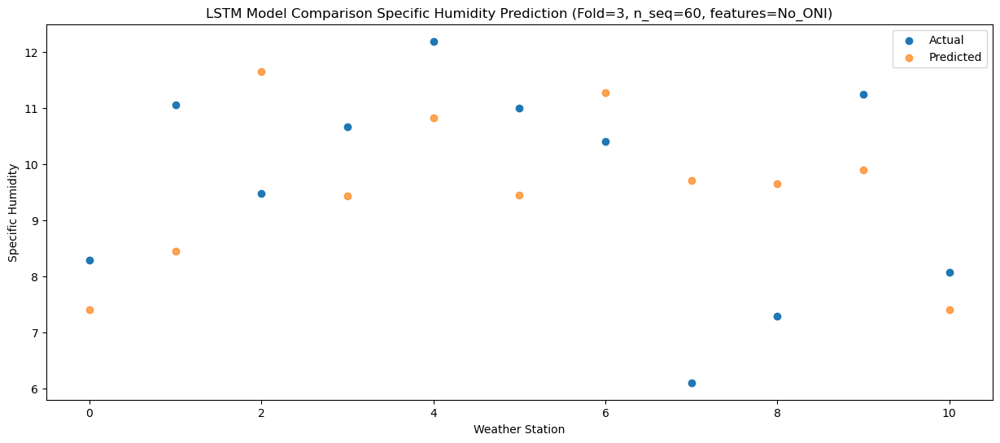

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0    8.57   6.273553
1                 1    8.38   7.313553
2                 2   11.00  10.513553
3                 3    9.59   8.293553
4                 4    9.81   9.693553
5                 5    9.77   8.313553
6                 6    9.19  10.143553
7                 7    6.97   8.573553
8                 8    8.08   8.513553
9                 9   10.18   8.763553
10               10    7.43   6.273553


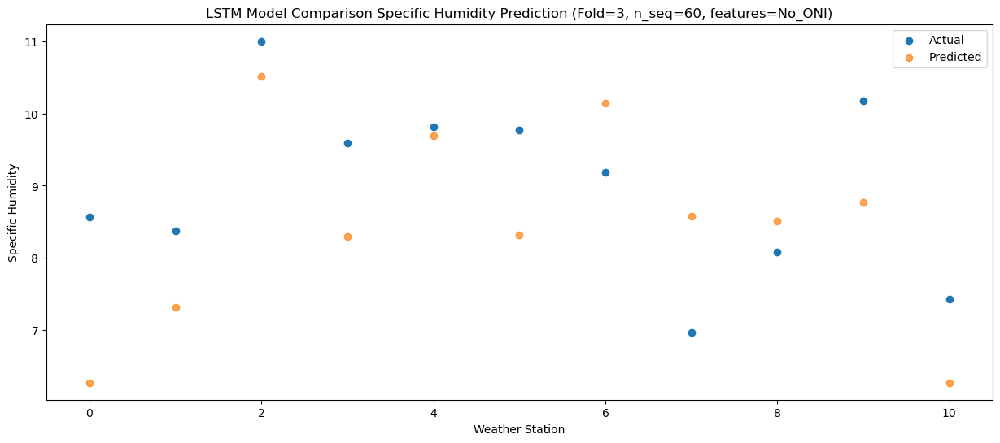

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    4.83   3.212312
1                 1    6.94   4.252312
2                 2   10.52   7.452312
3                 3    7.02   5.232312
4                 4    6.85   6.632312
5                 5    6.59   5.252312
6                 6    8.05   7.082312
7                 7    5.71   5.512312
8                 8    7.69   5.452312
9                 9    6.81   5.702312
10               10    4.14   3.212312


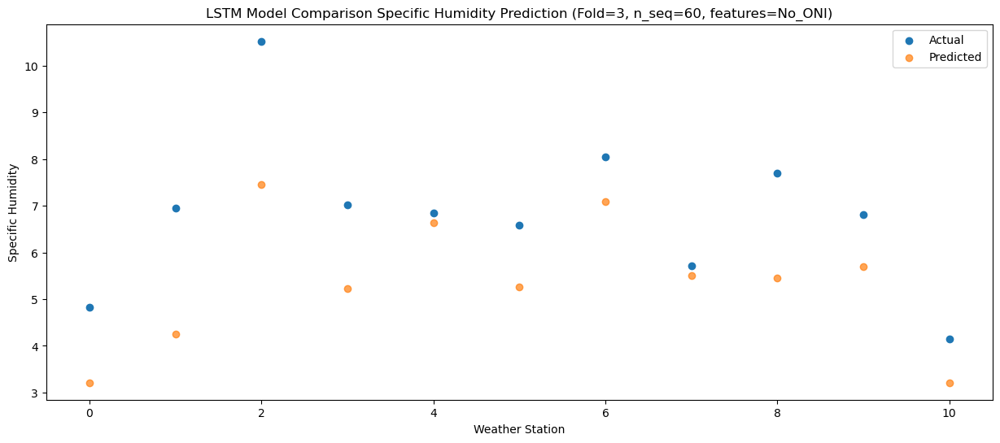

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    2.25   0.006103
1                 1    2.37   1.046103
2                 2    8.64   4.246103
3                 3    3.33   2.026103
4                 4    2.13   3.426103
5                 5    3.17   2.046103
6                 6    6.40   3.876103
7                 7    4.70   2.306103
8                 8    5.49   2.246103
9                 9    4.28   2.496103
10               10    1.37   0.006103


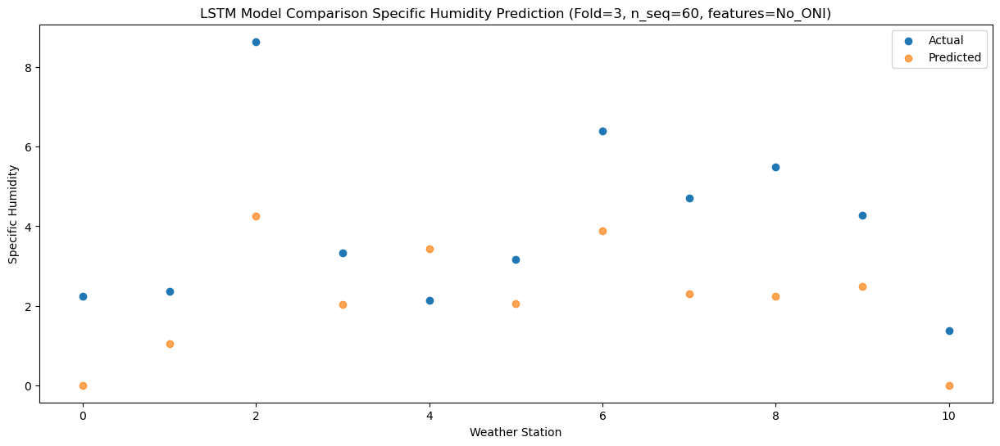

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0   -0.49  -1.950141
1                 1    0.87  -0.910141
2                 2    5.95   2.289859
3                 3    0.44   0.069859
4                 4    1.03   1.469859
5                 5    1.40   0.089859
6                 6    6.34   1.919859
7                 7    4.68   0.349859
8                 8    4.33   0.289859
9                 9    2.12   0.539859
10               10   -0.96  -1.950141


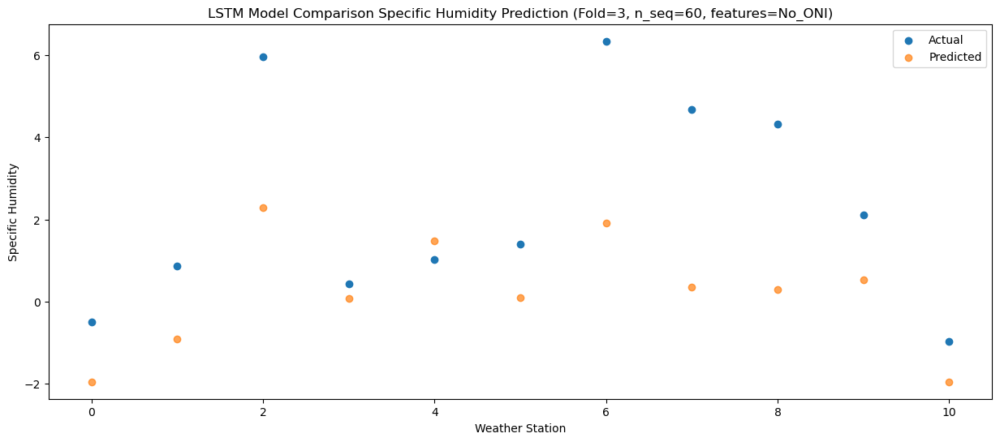

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -3.71  -4.020542
1                 1   -1.17  -2.980542
2                 2    5.35   0.219458
3                 3   -1.17  -2.000542
4                 4   -0.90  -0.600542
5                 5   -0.26  -1.980542
6                 6    5.53  -0.150542
7                 7    3.85  -1.720542
8                 8    3.99  -1.780542
9                 9    0.16  -1.530542
10               10   -2.81  -4.020542


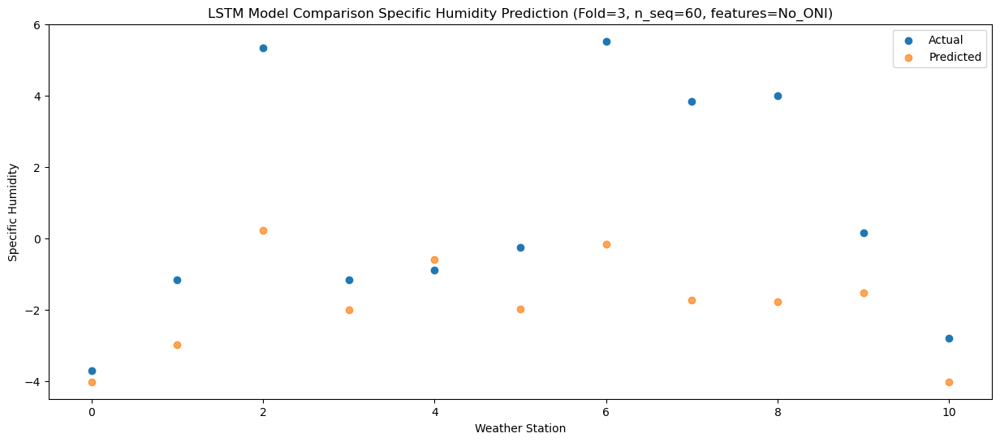

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -3.84  -4.590184
1                 1   -1.26  -3.550184
2                 2    5.79  -0.350184
3                 3   -1.44  -2.570184
4                 4   -1.10  -1.170184
5                 5   -0.57  -2.550184
6                 6    5.70  -0.720184
7                 7    4.66  -2.290184
8                 8    4.66  -2.350184
9                 9   -0.93  -2.100184
10               10   -3.50  -4.590184


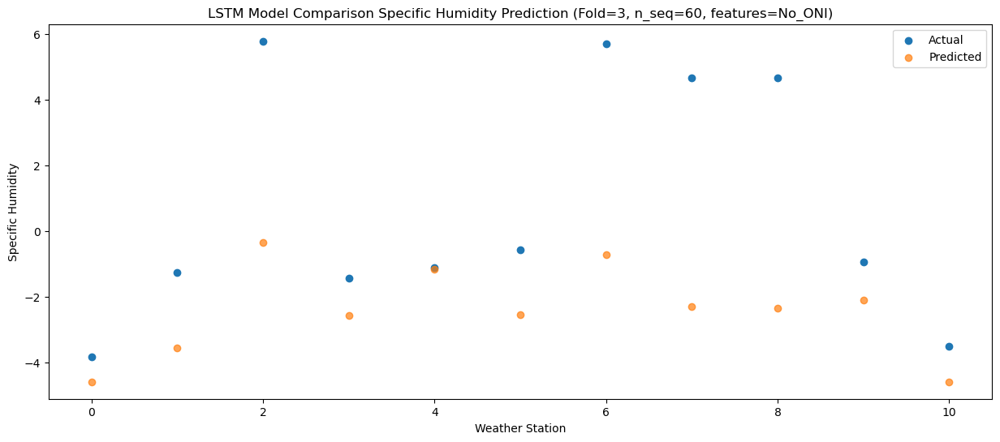

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -3.75  -4.792743
1                 1   -1.82  -3.752743
2                 2    5.73  -0.552743
3                 3   -1.51  -2.772743
4                 4   -1.93  -1.372743
5                 5   -1.09  -2.752743
6                 6    5.76  -0.922743
7                 7    4.18  -2.492743
8                 8    4.31  -2.552743
9                 9   -0.78  -2.302743
10               10   -3.64  -4.792743


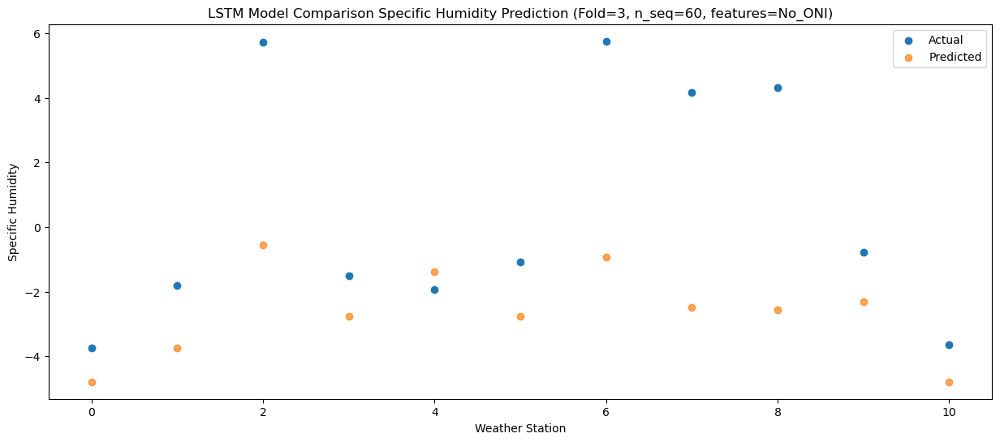

Predictions for (t+16):
    Weather_Station        Actual  Predicted
0                 0 -2.100000e+00  -3.356818
1                 1  6.900000e-01  -2.316818
2                 2  5.810000e+00   0.883182
3                 3 -2.100000e-01  -1.336818
4                 4  5.500000e-01   0.063182
5                 5  9.400000e-01  -1.316818
6                 6  6.070000e+00   0.513182
7                 7  4.480000e+00  -1.056818
8                 8  3.960000e+00  -1.116818
9                 9  2.220446e-16  -0.866818
10               10 -2.360000e+00  -3.356818


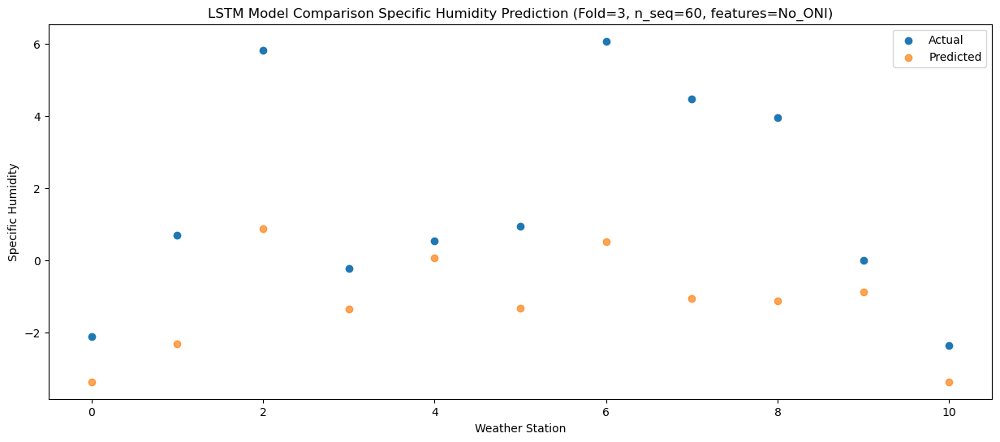

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0   -1.58  -3.129394
1                 1    1.86  -2.089394
2                 2    6.43   1.110606
3                 3    0.98  -1.109394
4                 4    1.61   0.290606
5                 5    2.24  -1.089394
6                 6    6.54   0.740606
7                 7    4.17  -0.829394
8                 8    4.89  -0.889394
9                 9    1.38  -0.639394
10               10   -0.95  -3.129394


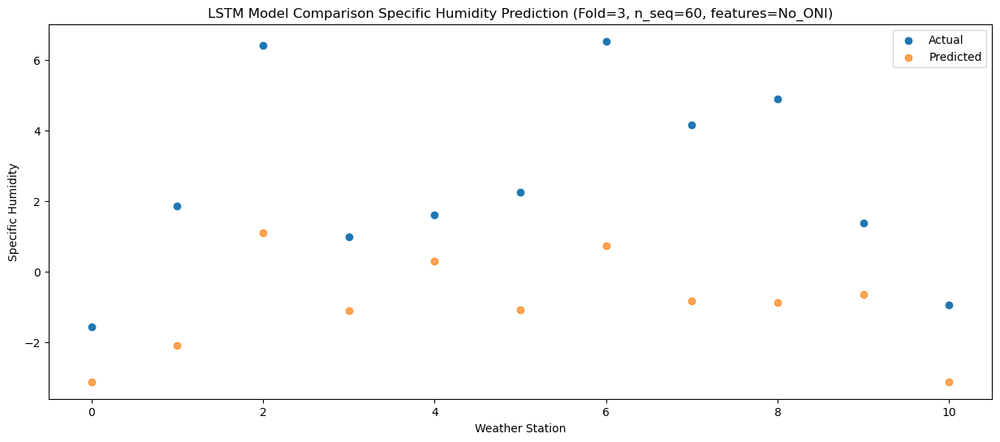

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    1.20  -1.110805
1                 1    5.38  -0.070805
2                 2    6.83   3.129195
3                 3    3.51   0.909195
4                 4    4.03   2.309195
5                 5    4.48   0.929195
6                 6    7.94   2.759195
7                 7    4.73   1.189195
8                 8    5.33   1.129195
9                 9    2.95   1.379195
10               10    0.64  -1.110805


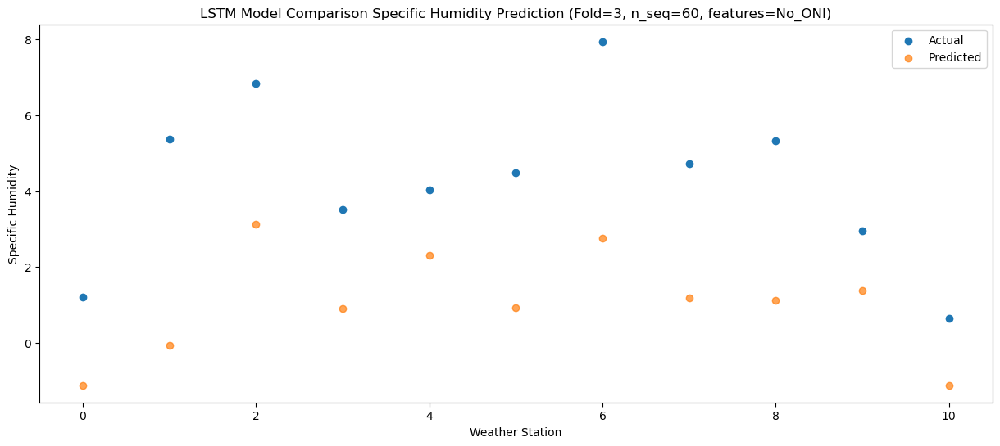

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    5.92   3.761598
1                 1    9.91   4.801598
2                 2    9.28   8.001598
3                 3    8.93   5.781598
4                 4    8.49   7.181598
5                 5    9.70   5.801598
6                 6    9.27   7.631598
7                 7    6.15   6.061598
8                 8    6.76   6.001598
9                 9    7.85   6.251598
10               10    5.51   3.761598


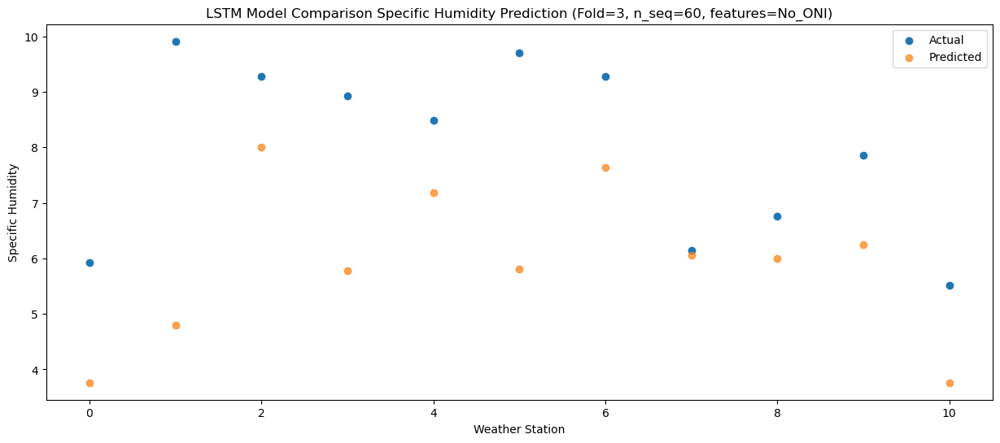

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    7.16   5.142846
1                 1   10.79   6.182846
2                 2    9.98   9.382846
3                 3    9.56   7.162846
4                 4   10.44   8.562846
5                 5   10.95   7.182846
6                 6   11.72   9.012846
7                 7   11.51   7.442846
8                 8    7.24   7.382846
9                 9   10.06   7.632846
10               10    7.20   5.142846


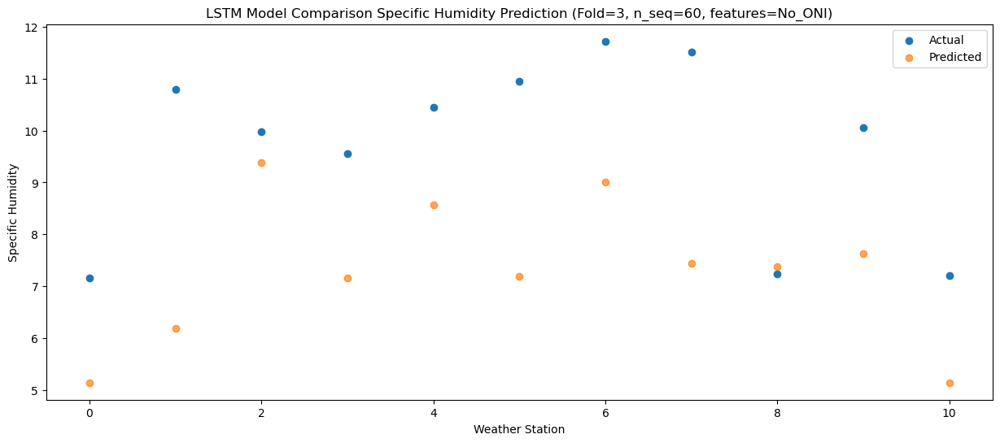

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    7.43    6.07242
1                 1   10.96    7.11242
2                 2    9.51   10.31242
3                 3   10.44    8.09242
4                 4   10.53    9.49242
5                 5   11.12    8.11242
6                 6   10.29    9.94242
7                 7    9.08    8.37242
8                 8    7.63    8.31242
9                 9   10.44    8.56242
10               10    7.52    6.07242


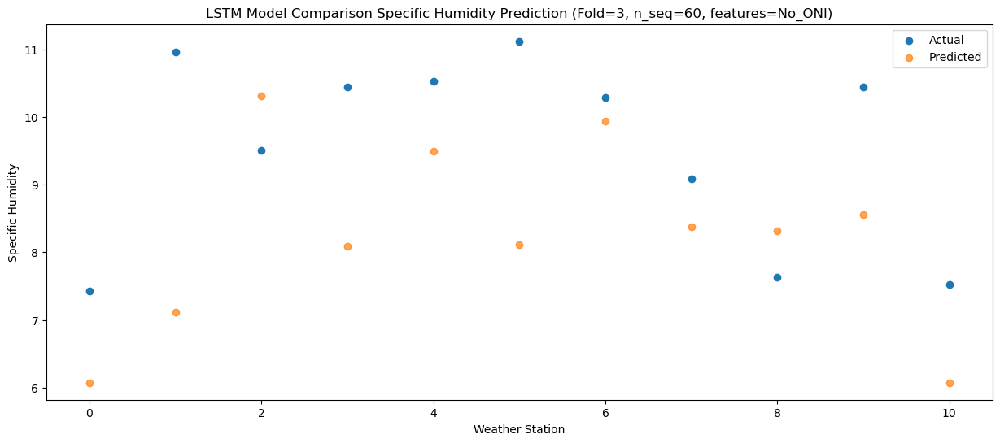

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    3.81   3.190127
1                 1    6.99   4.230127
2                 2    8.22   7.430127
3                 3    6.97   5.210127
4                 4    6.76   6.610127
5                 5    7.82   5.230127
6                 6    8.59   7.060127
7                 7    7.36   5.490127
8                 8    6.99   5.430127
9                 9    7.84   5.680127
10               10    4.60   3.190127


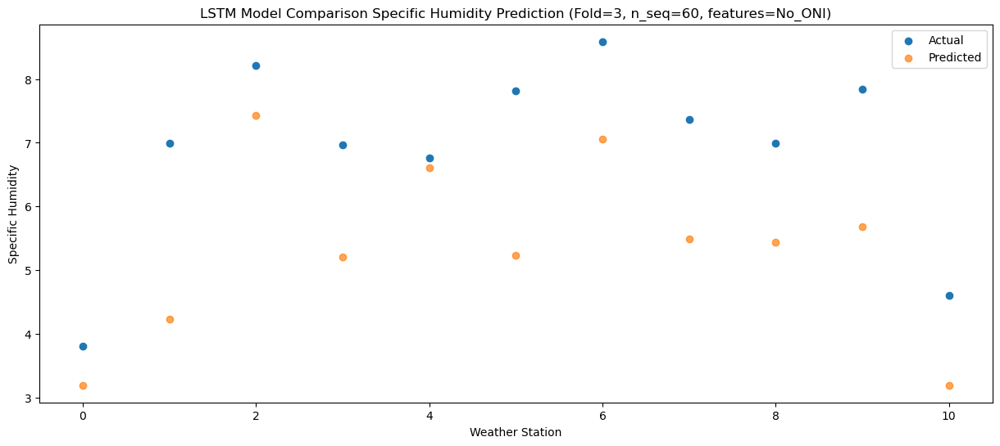

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    1.77    0.92201
1                 1    4.80    1.96201
2                 2    7.08    5.16201
3                 3    4.91    2.94201
4                 4    4.81    4.34201
5                 5    6.20    2.96201
6                 6    7.50    4.79201
7                 7    6.26    3.22201
8                 8    5.96    3.16201
9                 9    5.30    3.41201
10               10    2.70    0.92201


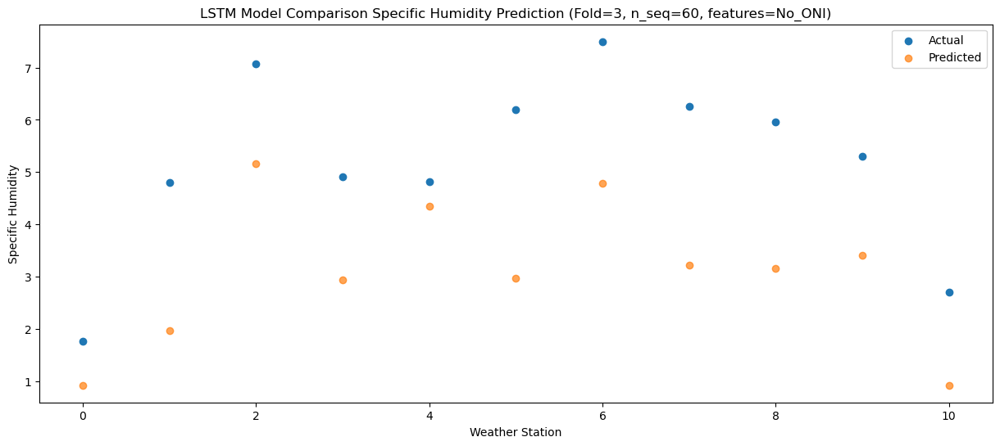

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -3.73  -4.875076
1                 1    0.37  -3.835076
2                 2    7.66  -0.635076
3                 3   -0.78  -2.855076
4                 4   -0.31  -1.455076
5                 5    0.33  -2.835076
6                 6    6.79  -1.005076
7                 7    4.99  -2.575076
8                 8    6.18  -2.635076
9                 9    0.77  -2.385076
10               10   -2.22  -4.875076


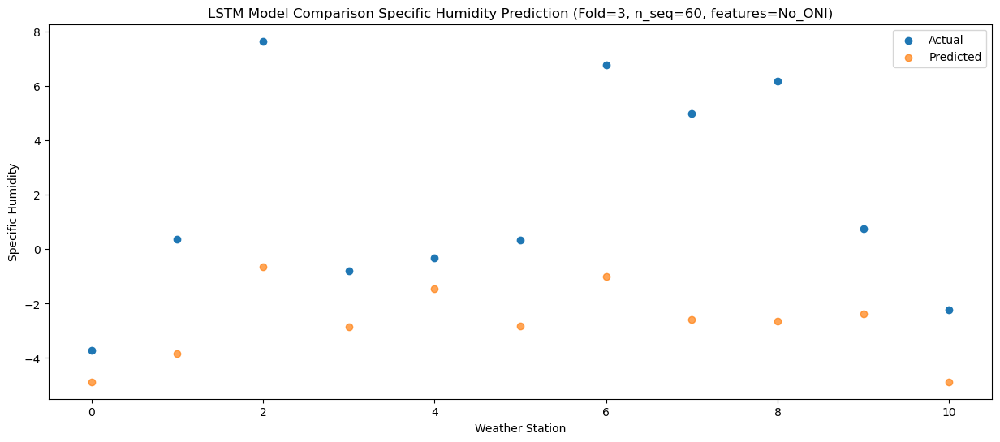

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0   -1.78  -4.160476
1                 1    1.34  -3.120476
2                 2    6.16   0.079524
3                 3    0.36  -2.140476
4                 4    0.39  -0.740476
5                 5    1.38  -2.120476
6                 6    6.08  -0.290476
7                 7    5.13  -1.860476
8                 8    4.93  -1.920476
9                 9    0.47  -1.670476
10               10   -2.32  -4.160476


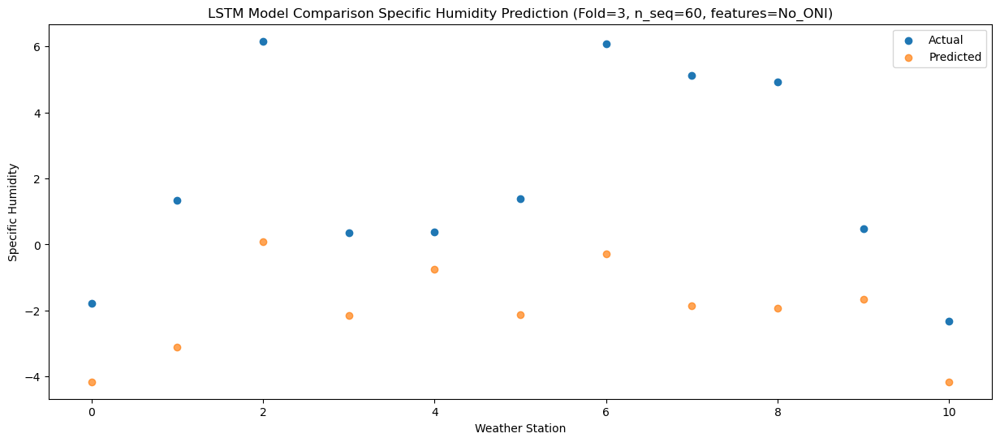

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -4.57  -6.612544
1                 1   -1.85  -5.572544
2                 2    5.88  -2.372544
3                 3   -1.96  -4.592544
4                 4   -2.07  -3.192544
5                 5   -1.13  -4.572544
6                 6    5.60  -2.742544
7                 7    4.14  -4.312544
8                 8    4.60  -4.372544
9                 9   -1.01  -4.122544
10               10   -3.83  -6.612544


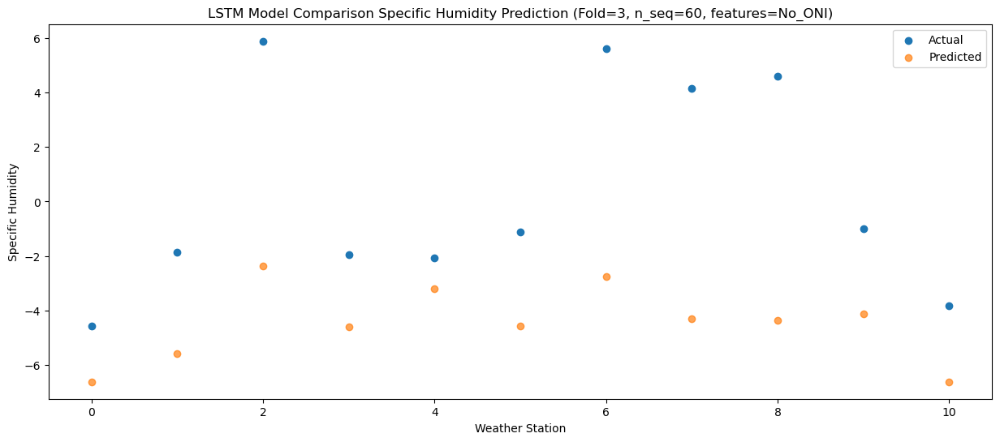

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -3.21   -6.74398
1                 1   -1.48   -5.70398
2                 2    5.10   -2.50398
3                 3   -1.44   -4.72398
4                 4   -1.45   -3.32398
5                 5   -0.60   -4.70398
6                 6    5.39   -2.87398
7                 7    3.71   -4.44398
8                 8    3.76   -4.50398
9                 9   -0.42   -4.25398
10               10   -3.13   -6.74398


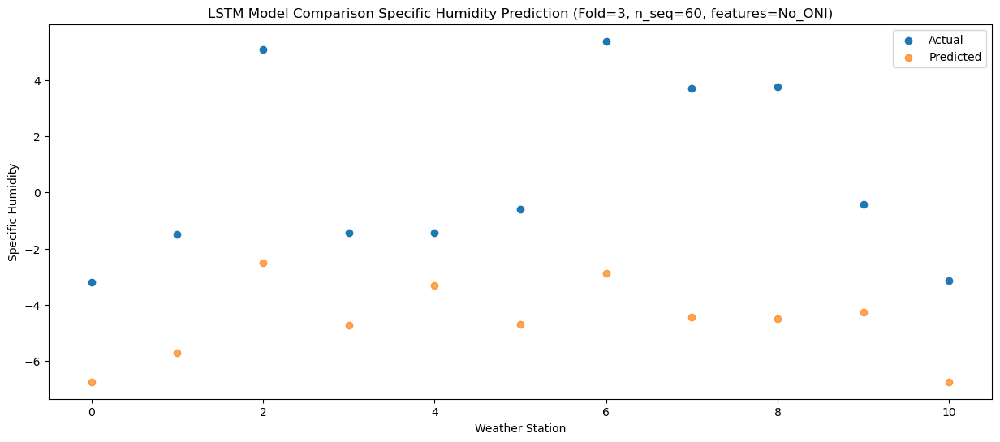

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -2.31  -5.789245
1                 1   -0.01  -4.749245
2                 2    6.44  -1.549245
3                 3   -0.46  -3.769245
4                 4    0.12  -2.369245
5                 5    0.71  -3.749245
6                 6    6.07  -1.919245
7                 7    4.33  -3.489245
8                 8    4.76  -3.549245
9                 9    0.42  -3.299245
10               10   -2.19  -5.789245


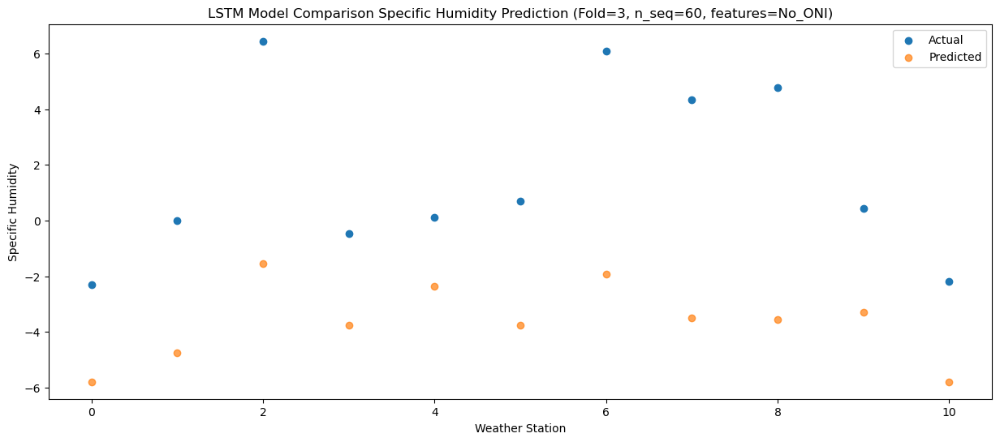

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0   -1.28  -4.467874
1                 1    2.29  -3.427874
2                 2    6.11  -0.227874
3                 3    0.81  -2.447874
4                 4    1.68  -1.047874
5                 5    2.24  -2.427874
6                 6    6.57  -0.597874
7                 7    4.33  -2.167874
8                 8    4.86  -2.227874
9                 9    1.07  -1.977874
10               10   -1.55  -4.467874


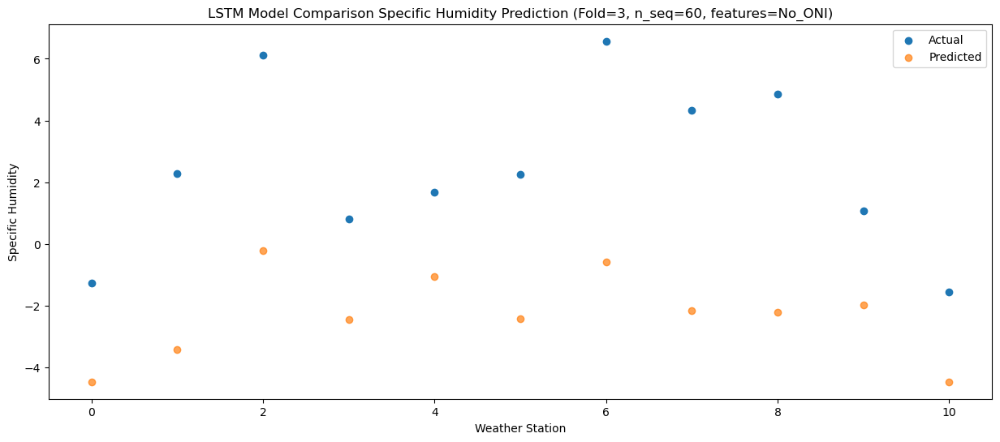

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    3.03  -0.643684
1                 1    6.74   0.396316
2                 2    6.29   3.596316
3                 3    5.23   1.376316
4                 4    5.77   2.776316
5                 5    6.47   1.396316
6                 6    7.38   3.226316
7                 7    4.59   1.656316
8                 8    5.23   1.596316
9                 9    4.46   1.846316
10               10    2.63  -0.643684


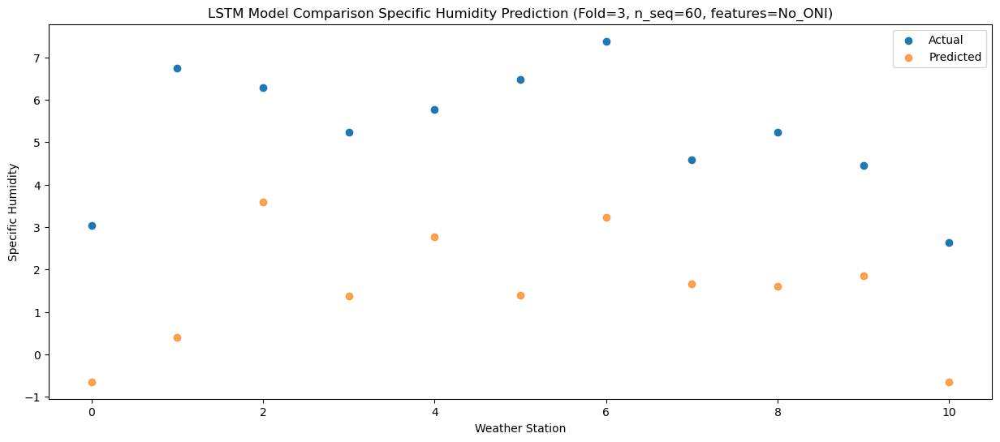

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    4.33    2.03112
1                 1    9.36    3.07112
2                 2    7.46    6.27112
3                 3    7.49    4.05112
4                 4    7.87    5.45112
5                 5    8.54    4.07112
6                 6    9.32    5.90112
7                 7    6.35    4.33112
8                 8    6.72    4.27112
9                 9    6.80    4.52112
10               10    4.03    2.03112


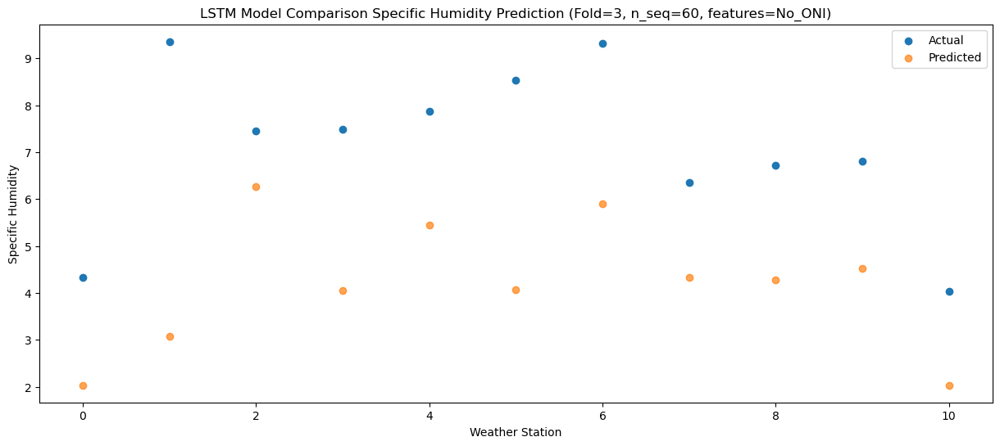

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0    8.40    3.62545
1                 1    9.57    4.66545
2                 2    8.63    7.86545
3                 3   10.53    5.64545
4                 4   10.46    7.04545
5                 5   11.32    5.66545
6                 6   12.31    7.49545
7                 7    9.78    5.92545
8                 8    7.55    5.86545
9                 9    9.96    6.11545
10               10    7.01    3.62545


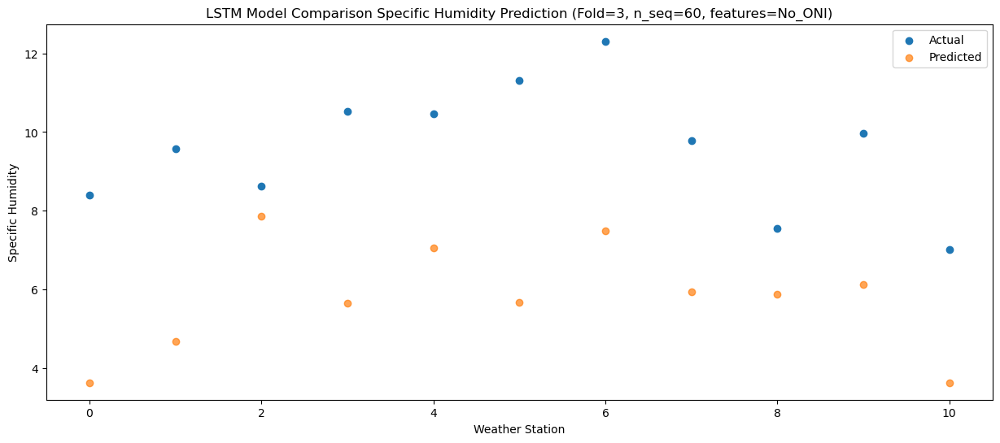

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    6.59   3.817215
1                 1   10.18   4.857215
2                 2    9.42   8.057215
3                 3    9.40   5.837215
4                 4    9.96   7.237215
5                 5   10.12   5.857215
6                 6   12.15   7.687215
7                 7   12.85   6.117215
8                 8    8.01   6.057215
9                 9   10.10   6.307215
10               10    6.64   3.817215


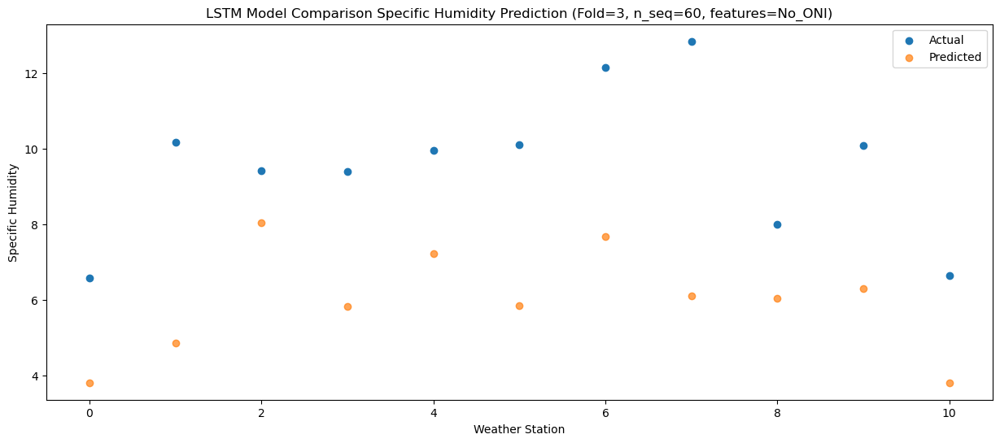

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    3.17   1.483744
1                 1    6.33   2.523744
2                 2    9.13   5.723744
3                 3    6.15   3.503744
4                 4    6.86   4.903744
5                 5    7.35   3.523744
6                 6    9.20   5.353744
7                 7    8.94   3.783744
8                 8    7.41   3.723744
9                 9    6.43   3.973744
10               10    3.62   1.483744


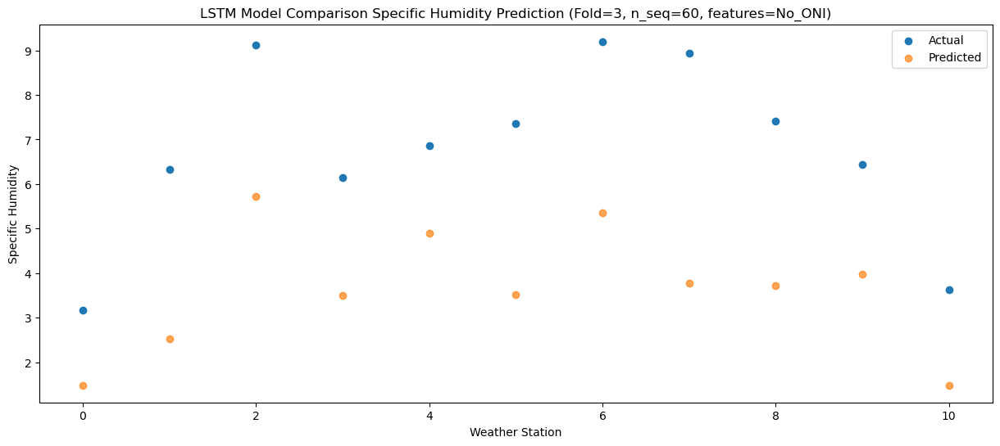

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   -1.06  -3.268191
1                 1    1.87  -2.228191
2                 2    7.96   0.971809
3                 3    1.00  -1.248191
4                 4    1.86   0.151809
5                 5    2.05  -1.228191
6                 6    7.59   0.601809
7                 7    6.21  -0.968191
8                 8    6.10  -1.028191
9                 9    3.80  -0.778191
10               10    0.20  -3.268191


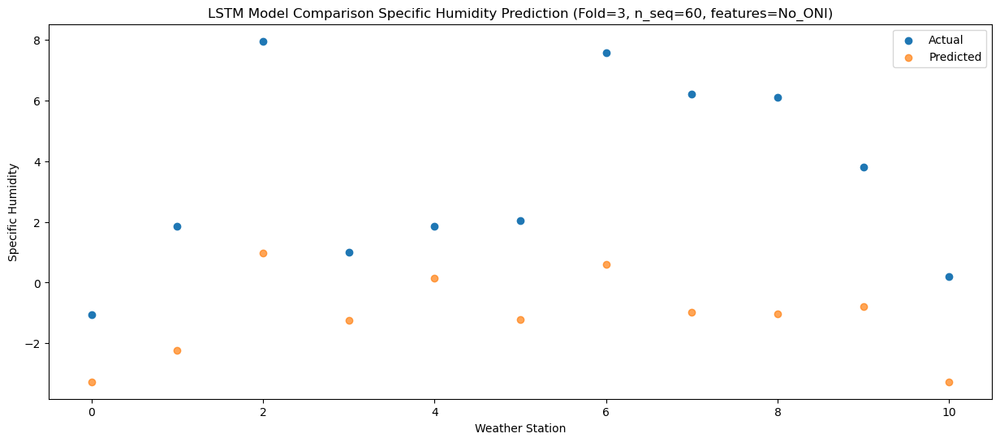

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -1.51  -5.112468
1                 1    0.84  -4.072468
2                 2    5.24  -0.872468
3                 3    0.19  -3.092468
4                 4    0.47  -1.692468
5                 5    0.83  -3.072468
6                 6    5.93  -1.242468
7                 7    4.44  -2.812468
8                 8    3.85  -2.872468
9                 9    1.95  -2.622468
10               10   -1.02  -5.112468


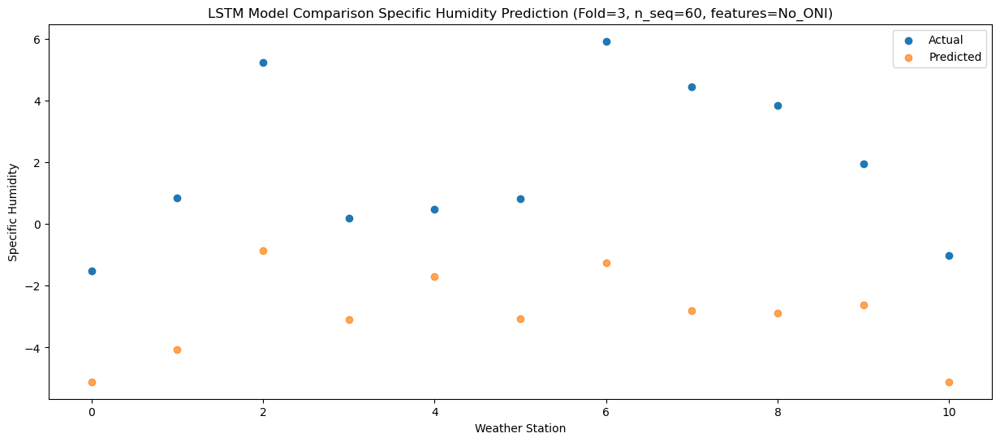

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -3.71  -6.398066
1                 1   -0.35  -5.358066
2                 2    6.08  -2.158066
3                 3   -0.84  -4.378066
4                 4   -0.65  -2.978066
5                 5    0.07  -4.358066
6                 6    5.96  -2.528066
7                 7    5.19  -4.098066
8                 8    4.64  -4.158066
9                 9   -0.02  -3.908066
10               10   -2.94  -6.398066


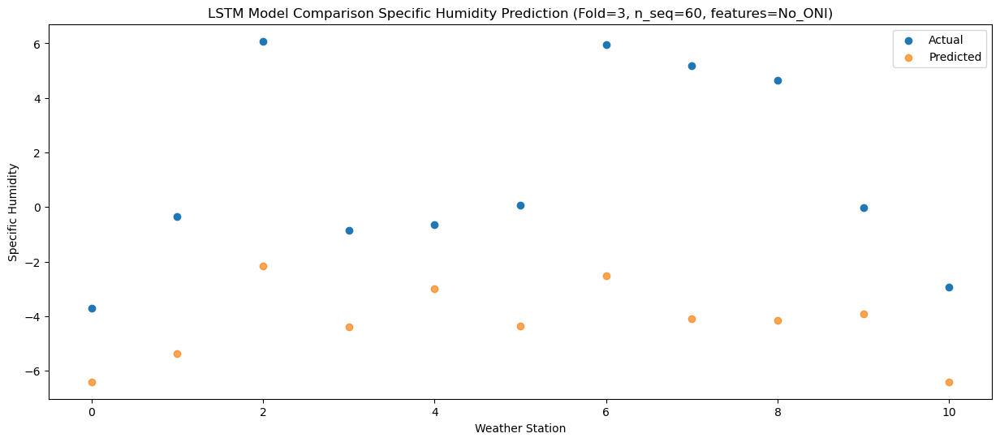

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -2.80  -5.700989
1                 1   -0.43  -4.660989
2                 2    6.23  -1.460989
3                 3   -0.30  -3.680989
4                 4   -0.27  -2.280989
5                 5    0.65  -3.660989
6                 6    5.93  -1.830989
7                 7    5.58  -3.400989
8                 8    4.47  -3.460989
9                 9    0.55  -3.210989
10               10   -2.16  -5.700989


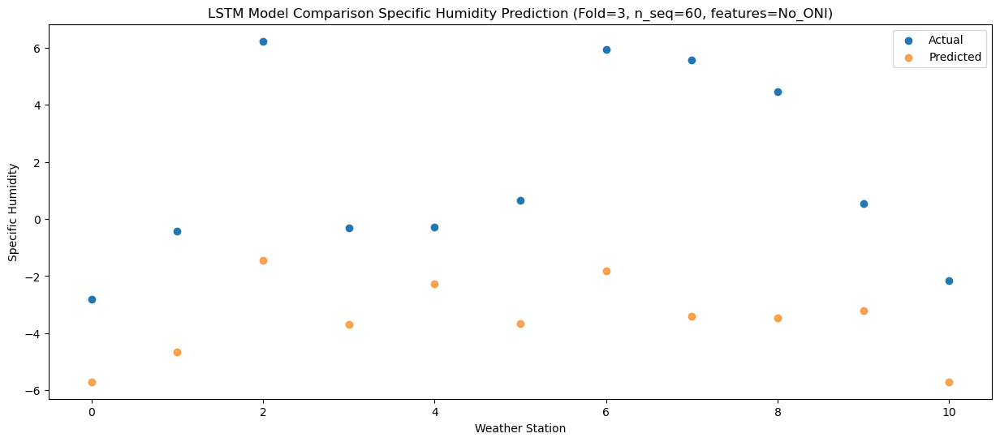

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -2.07  -6.229358
1                 1   -0.27  -5.189358
2                 2    5.10  -1.989358
3                 3   -0.48  -4.209358
4                 4    0.61  -2.809358
5                 5    0.32  -4.189358
6                 6    5.55  -2.359358
7                 7    4.33  -3.929358
8                 8    3.61  -3.989358
9                 9   -0.16  -3.739358
10               10   -2.91  -6.229358


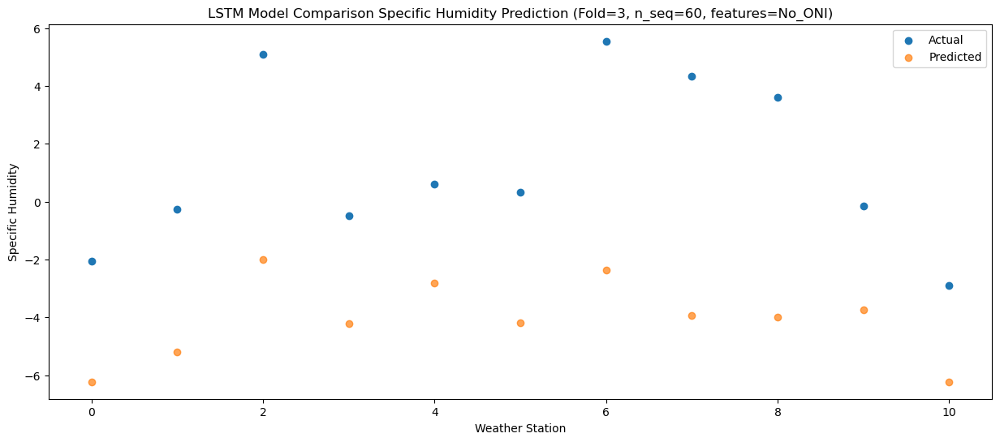

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -2.46  -6.471226
1                 1    0.67  -5.431226
2                 2    6.62  -2.231226
3                 3   -0.61  -4.451226
4                 4    0.28  -3.051226
5                 5    0.75  -4.431226
6                 6    5.85  -2.601226
7                 7    5.37  -4.171226
8                 8    4.41  -4.231226
9                 9    0.05  -3.981226
10               10   -2.78  -6.471226


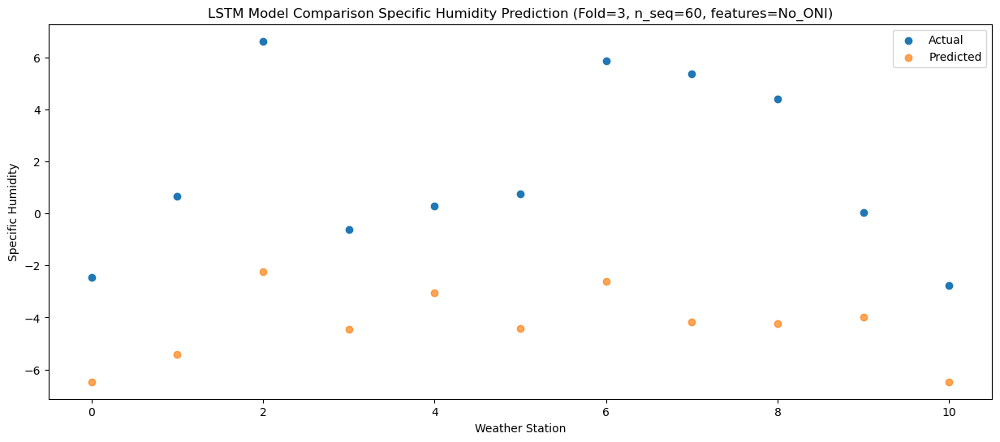

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0   -0.47  -4.585804
1                 1    1.54  -3.545804
2                 2    6.82  -0.345804
3                 3    0.93  -2.565804
4                 4    1.51  -1.165804
5                 5    2.06  -2.545804
6                 6    6.48  -0.715804
7                 7    4.52  -2.285804
8                 8    4.79  -2.345804
9                 9    2.29  -2.095804
10               10   -0.35  -4.585804


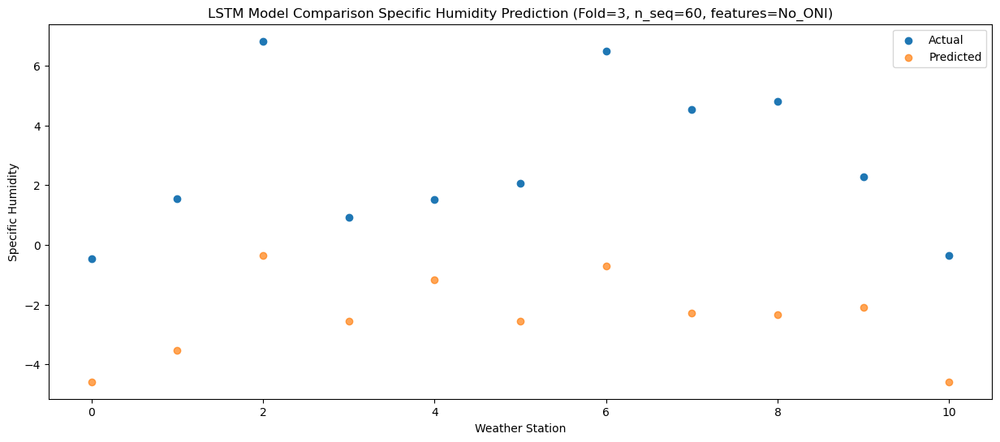

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    0.98  -4.148022
1                 1    5.95  -3.108022
2                 2    7.76   0.091978
3                 3    3.84  -2.128022
4                 4    4.69  -0.728022
5                 5    4.66  -2.108022
6                 6    8.64  -0.278022
7                 7    6.06  -1.848022
8                 8    6.38  -1.908022
9                 9    2.81  -1.658022
10               10    0.12  -4.148022


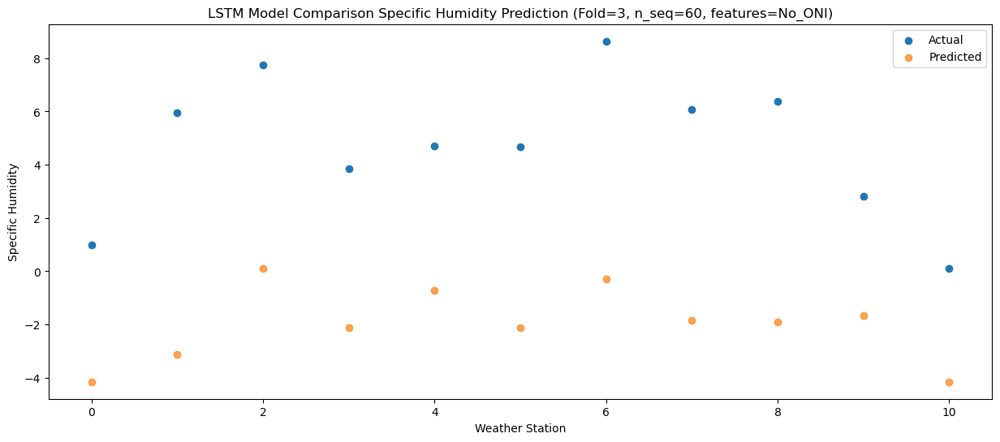

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    4.25   0.170163
1                 1    8.59   1.210163
2                 2    8.53   4.410163
3                 3    5.86   2.190163
4                 4    6.82   3.590163
5                 5    6.82   2.210163
6                 6    8.87   4.040163
7                 7    6.56   2.470163
8                 8    6.44   2.410163
9                 9    6.51   2.660163
10               10    3.81   0.170163


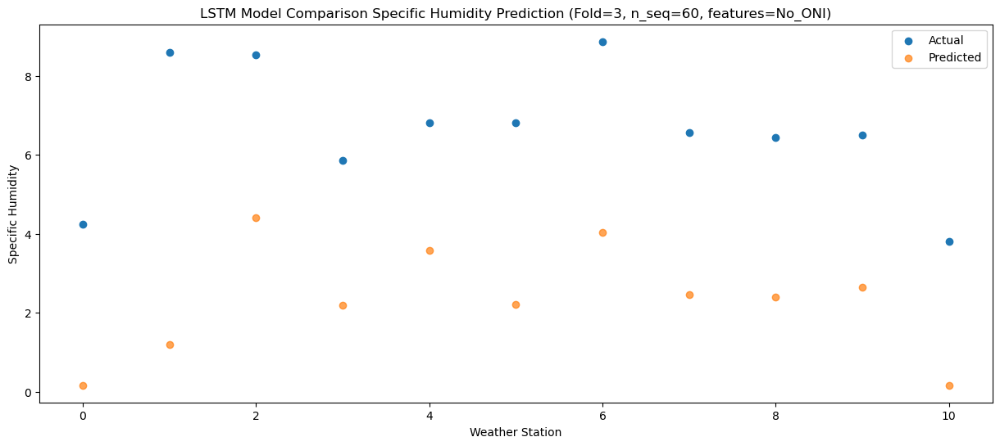

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0    8.20   3.457176
1                 1   10.86   4.497176
2                 2    9.63   7.697176
3                 3    9.51   5.477176
4                 4   10.59   6.877176
5                 5   11.33   5.497176
6                 6    9.71   7.327176
7                 7    7.53   5.757176
8                 8    7.28   5.697176
9                 9   11.36   5.947176
10               10    7.79   3.457176


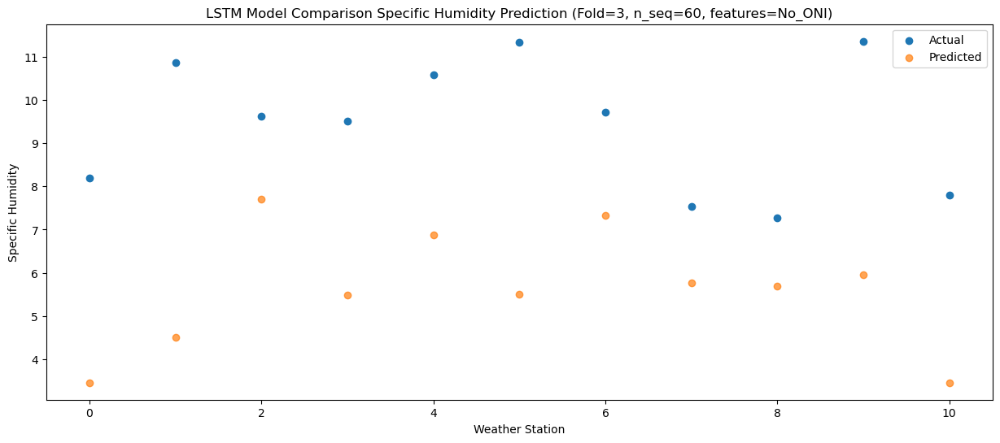

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    7.30   2.022911
1                 1   11.10   3.062911
2                 2   10.70   6.262911
3                 3    8.96   4.042911
4                 4   10.98   5.442911
5                 5   10.45   4.062911
6                 6   11.36   5.892911
7                 7   10.11   4.322911
8                 8    8.55   4.262911
9                 9    8.79   4.512911
10               10    6.55   2.022911


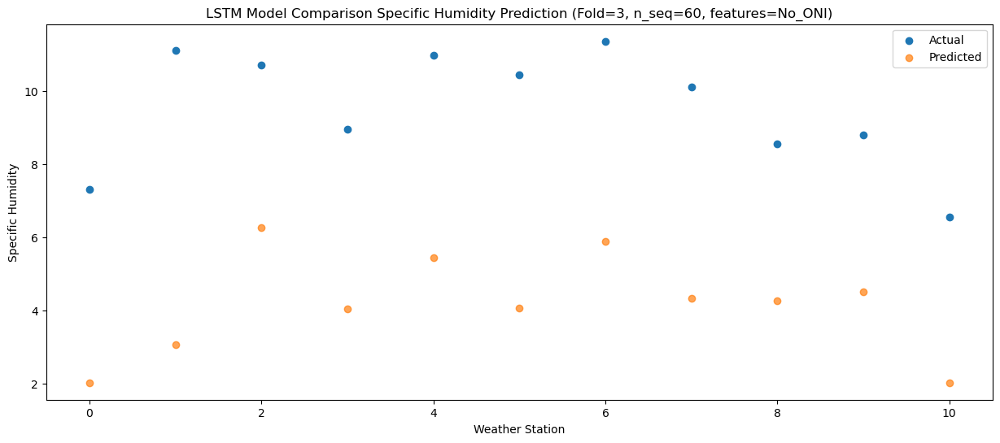

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    4.39   0.531112
1                 1    7.03   1.571112
2                 2    9.16   4.771112
3                 3    6.49   2.551112
4                 4    6.87   3.951112
5                 5    7.22   2.571112
6                 6    8.74   4.401112
7                 7    9.17   2.831112
8                 8    8.00   2.771112
9                 9    7.82   3.021112
10               10    4.86   0.531112


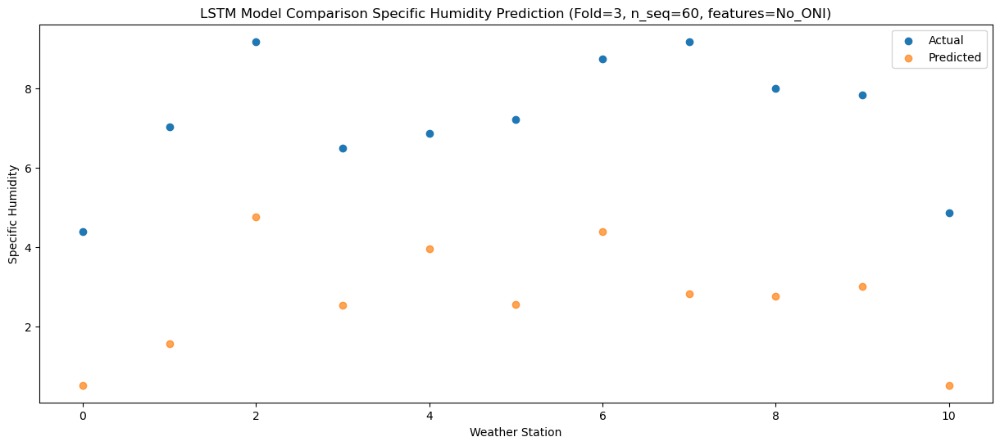

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    0.28  -2.808049
1                 1    3.59  -1.768049
2                 2    8.00   1.431951
3                 3    2.96  -0.788049
4                 4    3.25   0.611951
5                 5    3.84  -0.768049
6                 6    7.49   1.061951
7                 7    6.11  -0.508049
8                 8    6.57  -0.568049
9                 9    4.43  -0.318049
10               10    1.59  -2.808049


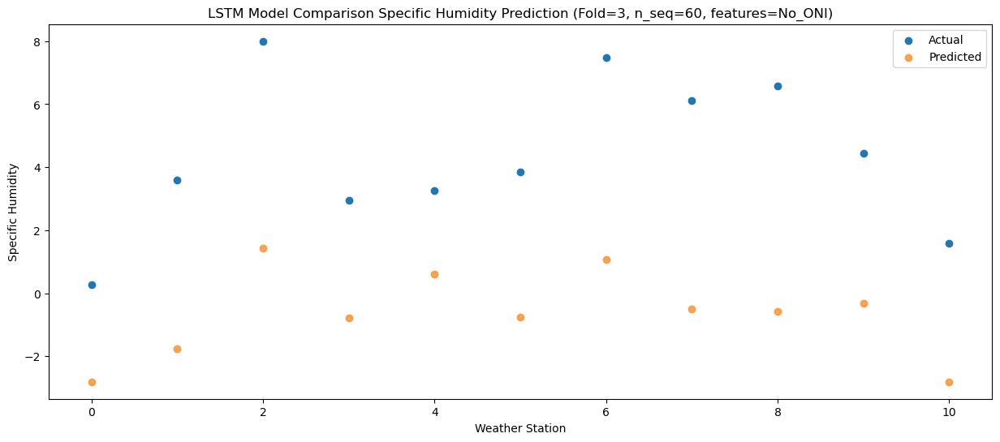

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -2.95  -5.569204
1                 1    0.71  -4.529204
2                 2    5.89  -1.329204
3                 3   -0.43  -3.549204
4                 4    0.08  -2.149204
5                 5    0.65  -3.529204
6                 6    6.16  -1.699204
7                 7    5.10  -3.269204
8                 8    5.48  -3.329204
9                 9    0.63  -3.079204
10               10   -2.09  -5.569204


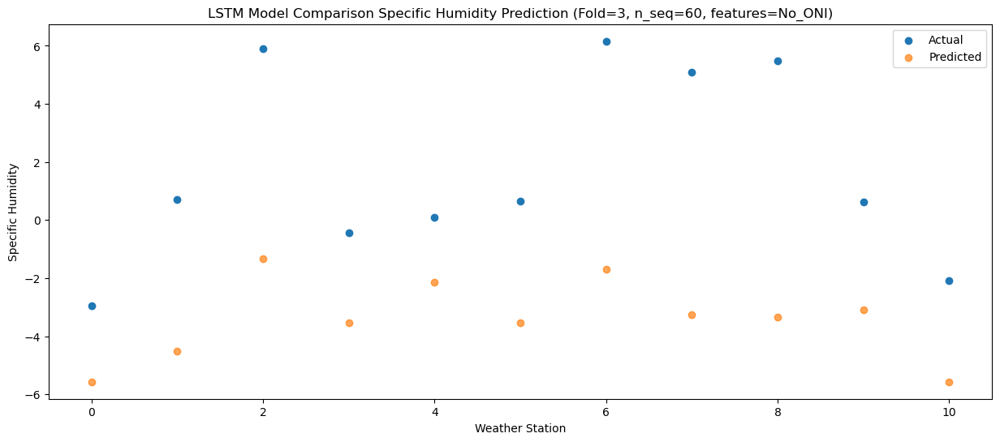

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -2.96  -5.963469
1                 1   -0.11  -4.923469
2                 2    6.12  -1.723469
3                 3   -0.41  -3.943469
4                 4   -0.33  -2.543469
5                 5    0.61  -3.923469
6                 6    6.03  -2.093469
7                 7    5.02  -3.663469
8                 8    5.86  -3.723469
9                 9    0.96  -3.473469
10               10   -1.71  -5.963469


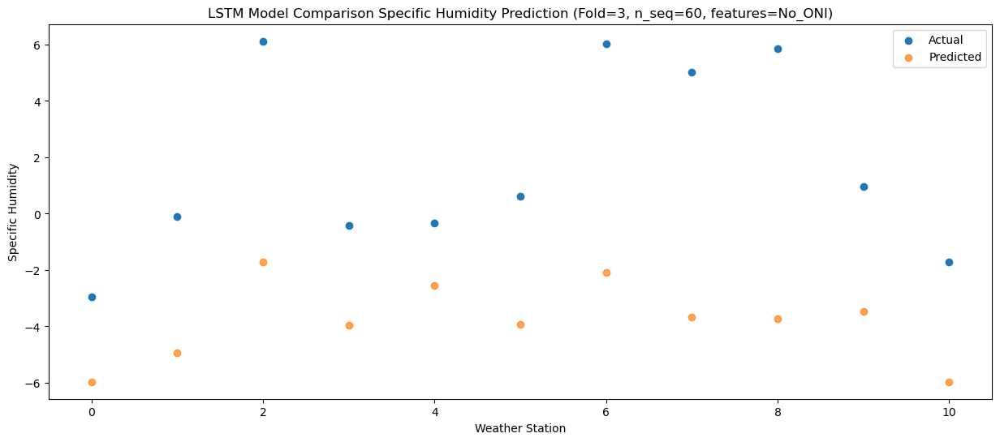

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -3.61  -6.694747
1                 1   -1.42  -5.654747
2                 2    6.66  -2.454747
3                 3   -1.15  -4.674747
4                 4   -1.20  -3.274747
5                 5   -0.27  -4.654747
6                 6    5.97  -2.824747
7                 7    5.56  -4.394747
8                 8    5.87  -4.454747
9                 9   -0.34  -4.204747
10               10   -2.84  -6.694747


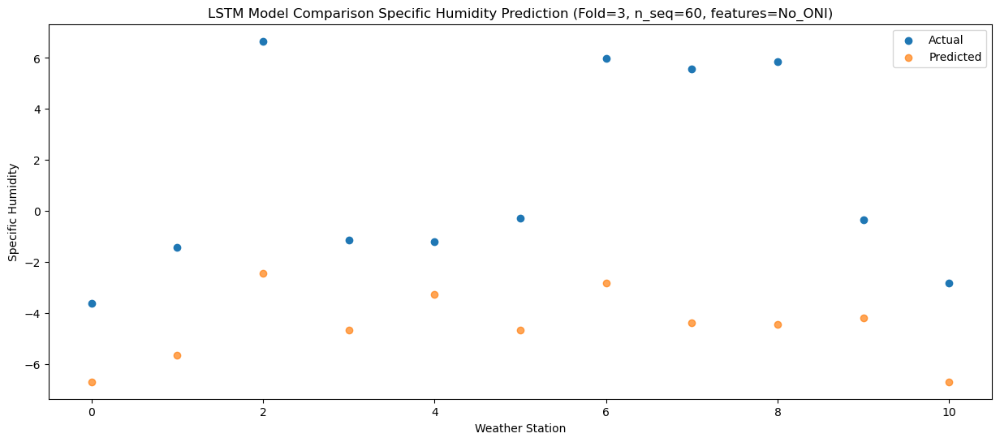

Predictions for (t+51):
    Weather_Station        Actual  Predicted
0                 0 -3.550000e+00  -6.797074
1                 1 -3.552714e-15  -5.757074
2                 2  6.830000e+00  -2.557074
3                 3 -8.300000e-01  -4.777074
4                 4 -2.900000e-01  -3.377074
5                 5  3.100000e-01  -4.757074
6                 6  6.040000e+00  -2.927074
7                 7  6.380000e+00  -4.497074
8                 8  5.560000e+00  -4.557074
9                 9 -4.400000e-01  -4.307074
10               10 -2.930000e+00  -6.797074


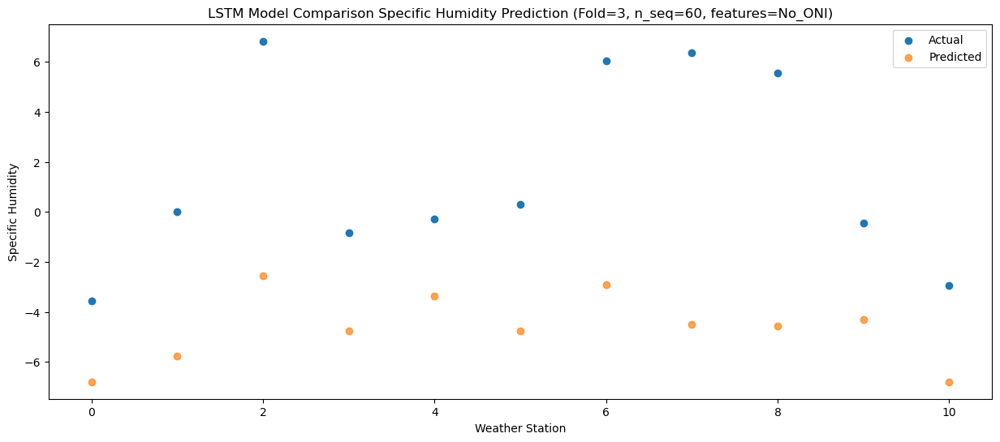

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -2.05  -6.497204
1                 1    1.42  -5.457204
2                 2    6.54  -2.257204
3                 3    0.13  -4.477204
4                 4    0.75  -3.077204
5                 5    1.39  -4.457204
6                 6    6.40  -2.627204
7                 7    5.70  -4.197204
8                 8    5.36  -4.257204
9                 9    0.61  -4.007204
10               10   -1.88  -6.497204


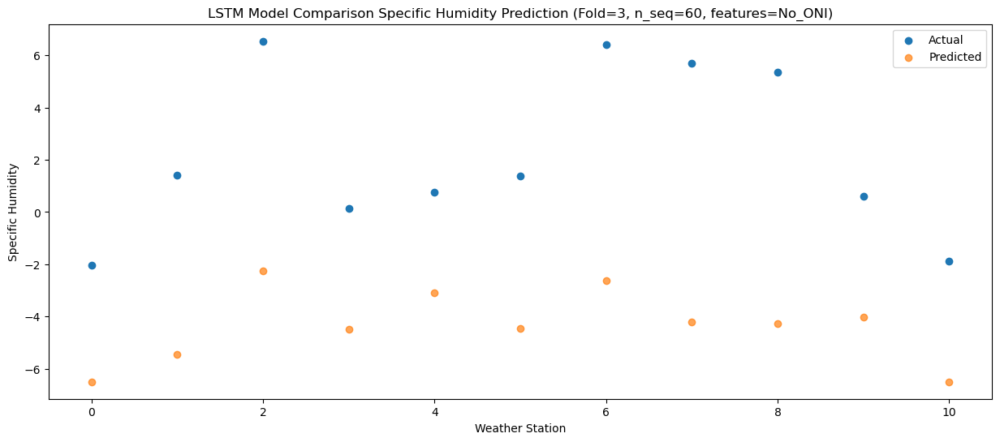

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   -0.01  -5.464204
1                 1    2.96  -4.424204
2                 2    7.22  -1.224204
3                 3    2.04  -3.444204
4                 4    2.57  -2.044204
5                 5    3.64  -3.424204
6                 6    7.08  -1.594204
7                 7    5.40  -3.164204
8                 8    5.80  -3.224204
9                 9    1.52  -2.974204
10               10   -0.28  -5.464204


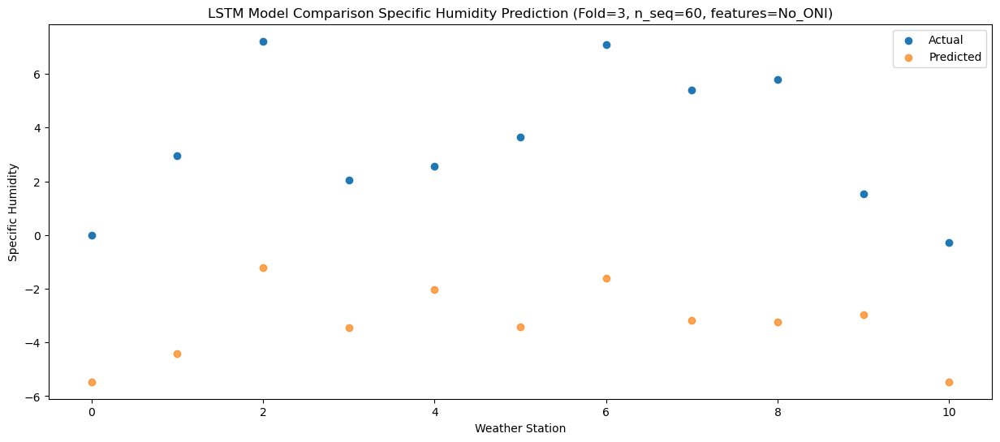

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    3.86  -2.397984
1                 1    7.46  -1.357984
2                 2    7.09   1.842016
3                 3    6.15  -0.377984
4                 4    6.71   1.022016
5                 5    7.31  -0.357984
6                 6    7.97   1.472016
7                 7    5.27  -0.097984
8                 8    5.96  -0.157984
9                 9    4.98   0.092016
10               10    3.35  -2.397984


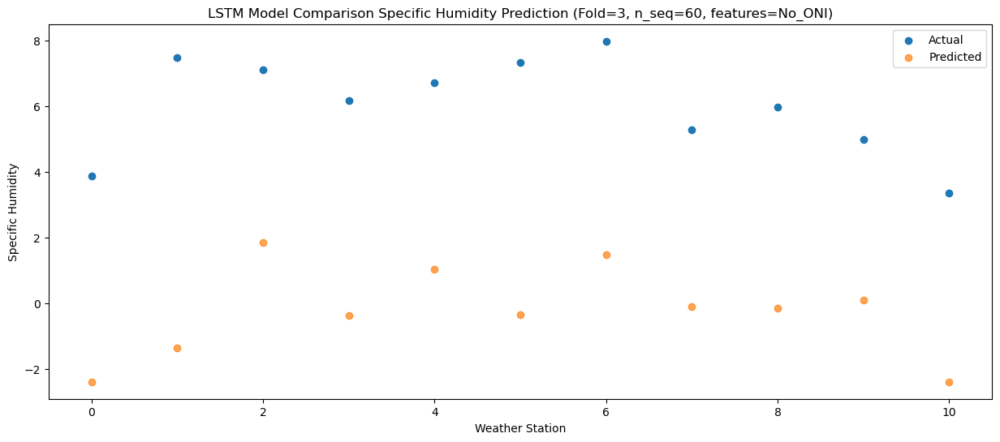

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    5.59  -0.194687
1                 1    9.74   0.845313
2                 2    8.36   4.045313
3                 3    7.95   1.825313
4                 4    8.68   3.225313
5                 5    9.13   1.845313
6                 6   10.26   3.675313
7                 7    6.67   2.105313
8                 8    7.11   2.045313
9                 9    7.85   2.295313
10               10    5.03  -0.194687


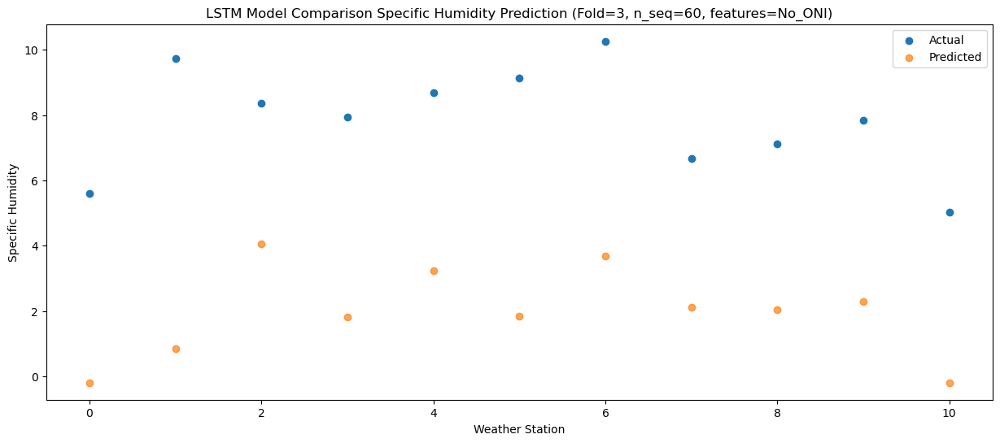

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0    8.45   2.381256
1                 1   10.23   3.421256
2                 2   10.34   6.621256
3                 3    8.85   4.401256
4                 4   10.25   5.801256
5                 5   10.32   4.421256
6                 6   10.31   6.251256
7                 7    7.70   4.681256
8                 8    8.69   4.621256
9                 9   11.02   4.871256
10               10    7.91   2.381256


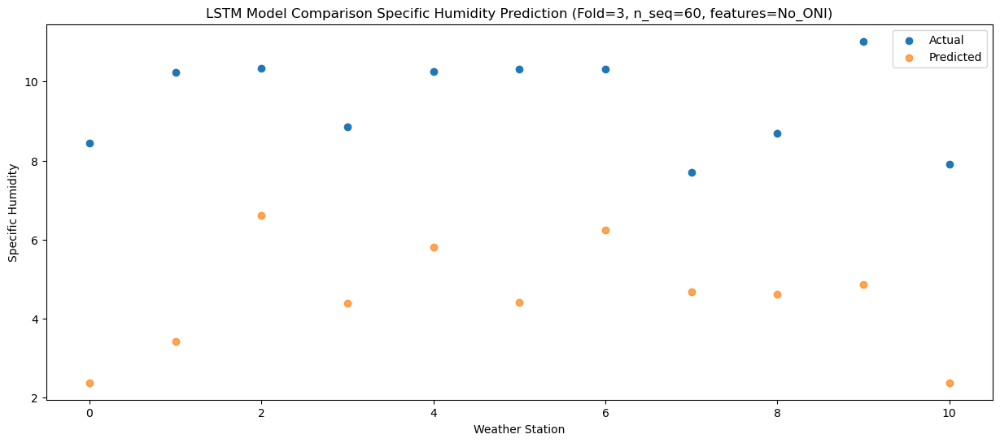

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    7.01   0.296651
1                 1    9.49   1.336651
2                 2    8.65   4.536651
3                 3    7.53   2.316651
4                 4    9.77   3.716651
5                 5    9.76   2.336651
6                 6   11.77   4.166651
7                 7    8.52   2.596651
8                 8    7.96   2.536651
9                 9    9.67   2.786651
10               10    6.63   0.296651


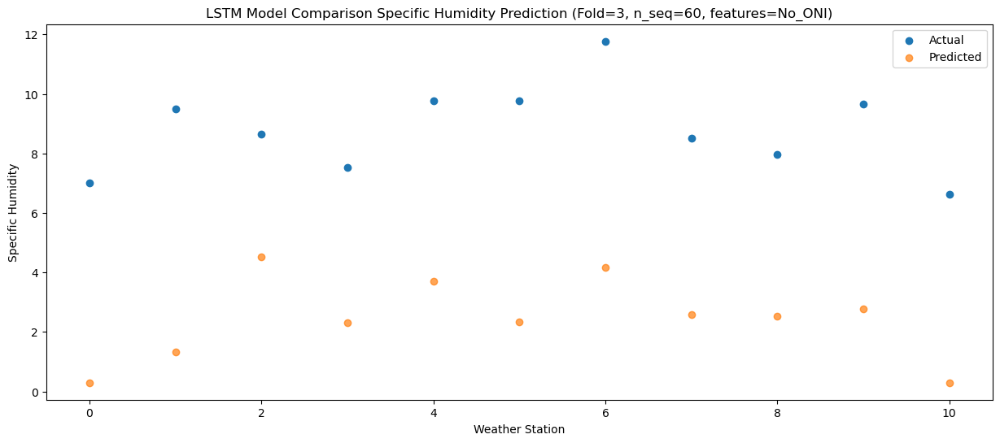

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    5.30  -1.047903
1                 1    6.50  -0.007903
2                 2    8.92   3.192097
3                 3    5.99   0.972097
4                 4    6.76   2.372097
5                 5    7.14   0.992097
6                 6    9.35   2.822097
7                 7    6.80   1.252097
8                 8    7.64   1.192097
9                 9    6.31   1.442097
10               10    3.81  -1.047903


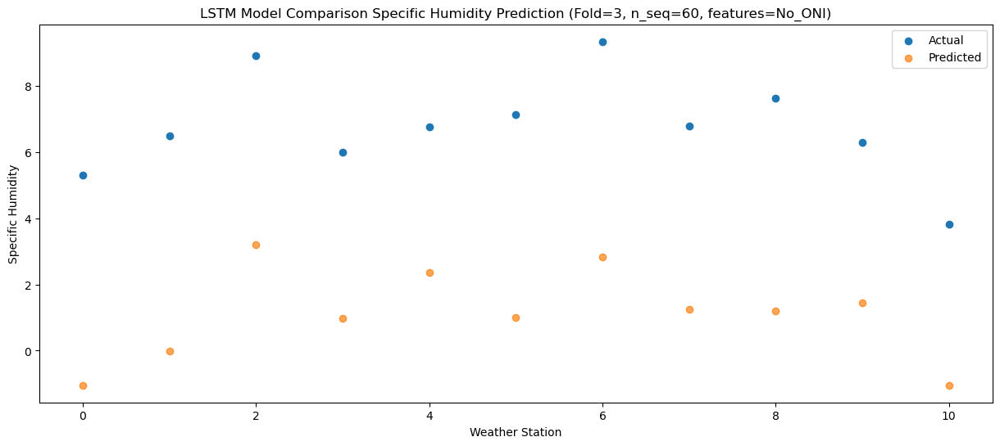

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    0.48  -3.907104
1                 1    2.27  -2.867104
2                 2    7.81   0.332896
3                 3    2.24  -1.887104
4                 4    2.40  -0.487104
5                 5    3.27  -1.867104
6                 6    7.59  -0.037104
7                 7    5.75  -1.607104
8                 8    6.05  -1.667104
9                 9    3.21  -1.417104
10               10   -0.19  -3.907104


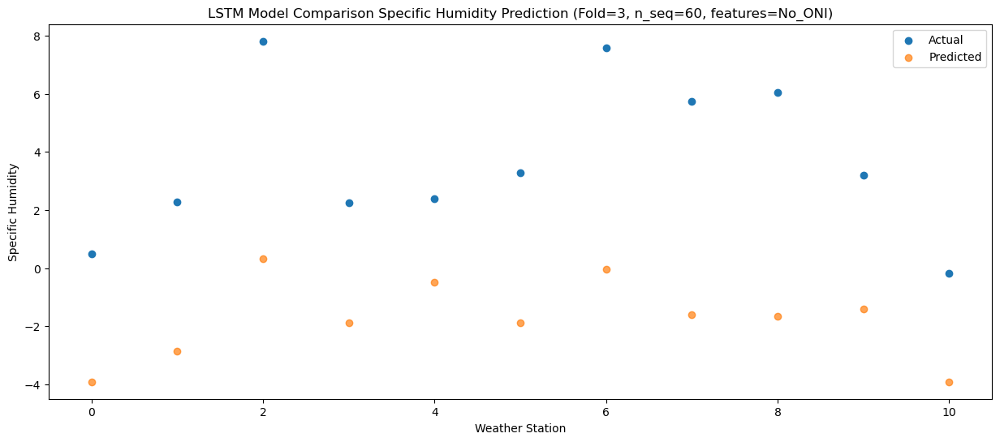

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_6 (LSTM)               (1, 1, 256)               2121728   
                                                                 
 dropout_6 (Dropout)         (1, 1, 256)               0         
                                                                 
 lstm_7 (LSTM)               (1, 256)                  525312    
                                                                 
 dropout_7 (Dropout)         (1, 256)                  0         
                                                                 
 dense_9 (Dense)             (1, 256)                  65792     
                                                                 
 dense_10 (Dense)            (1, 128)                  32896     
                                                                 
 dense_11 (Dense)            (1, 60)                  

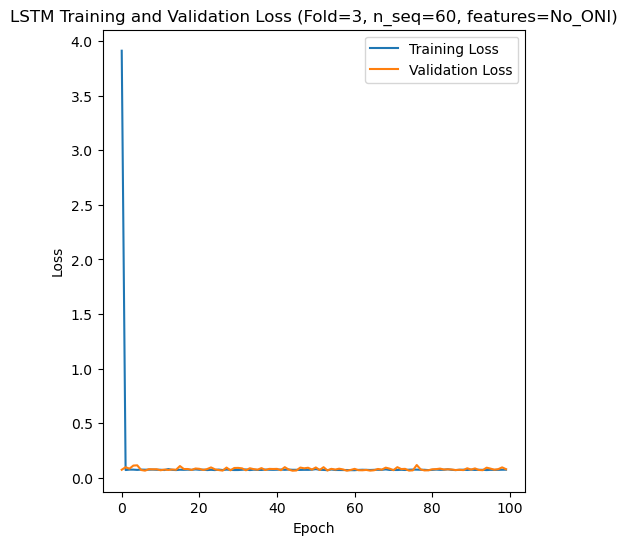

Epoch 1/100
84/84 [==============================] - 6s 26ms/step - loss: 3.2122 - accuracy: 0.2500 - mae: 2.8930 - rmse: 3.2122 - mape: 636.9850 - pearson: 0.4855 - val_loss: 0.0660 - val_accuracy: 0.0000e+00 - val_mae: 0.0512 - val_rmse: 0.0660 - val_mape: 12.2835 - val_pearson: 0.7723
Epoch 2/100
84/84 [==============================] - 1s 10ms/step - loss: 0.0799 - accuracy: 0.1905 - mae: 0.0621 - rmse: 0.0799 - mape: 14.3636 - pearson: 0.7118 - val_loss: 0.0783 - val_accuracy: 0.2000 - val_mae: 0.0607 - val_rmse: 0.0783 - val_mape: 14.2896 - val_pearson: 0.6760
Epoch 3/100
84/84 [==============================] - 1s 10ms/step - loss: 0.0763 - accuracy: 0.3810 - mae: 0.0603 - rmse: 0.0763 - mape: 13.6106 - pearson: 0.7244 - val_loss: 0.0707 - val_accuracy: 0.2000 - val_mae: 0.0572 - val_rmse: 0.0707 - val_mape: 12.4013 - val_pearson: 0.7699
Epoch 4/100
84/84 [==============================] - 1s 10ms/step - loss: 0.0780 - accuracy: 0.3571 - mae: 0.0611 - rmse: 0.0780 - mape: 13.784

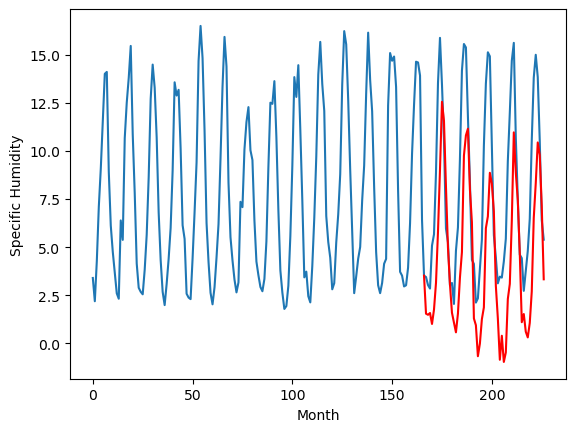

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.36		0.24		1.60
-1.22		0.19		1.41
-2.78		0.28		3.06
-1.94		-0.29		1.65
-0.56		0.46		1.02
0.65		1.85		1.20
1.30		4.50		3.20
4.63		7.72		3.09
6.37		11.26		4.89
6.61		10.26		3.65
6.03		6.83		0.80
3.99		3.68		-0.31
0.93		1.77		0.84
-3.81		0.30		4.11
-3.46		-0.22		3.24
-1.47		-0.72		0.75
-1.50		0.25		1.75
-0.75		2.11		2.86
0.58		3.45		2.87
4.87		8.46		3.59
6.08		9.51		3.43
6.47		9.86		3.39
5.67		6.70		1.03
2.75		5.00		2.25
-1.91		-0.00		1.91
-0.17		-0.36		-0.19
-4.03		-1.97		2.06
-2.45		-1.31		1.14
-0.92		-0.04		0.88
0.37		0.57		0.20
2.76		4.69		1.93
5.66		5.30		-0.36
6.69		7.57		0.88
6.77		7.00		0.23
5.90		5.56		-0.34
1.12		1.69		0.57
1.29		0.00		-1.29
-2.23		-2.15		0.08
-2.74		-0.90		1.84
-0.80		-2.26		-1.46
-0.42		-1.77		-1.35
1.07		1.01		-0.06
1.87		1.79		-0.08
5.38		5.08		-0.30
7.29		9.67		2.38
7.59		7.58		-0.01
5.14		6.14		1.00
1.52		3.36		1.84
-0.78		-0.20		0.58
-1.87		0.23		2.10
-2.91		-

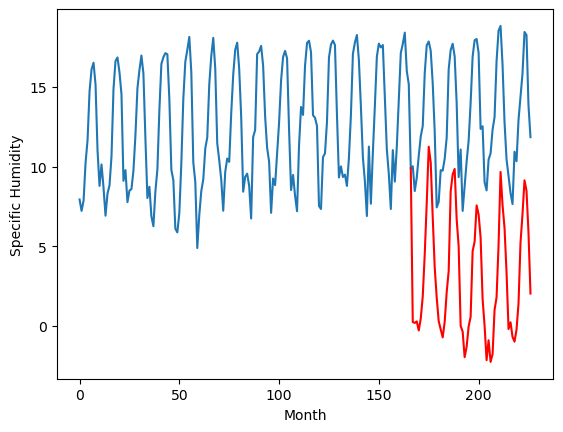

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.06		0.30		1.36
-0.22		0.25		0.47
-0.36		0.34		0.70
-0.55		-0.23		0.32
3.00		0.52		-2.48
1.88		1.91		0.03
4.12		4.56		0.44
7.42		7.78		0.36
10.35		11.32		0.97
8.84		10.32		1.48
6.79		6.89		0.10
3.44		3.74		0.30
0.77		1.83		1.06
-1.61		0.36		1.97
-1.72		-0.16		1.56
-1.84		-0.66		1.18
1.22		0.31		-0.91
1.47		2.17		0.70
4.91		3.51		-1.40
9.15		8.52		-0.63
10.80		9.57		-1.23
10.81		9.92		-0.89
7.87		6.76		-1.11
5.09		5.06		-0.03
-0.35		0.06		0.41
2.60		-0.30		-2.90
-2.13		-1.91		0.22
-1.28		-1.25		0.03
-0.23		0.02		0.25
2.22		0.63		-1.59
6.82		4.75		-2.07
9.20		5.36		-3.84
11.04		7.63		-3.41
10.86		7.06		-3.80
6.62		5.62		-1.00
1.66		1.75		0.09
0.91		0.06		-0.85
0.37		-2.09		-2.46
0.27		-0.84		-1.11
0.94		-2.20		-3.14
1.27		-1.71		-2.98
2.11		1.07		-1.04
5.49		1.85		-3.64
9.06		5.14		-3.92
10.65		9.73		-0.92
9.07		7.64		-1.43
6.05		6.20		0.15
2.12		3.42		1.30
0.14		-0.14		-0.28
-1.17		0.29		1.4

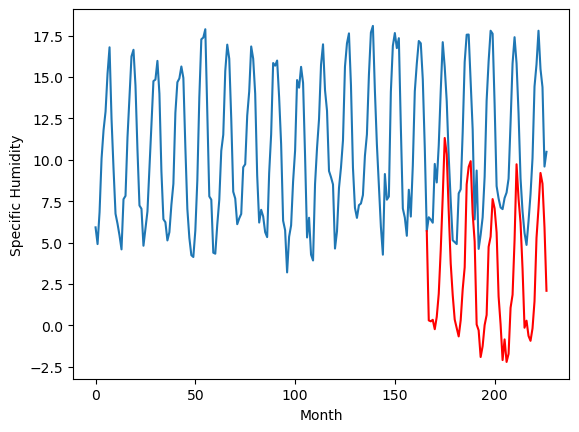

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.12		0.16		-0.96
0.12		0.11		-0.01
0.76		0.20		-0.56
0.14		-0.37		-0.51
4.09		0.38		-3.71
3.69		1.77		-1.92
6.85		4.42		-2.43
9.01		7.64		-1.37
12.24		11.18		-1.06
9.65		10.18		0.53
8.44		6.75		-1.69
3.87		3.60		-0.27
2.23		1.69		-0.54
-0.37		0.22		0.59
-0.48		-0.30		0.18
-0.80		-0.80		-0.00
1.86		0.17		-1.69
3.15		2.03		-1.12
7.15		3.37		-3.78
10.84		8.38		-2.46
11.41		9.43		-1.98
11.80		9.78		-2.02
7.79		6.62		-1.17
4.94		4.92		-0.02
1.32		-0.08		-1.40
3.18		-0.44		-3.62
-1.48		-2.05		-0.57
-0.95		-1.39		-0.44
0.64		-0.12		-0.76
4.15		0.49		-3.66
8.14		4.61		-3.53
9.91		5.22		-4.69
9.33		7.49		-1.84
10.34		6.92		-3.42
7.06		5.48		-1.58
2.60		1.61		-0.99
2.42		-0.08		-2.50
0.84		-2.23		-3.07
0.15		-0.98		-1.13
0.51		-2.34		-2.85
2.57		-1.85		-4.42
3.25		0.93		-2.32
7.51		1.71		-5.80
11.45		5.00		-6.45
11.30		9.59		-1.71
9.20		7.50		-1.70
8.30		6.06		-2.24
4.58		3.28		-1.30
2.05		-0.28		-2.3

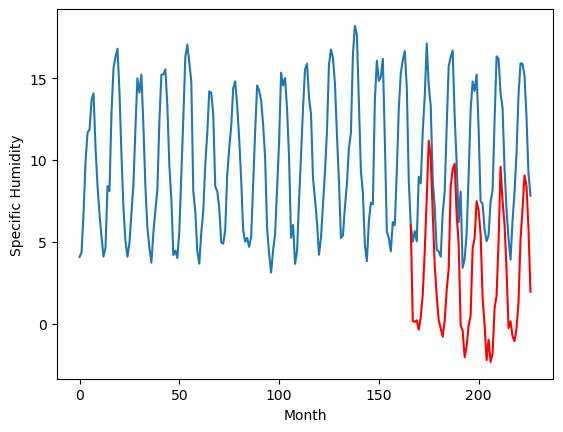

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.61		-0.28		-0.89
-0.36		-0.33		0.03
0.33		-0.24		-0.57
-0.33		-0.81		-0.48
3.57		-0.06		-3.63
3.06		1.33		-1.73
6.30		3.98		-2.32
8.28		7.20		-1.08
11.43		10.74		-0.69
8.78		9.74		0.96
7.89		6.31		-1.58
3.12		3.16		0.04
1.76		1.25		-0.51
-0.81		-0.22		0.59
-0.85		-0.74		0.11
-1.30		-1.24		0.06
1.28		-0.27		-1.55
2.64		1.59		-1.05
6.93		2.93		-4.00
10.81		7.94		-2.87
11.19		8.99		-2.20
11.30		9.34		-1.96
7.40		6.18		-1.22
4.67		4.48		-0.19
1.06		-0.52		-1.58
2.47		-0.88		-3.35
-1.86		-2.49		-0.63
-1.42		-1.83		-0.41
0.10		-0.56		-0.66
3.78		0.05		-3.73
7.66		4.17		-3.49
9.34		4.78		-4.56
8.84		7.05		-1.79
10.01		6.48		-3.53
6.86		5.04		-1.82
2.40		1.17		-1.23
1.98		-0.52		-2.50
0.39		-2.67		-3.06
-0.36		-1.42		-1.06
0.04		-2.78		-2.82
2.01		-2.29		-4.30
2.86		0.49		-2.37
7.13		1.27		-5.86
10.61		4.56		-6.05
9.71		9.15		-0.56
8.33		7.06		-1.27
8.00		5.62		-2.38
4.34		2.84		-1.50
1.92		-0.72		

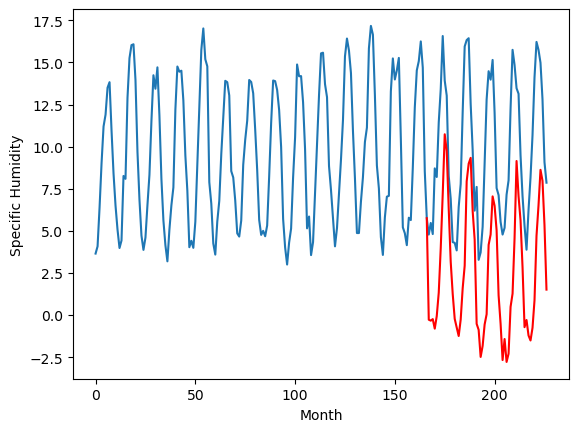

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
6.92		4.26		-2.66
5.68		4.21		-1.47
5.56		4.30		-1.26
5.44		3.73		-1.71
8.24		4.48		-3.76
7.49		5.87		-1.62
9.76		8.52		-1.24
11.47		11.74		0.27
12.70		15.28		2.58
11.39		14.28		2.89
11.20		10.85		-0.35
7.55		7.70		0.15
7.09		5.79		-1.30
4.53		4.32		-0.21
5.23		3.80		-1.43
4.59		3.30		-1.29
6.08		4.27		-1.81
7.04		6.13		-0.91
11.59		7.47		-4.12
13.89		12.48		-1.41
14.92		13.53		-1.39
14.64		13.88		-0.76
11.39		10.72		-0.67
8.34		9.02		0.68
6.62		4.02		-2.60
5.77		3.66		-2.11
4.31		2.05		-2.26
4.30		2.71		-1.59
4.89		3.98		-0.91
6.92		4.59		-2.33
9.18		8.71		-0.47
12.03		9.32		-2.71
12.72		11.59		-1.13
14.71		11.02		-3.69
13.46		9.58		-3.88
9.95		5.71		-4.24
7.25		4.02		-3.23
6.61		1.87		-4.74
5.06		3.12		-1.94
5.18		1.76		-3.42
6.47		2.25		-4.22
6.44		5.03		-1.41
11.28		5.81		-5.47
15.14		9.10		-6.04
12.81		13.69		0.88
11.95		11.60		-0.35
12.46		10.16		-2.30
10.33		7.38		-2.95
8.03		3.82		-4.

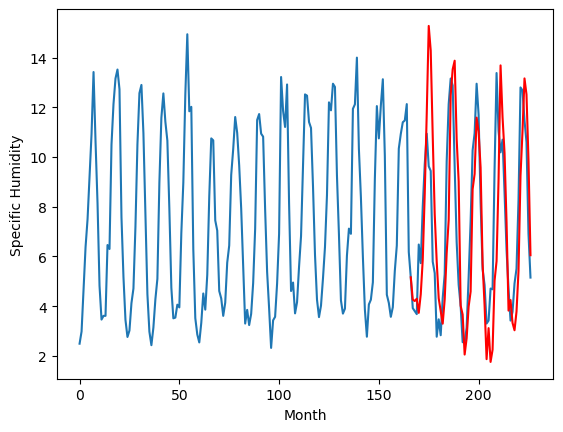

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.46		2.24		1.78
0.53		2.19		1.66
0.37		2.28		1.91
0.95		1.71		0.76
3.14		2.46		-0.68
2.47		3.85		1.38
5.59		6.50		0.91
9.42		9.72		0.30
12.01		13.26		1.25
12.22		12.26		0.04
8.38		8.83		0.45
5.73		5.68		-0.05
2.90		3.77		0.87
-0.44		2.30		2.74
-0.56		1.78		2.34
-0.31		1.28		1.59
1.40		2.25		0.85
1.81		4.11		2.30
4.79		5.45		0.66
9.48		10.46		0.98
11.08		11.51		0.43
11.46		11.86		0.40
7.88		8.70		0.82
5.67		7.00		1.33
-0.05		2.00		2.05
1.81		1.64		-0.17
-1.17		0.03		1.20
0.15		0.69		0.54
0.99		1.96		0.97
2.05		2.57		0.52
6.06		6.69		0.63
8.34		7.30		-1.04
11.50		9.57		-1.93
10.31		9.00		-1.31
6.76		7.56		0.80
2.08		3.69		1.61
1.90		2.00		0.10
-0.09		-0.15		-0.06
0.54		1.10		0.56
1.58		-0.26		-1.84
1.07		0.23		-0.84
2.67		3.01		0.34
4.89		3.79		-1.10
7.94		7.08		-0.86
11.33		11.67		0.34
10.87		9.58		-1.29
7.42		8.14		0.72
3.51		5.36		1.85
0.56		1.80		1.24
0.28		2.23		1.95
-0.50		1.31		1.81
-0.

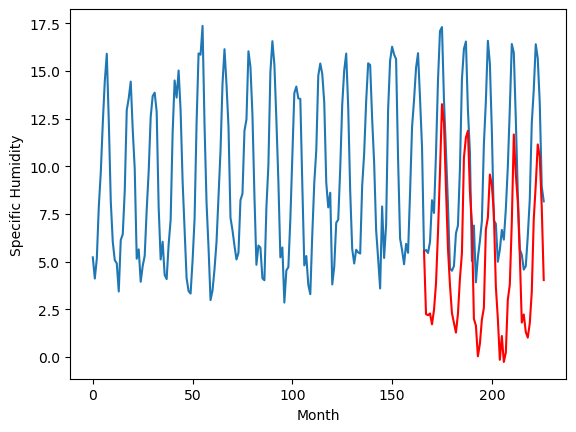

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.67		0.40		-0.27
0.40		0.35		-0.05
0.16		0.44		0.28
-0.07		-0.13		-0.06
2.48		0.62		-1.86
2.80		2.01		-0.79
6.18		4.66		-1.52
9.79		7.88		-1.91
11.84		11.42		-0.42
9.19		10.42		1.23
7.59		6.99		-0.60
3.04		3.84		0.80
1.37		1.93		0.56
-0.56		0.46		1.02
-0.71		-0.06		0.65
-1.34		-0.56		0.78
1.03		0.41		-0.62
1.95		2.27		0.32
5.11		3.61		-1.50
9.71		8.62		-1.09
10.66		9.67		-0.99
10.40		10.02		-0.38
7.14		6.86		-0.28
5.05		5.16		0.11
0.36		0.16		-0.20
1.83		-0.20		-2.03
-1.37		-1.81		-0.44
-0.86		-1.15		-0.29
0.65		0.12		-0.53
2.44		0.73		-1.71
7.15		4.85		-2.30
9.51		5.46		-4.05
10.31		7.73		-2.58
10.78		7.16		-3.62
6.97		5.72		-1.25
2.31		1.85		-0.46
0.95		0.16		-0.79
0.08		-1.99		-2.07
0.36		-0.74		-1.10
0.17		-2.10		-2.27
0.93		-1.61		-2.54
1.83		1.17		-0.66
6.22		1.95		-4.27
8.78		5.24		-3.54
11.57		9.83		-1.74
11.85		7.74		-4.11
7.65		6.30		-1.35
4.04		3.52		-0.52
1.01		-0.04		-1.05
0.20	

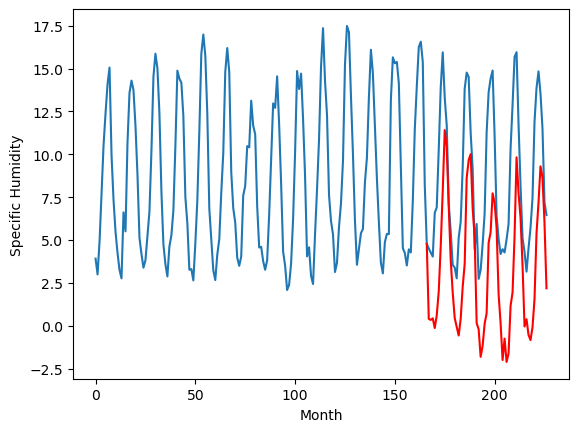

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.13		-0.03		-0.16
0.30		-0.08		-0.38
-0.07		0.01		0.08
-0.47		-0.56		-0.09
1.45		0.19		-1.26
1.73		1.58		-0.15
4.88		4.23		-0.65
7.62		7.45		-0.17
10.84		10.99		0.15
9.17		9.99		0.82
6.25		6.56		0.31
2.87		3.41		0.54
1.19		1.50		0.31
-0.41		0.03		0.44
-0.76		-0.49		0.27
-1.33		-0.99		0.34
0.61		-0.02		-0.63
1.94		1.84		-0.10
4.23		3.18		-1.05
9.29		8.19		-1.10
10.55		9.24		-1.31
10.69		9.59		-1.10
7.21		6.43		-0.78
6.06		4.73		-1.33
0.29		-0.27		-0.56
1.00		-0.63		-1.63
-1.38		-2.24		-0.86
-0.80		-1.58		-0.78
0.51		-0.31		-0.82
2.00		0.30		-1.70
6.02		4.42		-1.60
7.46		5.03		-2.43
10.20		7.30		-2.90
9.84		6.73		-3.11
7.18		5.29		-1.89
1.85		1.42		-0.43
0.81		-0.27		-1.08
-0.15		-2.42		-2.27
0.47		-1.17		-1.64
0.07		-2.53		-2.60
0.42		-2.04		-2.46
1.87		0.74		-1.13
4.12		1.52		-2.60
6.08		4.81		-1.27
10.38		9.40		-0.98
9.84		7.31		-2.53
7.04		5.87		-1.17
3.71		3.09		-0.62
0.64		-0.47		-1.11
0

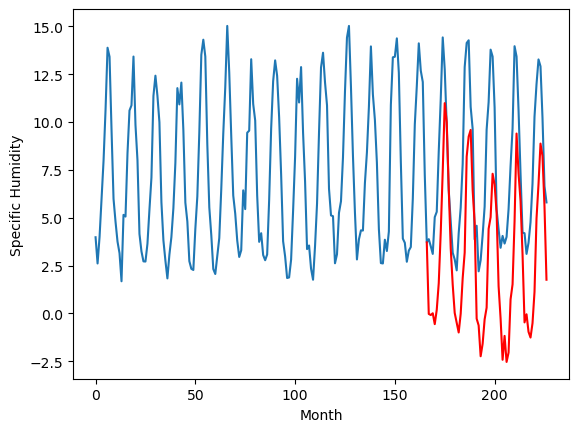

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.54		-1.19		-0.65
-0.37		-1.24		-0.87
-0.85		-1.15		-0.30
-1.12		-1.72		-0.60
0.93		-0.97		-1.90
1.52		0.42		-1.10
5.24		3.07		-2.17
7.72		6.29		-1.43
11.28		9.83		-1.45
9.09		8.83		-0.26
6.31		5.40		-0.91
2.15		2.25		0.10
1.06		0.34		-0.72
-0.85		-1.13		-0.28
-1.17		-1.65		-0.48
-1.81		-2.15		-0.34
0.56		-1.18		-1.74
1.87		0.68		-1.19
4.49		2.02		-2.47
9.24		7.03		-2.21
10.64		8.08		-2.56
10.89		8.43		-2.46
6.86		5.27		-1.59
4.99		3.57		-1.42
-0.30		-1.43		-1.13
0.24		-1.79		-2.03
-2.00		-3.40		-1.40
-1.30		-2.74		-1.44
0.22		-1.47		-1.69
1.52		-0.86		-2.38
5.59		3.26		-2.33
7.83		3.87		-3.96
10.47		6.14		-4.33
9.70		5.57		-4.13
6.33		4.13		-2.20
1.57		0.26		-1.31
0.20		-1.43		-1.63
-0.91		-3.58		-2.67
-0.39		-2.33		-1.94
-0.62		-3.69		-3.07
-0.01		-3.20		-3.19
1.50		-0.42		-1.92
4.28		0.36		-3.92
5.92		3.65		-2.27
10.62		8.24		-2.38
10.49		6.15		-4.34
6.71		4.71		-2.00
3.27		1.93		-1.34


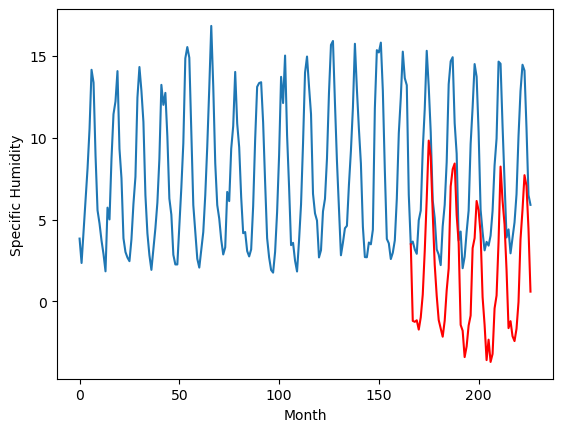

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.53		1.54		0.01
1.68		1.49		-0.19
1.34		1.58		0.24
0.99		1.01		0.02
2.56		1.76		-0.80
2.40		3.15		0.75
5.02		5.80		0.78
8.21		9.02		0.81
11.13		12.56		1.43
9.71		11.56		1.85
7.57		8.13		0.56
4.53		4.98		0.45
2.60		3.07		0.47
1.27		1.60		0.33
0.89		1.08		0.19
0.32		0.58		0.26
1.61		1.55		-0.06
3.28		3.41		0.13
4.88		4.75		-0.13
9.89		9.76		-0.13
11.16		10.81		-0.35
12.03		11.16		-0.87
8.27		8.00		-0.27
7.26		6.30		-0.96
2.02		1.30		-0.72
1.98		0.94		-1.04
0.24		-0.67		-0.91
0.69		-0.01		-0.70
1.84		1.26		-0.58
2.83		1.87		-0.96
6.29		5.99		-0.30
8.20		6.60		-1.60
9.93		8.87		-1.06
10.39		8.30		-2.09
8.40		6.86		-1.54
3.58		2.99		-0.59
2.86		1.30		-1.56
1.41		-0.85		-2.26
2.03		0.40		-1.63
1.28		-0.96		-2.24
1.49		-0.47		-1.96
3.19		2.31		-0.88
4.09		3.09		-1.00
7.33		6.38		-0.95
10.95		10.97		0.02
10.15		8.88		-1.27
8.44		7.44		-1.00
5.38		4.66		-0.72
1.94		1.10		-0.84
2.46		1.53		-0.93
1.39

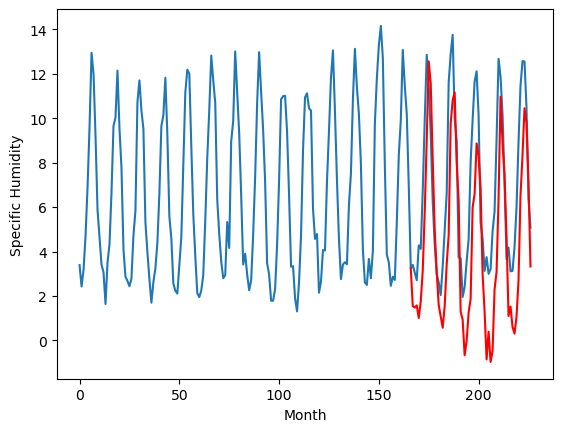

RangeIndex(start=1, stop=12, step=1)
[2.3299999999999996, -1.3599999999999994, -1.06, 1.1199999999999997, 0.6100000000000012, 6.92, 0.45999999999999996, 0.6700000000000013, 0.1299999999999999, -0.5399999999999991, 1.529999999999999]
[1.543456525802612, 0.24345652580261223, 0.3034565258026123, 0.16345652580261216, -0.2765434741973878, 4.263456525802613, 2.2434565258026122, 0.4034565258026124, -0.026543474197387784, -1.1865434741973875, 1.543456525802612]
Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    2.33   1.543457
1                 1   -1.36   0.243457
2                 2   -1.06   0.303457
3                 3    1.12   0.163457
4                 4    0.61  -0.276543
5                 5    6.92   4.263457
6                 6    0.46   2.243457
7                 7    0.67   0.403457
8                 8    0.13  -0.026543
9                 9   -0.54  -1.186543
10               10    1.53   1.543457


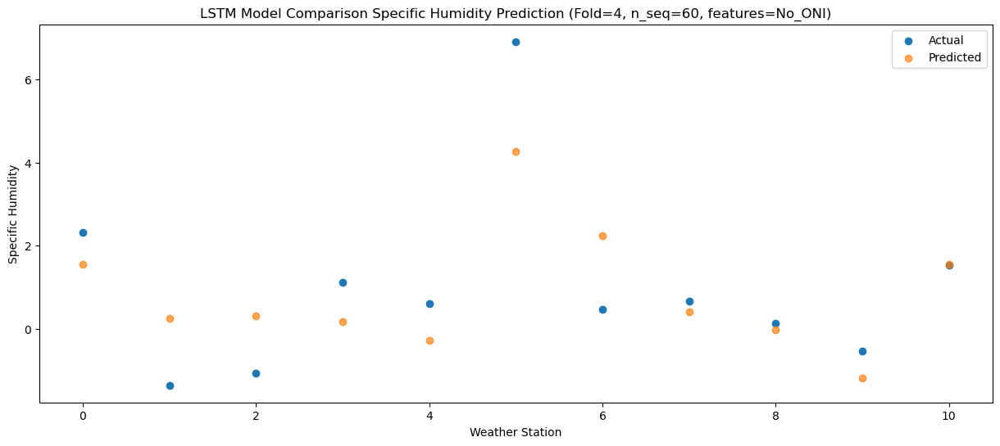

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    2.26   1.486291
1                 1   -1.22   0.186291
2                 2   -0.22   0.246291
3                 3    0.12   0.106291
4                 4   -0.36  -0.333709
5                 5    5.68   4.206291
6                 6    0.53   2.186291
7                 7    0.40   0.346291
8                 8    0.30  -0.083709
9                 9   -0.37  -1.243709
10               10    1.68   1.486291


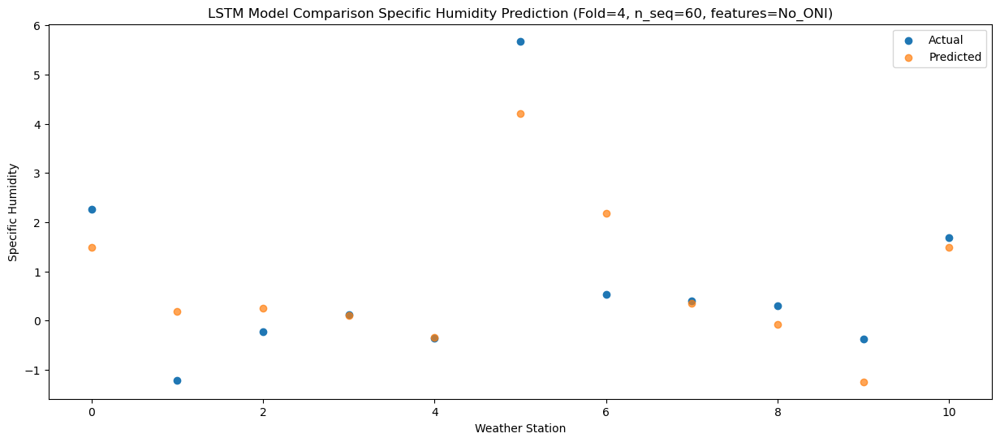

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    1.84   1.578818
1                 1   -2.78   0.278818
2                 2   -0.36   0.338818
3                 3    0.76   0.198818
4                 4    0.33  -0.241182
5                 5    5.56   4.298818
6                 6    0.37   2.278818
7                 7    0.16   0.438818
8                 8   -0.07   0.008818
9                 9   -0.85  -1.151182
10               10    1.34   1.578818


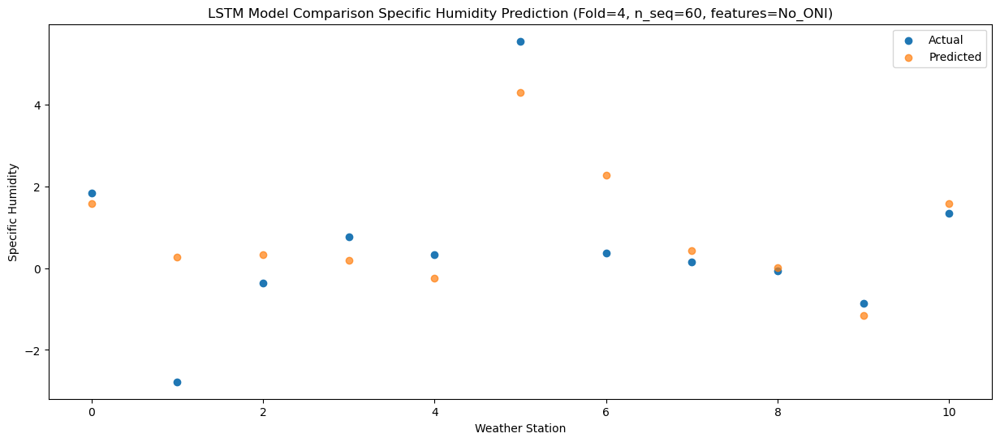

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    1.66   1.010865
1                 1   -1.94  -0.289135
2                 2   -0.55  -0.229135
3                 3    0.14  -0.369135
4                 4   -0.33  -0.809135
5                 5    5.44   3.730865
6                 6    0.95   1.710865
7                 7   -0.07  -0.129135
8                 8   -0.47  -0.559135
9                 9   -1.12  -1.719135
10               10    0.99   1.010865


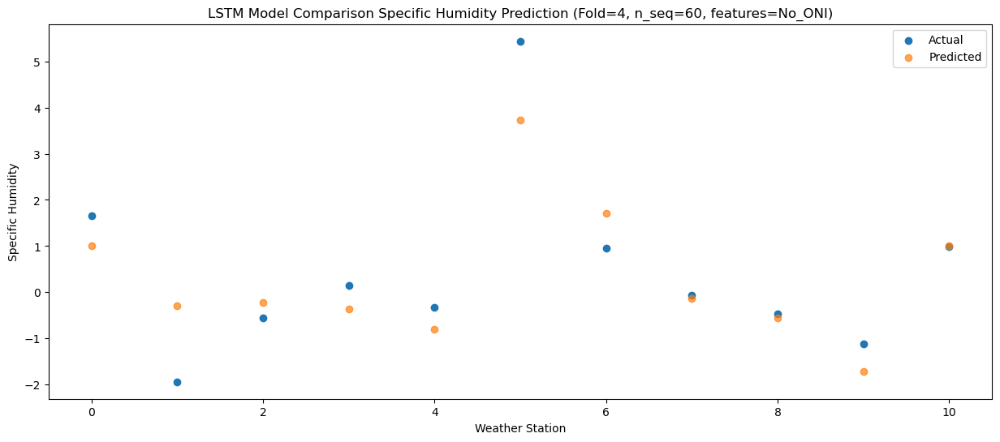

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.89   1.757395
1                 1   -0.56   0.457395
2                 2    3.00   0.517395
3                 3    4.09   0.377395
4                 4    3.57  -0.062605
5                 5    8.24   4.477395
6                 6    3.14   2.457395
7                 7    2.48   0.617395
8                 8    1.45   0.187395
9                 9    0.93  -0.972605
10               10    2.56   1.757395


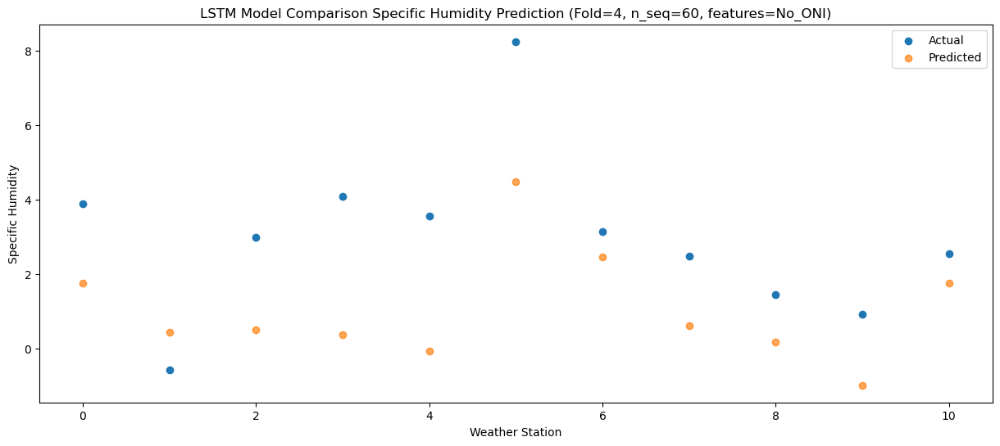

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    4.48   3.145772
1                 1    0.65   1.845772
2                 2    1.88   1.905772
3                 3    3.69   1.765772
4                 4    3.06   1.325772
5                 5    7.49   5.865772
6                 6    2.47   3.845772
7                 7    2.80   2.005772
8                 8    1.73   1.575772
9                 9    1.52   0.415772
10               10    2.40   3.145772


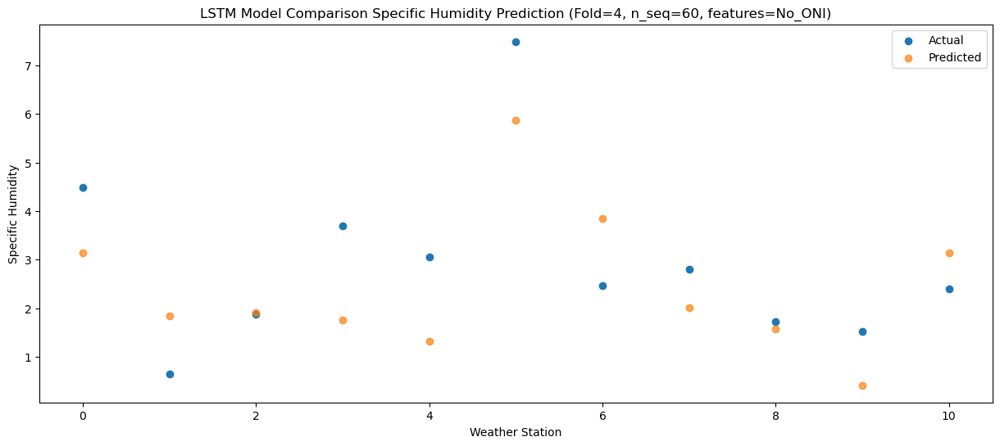

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    7.69   5.804429
1                 1    1.30   4.504429
2                 2    4.12   4.564429
3                 3    6.85   4.424429
4                 4    6.30   3.984429
5                 5    9.76   8.524429
6                 6    5.59   6.504429
7                 7    6.18   4.664429
8                 8    4.88   4.234429
9                 9    5.24   3.074429
10               10    5.02   5.804429


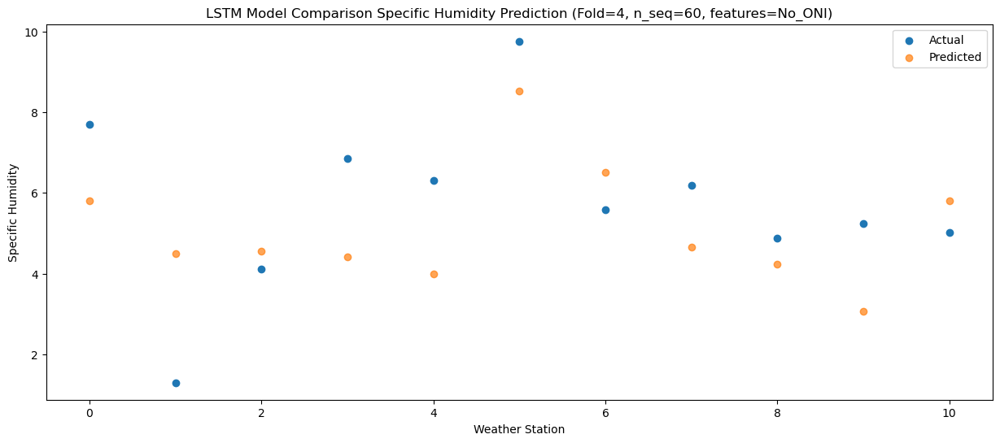

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   12.34   9.016549
1                 1    4.63   7.716549
2                 2    7.42   7.776549
3                 3    9.01   7.636549
4                 4    8.28   7.196549
5                 5   11.47  11.736549
6                 6    9.42   9.716549
7                 7    9.79   7.876549
8                 8    7.62   7.446549
9                 9    7.72   6.286549
10               10    8.21   9.016549


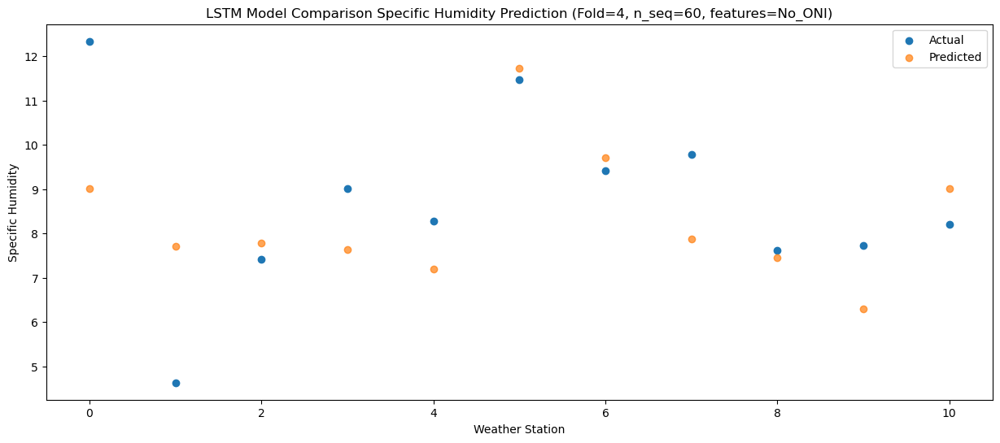

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   14.69  12.555346
1                 1    6.37  11.255346
2                 2   10.35  11.315346
3                 3   12.24  11.175346
4                 4   11.43  10.735346
5                 5   12.70  15.275346
6                 6   12.01  13.255346
7                 7   11.84  11.415346
8                 8   10.84  10.985346
9                 9   11.28   9.825346
10               10   11.13  12.555346


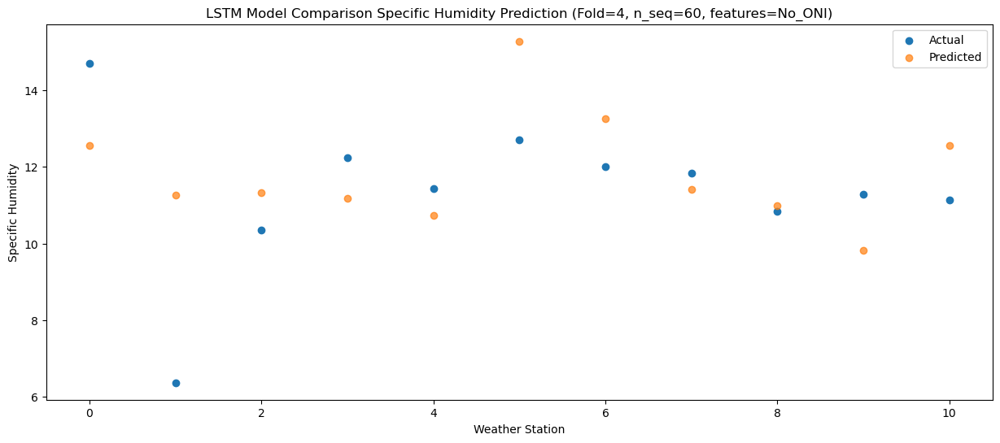

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   12.26  11.563199
1                 1    6.61  10.263199
2                 2    8.84  10.323199
3                 3    9.65  10.183199
4                 4    8.78   9.743199
5                 5   11.39  14.283199
6                 6   12.22  12.263199
7                 7    9.19  10.423199
8                 8    9.17   9.993199
9                 9    9.09   8.833199
10               10    9.71  11.563199


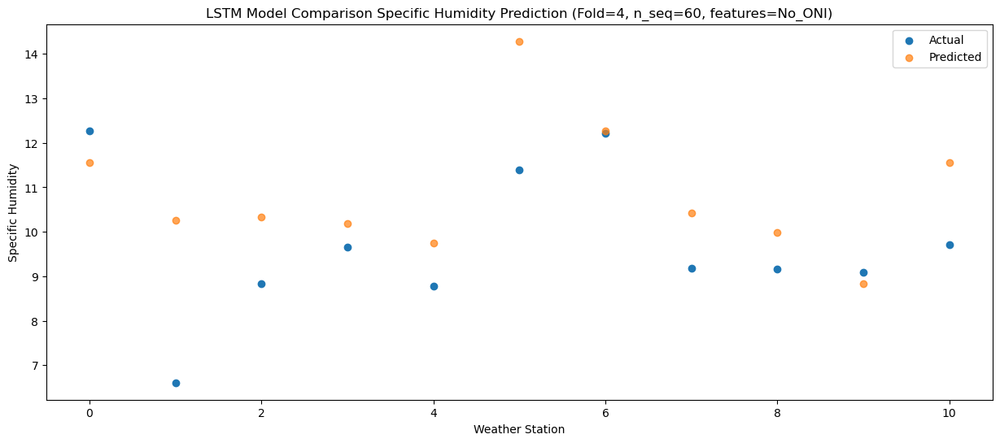

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    9.37   8.128614
1                 1    6.03   6.828614
2                 2    6.79   6.888614
3                 3    8.44   6.748614
4                 4    7.89   6.308614
5                 5   11.20  10.848614
6                 6    8.38   8.828614
7                 7    7.59   6.988614
8                 8    6.25   6.558614
9                 9    6.31   5.398614
10               10    7.57   8.128614


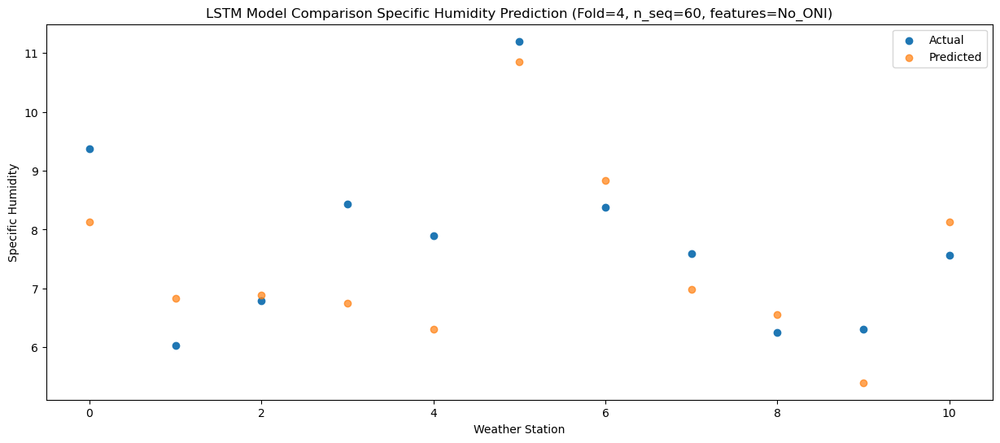

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.78   4.976626
1                 1    3.99   3.676626
2                 2    3.44   3.736626
3                 3    3.87   3.596626
4                 4    3.12   3.156626
5                 5    7.55   7.696626
6                 6    5.73   5.676626
7                 7    3.04   3.836626
8                 8    2.87   3.406626
9                 9    2.15   2.246626
10               10    4.53   4.976626


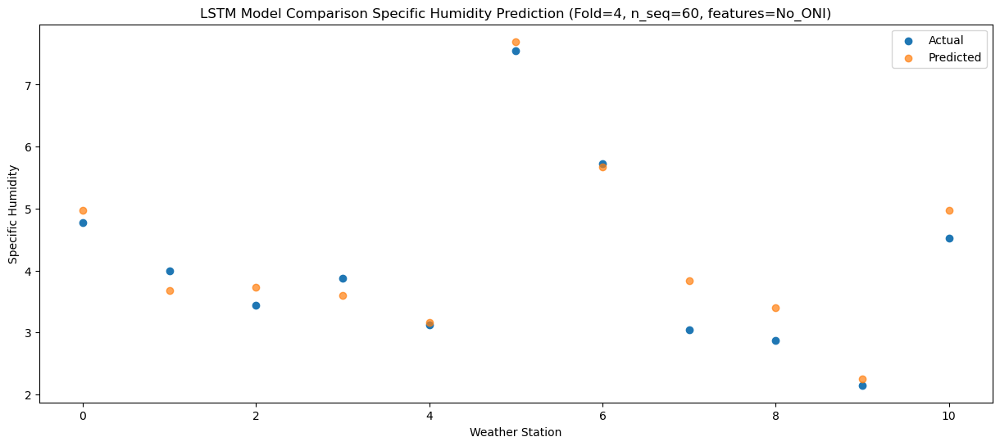

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    4.06   3.072906
1                 1    0.93   1.772906
2                 2    0.77   1.832906
3                 3    2.23   1.692906
4                 4    1.76   1.252906
5                 5    7.09   5.792906
6                 6    2.90   3.772906
7                 7    1.37   1.932906
8                 8    1.19   1.502906
9                 9    1.06   0.342906
10               10    2.60   3.072906


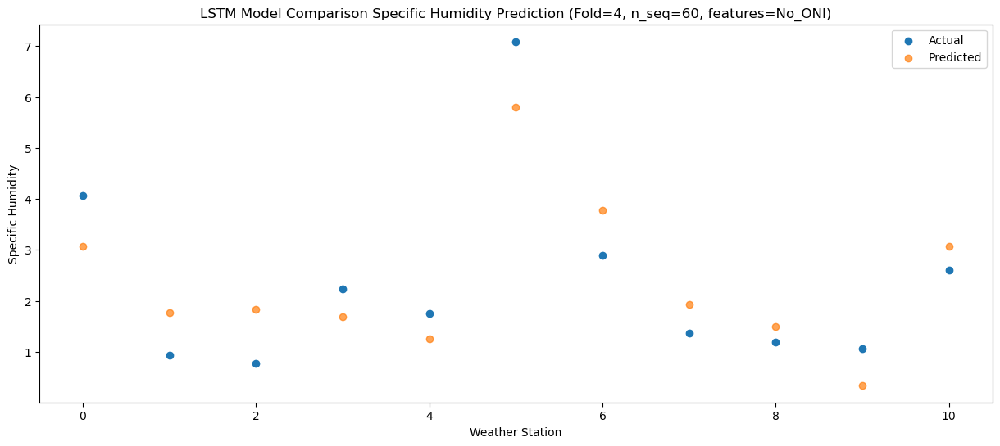

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    1.83   1.595219
1                 1   -3.81   0.295219
2                 2   -1.61   0.355219
3                 3   -0.37   0.215219
4                 4   -0.81  -0.224781
5                 5    4.53   4.315219
6                 6   -0.44   2.295219
7                 7   -0.56   0.455219
8                 8   -0.41   0.025219
9                 9   -0.85  -1.134781
10               10    1.27   1.595219


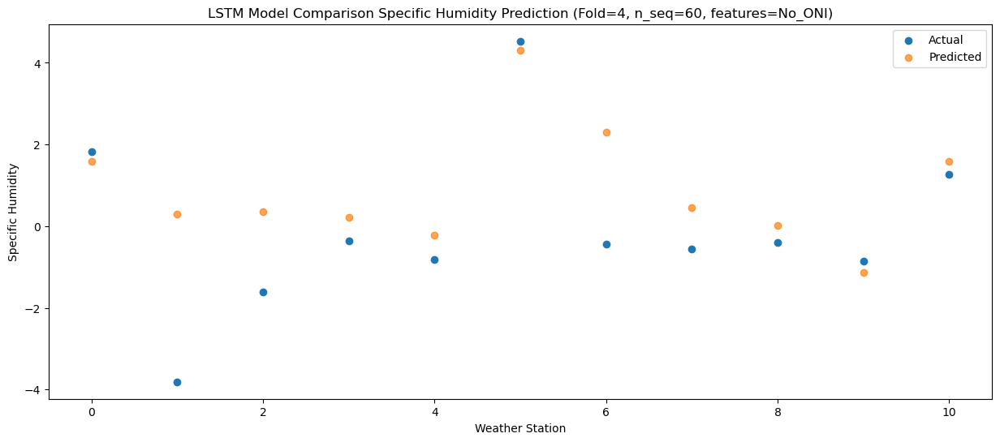

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0    1.95   1.081001
1                 1   -3.46  -0.218999
2                 2   -1.72  -0.158999
3                 3   -0.48  -0.298999
4                 4   -0.85  -0.738999
5                 5    5.23   3.801001
6                 6   -0.56   1.781001
7                 7   -0.71  -0.058999
8                 8   -0.76  -0.488999
9                 9   -1.17  -1.648999
10               10    0.89   1.081001


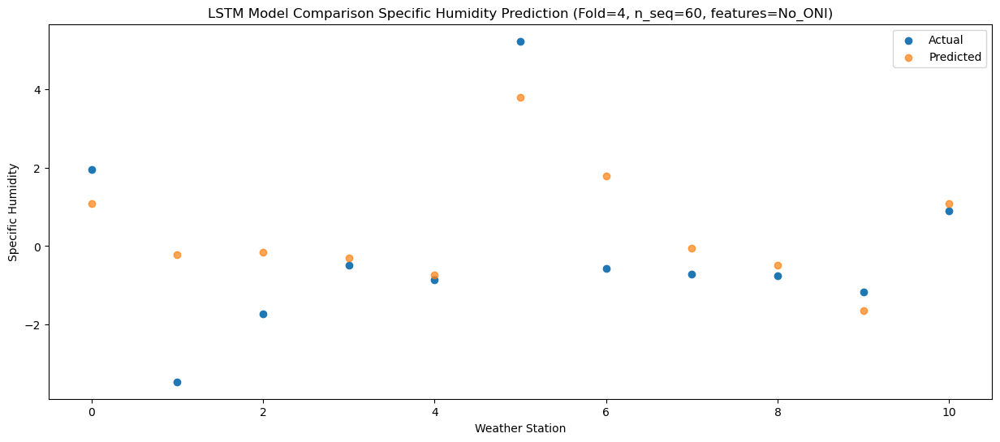

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0    0.86    0.57518
1                 1   -1.47   -0.72482
2                 2   -1.84   -0.66482
3                 3   -0.80   -0.80482
4                 4   -1.30   -1.24482
5                 5    4.59    3.29518
6                 6   -0.31    1.27518
7                 7   -1.34   -0.56482
8                 8   -1.33   -0.99482
9                 9   -1.81   -2.15482
10               10    0.32    0.57518


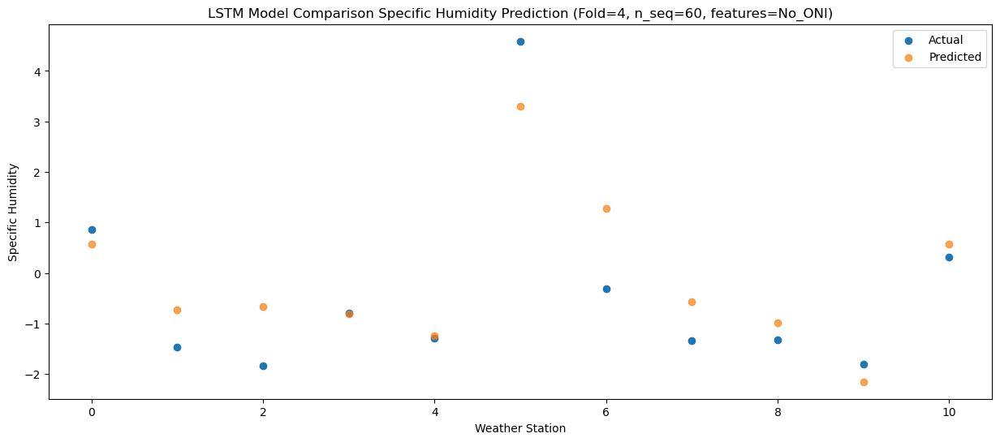

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    3.62   1.552118
1                 1   -1.50   0.252118
2                 2    1.22   0.312118
3                 3    1.86   0.172118
4                 4    1.28  -0.267882
5                 5    6.08   4.272118
6                 6    1.40   2.252118
7                 7    1.03   0.412118
8                 8    0.61  -0.017882
9                 9    0.56  -1.177882
10               10    1.61   1.552118


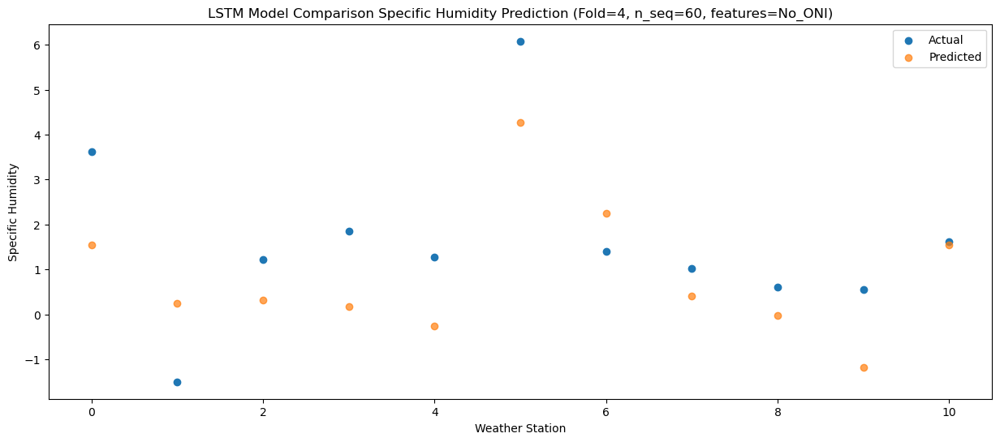

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    4.83   3.414581
1                 1   -0.75   2.114581
2                 2    1.47   2.174581
3                 3    3.15   2.034581
4                 4    2.64   1.594581
5                 5    7.04   6.134581
6                 6    1.81   4.114581
7                 7    1.95   2.274581
8                 8    1.94   1.844581
9                 9    1.87   0.684581
10               10    3.28   3.414581


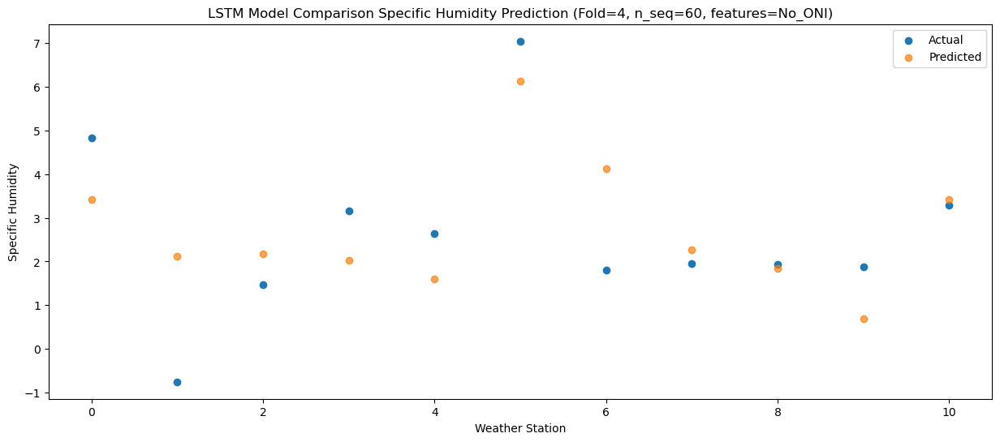

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    8.39   4.747012
1                 1    0.58   3.447012
2                 2    4.91   3.507012
3                 3    7.15   3.367012
4                 4    6.93   2.927012
5                 5   11.59   7.467012
6                 6    4.79   5.447012
7                 7    5.11   3.607012
8                 8    4.23   3.177012
9                 9    4.49   2.017012
10               10    4.88   4.747012


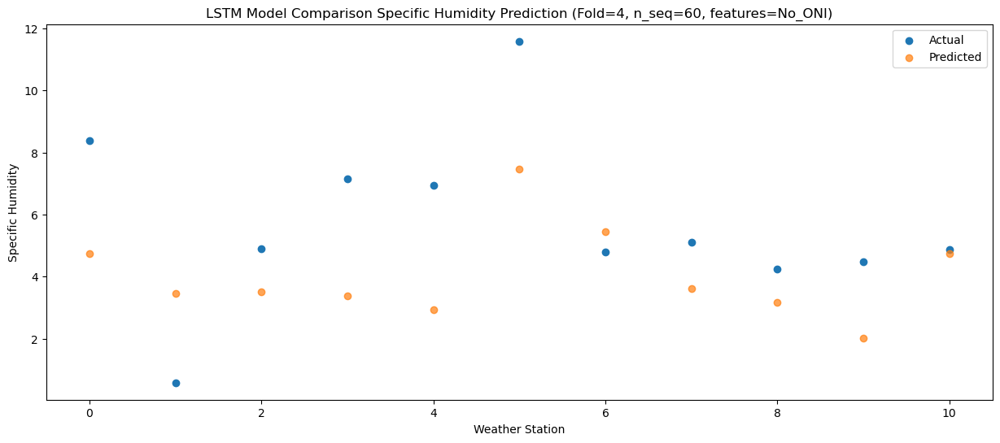

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   12.98   9.757955
1                 1    4.87   8.457955
2                 2    9.15   8.517955
3                 3   10.84   8.377955
4                 4   10.81   7.937955
5                 5   13.89  12.477955
6                 6    9.48  10.457955
7                 7    9.71   8.617955
8                 8    9.29   8.187955
9                 9    9.24   7.027955
10               10    9.89   9.757955


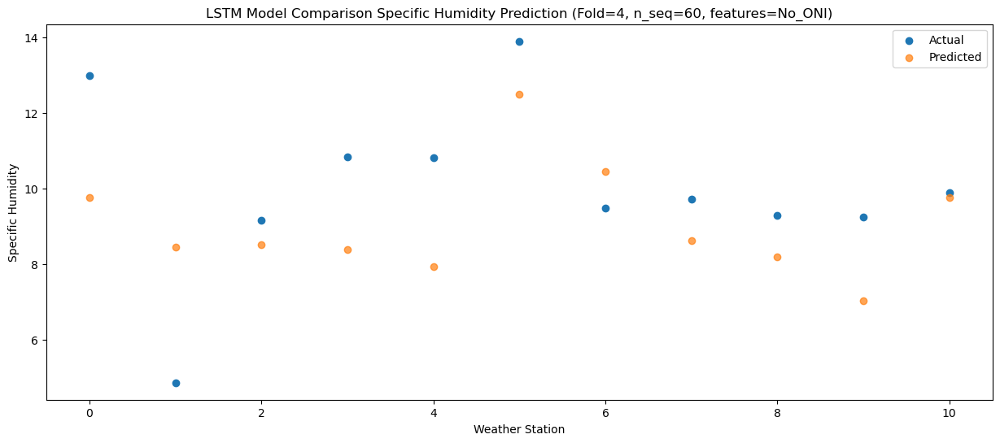

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   14.37  10.809414
1                 1    6.08   9.509414
2                 2   10.80   9.569414
3                 3   11.41   9.429414
4                 4   11.19   8.989414
5                 5   14.92  13.529414
6                 6   11.08  11.509414
7                 7   10.66   9.669414
8                 8   10.55   9.239414
9                 9   10.64   8.079414
10               10   11.16  10.809414


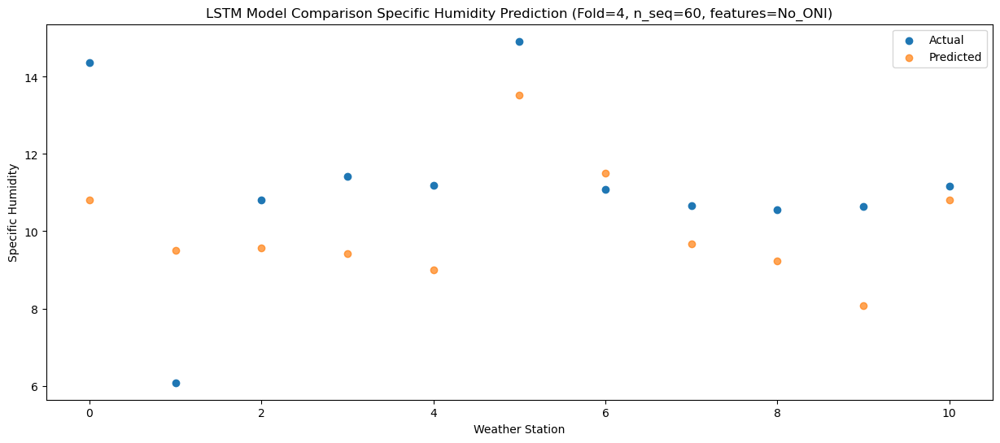

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   14.19  11.155799
1                 1    6.47   9.855799
2                 2   10.81   9.915799
3                 3   11.80   9.775799
4                 4   11.30   9.335799
5                 5   14.64  13.875799
6                 6   11.46  11.855799
7                 7   10.40  10.015799
8                 8   10.69   9.585799
9                 9   10.89   8.425799
10               10   12.03  11.155799


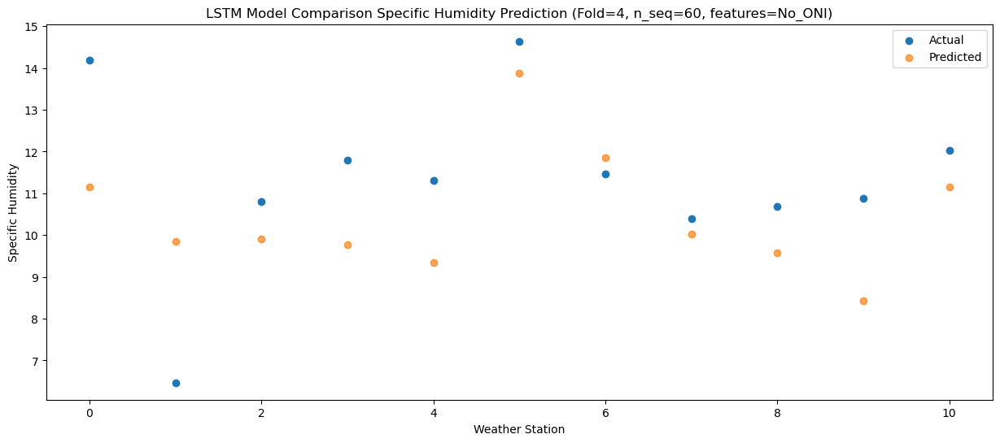

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   10.61   8.000242
1                 1    5.67   6.700242
2                 2    7.87   6.760242
3                 3    7.79   6.620242
4                 4    7.40   6.180242
5                 5   11.39  10.720242
6                 6    7.88   8.700242
7                 7    7.14   6.860242
8                 8    7.21   6.430242
9                 9    6.86   5.270242
10               10    8.27   8.000242


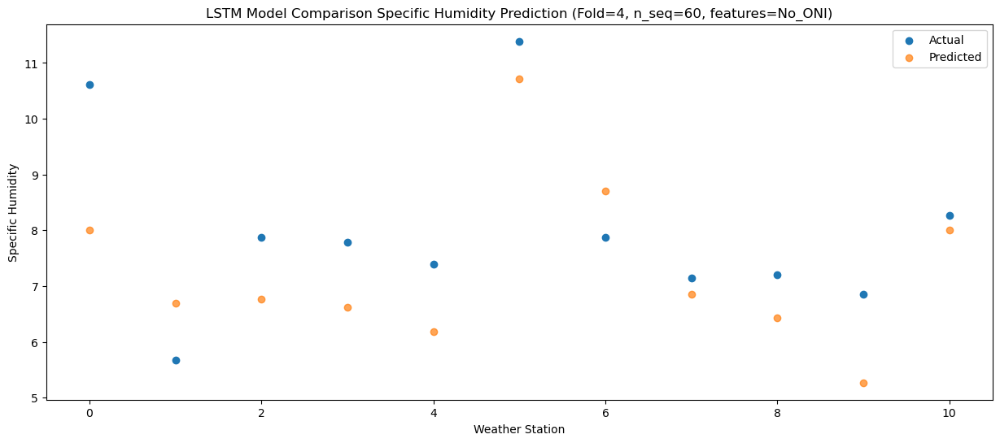

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    7.24   6.302641
1                 1    2.75   5.002641
2                 2    5.09   5.062641
3                 3    4.94   4.922641
4                 4    4.67   4.482641
5                 5    8.34   9.022641
6                 6    5.67   7.002641
7                 7    5.05   5.162641
8                 8    6.06   4.732641
9                 9    4.99   3.572641
10               10    7.26   6.302641


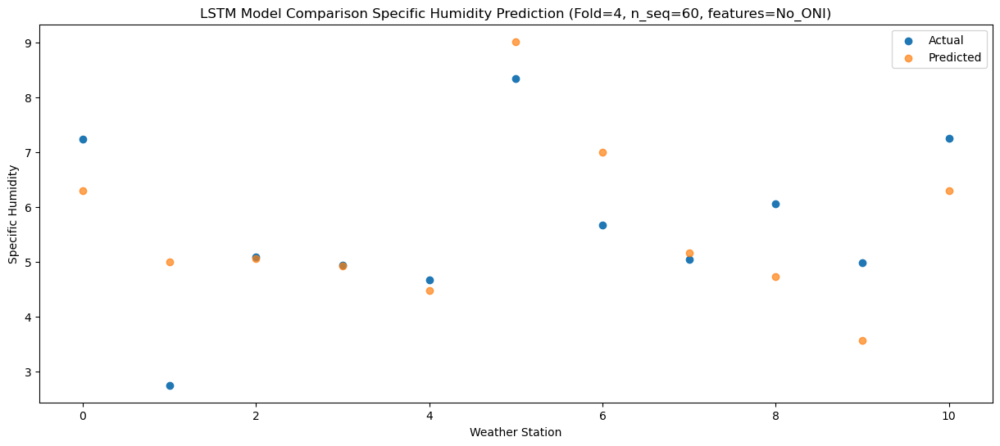

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    3.15   1.296698
1                 1   -1.91  -0.003302
2                 2   -0.35   0.056698
3                 3    1.32  -0.083302
4                 4    1.06  -0.523302
5                 5    6.62   4.016698
6                 6   -0.05   1.996698
7                 7    0.36   0.156698
8                 8    0.29  -0.273302
9                 9   -0.30  -1.433302
10               10    2.02   1.296698


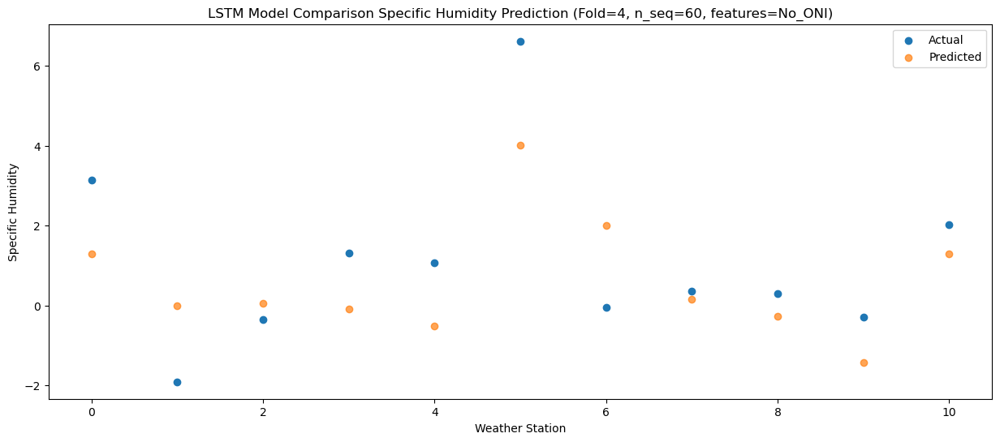

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    2.94     0.9431
1                 1   -0.17    -0.3569
2                 2    2.60    -0.2969
3                 3    3.18    -0.4369
4                 4    2.47    -0.8769
5                 5    5.77     3.6631
6                 6    1.81     1.6431
7                 7    1.83    -0.1969
8                 8    1.00    -0.6269
9                 9    0.24    -1.7869
10               10    1.98     0.9431


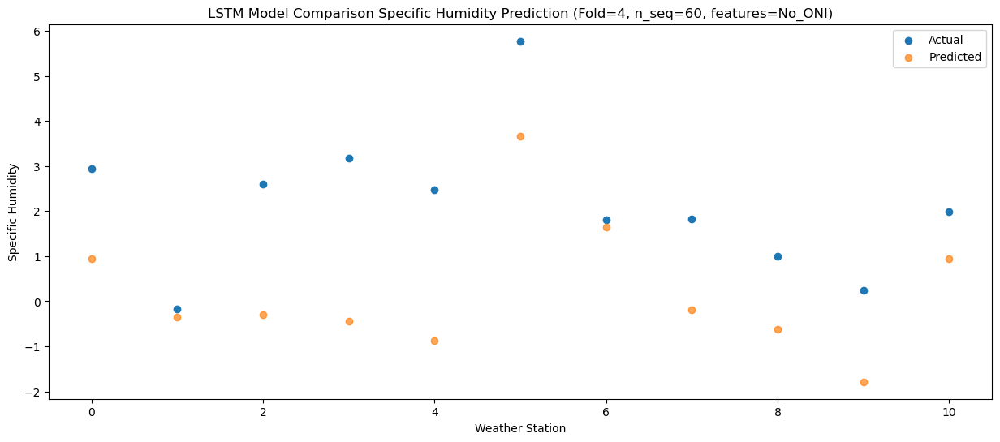

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0    0.93  -0.667098
1                 1   -4.03  -1.967098
2                 2   -2.13  -1.907098
3                 3   -1.48  -2.047098
4                 4   -1.86  -2.487098
5                 5    4.31   2.052902
6                 6   -1.17   0.032902
7                 7   -1.37  -1.807098
8                 8   -1.38  -2.237098
9                 9   -2.00  -3.397098
10               10    0.24  -0.667098


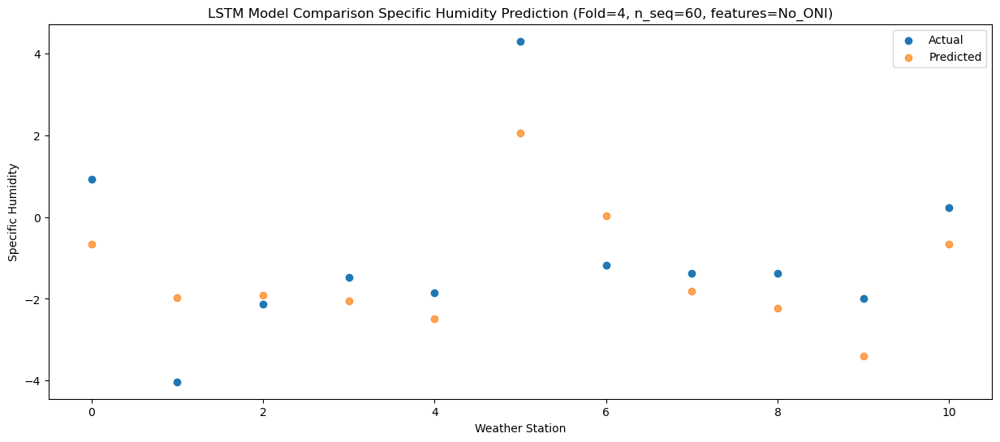

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0    1.15  -0.012925
1                 1   -2.45  -1.312925
2                 2   -1.28  -1.252925
3                 3   -0.95  -1.392925
4                 4   -1.42  -1.832925
5                 5    4.30   2.707075
6                 6    0.15   0.687075
7                 7   -0.86  -1.152925
8                 8   -0.80  -1.582925
9                 9   -1.30  -2.742925
10               10    0.69  -0.012925


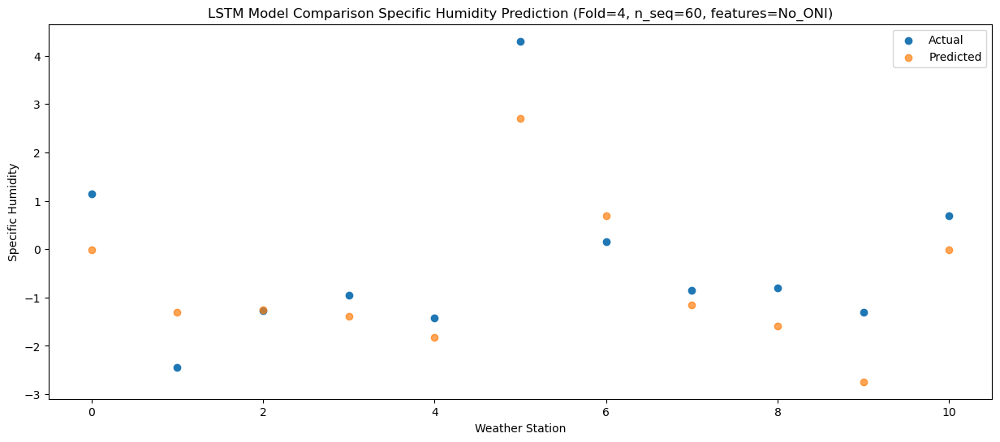

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    2.71   1.260083
1                 1   -0.92  -0.039917
2                 2   -0.23   0.020083
3                 3    0.64  -0.119917
4                 4    0.10  -0.559917
5                 5    4.89   3.980083
6                 6    0.99   1.960083
7                 7    0.65   0.120083
8                 8    0.51  -0.309917
9                 9    0.22  -1.469917
10               10    1.84   1.260083


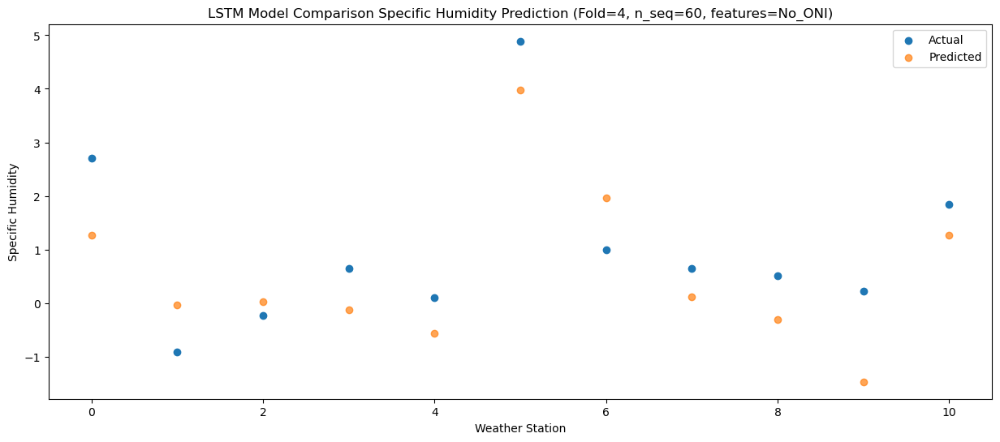

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    4.20   1.869982
1                 1    0.37   0.569982
2                 2    2.22   0.629982
3                 3    4.15   0.489982
4                 4    3.78   0.049982
5                 5    6.92   4.589982
6                 6    2.05   2.569982
7                 7    2.44   0.729982
8                 8    2.00   0.299982
9                 9    1.52  -0.860018
10               10    2.83   1.869982


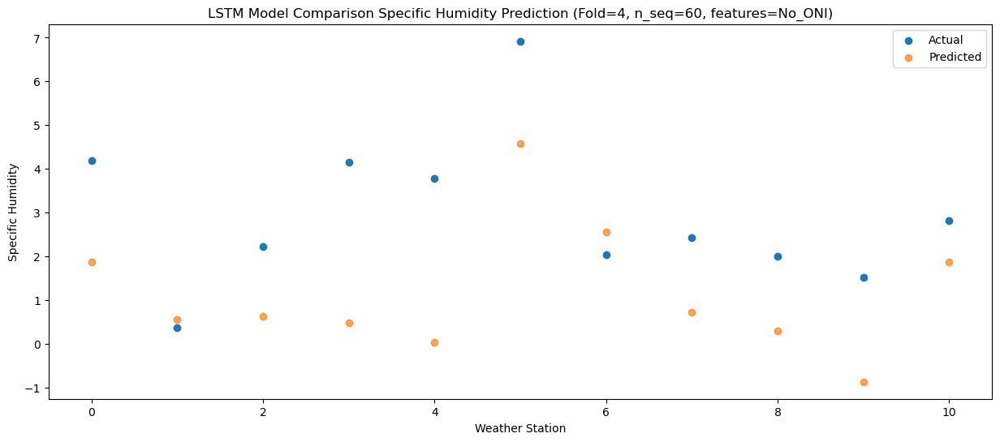

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    9.08   5.985738
1                 1    2.76   4.685738
2                 2    6.82   4.745738
3                 3    8.14   4.605738
4                 4    7.66   4.165738
5                 5    9.18   8.705738
6                 6    6.06   6.685738
7                 7    7.15   4.845738
8                 8    6.02   4.415738
9                 9    5.59   3.255738
10               10    6.29   5.985738


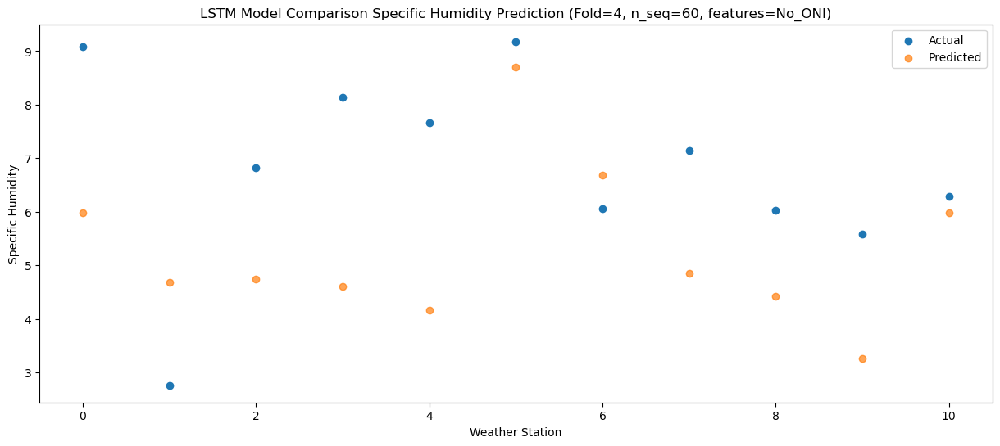

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   12.31   6.600279
1                 1    5.66   5.300279
2                 2    9.20   5.360279
3                 3    9.91   5.220279
4                 4    9.34   4.780279
5                 5   12.03   9.320279
6                 6    8.34   7.300279
7                 7    9.51   5.460279
8                 8    7.46   5.030279
9                 9    7.83   3.870279
10               10    8.20   6.600279


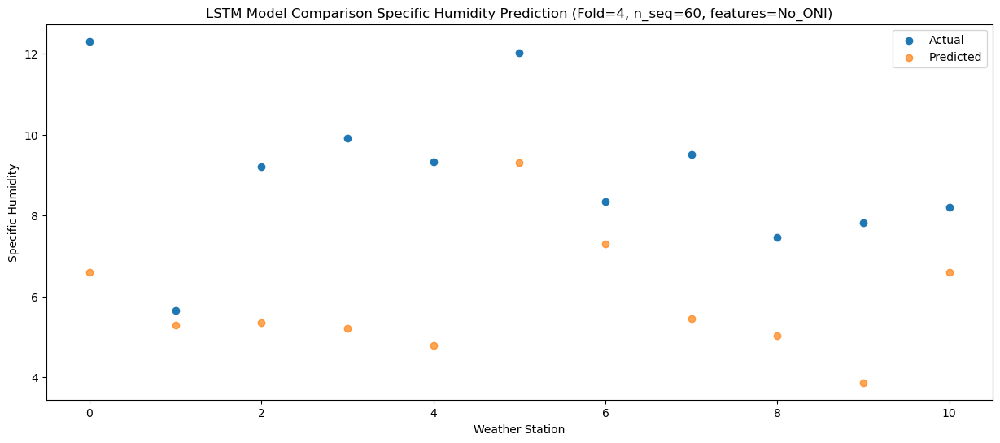

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   13.94   8.866616
1                 1    6.69   7.566616
2                 2   11.04   7.626616
3                 3    9.33   7.486616
4                 4    8.84   7.046616
5                 5   12.72  11.586616
6                 6   11.50   9.566616
7                 7   10.31   7.726616
8                 8   10.20   7.296616
9                 9   10.47   6.136616
10               10    9.93   8.866616


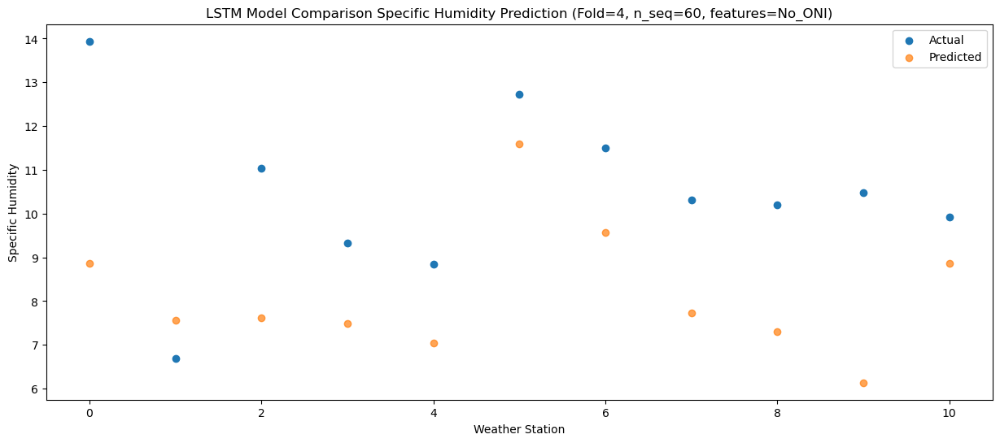

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   13.73   8.302268
1                 1    6.77   7.002268
2                 2   10.86   7.062268
3                 3   10.34   6.922268
4                 4   10.01   6.482268
5                 5   14.71  11.022268
6                 6   10.31   9.002268
7                 7   10.78   7.162268
8                 8    9.84   6.732268
9                 9    9.70   5.572268
10               10   10.39   8.302268


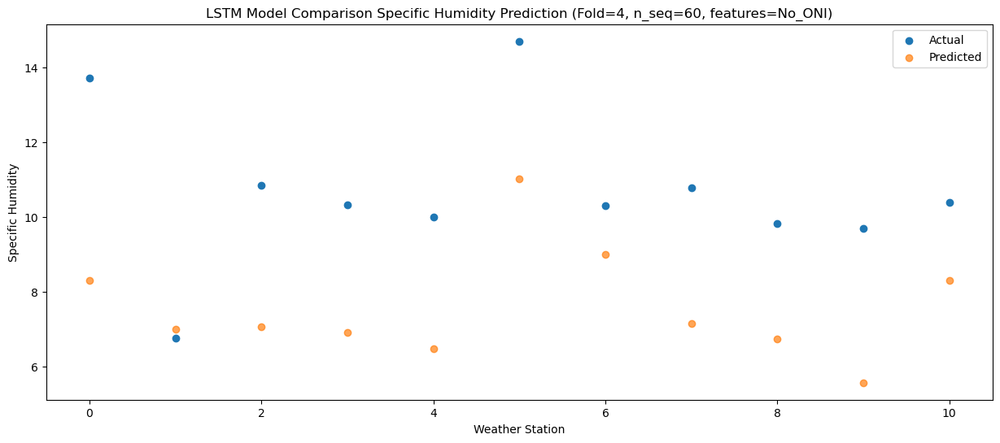

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    9.03   6.856398
1                 1    5.90   5.556398
2                 2    6.62   5.616398
3                 3    7.06   5.476398
4                 4    6.86   5.036398
5                 5   13.46   9.576398
6                 6    6.76   7.556398
7                 7    6.97   5.716398
8                 8    7.18   5.286398
9                 9    6.33   4.126398
10               10    8.40   6.856398


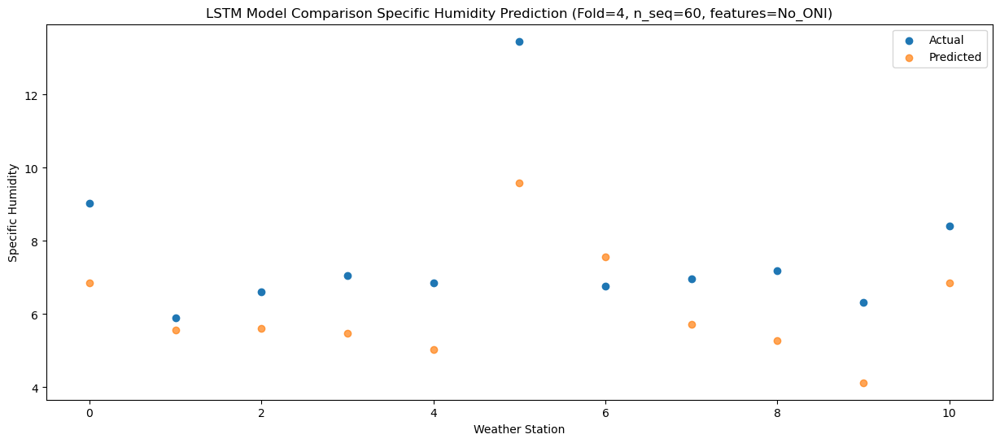

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    4.44   2.988448
1                 1    1.12   1.688448
2                 2    1.66   1.748448
3                 3    2.60   1.608448
4                 4    2.40   1.168448
5                 5    9.95   5.708448
6                 6    2.08   3.688448
7                 7    2.31   1.848448
8                 8    1.85   1.418448
9                 9    1.57   0.258448
10               10    3.58   2.988448


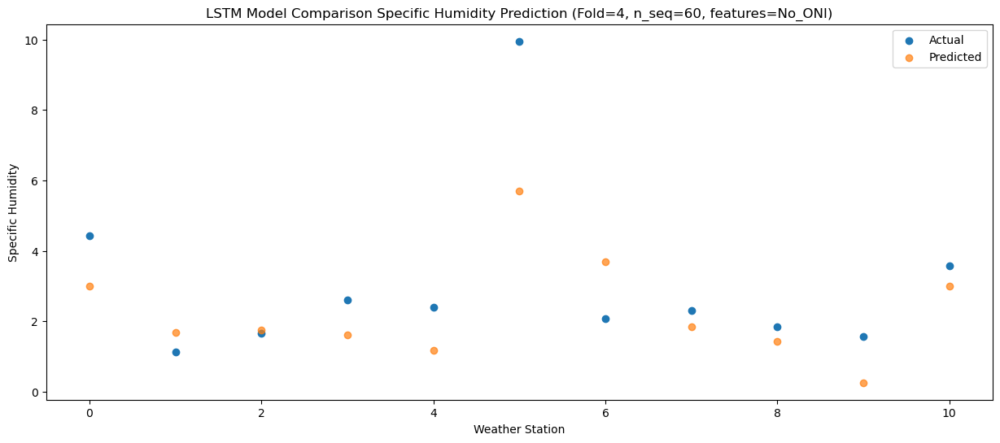

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    3.27   1.301781
1                 1    1.29   0.001781
2                 2    0.91   0.061781
3                 3    2.42  -0.078219
4                 4    1.98  -0.518219
5                 5    7.25   4.021781
6                 6    1.90   2.001781
7                 7    0.95   0.161781
8                 8    0.81  -0.268219
9                 9    0.20  -1.428219
10               10    2.86   1.301781


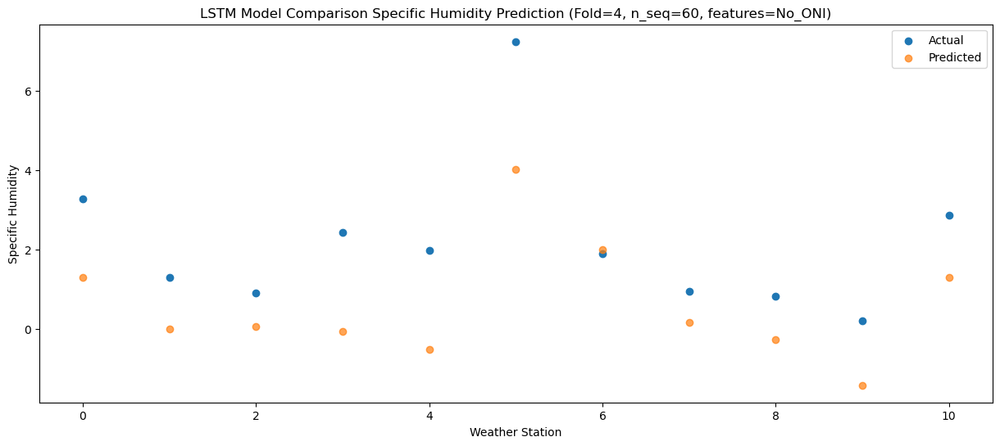

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.93  -0.852205
1                 1   -2.23  -2.152205
2                 2    0.37  -2.092205
3                 3    0.84  -2.232205
4                 4    0.39  -2.672205
5                 5    6.61   1.867795
6                 6   -0.09  -0.152205
7                 7    0.08  -1.992205
8                 8   -0.15  -2.422205
9                 9   -0.91  -3.582205
10               10    1.41  -0.852205


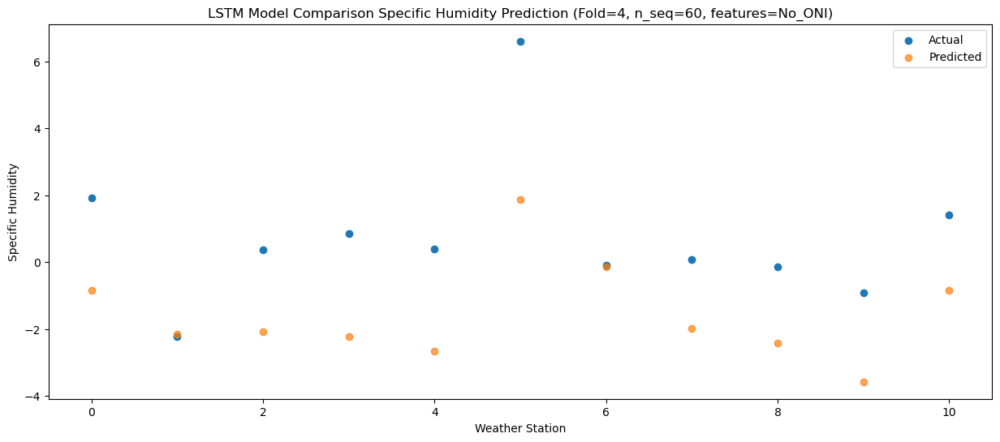

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    2.28   0.396388
1                 1   -2.74  -0.903612
2                 2    0.27  -0.843612
3                 3    0.15  -0.983612
4                 4   -0.36  -1.423612
5                 5    5.06   3.116388
6                 6    0.54   1.096388
7                 7    0.36  -0.743612
8                 8    0.47  -1.173612
9                 9   -0.39  -2.333612
10               10    2.03   0.396388


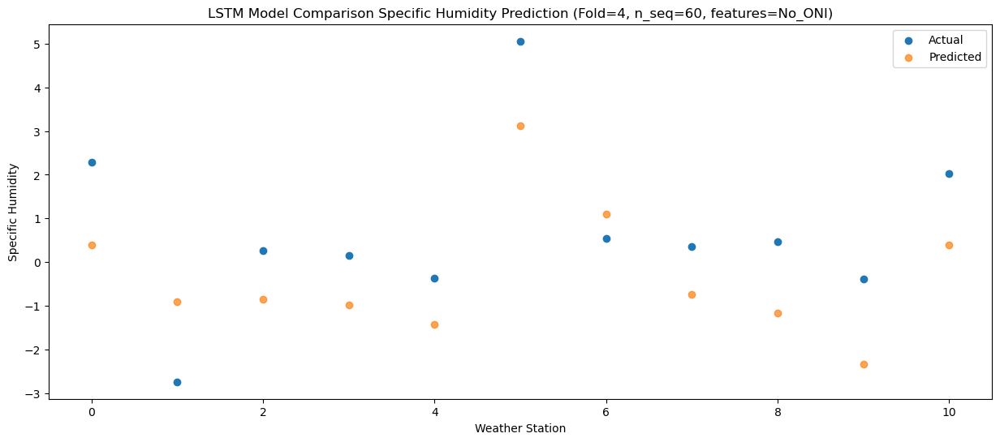

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    2.23  -0.963603
1                 1   -0.80  -2.263603
2                 2    0.94  -2.203603
3                 3    0.51  -2.343603
4                 4    0.04  -2.783603
5                 5    5.18   1.756397
6                 6    1.58  -0.263603
7                 7    0.17  -2.103603
8                 8    0.07  -2.533603
9                 9   -0.62  -3.693603
10               10    1.28  -0.963603


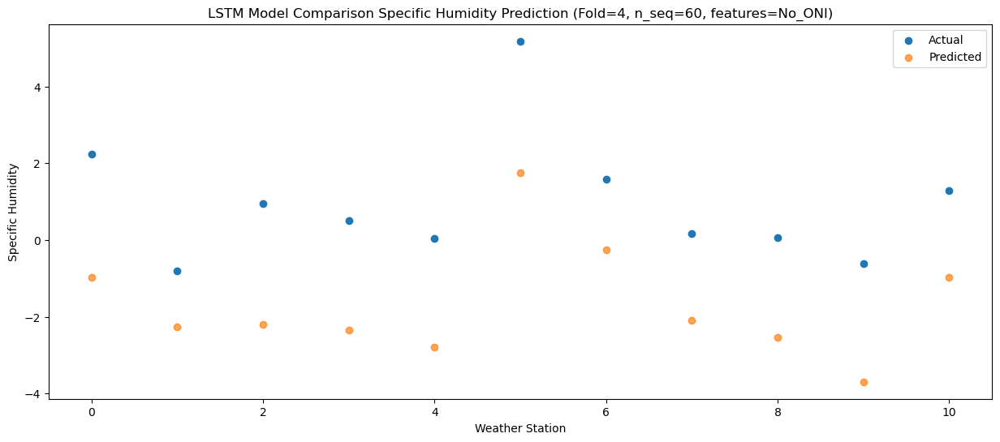

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    3.07  -0.472803
1                 1   -0.42  -1.772803
2                 2    1.27  -1.712803
3                 3    2.57  -1.852803
4                 4    2.01  -2.292803
5                 5    6.47   2.247197
6                 6    1.07   0.227197
7                 7    0.93  -1.612803
8                 8    0.42  -2.042803
9                 9   -0.01  -3.202803
10               10    1.49  -0.472803


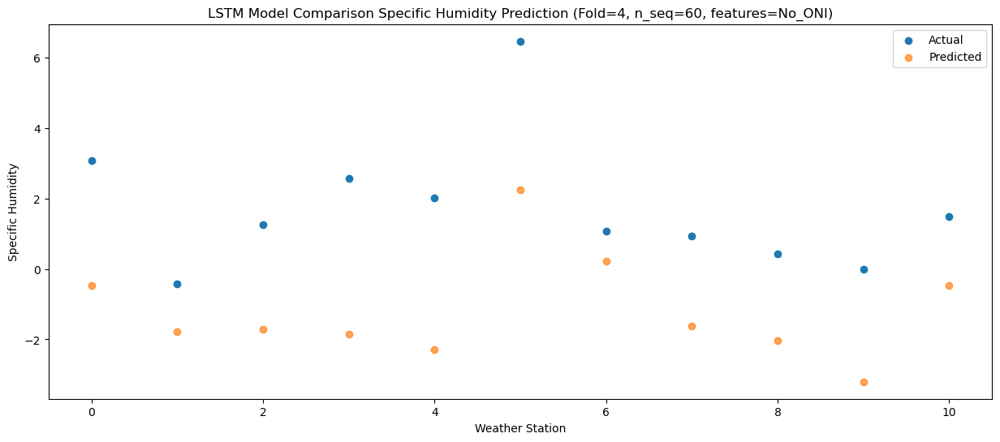

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    4.25   2.306191
1                 1    1.07   1.006191
2                 2    2.11   1.066191
3                 3    3.25   0.926191
4                 4    2.86   0.486191
5                 5    6.44   5.026191
6                 6    2.67   3.006191
7                 7    1.83   1.166191
8                 8    1.87   0.736191
9                 9    1.50  -0.423809
10               10    3.19   2.306191


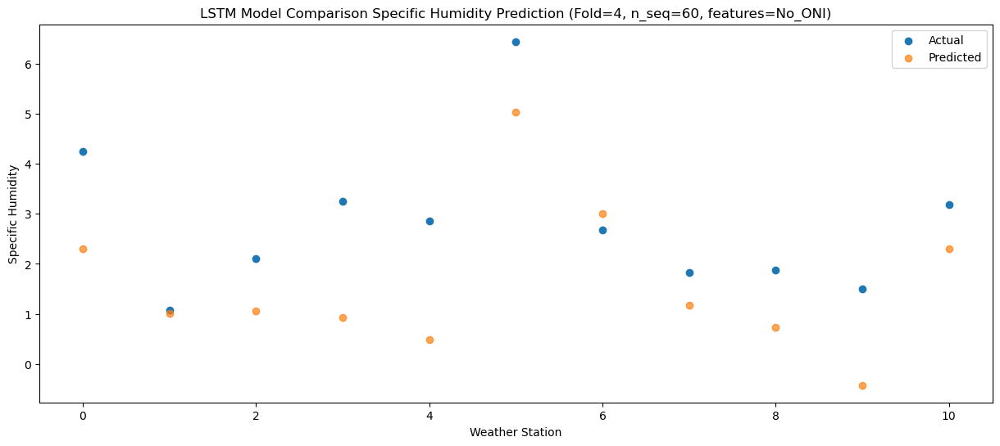

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    8.27   3.090682
1                 1    1.87   1.790682
2                 2    5.49   1.850682
3                 3    7.51   1.710682
4                 4    7.13   1.270682
5                 5   11.28   5.810682
6                 6    4.89   3.790682
7                 7    6.22   1.950682
8                 8    4.12   1.520682
9                 9    4.28   0.360682
10               10    4.09   3.090682


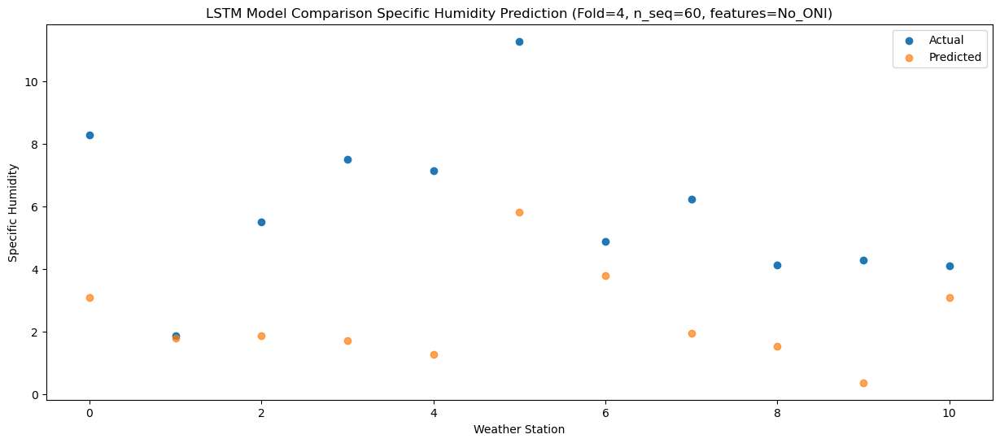

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   10.81     6.3819
1                 1    5.38     5.0819
2                 2    9.06     5.1419
3                 3   11.45     5.0019
4                 4   10.61     4.5619
5                 5   15.14     9.1019
6                 6    7.94     7.0819
7                 7    8.78     5.2419
8                 8    6.08     4.8119
9                 9    5.92     3.6519
10               10    7.33     6.3819


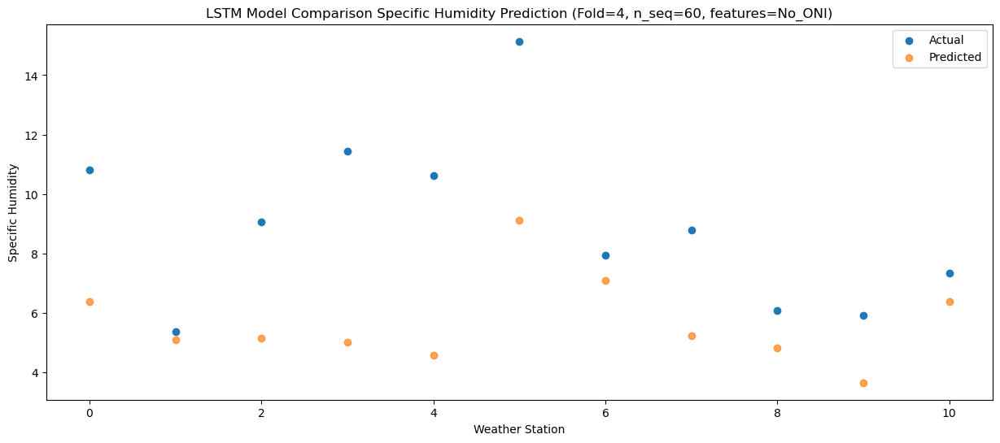

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   13.50  10.967518
1                 1    7.29   9.667518
2                 2   10.65   9.727518
3                 3   11.30   9.587518
4                 4    9.71   9.147518
5                 5   12.81  13.687518
6                 6   11.33  11.667518
7                 7   11.57   9.827518
8                 8   10.38   9.397518
9                 9   10.62   8.237518
10               10   10.95  10.967518


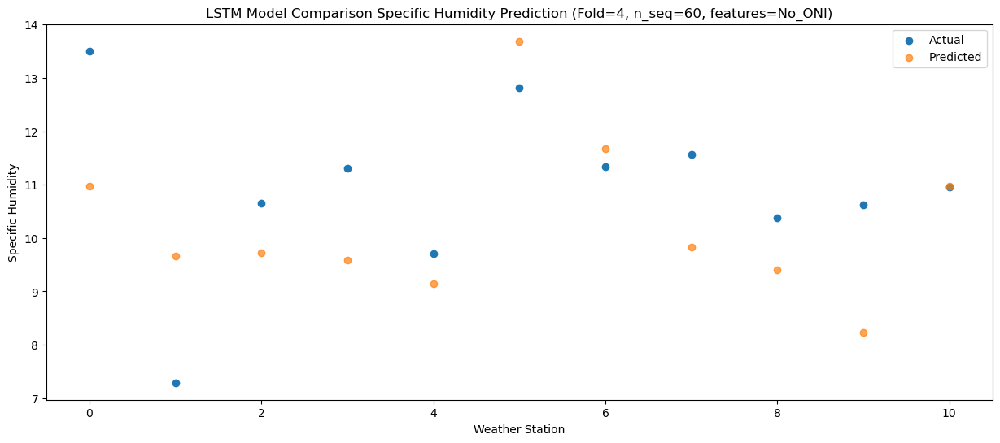

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   14.43    8.88022
1                 1    7.59    7.58022
2                 2    9.07    7.64022
3                 3    9.20    7.50022
4                 4    8.33    7.06022
5                 5   11.95   11.60022
6                 6   10.87    9.58022
7                 7   11.85    7.74022
8                 8    9.84    7.31022
9                 9   10.49    6.15022
10               10   10.15    8.88022


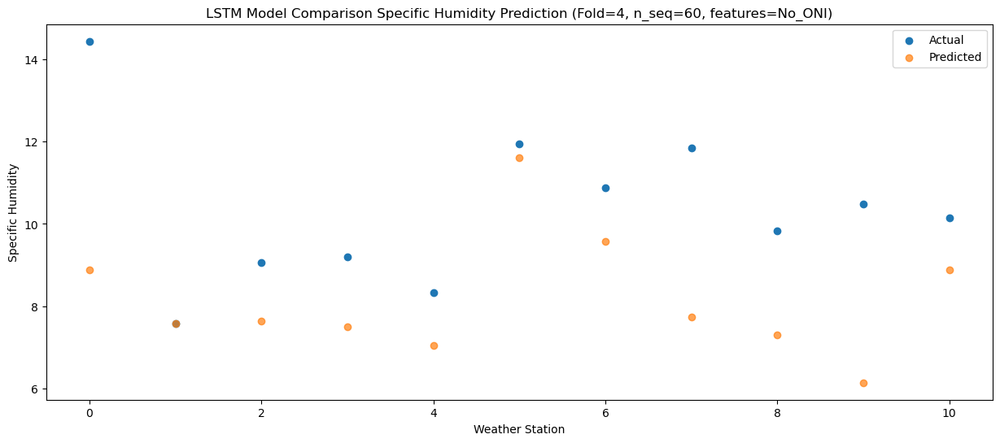

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    9.51   7.441063
1                 1    5.14   6.141063
2                 2    6.05   6.201063
3                 3    8.30   6.061063
4                 4    8.00   5.621063
5                 5   12.46  10.161063
6                 6    7.42   8.141063
7                 7    7.65   6.301063
8                 8    7.04   5.871063
9                 9    6.71   4.711063
10               10    8.44   7.441063


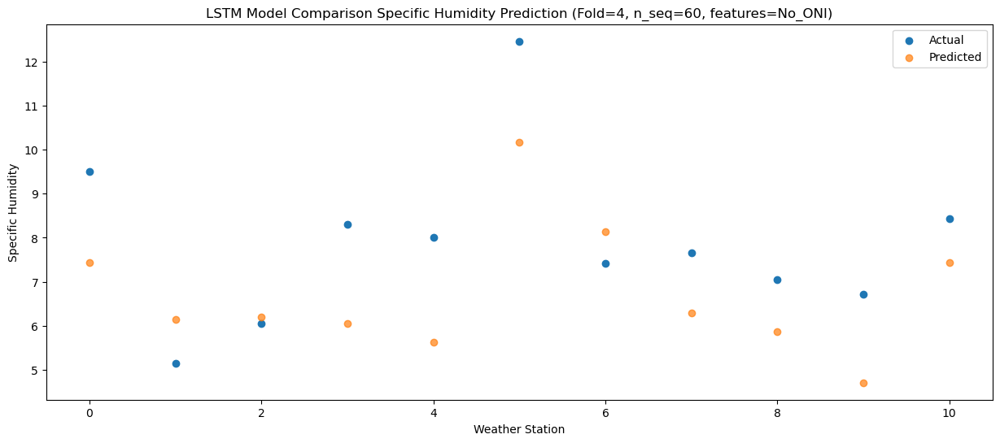

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    6.32   4.660744
1                 1    1.52   3.360744
2                 2    2.12   3.420744
3                 3    4.58   3.280744
4                 4    4.34   2.840744
5                 5   10.33   7.380744
6                 6    3.51   5.360744
7                 7    4.04   3.520744
8                 8    3.71   3.090744
9                 9    3.27   1.930744
10               10    5.38   4.660744


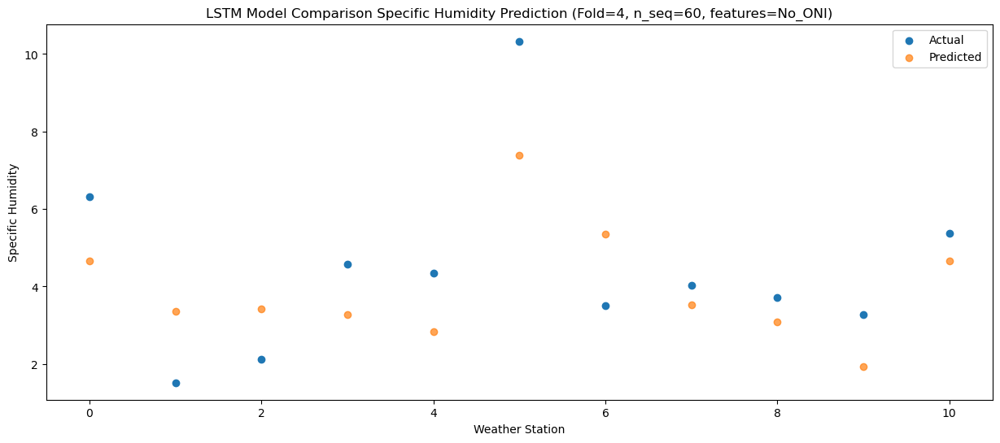

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    3.42   1.101281
1                 1   -0.78  -0.198719
2                 2    0.14  -0.138719
3                 3    2.05  -0.278719
4                 4    1.92  -0.718719
5                 5    8.03   3.821281
6                 6    0.56   1.801281
7                 7    1.01  -0.038719
8                 8    0.64  -0.468719
9                 9   -0.12  -1.628719
10               10    1.94   1.101281


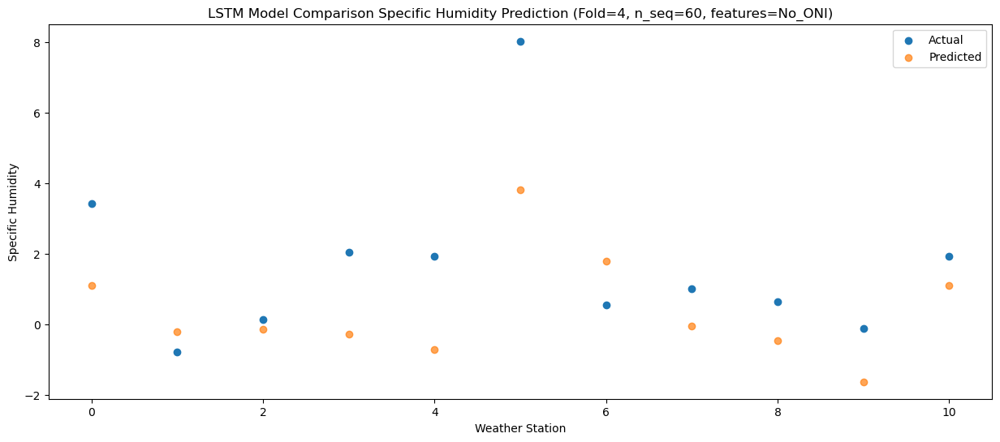

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    3.24   1.526478
1                 1   -1.87   0.226478
2                 2   -1.17   0.286478
3                 3    0.30   0.146478
4                 4    0.16  -0.293522
5                 5    6.45   4.246478
6                 6    0.28   2.226478
7                 7    0.20   0.386478
8                 8    0.61  -0.043522
9                 9    0.37  -1.203522
10               10    2.46   1.526478


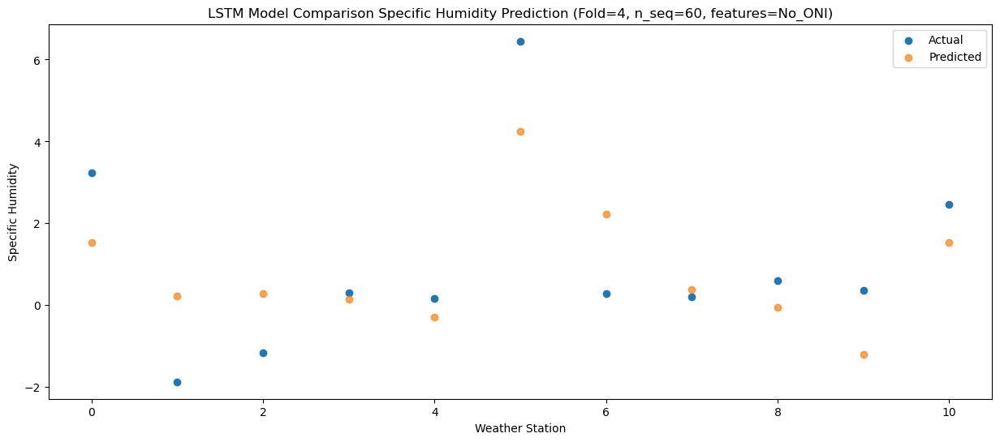

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0    1.54   0.608244
1                 1   -2.91  -0.691756
2                 2   -1.89  -0.631756
3                 3   -0.98  -0.771756
4                 4   -1.26  -1.211756
5                 5    5.18   3.328244
6                 6   -0.50   1.308244
7                 7   -0.95  -0.531756
8                 8   -0.47  -0.961756
9                 9   -1.09  -2.121756
10               10    1.39   0.608244


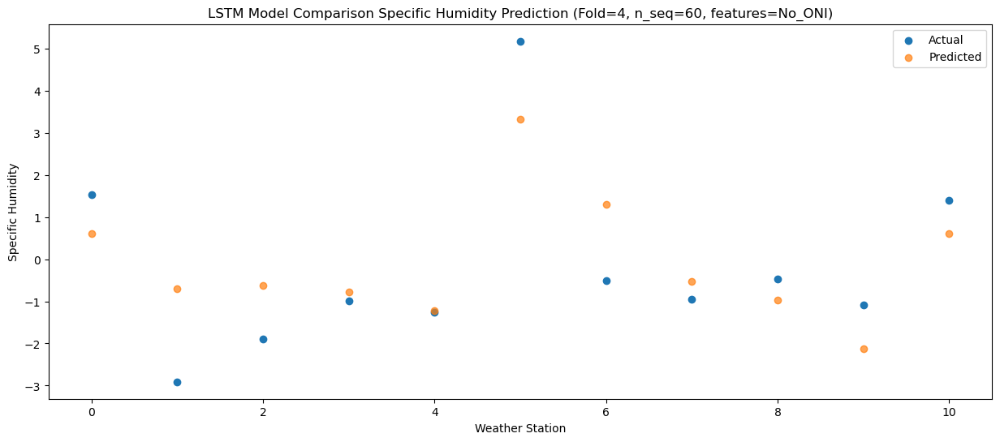

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    2.55     0.3097
1                 1   -3.60    -0.9903
2                 2   -0.46    -0.9303
3                 3    1.36    -1.0703
4                 4    1.09    -1.5103
5                 5    5.53     3.0297
6                 6   -0.32     1.0097
7                 7    0.41    -0.8303
8                 8    0.11    -1.2603
9                 9   -0.17    -2.4203
10               10    1.41     0.3097


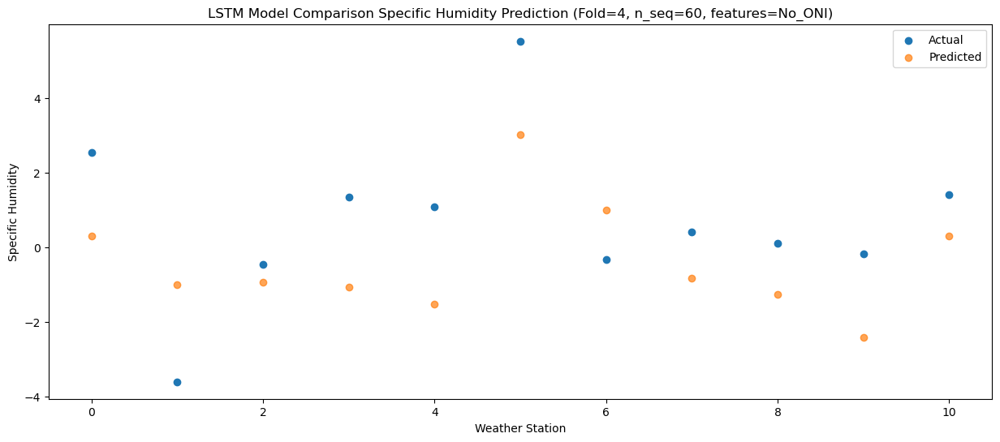

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    3.61   1.062773
1                 1   -0.31  -0.237227
2                 2    1.17  -0.177227
3                 3    3.15  -0.317227
4                 4    3.04  -0.757227
5                 5    6.67   3.782773
6                 6    1.25   1.762773
7                 7    1.62  -0.077227
8                 8    1.18  -0.507227
9                 9    0.80  -1.667227
10               10    2.48   1.062773


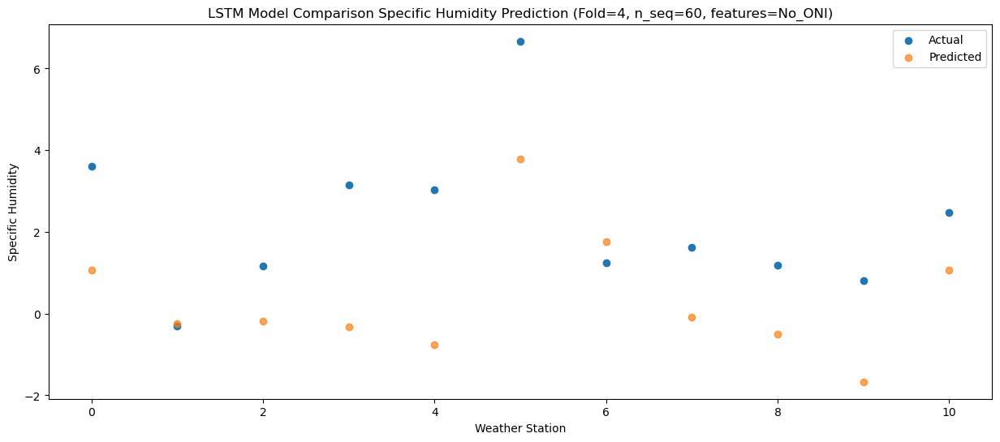

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    5.29   2.697741
1                 1   -0.91   1.397741
2                 2    3.35   1.457741
3                 3    5.52   1.317741
4                 4    5.54   0.877741
5                 5    7.27   5.417741
6                 6    3.17   3.397741
7                 7    3.35   1.557741
8                 8    3.21   1.127741
9                 9    2.52  -0.032259
10               10    4.26   2.697741


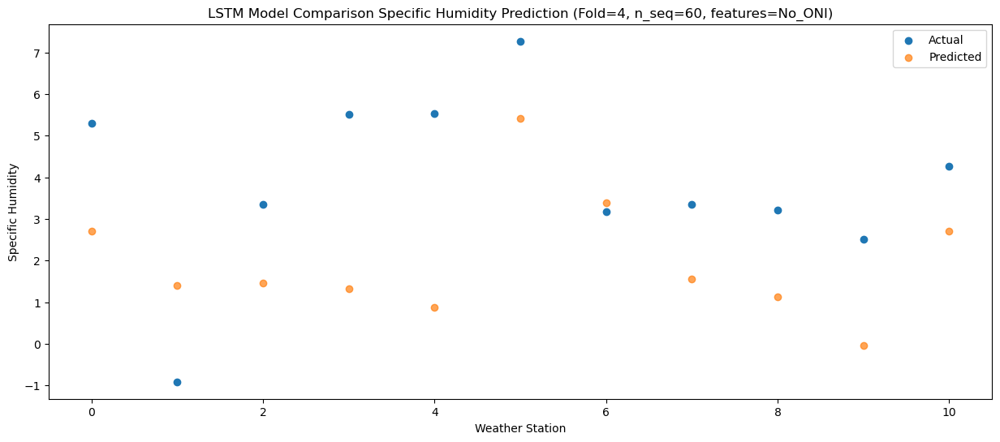

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    9.36   6.522057
1                 1    1.68   5.222057
2                 2    7.67   5.282057
3                 3    9.09   5.142057
4                 4    8.97   4.702057
5                 5   10.03   9.242057
6                 6    7.17   7.222057
7                 7    7.77   5.382057
8                 8    6.70   4.952057
9                 9    6.06   3.792057
10               10    7.18   6.522057


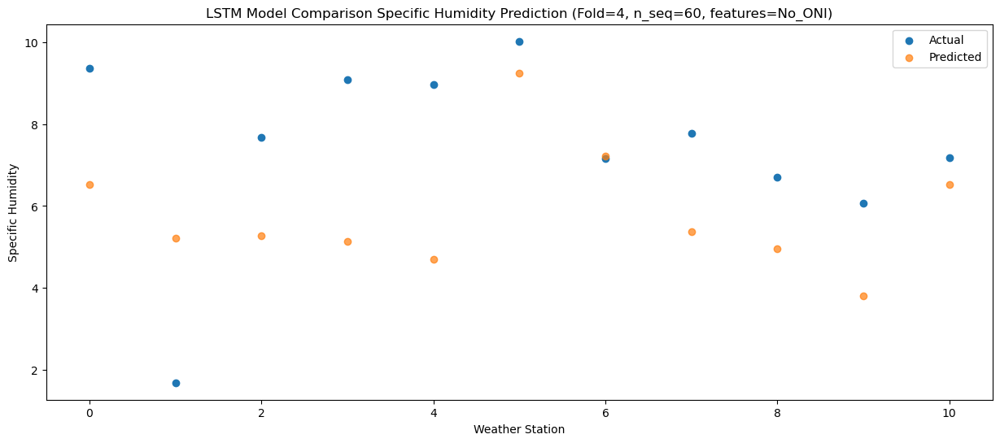

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   12.62    8.31884
1                 1    3.14    7.01884
2                 2    9.01    7.07884
3                 3   11.03    6.93884
4                 4   11.08    6.49884
5                 5   14.56   11.03884
6                 6    8.93    9.01884
7                 7    9.75    7.17884
8                 8    8.39    6.74884
9                 9    8.82    5.58884
10               10    9.73    8.31884


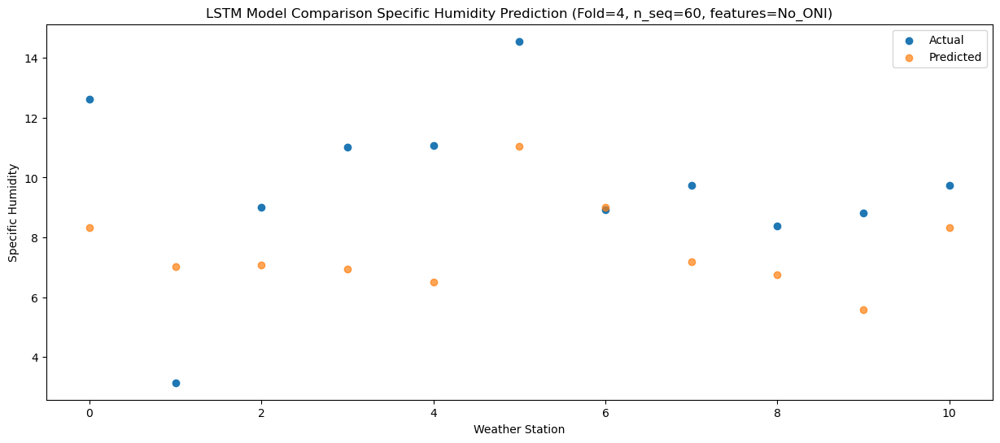

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   13.81  10.443149
1                 1    4.60   9.143149
2                 2   11.04   9.203149
3                 3   10.99   9.063149
4                 4   10.61   8.623149
5                 5   14.44  13.163149
6                 6   11.32  11.143149
7                 7   10.73   9.303149
8                 8    9.69   8.873149
9                 9   10.43   7.713149
10               10   10.85  10.443149


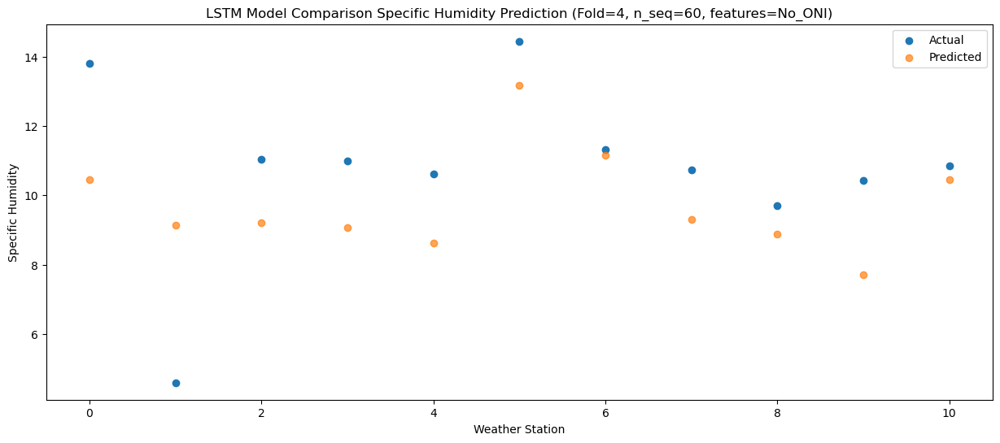

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   12.65   9.795578
1                 1    7.21   8.495578
2                 2    8.73   8.555578
3                 3   10.28   8.415578
4                 4    9.84   7.975578
5                 5   13.24  12.515578
6                 6   10.58  10.495578
7                 7    9.44   8.655578
8                 8    9.33   8.225578
9                 9   10.07   7.065578
10               10   10.83   9.795578


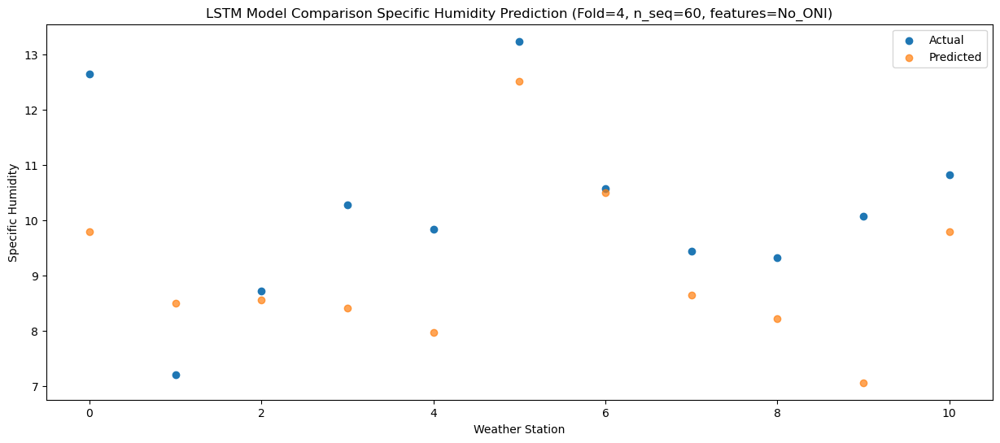

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    9.35   7.165039
1                 1    7.02   5.865039
2                 2    7.63   5.925039
3                 3    7.75   5.785039
4                 4    7.68   5.345039
5                 5   12.36   9.885039
6                 6    8.26   7.865039
7                 7    7.40   6.025039
8                 8    6.65   5.595039
9                 9    6.57   4.435039
10               10    8.76   7.165039


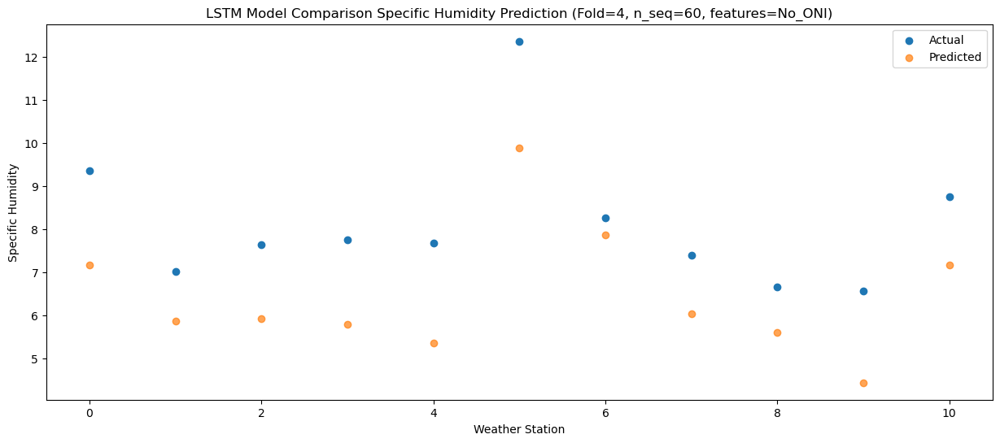

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    5.22     3.3304
1                 1    2.60     2.0304
2                 2    2.84     2.0904
3                 3    4.29     1.9504
4                 4    3.94     1.5104
5                 5    8.67     6.0504
6                 6    3.86     4.0304
7                 7    3.08     2.1904
8                 8    3.07     1.7604
9                 9    2.47     0.6004
10               10    4.65     3.3304


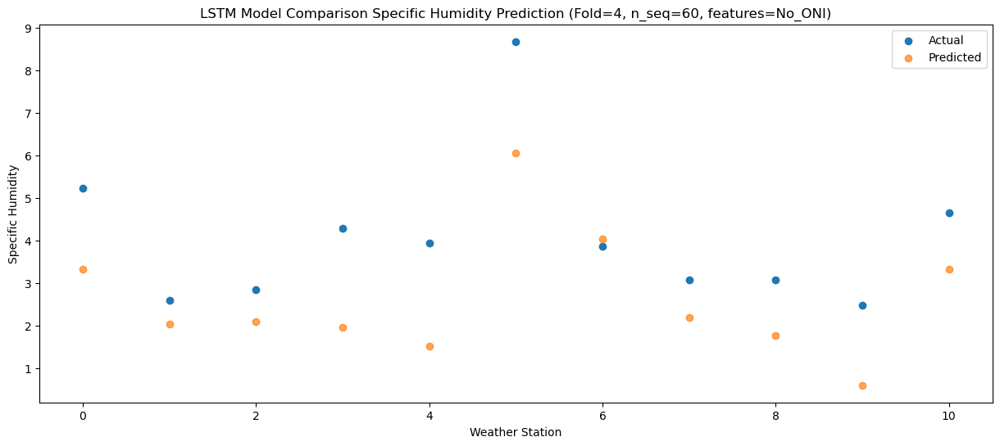

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_8 (LSTM)               (1, 1, 256)               2121728   
                                                                 
 dropout_8 (Dropout)         (1, 1, 256)               0         
                                                                 
 lstm_9 (LSTM)               (1, 256)                  525312    
                                                                 
 dropout_9 (Dropout)         (1, 256)                  0         
                                                                 
 dense_12 (Dense)            (1, 256)                  65792     
                                                                 
 dense_13 (Dense)            (1, 128)                  32896     
                                                                 
 dense_14 (Dense)            (1, 60)                  

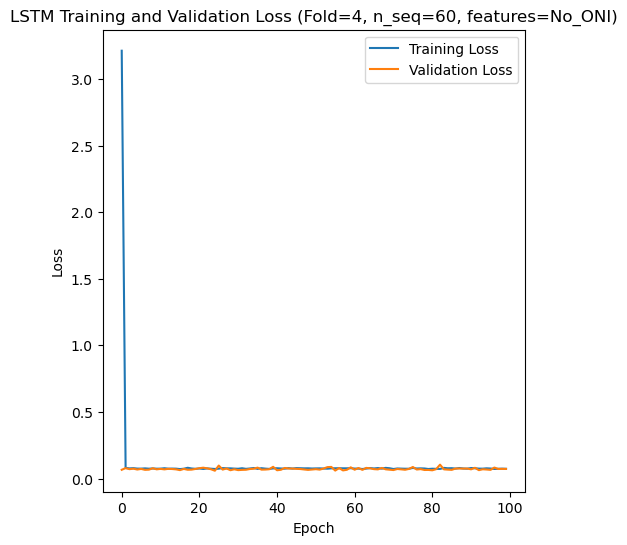

[[1.1912742457578407, 1.4212900347630475, 1.2099828956568097, 0.7038408033180074, 1.9492215439509193, 1.2436730897756845, 1.34146802606269, 1.1219225959792885, 1.766185298590279, 0.8863814177742154, 0.8608735334426848, 0.6371619419946474, 1.3933843572398525, 3.2036177879413024, 3.3949229155763976, 3.1385390192733342, 2.187796409908023, 3.076852189050047, 2.33613960981125, 2.96752170268166, 3.0511853064780956, 4.345169263595863, 2.99183472271469, 4.183365498540842, 4.0949228871302985, 2.5010271011106258, 3.4602237201996253, 2.721279513416079, 2.9290696721691023, 1.8518525462236357, 1.5449171244305426, 1.5485672981168652, 2.0063070843610715, 2.0171807140067055, 2.3286461801993132, 1.9536447189422912, 1.351577502943534, 1.5841823818839484, 1.7136166238012538, 0.7351649621284291, 1.182855398006878, 0.8980947136810746, 1.5873638986019778, 2.018865521680617, 1.41535133225131, 1.4260395683289417, 1.1585308954438402, 2.264782456110657, 1.7351305210106425, 3.5770028492866395, 3.743525573406581,

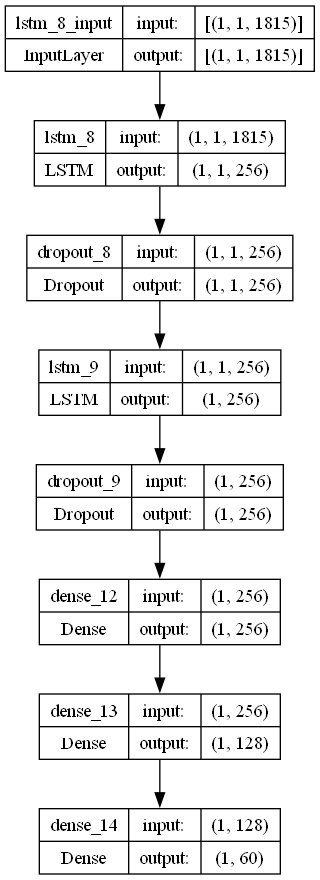

In [2]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from tensorflow.keras.utils import plot_model

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

# fit the best LSTM model using parameters found by Optuna
def create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters from the best model
    lr = 0.09825191604018559
    optimizer = Adam(learning_rate = lr)
    activation_function = 'relu'
    lstm_units = 256
    dropout_rate = 0.3346525619313015

    # design network
    model = Sequential()
    model.add(LSTM(lstm_units, return_sequences=True, batch_input_shape=(n_batch, X.shape[1], X.shape[2]), stateful=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer, metrics=['accuracy', 'mae', rmse, mape, pearson])
        
    return model

# Make one forecast with an LSTM
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# Evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# Invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # Invert the first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # Propagate the difference forecast using the inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# Inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # Create an array from the forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test, n_seq, n_lag):
    # plot the entire dataset in blue
    plt.plot(series[:n_lag+2+len(forecasts)].values)
    # plot the forecasts in red
    off_s = n_lag + 1
    off_e = off_s + len(forecasts) + 1
    xaxis = [x for x in range(off_s, off_e)]
    yaxis = [series.values[off_s]] + forecasts
    print(xaxis)
    print(yaxis)
    plt.plot(xaxis, yaxis, color='red')
    plt.xlabel("Month")
    plt.ylabel("Specific Humidity")
    # show the plot
    plt.show()

n_batch = 1
n_test = 11
nb_epoch = 100
    
rmse_avg_list = []
mae_avg_list = []
mape_avg_list = []
r2_score_avg_list = []
forecast_results = []
actual_results = []
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]

    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    series = pd.Series(dataset[:, 0]) # Using first column (specific humidity)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction

    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    rmse_avg_list.append(rmse_list)
    mae_avg_list.append(mae_list)
    mape_avg_list.append(mape_list)
    r2_score_avg_list.append(r2_list)
    forecast_results.append(forecasts)
    actual_results.append(actual)

    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual S.H.\tPredicted S.H.\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")
    
        # plot forecasts
        dataset_df = pd.DataFrame(val_y[i])
        dataset_df = dataset_df.iloc[0:11, :]
        dataset_df = dataset_df.transpose()
        dataset = dataset_df.values

        series_ws = pd.Series(dataset[:, j]) # Using first column (temperatures)
        forecasts_ws = forecasts[j]
        
        plot_forecasts(series_ws, forecasts_ws, n_test, n_seq, n_lag)

    # Print out plots of actual and predicted values for weather stations
    ws = df.index[1:12]
    print(ws)
    a = []
    f = []
    for q in range(len(actual)):
        x = actual[q]
        a.append(x[0])
    for q in range(len(forecasts)):
        x = forecasts[q]
        f.append(x[0])
    print(a)
    print(f)
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'ws': ws,
        'Actual': a,
        'Predicted': f
    })

    for k in range(n_seq):
        print("Predictions for (t+"+str(k)+"):")
        # Print out plots of actual and predicted values for each weather station
        results = []

        # Create a DataFrame for plotting
        for j in range(11):
            results.append([j, actual[j][k], forecasts[j][k]])
               
        results_df = pd.DataFrame(results)
        results_df.columns = ['Weather_Station', 'Actual', 'Predicted']

        print(results_df)
            
        # Plotting the results
        plt.figure(figsize=(15, 6))
        plt.scatter(results_df['Weather_Station'], results_df['Actual'], label='Actual')
        plt.scatter(results_df['Weather_Station'], results_df['Predicted'], label='Predicted', alpha=0.7)
        title1='LSTM Model Comparison Specific Humidity Prediction (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_ONI)'
        plt.title(title1)
        plt.xlabel('Weather Station')
        plt.ylabel('Specific Humidity')
        plt.legend()
        plt.show()

    best_model.summary()

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title2 = 'LSTM Training and Validation Loss (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_ONI)'
    plt.title(title2)
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

print(rmse_avg_list)
print(mae_avg_list)
print(mape_avg_list)
print(r2_score_avg_list)
print(forecast_results)
print(actual_results)
print("Accuracy Results:")
print("RMSE for each fold:")
print(rmse_avg_list)
print("Average RMSE:"+str(np.mean(rmse_avg_list)))
print("Average MAE:"+str(np.mean(mae_avg_list)))
print("Average MAPE:"+str(np.mean(mape_avg_list)))
print("Average R2 Score:"+str(np.mean(r2_score_avg_list)))

# Plot model architecture
filename = "lstm_model_optimized_SH_S60_No_ONI.png"
plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)

In [3]:
print(np.mean(mape_avg_list[0]))

2.695600597022141


In [4]:
print(np.mean(mape_avg_list[1]))

10468361757321.873


In [5]:
print(np.mean(mape_avg_list[2]))

4.960155049955264


In [6]:
print(np.mean(mape_avg_list[3]))

8370110524916.823


In [7]:
print(np.mean(mape_avg_list[4]))

1.5776866228180861


In [8]:
print(mape_avg_list[1])

[1.4510049305019217, 1.7239381259307194, 357711176838343.94, 10.619943233831494, 0.5632540243741888, 6.827969643832085, 0.26639595253744325, 0.08555690969042416, 0.1413224845712506, 0.09234831862486378, 0.07802484352203067, 0.3401761718845115, 2.655510308809336, 1.9788397506810325, 2.835444965558817, 2.3805007380351837, 2.380926434593379, 7.680301800883462, 0.4140970817731329, 0.14143899395756734, 0.14412113537924126, 0.11437541908695435, 0.11886199812869962, 0.15940402950012159, 1.483309670572532, 2.5918680998689565, 2.8711626716707204, 8.041555147508403, 32.34773773883839, 270390528600767.7, 0.3186251704475915, 0.15392370613572956, 0.09375228712545547, 0.06737604152756918, 0.17446534040939407, 14.67761206170228, 7.314946544894294, 2.9944344984200653, 4.028282059209931, 39.59624995159866, 5.734501224158345, 2.2822239244629383, 0.6082580252404748, 0.309211281014713, 0.1352964043101104, 0.14532996953086424, 0.3252748873447288, 1.0758487957999627, 2.7192258523456485, 2.5619514230890794, 

In [9]:
print(mape_avg_list[3])

[2.561050903472994, 2.2318227359295166, 3.8461711774589715, 2.095475754132487, 0.7313024356808812, 0.7291791709018273, 0.5341963771104928, 0.15821502824962905, 0.19471525195748915, 0.1288950960045176, 0.21234371959706327, 0.5750875394362279, 1.107044699062728, 2.2879336852332375, 1.1898167121126417, 1.064060977044425, 354890960407579.94, 1.3994609149580375, 0.9907788189523242, 0.2500586292545707, 0.24310785581347255, 0.1623182799500499, 0.22697935392433222, 0.4265611263588447, 3.462199512365876, 2.471059038635644, 1.6440691204458746, 2.9155374226239075, 47.84145910090495, 2.048676356297969, 0.7590251704658776, 0.4120235617266857, 0.3942255246157357, 0.37250928259425214, 0.4733447783598809, 2.8826604724922777, 4.265951902377983, 26.193581407532086, 4.602771614393762, 7.094121956173851, 11.300885862873672, 3.5454921034605174, 4.790730391255759, 0.674386656516165, 0.3986733792385672, 0.5689760731076302, 0.6505499559321428, 2.1350811869381148, 5.737995758814988, 7.330061313202612, 3.998703

In [10]:
print(mape_avg_list[1][2])

357711176838343.94


In [11]:
print(mape_avg_list[1][29])

270390528600767.7


In [12]:
print(mape_avg_list[3][16])

354890960407579.94


In [13]:
print(mape_avg_list[3][51])

147315671087190.28


In [14]:
print(np.sum(mape_avg_list[1][0:1])+np.sum(mape_avg_list[1][3:28])+np.sum(mape_avg_list[1][30:60]))

166.67390803821797


In [15]:
print(np.sum(mape_avg_list[3][0:15])+np.sum(mape_avg_list[3][17:50])+np.sum(mape_avg_list[3][52:60]))

234.0556939683274


In [16]:
print("MAPE Average for Fold 2 (removing >1e14 values): "+str(166.67390803821797/58))

MAPE Average for Fold 2 (removing >1e14 values): 2.873688069624448


In [17]:
print("MAPE Average for Fold 4 (removing >1e14 values): "+str(234.0556939683274/58))

MAPE Average for Fold 4 (removing >1e14 values): 4.035442999453921


In [18]:
print("Average MAPE: "+str((2.695600597022141+2.873688069624448+4.960155049955264+4.035442999453921+1.5776866228180861)/5))

Average MAPE: 3.228514667774772
